In [36]:
import tensorflow as tf
import numpy as np
import os
import time
import sys
import pickle
from rnn_attentional import * #For the attentional experiment
import scipy
from scipy import spatial
import pandas as pd
import seaborn as sns
import pylab as plt

In [104]:
checkpoint_path = 'checkpoints/attentional-linear-to-hidden-state/rep0-lstm2-256-1-128-adam-1000000000-hidden_state-64-20170523-125653/last_model/last_model.ckpt-9945600'
model_name = 'RQ2_1a'
max_interactions = 100


# tensorflow model
model_parameters = {}
model_parameters['opt'] = 'adam'
model_parameters['learning_rate'] = 0.01
model_parameters['n_hidden'] = 256
model_parameters['batch_size'] = 128
model_parameters['rnn_type'] = 'lstm2'
model_parameters['rnn_layers'] = 1
model_parameters['dropout'] = 0.0
model_parameters['l2_reg'] = 0.0
model_parameters['type_output'] = 'softmax'
model_parameters['max_steps'] = 3000000
model_parameters['padding'] = 'right'
model_parameters['embedding_size'] = 64
model_parameters['embedding_activation'] = 'linear'
model_parameters['y_length'] = 1
model_parameters['W_emb_init'] = 'None'
type_input = 'one-hot'
input_embeddings_size = 0
# Parameters for the attentional model only
model_parameters['attentional_layer'] = 'hidden_state'
model_parameters['attention_weights_activation'] = 'linear'
model_parameters['init_stdev'] = 0.1

In [3]:
if type_input == 'one-hot':
    with open("pickles/movielens/X_test_" + str(max_interactions) + "_2009_filter20_rep2.pickle", 'rb') as handle:
        X_test = pickle.load(handle)
    with open("pickles/movielens/Y_test_" + str(max_interactions) + "_2009_filter20_rep2.pickle", 'rb') as handle:
        Y_test = pickle.load(handle)
elif type_input == 'embeddings':
    with open("pickles/movielens/X_test_" + str(max_interactions) + "_embeddings_" + str(input_embeddings_size) + "_2009_filter20_rep2.pickle", 'rb') as handle:
        X_test = pickle.load(handle)
    with open("pickles/movielens/Y_test_" + str(max_interactions) + "_embeddings_" + str(input_embeddings_size) + "_2009_filter20_rep2.pickle", 'rb') as handle:
        Y_test = pickle.load(handle)

if type_input == 'one-hot':
    model_parameters['n_input'] = X_test[0].toarray().shape[1]
    model_parameters['n_output'] = Y_test[0].toarray().shape[1]
    model_parameters['seq_length'] = X_test[0].toarray().shape[0]
else:
    model_parameters['n_input'] = X_test[0].shape[1]
    if model_parameters['type_output'] == 'embeddings':
        model_parameters['n_output'] = input_embeddings_size
        with open("pickles/movielens/" + "W_emb_64" + ".pickle", 'rb') as handle:
            W_emb = pickle.load(handle)
            W_emb = W_emb.astype(np.float32)
    else:
        model_parameters['n_output'] = Y_test[0].shape[1]
    model_parameters['seq_length'] = X_test[0].shape[0]

print('Input dimension: ' + str(model_parameters['n_input']))
print('Output dimension: ' + str(model_parameters['n_output']))

Input dimension: 10057
Output dimension: 10057


In [9]:
load_pickle = False


start_date_train = '2009-01-01'
date_test = '2014-10-01'
min_seq_length = 5
max_seq_length = 100


movies_min_ratings = 20


if load_pickle:
    with open("../data/Movielens/ml-20m/df_date.pickle", 'rb') as handle:
        df_date = pickle.load(handle)
else:
    #Ratings .dat format: UserID::MovieID::Rating::Timestamp
    user_ids = []
    movie_ids = []
    ratings = []
    timestamps = []
    dataset_file = "../data/Movielens/ml-20m/ratings.csv"
    df = pd.read_csv(dataset_file)
    df['userId'] = df['userId'].astype(np.int32)
    df['movieId'] = df['movieId'].astype(np.int32)
    df['rating'] = df['rating'].astype(np.float16)
    df['date'] = pd.to_datetime(df['timestamp'],unit='s')

    df_date = df[df.date > start_date_train]

# Filter out movies with less than X ratings
filter_movies = df_date.movieId.value_counts()[(df_date.movieId.value_counts() > movies_min_ratings)].index.values
df_date = df_date[df_date.movieId.isin(filter_movies)]
print('Total number of ratings:' + str(len(df_date)))
print('Number of different users: ' + str(len(df_date['userId'].unique())))
print('Number of different movies: ' + str(len(df_date['movieId'].unique())))
sys.stdout.flush()
# Filter out users with less than X ratings
filter_users = df_date['userId'].value_counts()[(df_date['userId'].value_counts() >= min_seq_length)].index.values
df_date = df_date[df_date.userId.isin(filter_users)]
print('Total number of ratings:' + str(len(df_date)))
print('Number of different users: ' + str(len(df_date['userId'].unique())))
print('Number of different movies: ' + str(len(df_date['movieId'].unique())))

# Build array mapping movie_id --> position in one-hot encoding
movieIds = np.zeros(max(df_date['movieId'].unique()) + 1, np.uint16)
i = 0
for movieId in df_date['movieId'].unique():
    movieIds[movieId] = i
    i += 1


dataset_file = "../data/Movielens/ml-20m/movies.csv"
df_movies = pd.read_csv(dataset_file)
print(len(df_movies.movieId.unique()))
df_movies = df_movies[df_movies.movieId.isin(df_date.movieId.unique())]
print(len(df_movies.movieId.unique()))


Total number of ratings:4687202
Number of different users: 36395
Number of different movies: 10057
Total number of ratings:4685946
Number of different users: 35821
Number of different movies: 10057
27278
10057


In [131]:
# Build dictionary one-hot to movieId
dict_onehot2id = {}
for i in range(len(movieIds)):
    if movieIds[i] != 0:
        dict_onehot2id[movieIds[i]] = i
dict_onehot2id[0] = 1
        
print(dict_onehot2id[1])
print(movieIds[10])

# Functions to visualize the data
def plot_heatmap(num_prediction, x_test, alpha_weights):
    idx, onehots = np.where(x_test ==1)
    past_movies = []
    for o in onehots:
        #ids.append(dict_onehot2id[o])
        movie_id = dict_onehot2id[o]
        past_movies.append(df_movies[df_movies.movieId == movie_id].title.values[0])
    num_past_items = len(onehots)
    past_movies = np.array(past_movies[-min(50, num_past_items):])
    #past_movies = df_movies[df_movies.movieId.isin(ids)].title.values[min(50, num_past_items):]
    if num_past_items >= 50:
        labels = past_movies.reshape((10, 5))
        weights = alpha_weights[50:].reshape((10, 5))
        #plt.figure(figsize=(55,40))
        plt.figure(figsize=(25,10))
        ax = sns.heatmap(weights, annot=labels, fmt="")
        plt.show()
        plt.savefig('attention_plots/' + str(model_name) + '/attentions_' + str(num_prediction))
    else:
        print('Skip for now')
        
def plot_predictions(num_prediction, predictions, y_true, k):

    idx_predictions = np.arange(len(predictions))
    sorted_pred, sorted_idx = zip(*sorted(zip(predictions, idx_predictions), reverse=True))
    _, y_true_idx = np.where(y_true==1)

    top_k_movies = []
    i = 0
    while i < k:
        movie_id = dict_onehot2id[sorted_idx[i]]
        top_k_movies.append(df_movies[df_movies.movieId == movie_id].title.values[0])
        i += 1
    top_k_prob = sorted_pred[:k]

    true_movies = []
    for idx in y_true_idx:
        movie_id = dict_onehot2id[idx]
        true_movies.append(df_movies[df_movies.movieId == movie_id].title.values[0])

    correct_predicted_movies = []
    correct_idx = set(sorted_idx[:k]).intersection(set(y_true_idx))
    for idx in correct_idx:
        movie_id = dict_onehot2id[idx]
        correct_predicted_movies.append(df_movies[df_movies.movieId == movie_id].title.values[0])

    if len(correct_predicted_movies) > 0:
        print('correct_predicted: ' + str(correct_predicted_movies))
        print('true_movies: ' + str(true_movies))
        
    ax = sns.barplot(x=top_k_prob, y=top_k_movies, palette="Blues_d")
    plt.show()
    plt.savefig('attention_plots/' + str(model_name) + '/predictions_' + str(num_prediction))

    
    

10
1


In [14]:
# Create tensorflow model and train
print('Create model...')
model = RNN_dynamic(model_parameters)
model.create_model()

Create model...
Defined alpha weights
Defined weights from hidden to output
Defined no pretrained w_emb
Defined embedding weights
Defined linear embedding
Defined linear ejs
Defined context from hidden_state


In [123]:
idx, onehots = np.where(x_test[1] ==1)
print(len(idx))

30


load model: checkpoints/attentional-linear-to-hidden-state/rep0-lstm2-256-1-128-adam-1000000000-hidden_state-64-20170523-125653/last_model/last_model.ckpt-9945600


/home/ubuntu/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1297: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


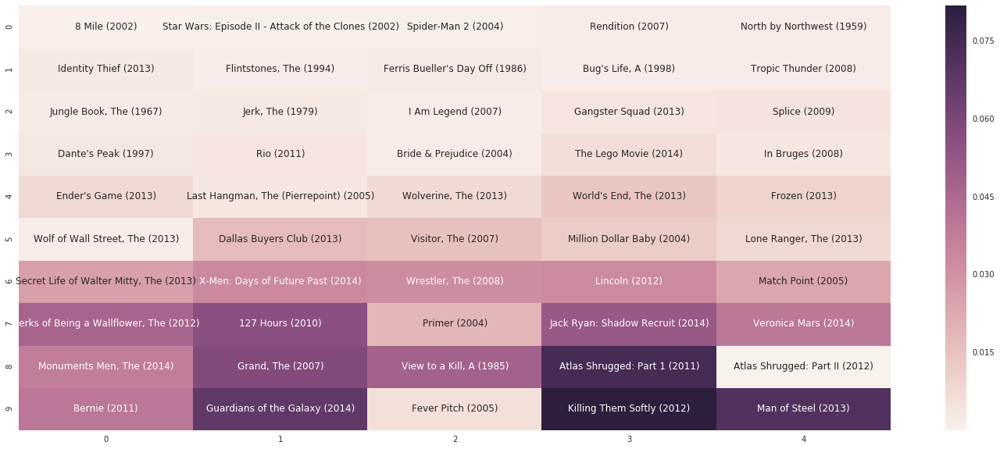

correct_predicted: ['Edge of Tomorrow (2014)']
true_movies: ['Sabrina (1954)', 'Captain America: The Winter Soldier (2014)', 'Big Hero 6 (2014)', 'Edge of Tomorrow (2014)', 'Sunshine Cleaning (2008)', 'Five-Year Engagement, The (2012)', "Schindler's List (1993)", 'Fargo (1996)', 'Back to the Future (1985)', 'Mask, The (1994)', 'Back to the Future Part II (1989)', 'Iron Man 3 (2013)', 'X-Men Origins: Wolverine (2009)', 'Léon: The Professional (a.k.a. The Professional) (Léon) (1994)', 'Indiana Jones and the Last Crusade (1989)', 'Goonies, The (1985)', 'My Neighbor Totoro (Tonari no Totoro) (1988)', 'Iron Giant, The (1999)', 'Meet the Parents (2000)', 'Patriot, The (2000)', 'Matrix Revolutions, The (2003)', 'Gone in 60 Seconds (2000)', 'Men in Black II (a.k.a. MIIB) (a.k.a. MIB 2) (2002)', "Pirates of the Caribbean: Dead Man's Chest (2006)", '40-Year-Old Virgin, The (2005)', 'Borat: Cultural Learnings of America for Make Benefit Glorious Nation of Kazakhstan (2006)', 'Troy (2004)', '50 Fi

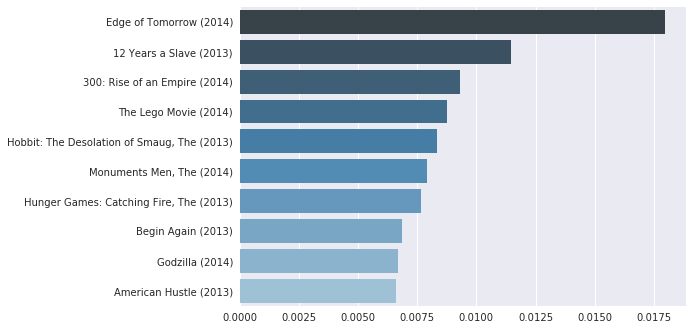

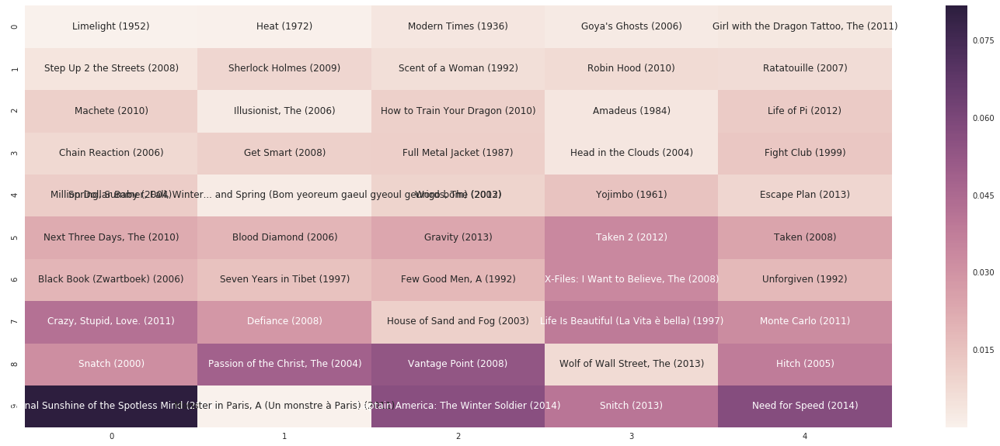

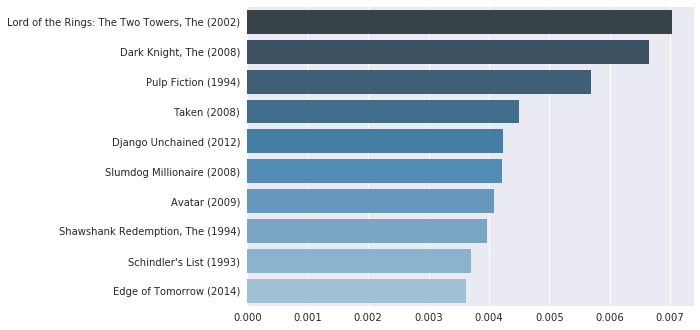

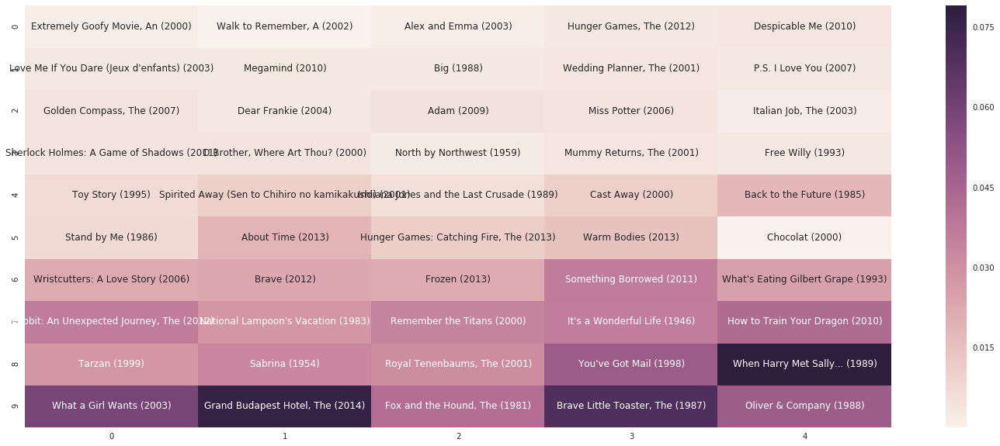

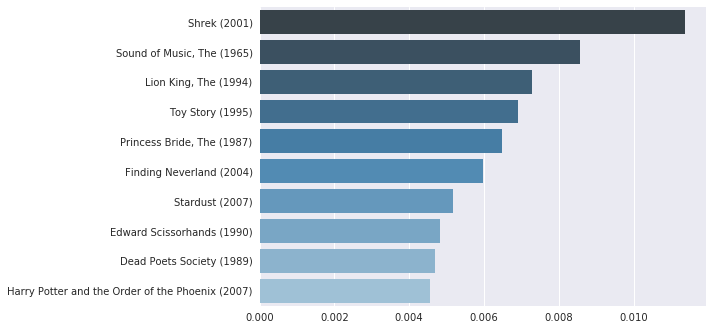

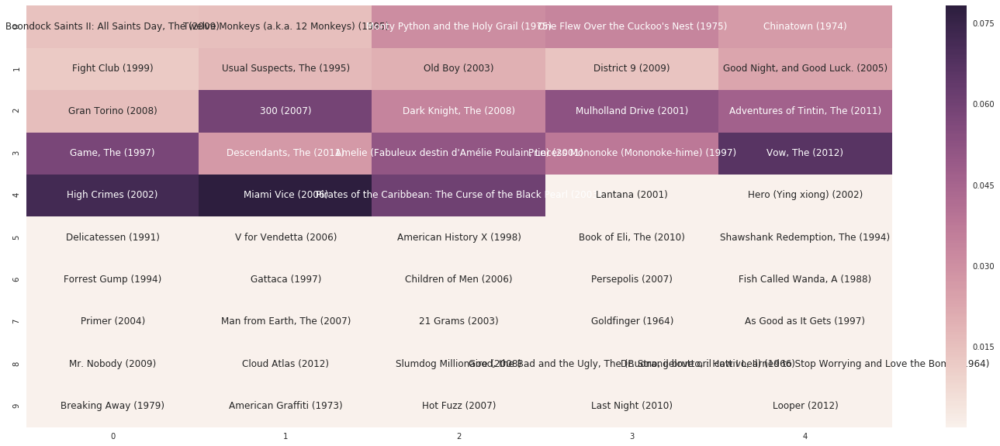

correct_predicted: ['Django Unchained (2012)']
true_movies: ['Gladiator (2000)', "Schindler's List (1993)", 'Django Unchained (2012)', 'Intouchables (2011)', 'Downfall (Untergang, Der) (2004)', '12 Years a Slave (2013)', "Pan's Labyrinth (Laberinto del fauno, El) (2006)", 'Lincoln (2012)', 'Gone Girl (2014)', 'Skin I Live In, The (La piel que habito) (2011)', 'Tell No One (Ne le dis à personne) (2006)', 'Groundhog Day (1993)', 'Shaun of the Dead (2004)', 'Donnie Darko (2001)', 'Divergent (2014)']


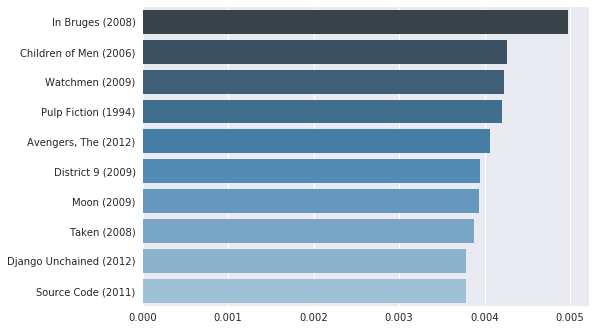

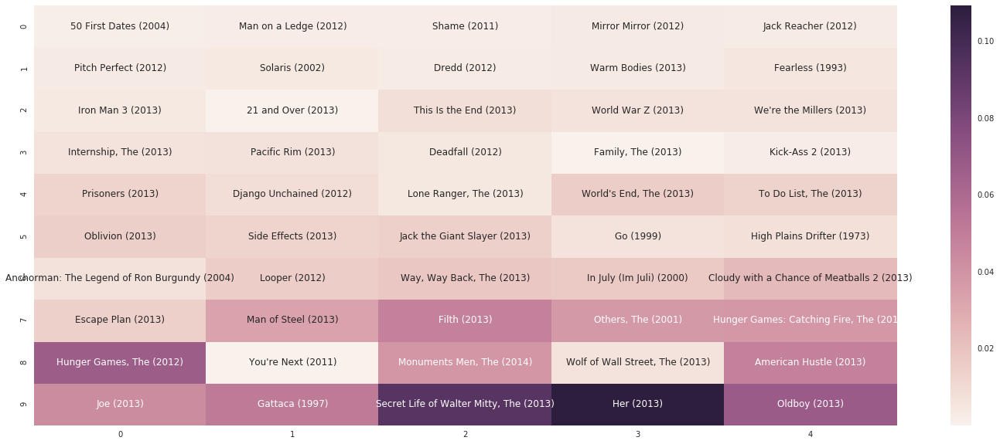

correct_predicted: ['Hobbit: The Desolation of Smaug, The (2013)']
true_movies: ['22 Jump Street (2014)', 'Frozen (2013)', 'Other Woman, The (2014)', 'Indiana Jones and the Kingdom of the Crystal Skull (2008)', 'Edge of Tomorrow (2014)', 'Maleficent (2014)', 'True Romance (1993)', 'Diving Bell and the Butterfly, The (Scaphandre et le papillon, Le) (2007)', 'Goonies, The (1985)', 'Predestination (2014)', 'Hello Ladies: The Movie (2014)', 'Guardians of the Galaxy (2014)', 'Maze Runner, The (2014)', 'Gone Girl (2014)', 'Irreversible (Irréversible) (2002)', 'Trance (2013)', 'The Interview (2014)', 'Tucker & Dale vs Evil (2010)', "Pan's Labyrinth (Laberinto del fauno, El) (2006)", 'Intouchables (2011)', 'Coherence (2013)', 'Godfather, The (1972)', 'Yojimbo (1961)', 'Short Film About Love, A (Krótki film o milosci) (1988)', 'About Time (2013)', 'The Hobbit: The Battle of the Five Armies (2014)', 'Hobbit: The Desolation of Smaug, The (2013)', 'Way, The (2010)', 'Before I Go to Sleep (2014)', 

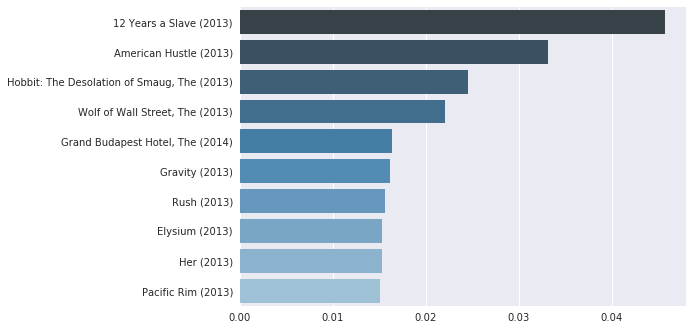

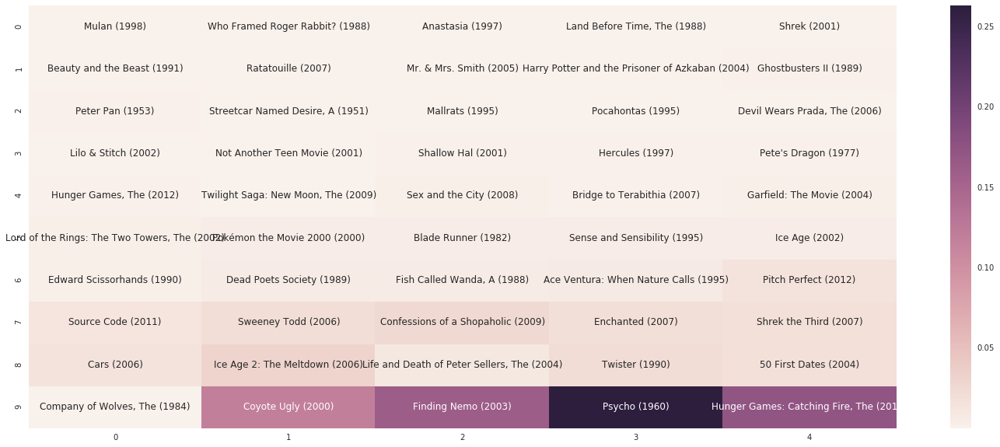

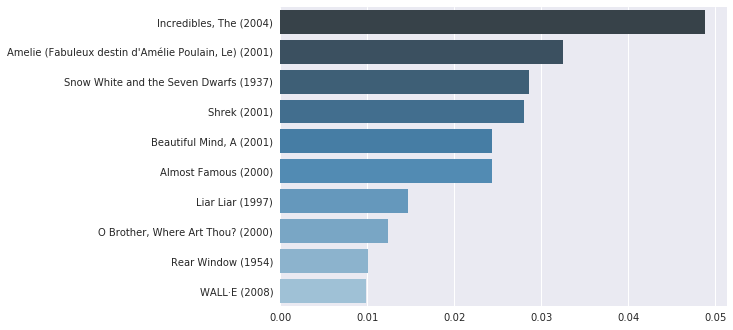

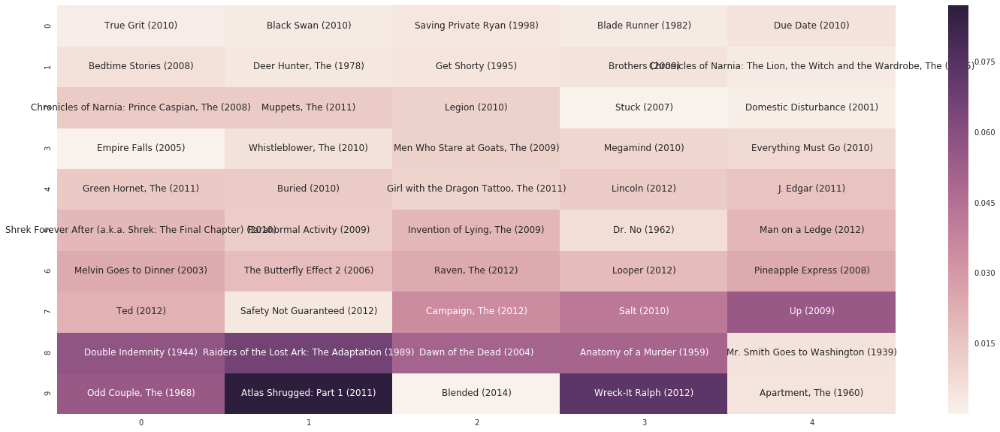

correct_predicted: ['Argo (2012)', 'Toy Story 3 (2010)', 'Django Unchained (2012)', 'Avengers, The (2012)']
true_movies: ['Avengers, The (2012)', 'Monsters, Inc. (2001)', 'Pride of the Yankees, The (1942)', 'The Lego Movie (2014)', 'Flight (2012)', 'Sunshine Cleaning (2008)', 'White Heat (1949)', 'Argo (2012)', 'Good Day to Die Hard, A (2013)', 'X-Men: Days of Future Past (2014)', 'Maltese Falcon, The (1941)', 'Tenure (2009)', 'Ninth Gate, The (1999)', 'Trouble with the Curve (2012)', 'Airport (1970)', 'Airport 1975 (1974)', "Airport '77 (1977)", 'Ghost Town (2008)', 'Great Muppet Caper, The (1981)', 'Arthur Christmas (2011)', 'Hancock (2008)', 'Django Unchained (2012)', "Devil's Advocate, The (1997)", 'Bobby (2006)', 'Ratatouille (2007)', 'Safe House (2012)', "Time Traveler's Wife, The (2009)", '2012 (2009)', 'Fred Claus (2007)', 'Tell No One (Ne le dis à personne) (2006)', 'Space Cowboys (2000)', 'Law Abiding Citizen (2009)', 'Air I Breathe, The (2007)', 'Sherlock Holmes: A Game of S

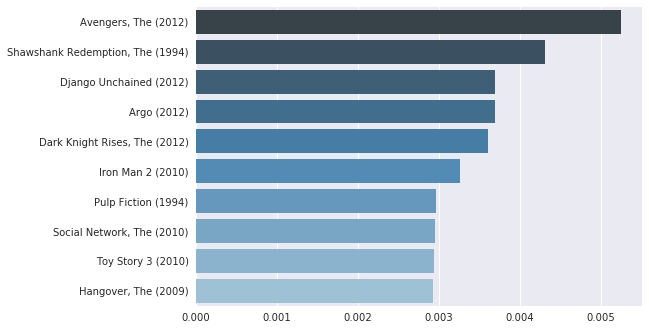

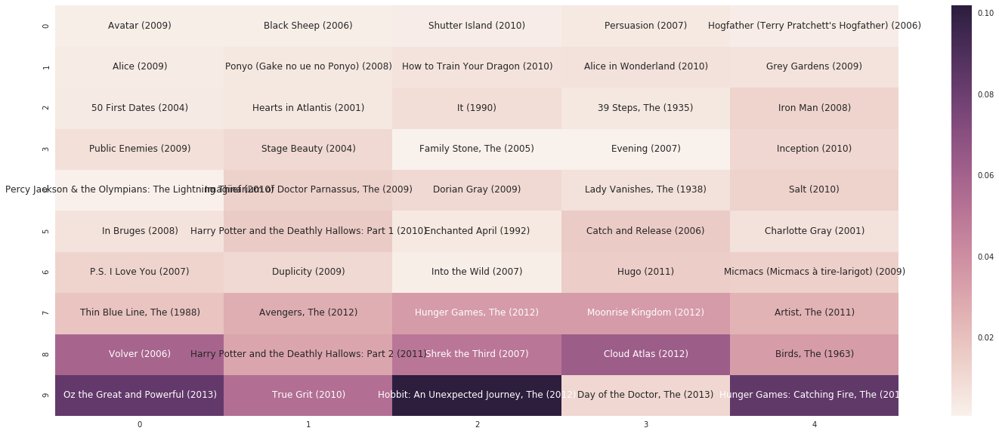

correct_predicted: ['X-Men: First Class (2011)', 'Hobbit: The Desolation of Smaug, The (2013)']
true_movies: ['How to Train Your Dragon 2 (2014)', 'Guardians of the Galaxy (2014)', 'Maleficent (2014)', 'Diving Bell and the Butterfly, The (Scaphandre et le papillon, Le) (2007)', 'X-Men: First Class (2011)', "Logan's Run (1976)", 'Pi (1998)', 'Toy Story 2 (1999)', 'Brave (2012)', 'Despicable Me (2010)', 'Citizen Kane (1941)', 'Bourne Identity, The (1988)', 'Breakfast Club, The (1985)', 'Life of Pi (2012)', 'Cast Away (2000)', 'Big (1988)', 'Raiders of the Lost Ark: The Adaptation (1989)', 'High Fidelity (2000)', 'Pride and Prejudice (1995)', '12 Angry Men (1957)', 'Transcendence (2014)', 'Cider House Rules, The (1999)', 'Virgin Suicides, The (1999)', 'Fantastic Mr. Fox (2009)', 'Watchmen (2009)', 'Captain America: The First Avenger (2011)', 'Sense and Sensibility (1995)', 'Raise the Red Lantern (Da hong deng long gao gao gua) (1991)', "Young and Prodigious T.S. Spivet, The (L'extravagant

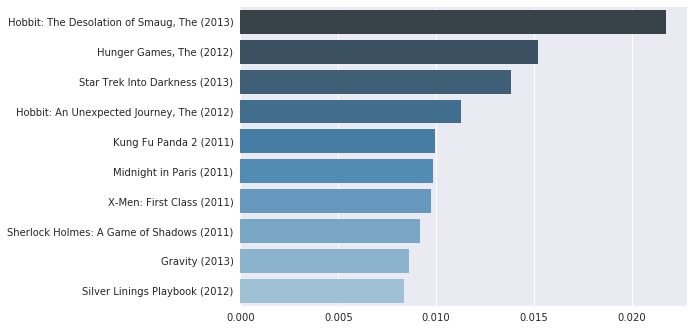

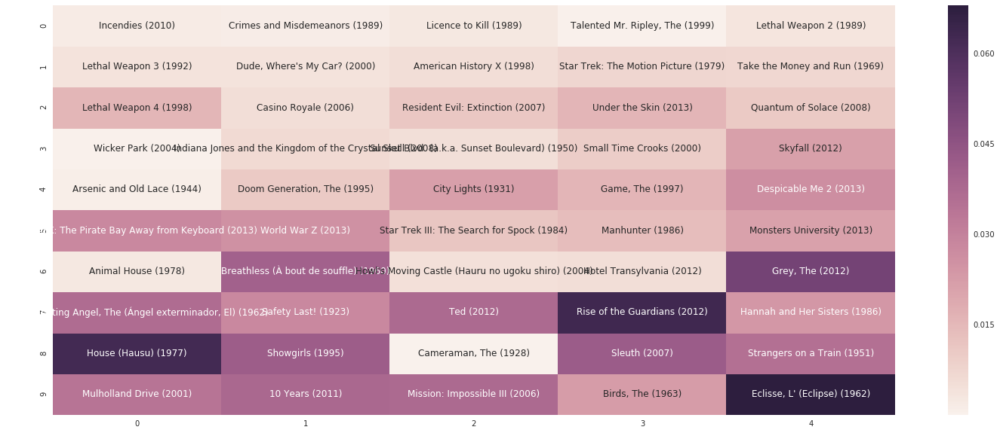

correct_predicted: ['8 1/2 (8½) (1963)']
true_movies: ['Die Hard: With a Vengeance (1995)', 'Psycho (1960)', 'Red Dragon (2002)', 'Rashomon (Rashômon) (1950)', 'Star Trek IV: The Voyage Home (1986)', 'Gold Rush, The (1925)', 'Percy Jackson & the Olympians: The Lightning Thief (2010)', 'Insomnia (1997)', 'Metropolis (1927)', 'American Hustle (2013)', 'Wedding Crashers (2005)', 'Man from Earth, The (2007)', 'Dolce Vita, La (1960)', '8 1/2 (8½) (1963)', 'Jackass: The Movie (2002)', 'Live Free or Die Hard (2007)', 'Nights of Cabiria (Notti di Cabiria, Le) (1957)', 'Immigrant, The (1917)', 'District 9 (2009)', 'Grown Ups (2010)', 'More the Merrier, The (1943)', 'Let the Right One In (Låt den rätte komma in) (2008)', 'Cannibal Holocaust (1980)', 'Rushmore (1998)', 'To Catch a Thief (1955)', '2010: The Year We Make Contact (1984)', 'Meet the Spartans (2008)', 'Conjuring, The (2013)', 'Double Life of Veronique, The (Double Vie de Véronique, La) (1991)', 'Apartment, The (1960)', 'How to Marry a

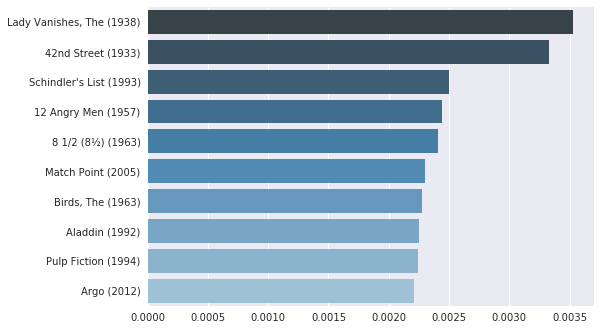

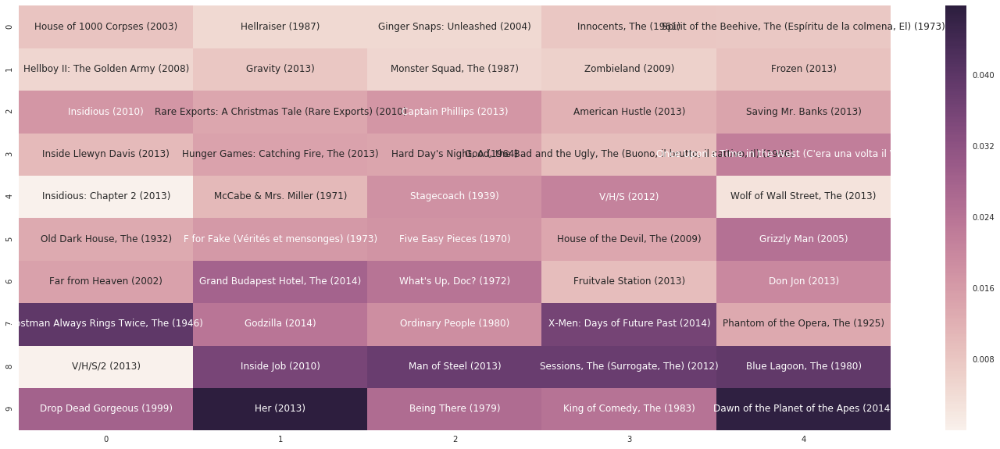

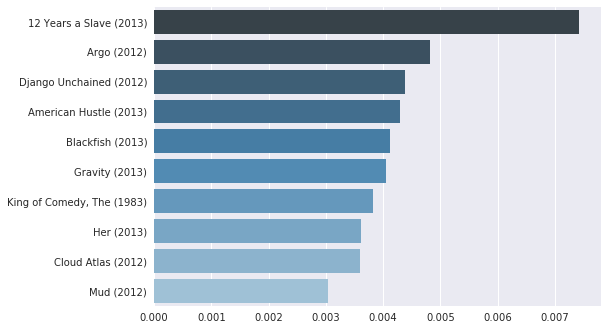

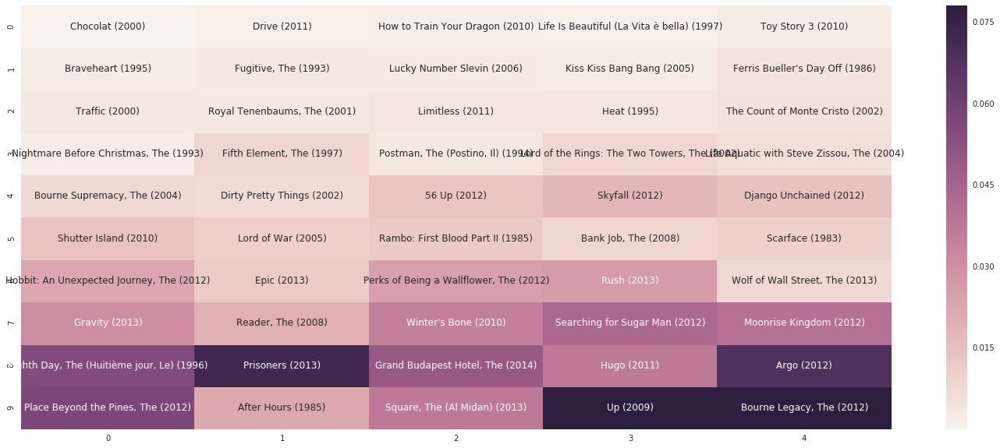

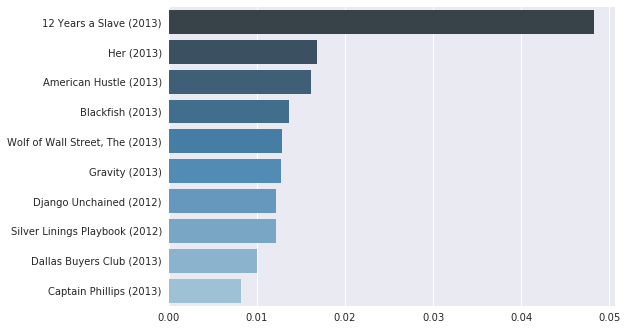

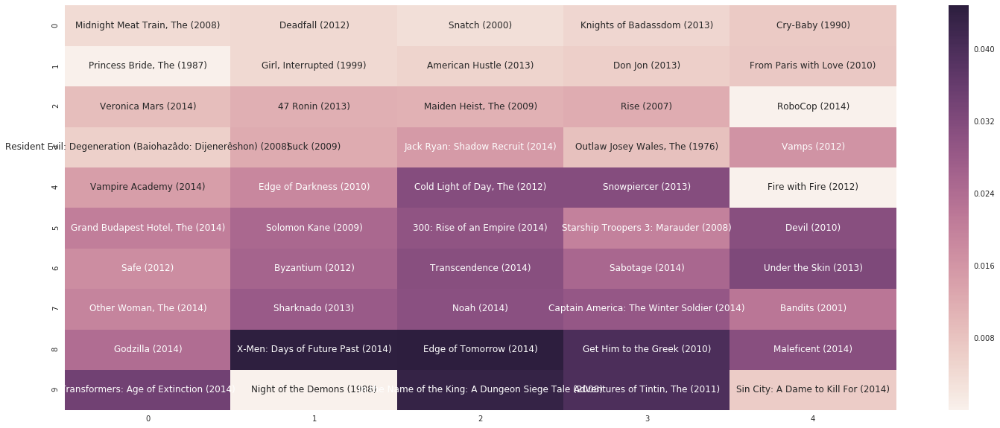

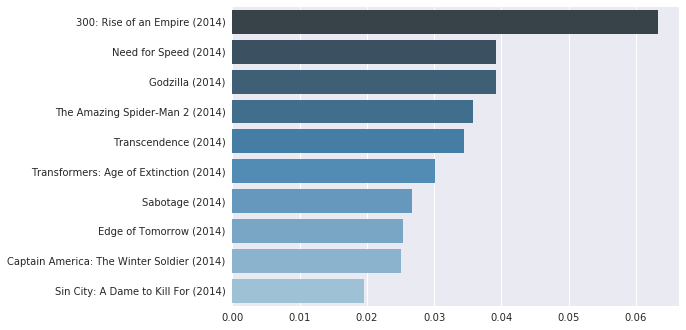

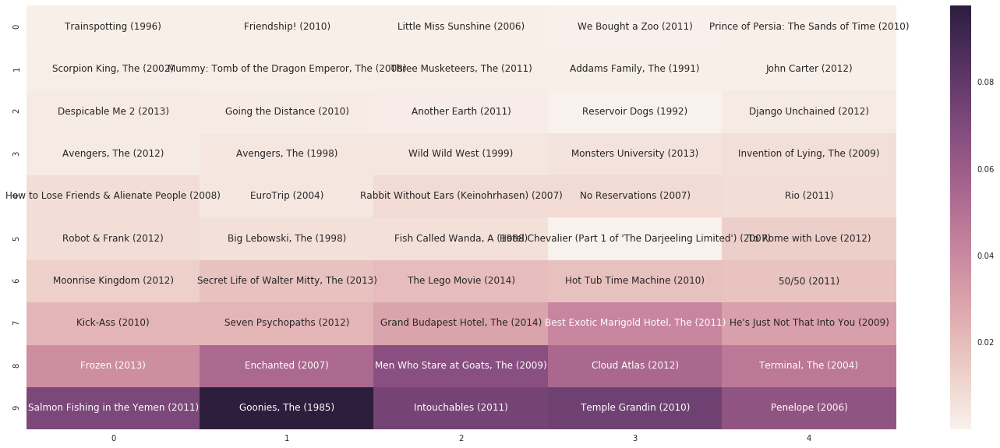

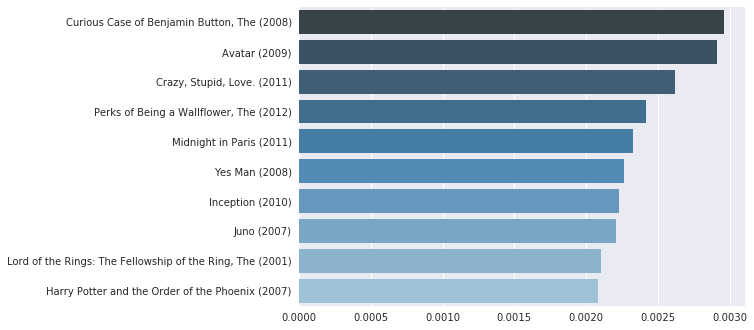

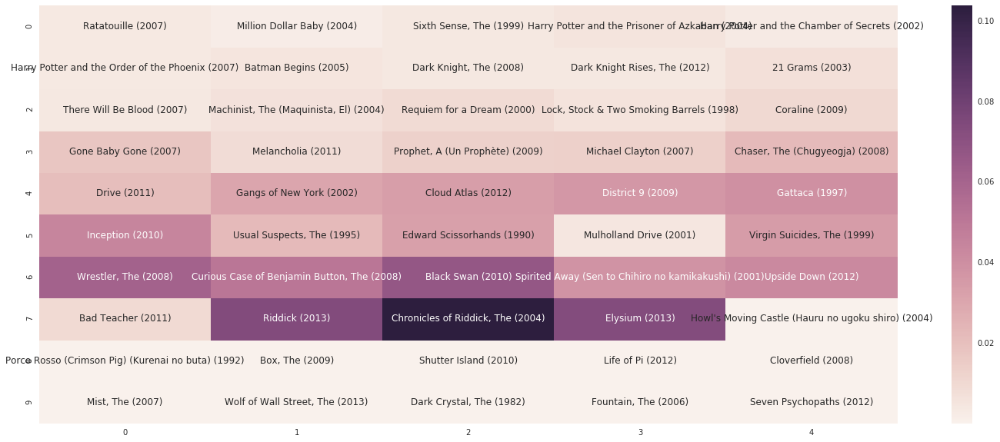

correct_predicted: ['Shrek (2001)', 'Prestige, The (2006)']
true_movies: ['Pact, The (2012)', 'Hole, The (2001)', 'What Lies Beneath (2000)', 'Insidious: Chapter 2 (2013)', '1408 (2007)', 'Conjuring, The (2013)', 'Samsara (2011)', 'Memento (2000)', 'Prestige, The (2006)', 'Children of Men (2006)', 'Lord of the Rings: The Fellowship of the Ring, The (2001)', 'Lord of the Rings: The Two Towers, The (2002)', 'Gladiator (2000)', 'Shrek (2001)', 'Interstellar (2014)', 'Minority Report (2002)', 'Guardians of the Galaxy (2014)', 'Social Network, The (2010)', 'Up in the Air (2009)']


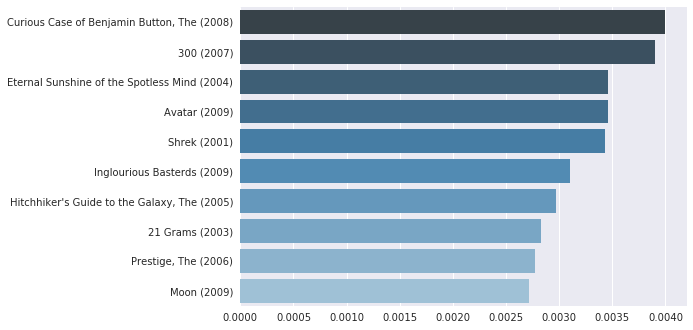

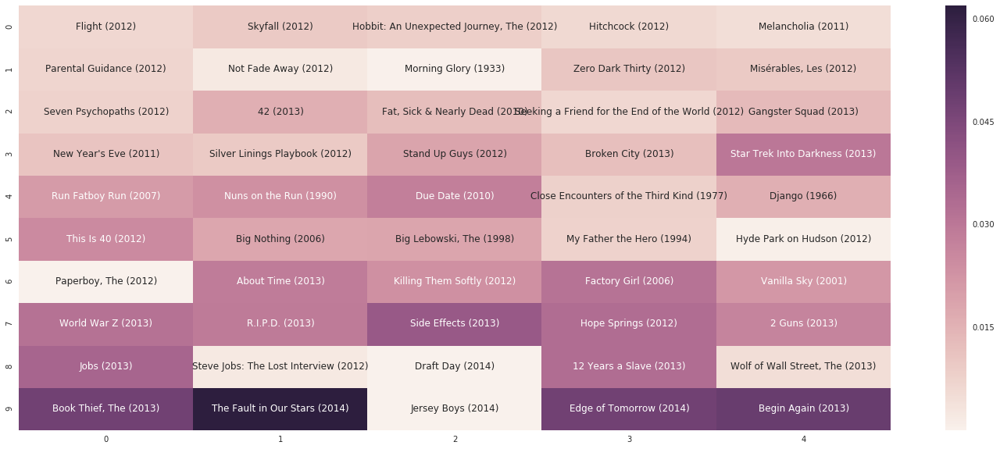

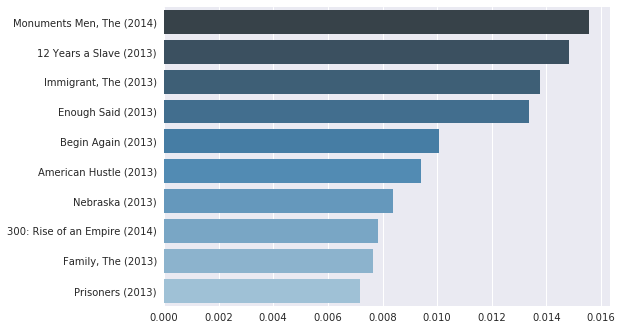

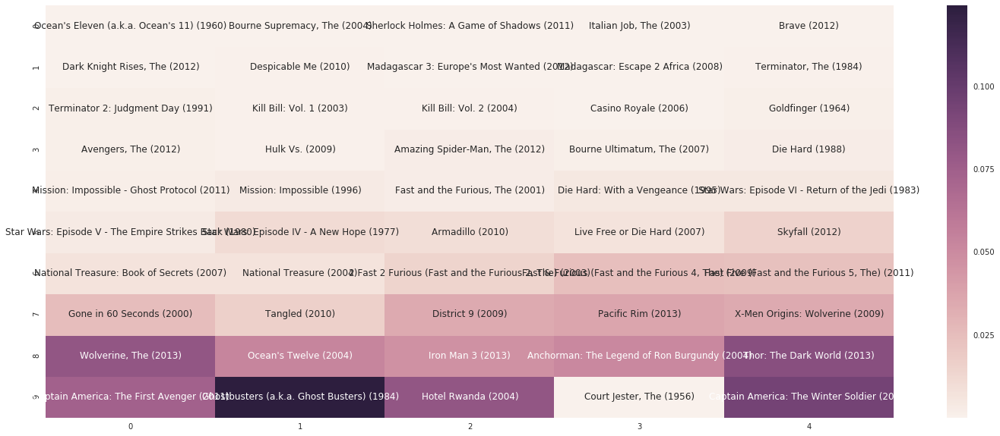

correct_predicted: ['Star Trek Into Darkness (2013)', 'X-Men: Days of Future Past (2014)']
true_movies: ['Adventures of Ichabod and Mr. Toad, The (1949)', 'Sandlot, The (1993)', 'Anastasia (1997)', 'Elf (2003)', 'Brave Little Toaster, The (1987)', "Lemony Snicket's A Series of Unfortunate Events (2004)", 'Chronicles of Narnia: Prince Caspian, The (2008)', 'Lion King 1½, The (2004)', 'Homeward Bound: The Incredible Journey (1993)', 'Galaxy Quest (1999)', 'Miss Congeniality (2000)', 'Napoleon Dynamite (2004)', 'How the Grinch Stole Christmas (a.k.a. The Grinch) (2000)', 'Pride & Prejudice (2005)', 'Open Season (2006)', 'Sleeping Beauty (1959)', 'Guardians of the Galaxy (2014)', 'Spirited Away (Sen to Chihiro no kamikakushi) (2001)', 'X-Men: Days of Future Past (2014)', 'Hunt for Red October, The (1990)', 'Santa Clause, The (1994)', "William Shakespeare's Romeo + Juliet (1996)", 'Italian Job, The (1969)', 'Mission: Impossible II (2000)', 'Fast & Furious 6 (Fast and the Furious 6, The) (20

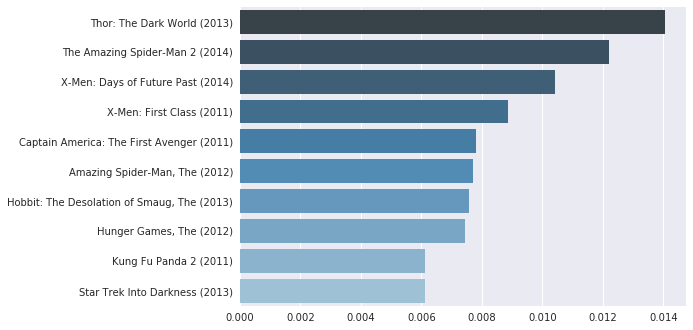

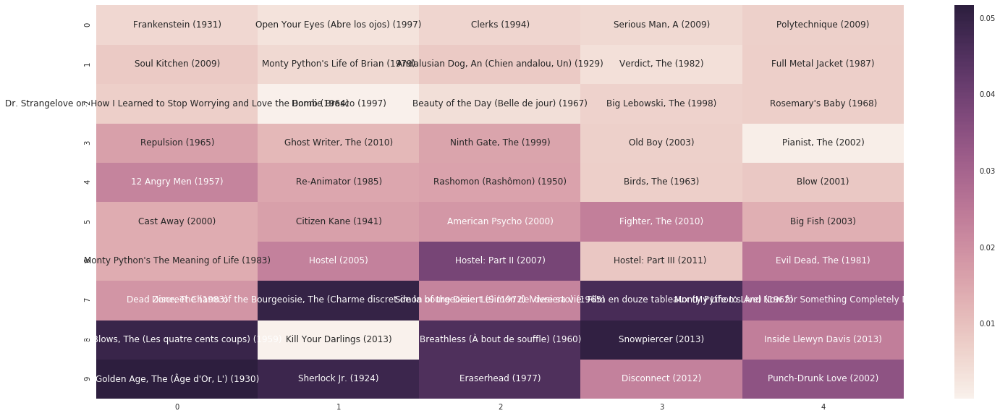

correct_predicted: ['Funny Games (1997)', 'Blue Velvet (1986)']
true_movies: ['Taxidermia (2006)', 'Blue Velvet (1986)', 'That Obscure Object of Desire (Cet obscur objet du désir) (1977)', 'Audition (Ôdishon) (1999)', 'Crash (1996)', 'Videodrome (1983)', 'Skin I Live In, The (La piel que habito) (2011)', 'Phantom of Liberty, The (Fantôme de la liberté, Le) (1974)', 'Dead Ringers (1988)', 'Dead Man (1995)', 'Elephant (2003)', 'Naked Lunch (1991)', 'Antichrist (2009)', 'Black Swan (2010)', 'Cemetery Man (Dellamorte Dellamore) (1994)', "Jacob's Ladder (1990)", 'Tetsuo, the Ironman (Tetsuo) (1988)', 'Down by Law (1986)', "Schindler's List (1993)", 'Godfather: Part II, The (1974)', 'City of God (Cidade de Deus) (2002)', 'Life Is Beautiful (La Vita è bella) (1997)', 'Seven Samurai (Shichinin no samurai) (1954)', 'Blade Runner (1982)', 'Eternal Sunshine of the Spotless Mind (2004)', 'Great Escape, The (1963)', 'Yojimbo (1961)', 'Bicycle Thieves (a.k.a. The Bicycle Thief) (a.k.a. The Bicycle T

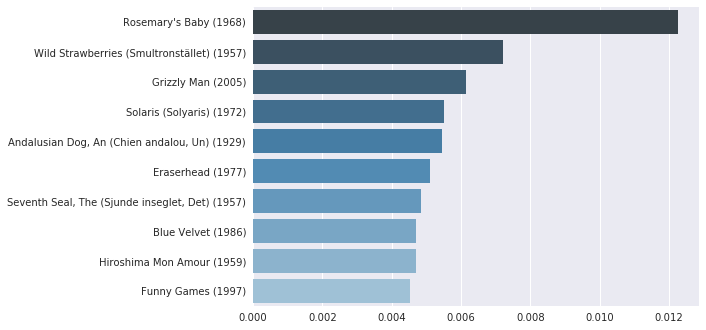

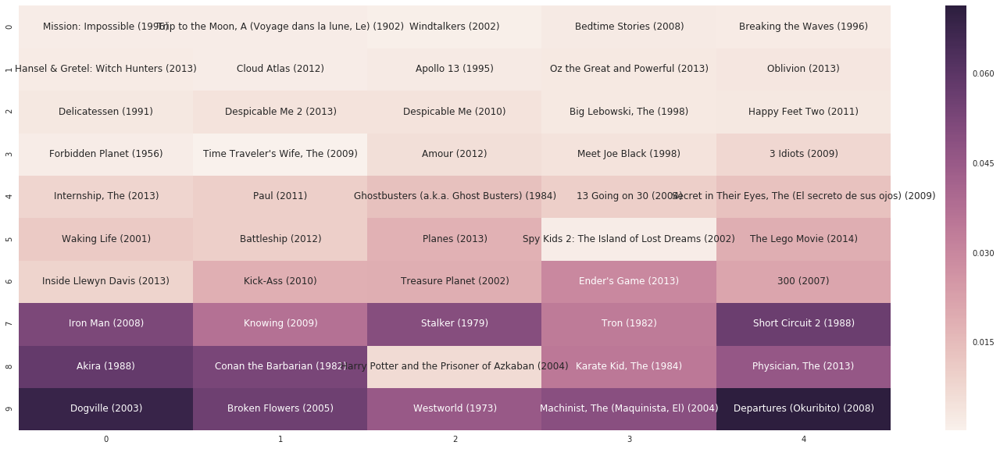

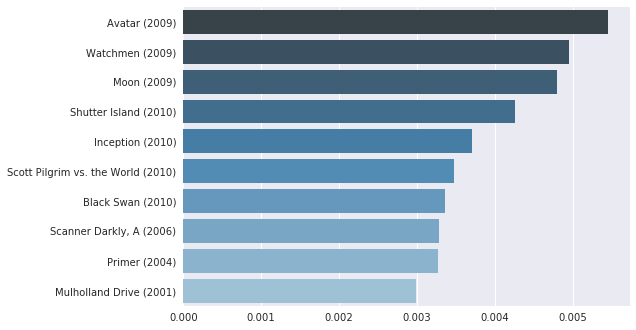

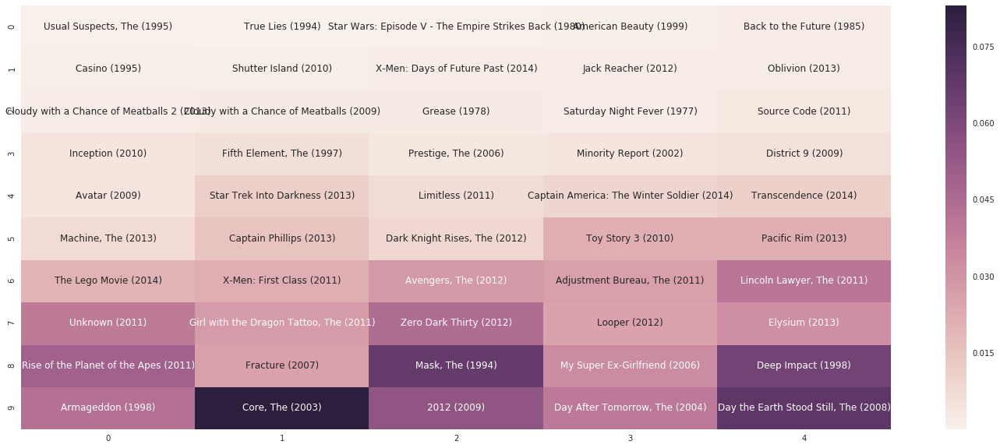

correct_predicted: ['Thor (2011)']
true_movies: ['Memento (2000)', 'X-Men (2000)', 'Crouching Tiger, Hidden Dragon (Wo hu cang long) (2000)', 'Monsters, Inc. (2001)', 'Finding Nemo (2003)', "Ocean's Eleven (2001)", 'Spider-Man (2002)', 'Dark Knight, The (2008)', 'Guardians of the Galaxy (2014)', 'Fight Club (1999)', 'Snatch (2000)', 'Mission: Impossible II (2000)', 'Chicken Run (2000)', "Charlie's Angels (2000)", 'Star Wars: Episode II - Attack of the Clones (2002)', 'Shrek (2001)', 'No Strings Attached (2011)', 'Iron Man 3 (2013)', 'Incredible Hulk, The (2008)', 'Wolverine, The (2013)', 'Hancock (2008)', 'Daredevil (2003)', 'Live Free or Die Hard (2007)', 'Amazing Spider-Man, The (2012)', 'Transporter 2 (2005)', 'Thor (2011)', 'Red (2010)', 'Green Hornet, The (2011)', 'Man of Steel (2013)', 'Jumper (2008)', 'X-Men: The Last Stand (2006)', 'Hulk (2003)', 'League of Extraordinary Gentlemen, The (a.k.a. LXG) (2003)', 'From Paris with Love (2010)', 'Fast & Furious 6 (Fast and the Furious 

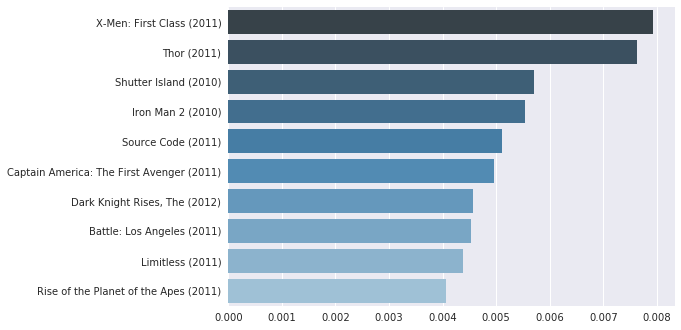

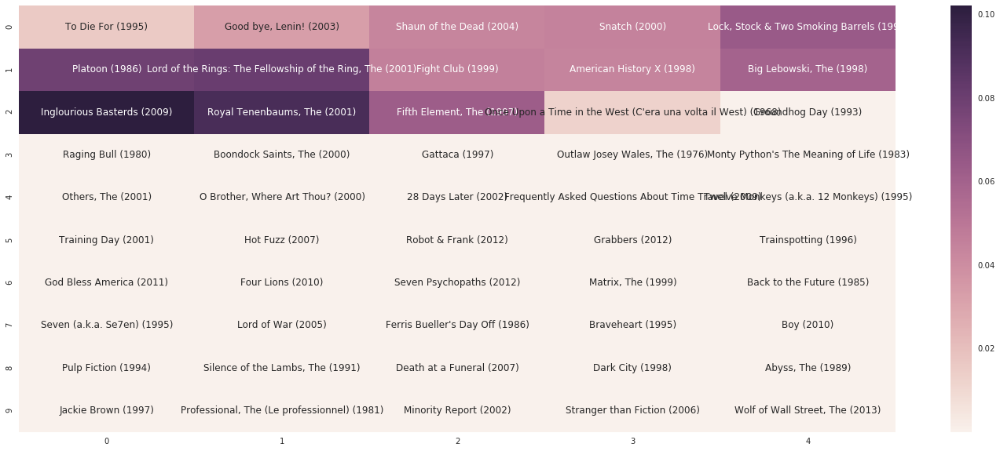

correct_predicted: ['Donnie Darko (2001)', 'Sin City (2005)']
true_movies: ['Donnie Darko (2001)', 'Sin City (2005)', 'Usual Suspects, The (1995)', 'Lord of the Rings: The Return of the King, The (2003)', 'Reservoir Dogs (1992)', 'Lord of the Rings: The Two Towers, The (2002)', 'Apocalypse Now (1979)', 'Taxi Driver (1976)', 'Graduate, The (1967)', "One Flew Over the Cuckoo's Nest (1975)", 'Blade Runner (1982)', 'Godfather, The (1972)', 'Memento (2000)', 'Birdman (2014)', 'Predestination (2014)']


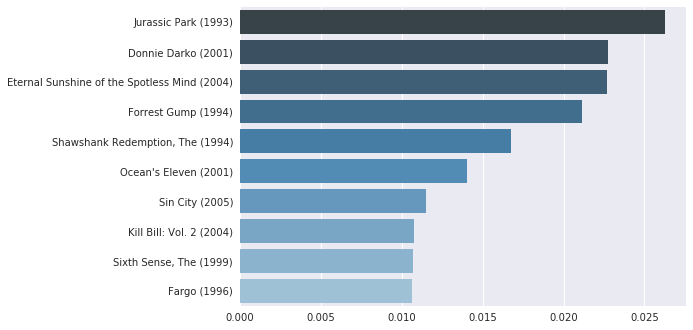

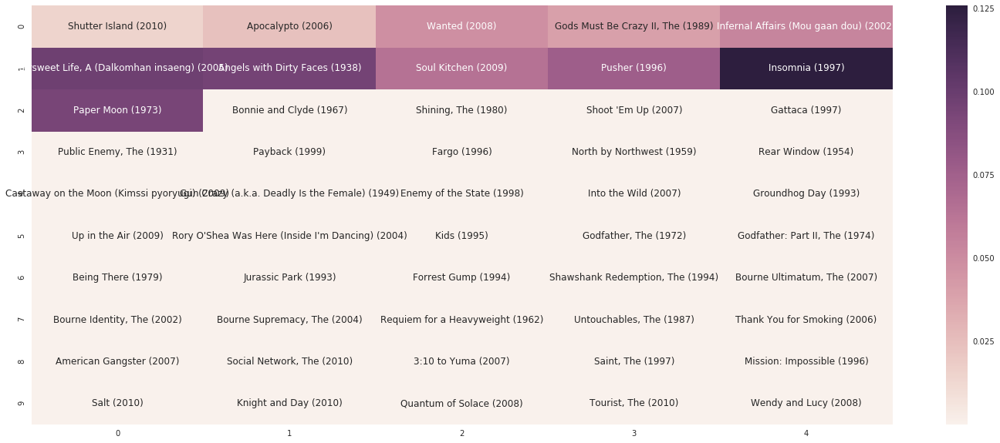

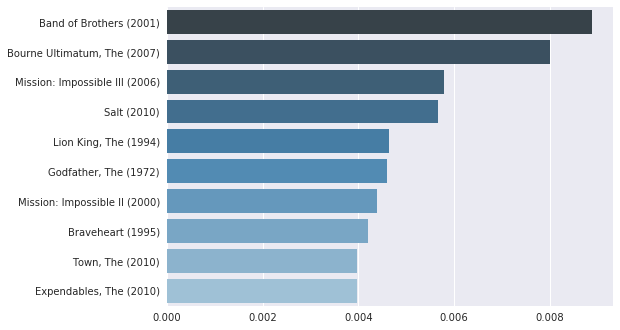

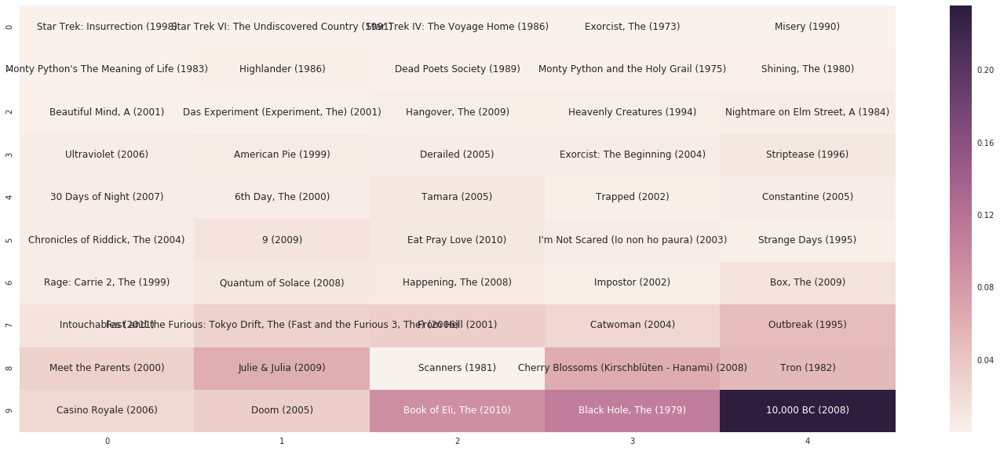

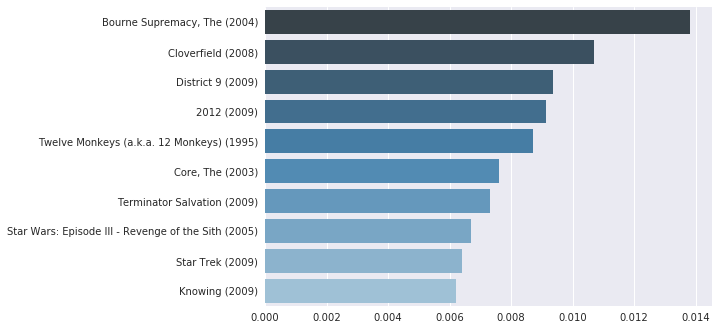

...

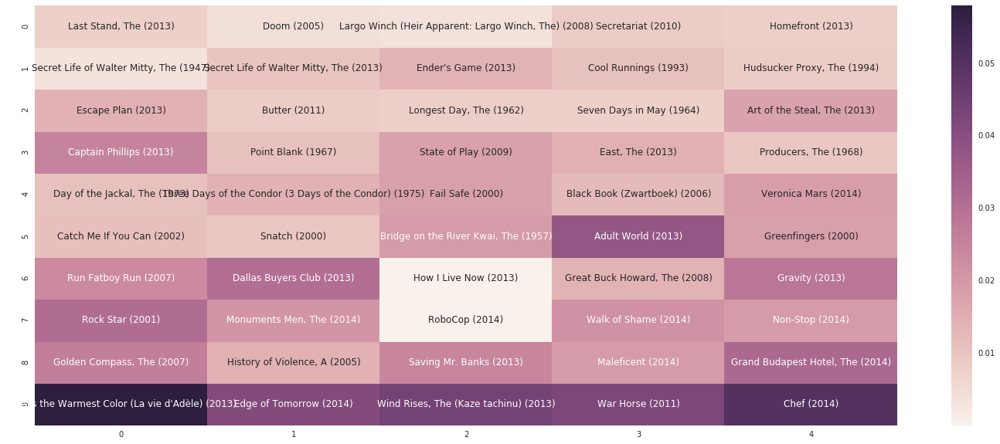

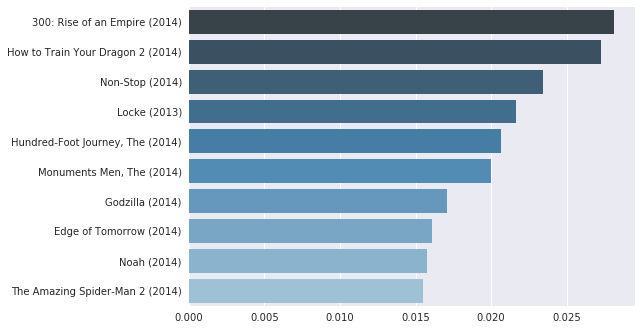

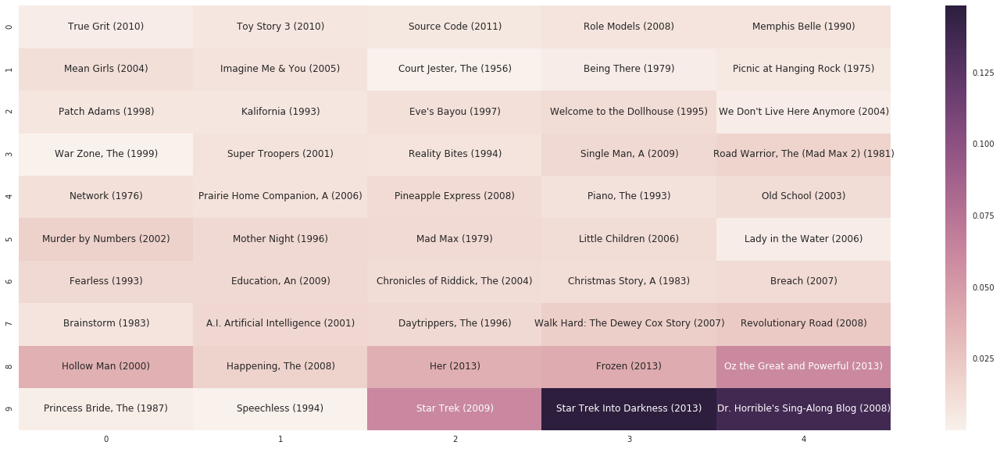

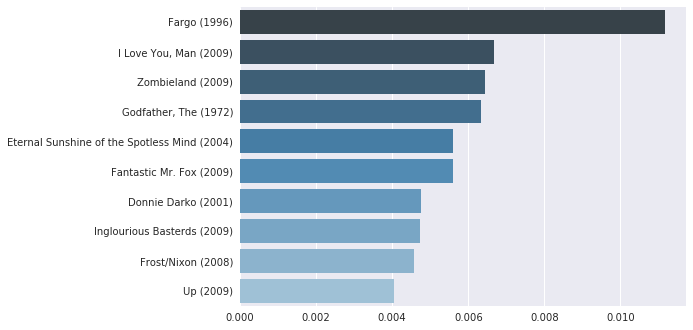

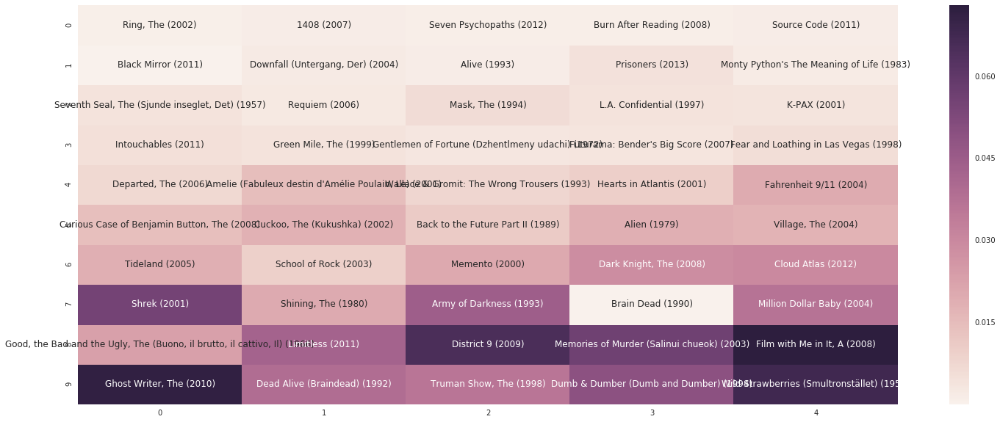

correct_predicted: ['Shutter Island (2010)', 'Inglourious Basterds (2009)']
true_movies: ['Band of Brothers (2001)', 'Big Bang Theory, The (2007-)', 'Tucker & Dale vs Evil (2010)', 'Barber of Siberia, The (Sibirskij tsiryulnik) (1998)', 'Aladdin (1992)', 'Beauty and the Beast (1991)', 'Thirteenth Floor, The (1999)', 'Skeleton Key, The (2005)', 'Dallas Buyers Club (2013)', 'Europa Report (2013)', 'Mama (2013)', 'Sinister (2012)', 'Cabin in the Woods, The (2012)', 'Girl with the Dragon Tattoo, The (2011)', 'Black Swan (2010)', 'Shutter Island (2010)', 'Inglourious Basterds (2009)', 'Secret in Their Eyes, The (El secreto de sus ojos) (2009)', 'Drag Me to Hell (2009)', 'Gran Torino (2008)', 'WALL·E (2008)', 'Indiana Jones and the Kingdom of the Crystal Skull (2008)', 'In Bruges (2008)', 'Cloverfield (2008)', '[REC] (2007)', 'Mist, The (2007)', 'No Country for Old Men (2007)', 'Death at a Funeral (2007)', 'Saw IV (2007)', 'Orphanage, The (Orfanato, El) (2007)', 'Into the Wild (2007)', 'Mong

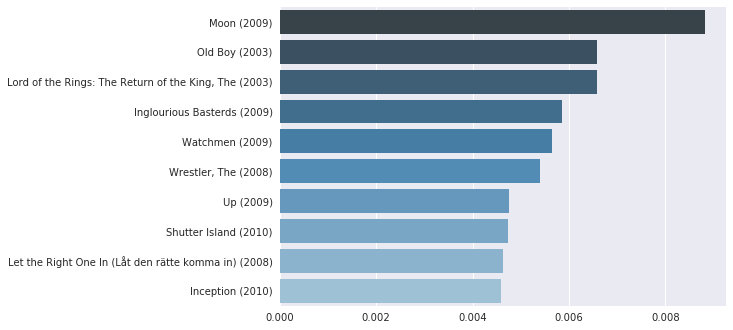

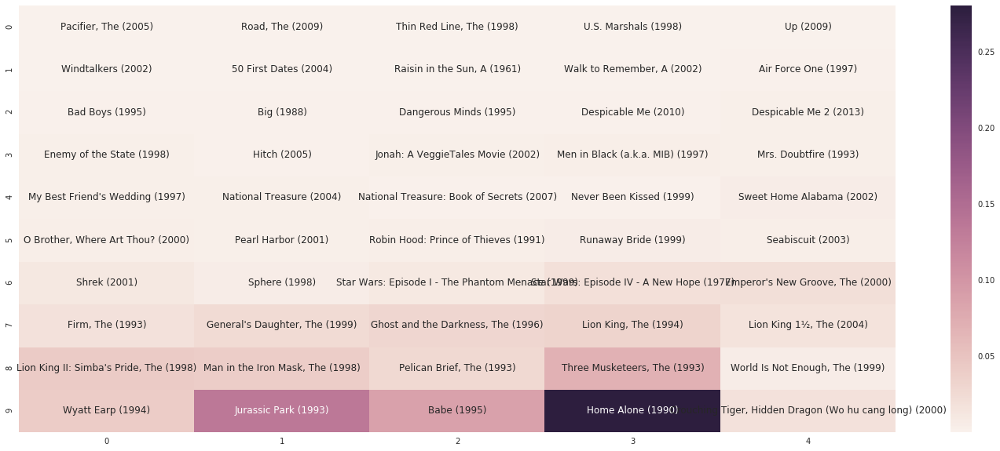

correct_predicted: ['E.T. the Extra-Terrestrial (1982)']
true_movies: ['Flags of Our Fathers (2006)', 'Bridge Too Far, A (1977)', 'Eagle Has Landed, The (1976)', 'Secretariat (2010)', 'All Is Lost (2013)', 'Ben-Hur (1959)', 'Tora! Tora! Tora! (1970)', 'Iron Giant, The (1999)', 'Treasure Planet (2002)', "Bug's Life, A (1998)", 'Secret Garden, The (1993)', 'Sarah, Plain and Tall (1991)', 'In Darkness (2011)', 'Hurt Locker, The (2008)', 'Almost Heroes (1998)', 'For the Birds (2000)', 'Inkheart (2008)', 'Sisterhood of the Traveling Pants, The (2005)', 'Princess Diaries, The (2001)', 'Knick Knack (1989)', 'Pay It Forward (2000)', '12 Angry Men (1957)', 'Slumdog Millionaire (2008)', 'Lifted (2006)', 'Dreamer: Inspired by a True Story (2005)', "Porky's (1982)", 'Book Thief, The (2013)', 'Ghost (1990)', 'X-Men (2000)', 'While You Were Sleeping (1995)', 'Negotiator, The (1998)', 'My Cousin Vinny (1992)', 'Monsters University (2013)', 'Mary Poppins (1964)', 'Heat (1995)', 'Black Beauty (1994)', 

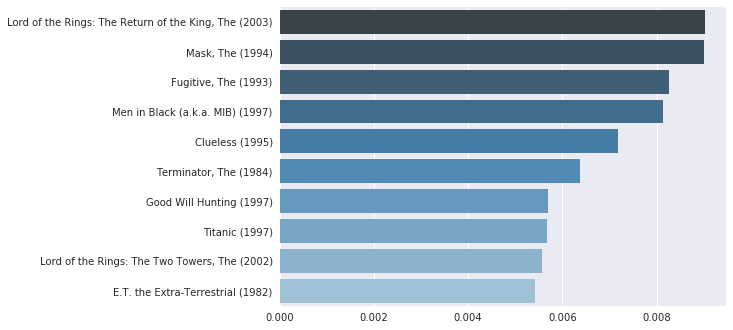

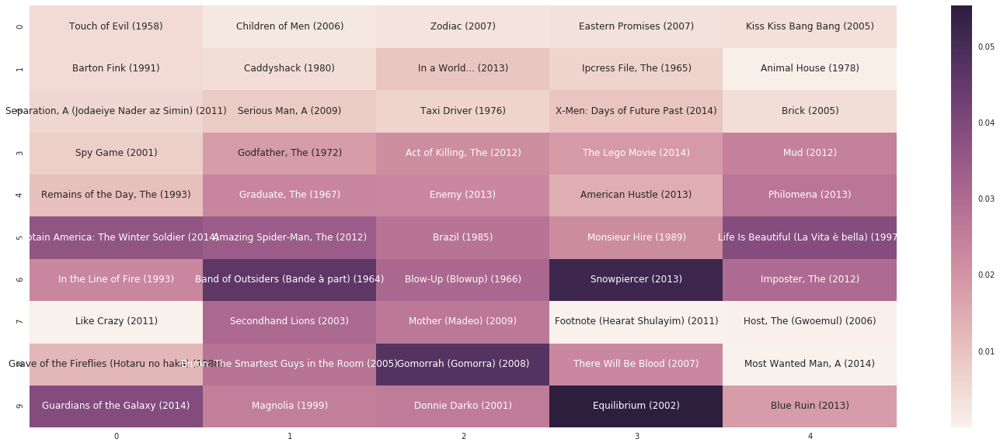

correct_predicted: ['Old Boy (2003)', 'Fargo (1996)', 'Edge of Tomorrow (2014)']
true_movies: ['Under the Skin (2013)', 'The Spectacular Now (2013)', 'Chinatown (1974)', 'Pianist, The (2002)', 'Gone Girl (2014)', 'Boogie Nights (1997)', 'Guard, The (2011)', 'Old Boy (2003)', 'Fantastic Mr. Fox (2009)', 'Double, The (2013)', 'Obvious Child (2014)', 'Lebanon (2009)', 'Waltz with Bashir (Vals im Bashir) (2008)', 'Conformist, The (Conformista, Il) (1970)', 'Hiroshima Mon Amour (1959)', 'Nightcrawler (2014)', 'Monty Python and the Holy Grail (1975)', 'Walk on Water (2004)', 'Dr. Strangelove or: How I Learned to Stop Worrying and Love the Bomb (1964)', 'Blade Runner (1982)', 'Matrix, The (1999)', 'Manchurian Candidate, The (1962)', "Once Upon a Time in the West (C'era una volta il West) (1968)", 'Princess Bride, The (1987)', "One Flew Over the Cuckoo's Nest (1975)", "Ferris Bueller's Day Off (1986)", 'Meet the Robinsons (2007)', 'Election (1999)', 'Holy Guests (Ha-Ushpizin) (2004)', 'Interst

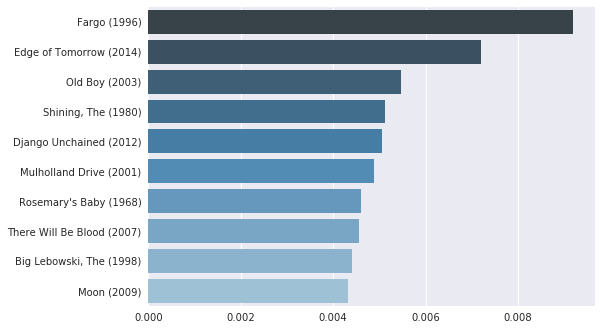

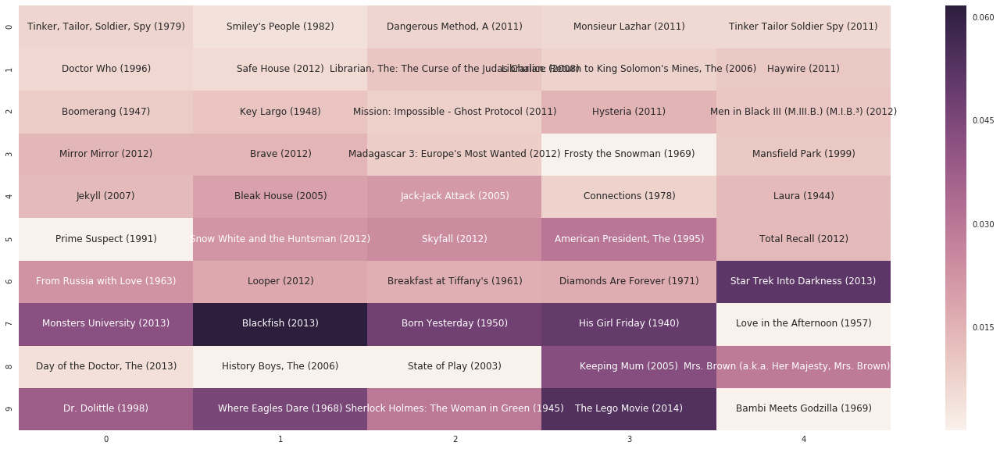

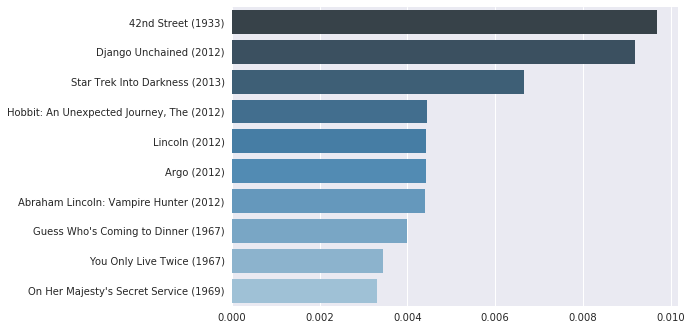

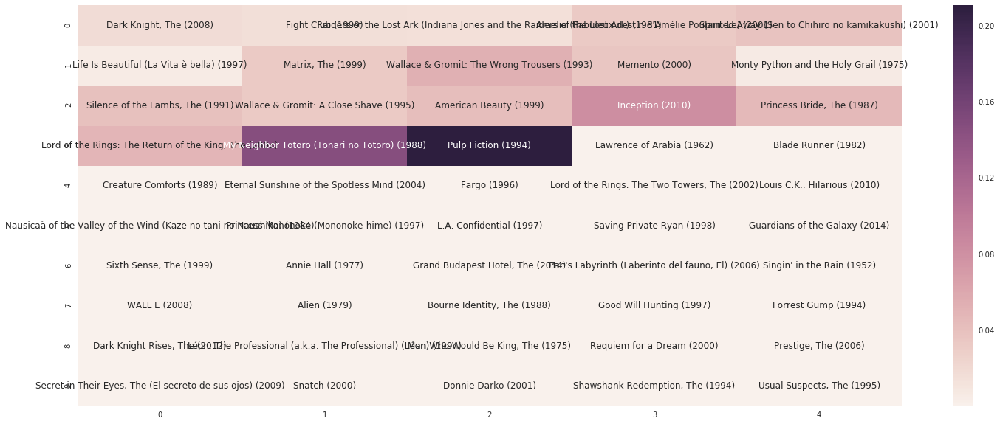

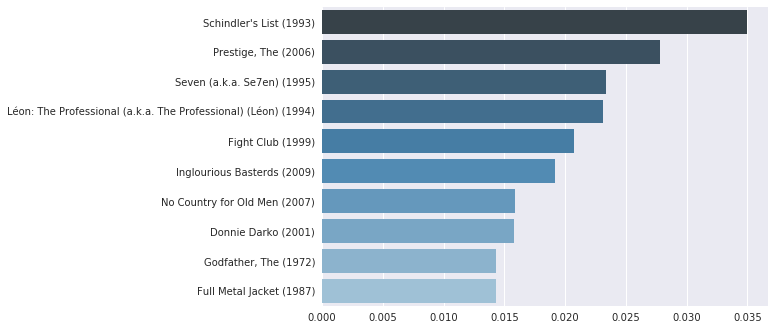

...

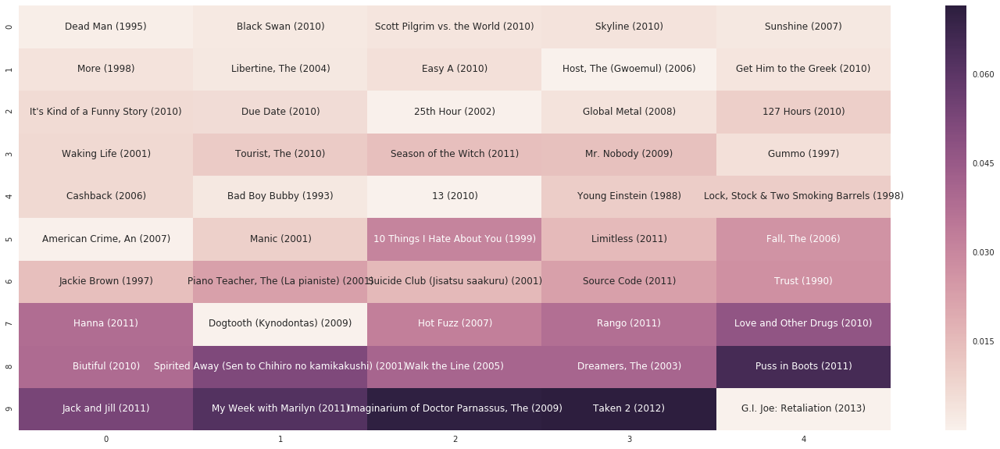

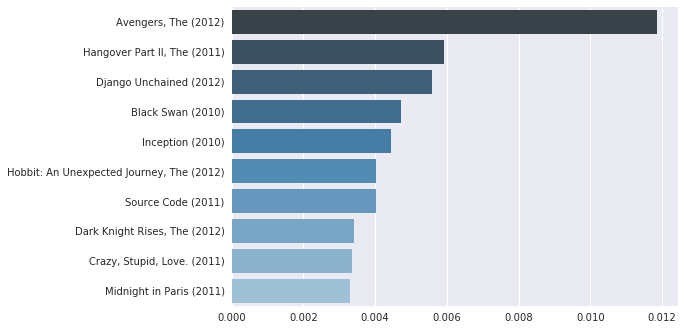

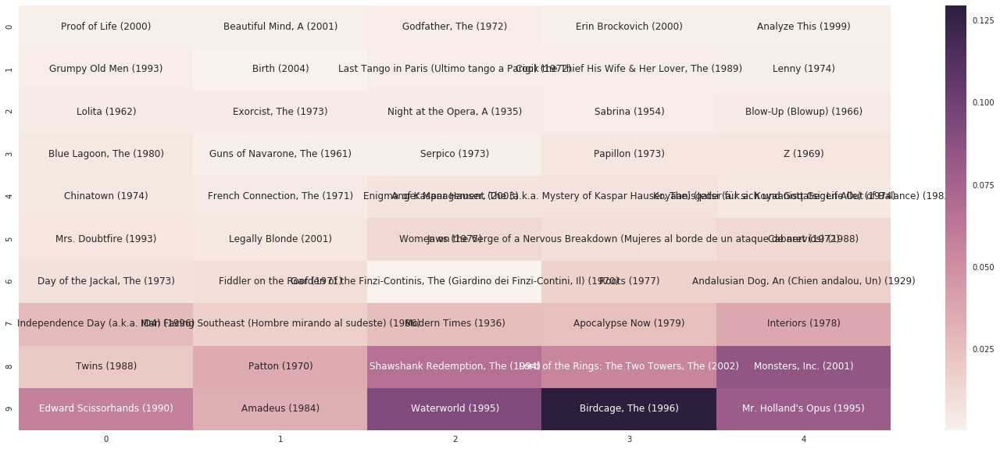

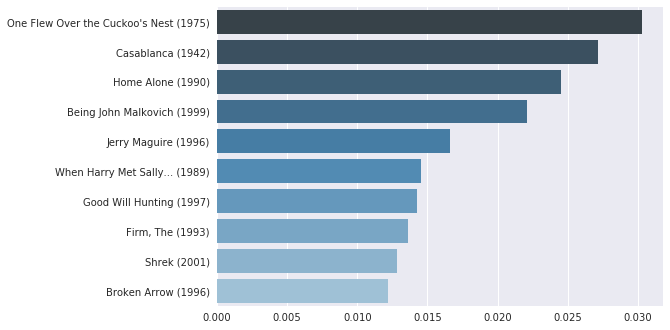

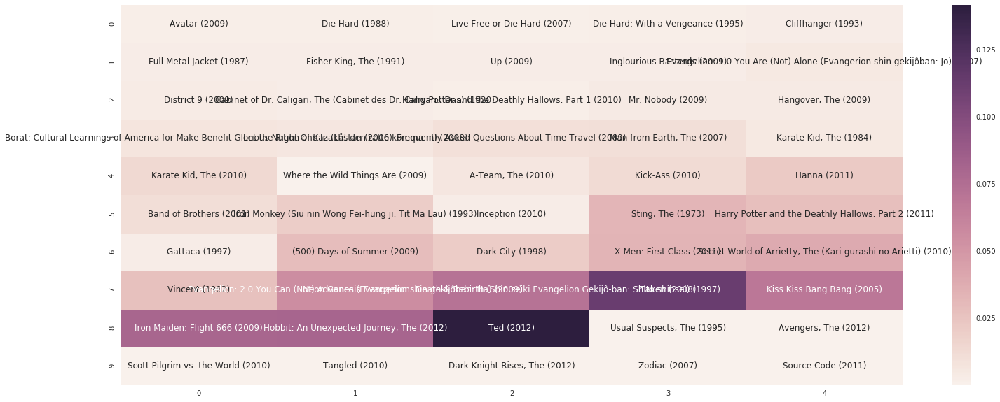

correct_predicted: ['Sherlock Holmes: A Game of Shadows (2011)', 'Looper (2012)']
true_movies: ['Interstellar (2014)', 'Looper (2012)', 'Star Trek II: The Wrath of Khan (1982)', 'Sherlock Holmes: A Game of Shadows (2011)']


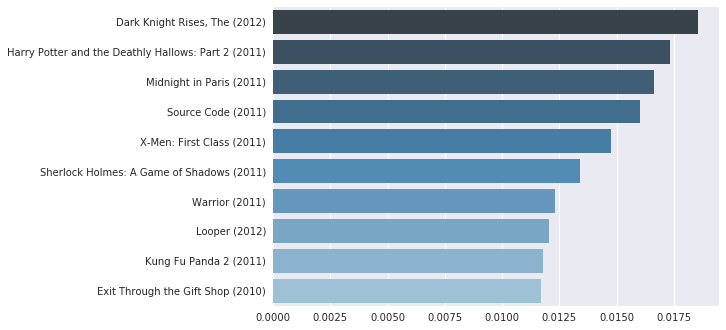

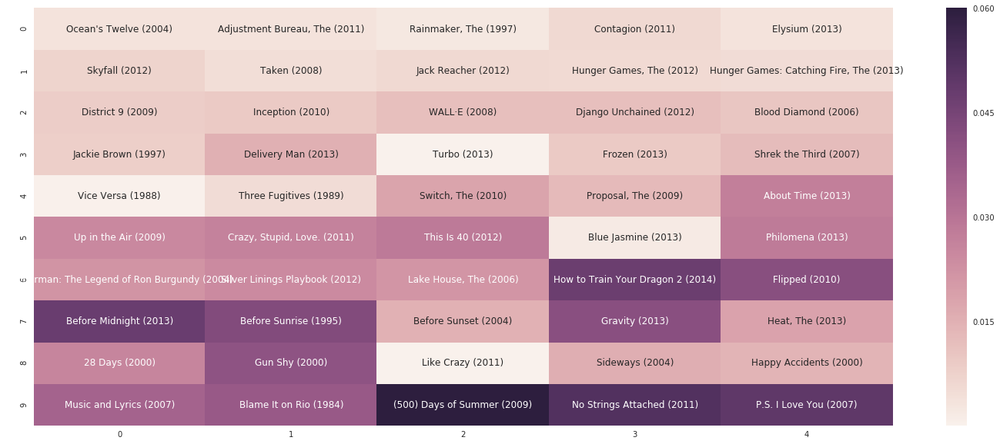

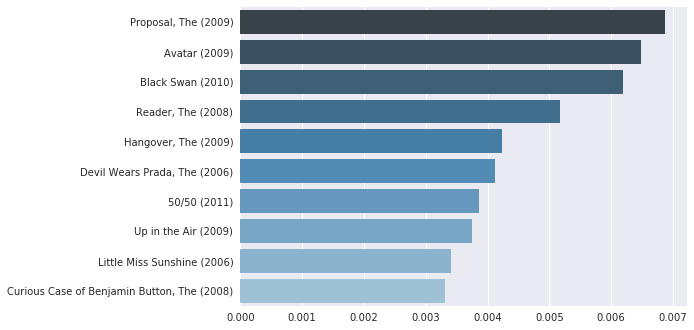

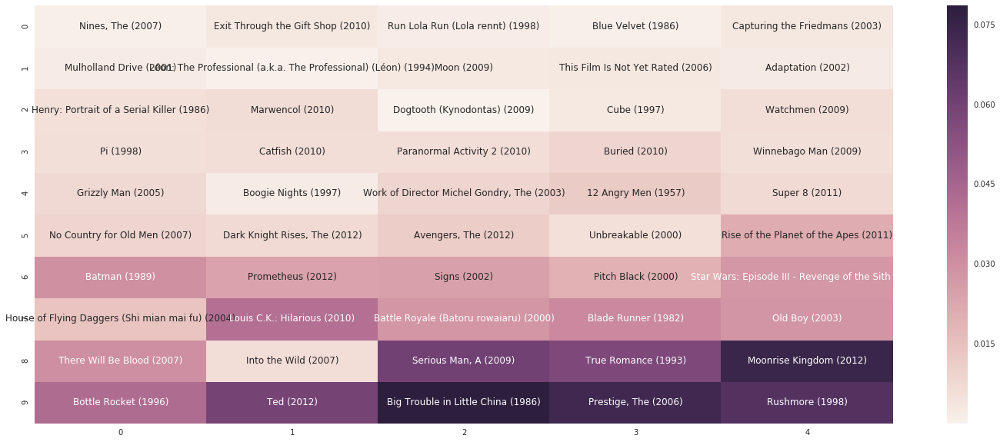

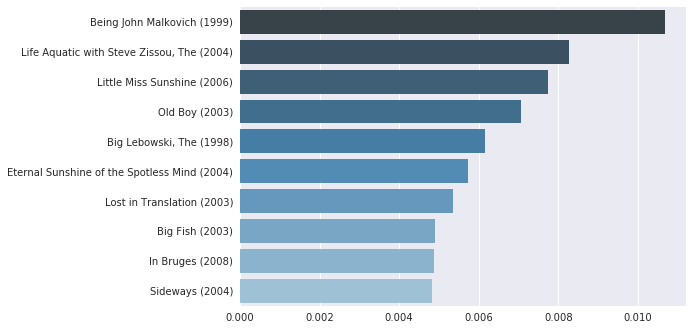

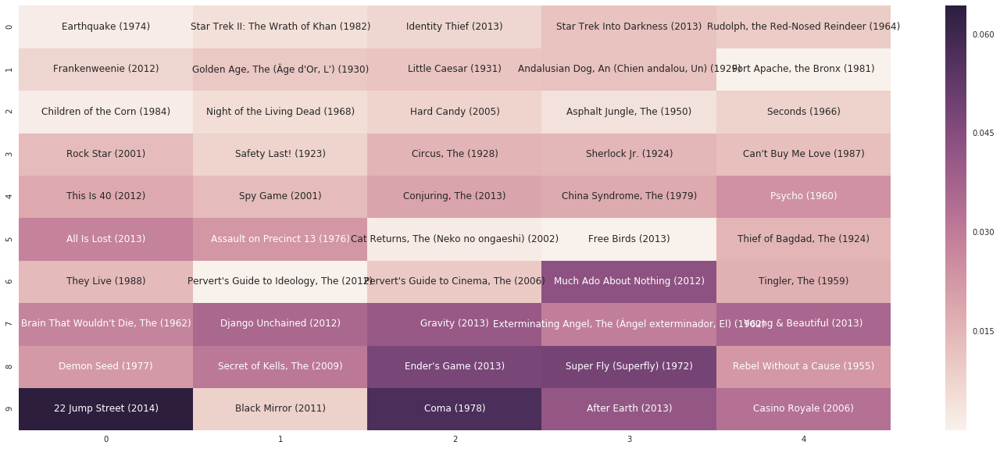

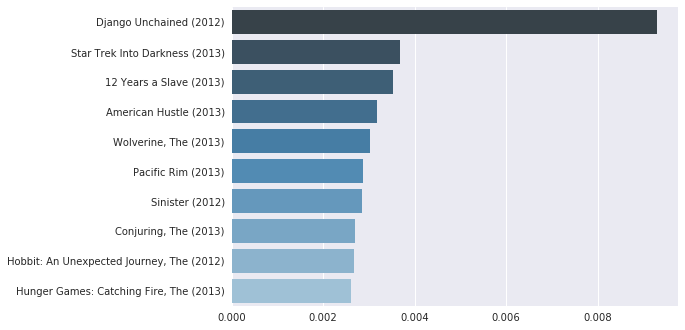

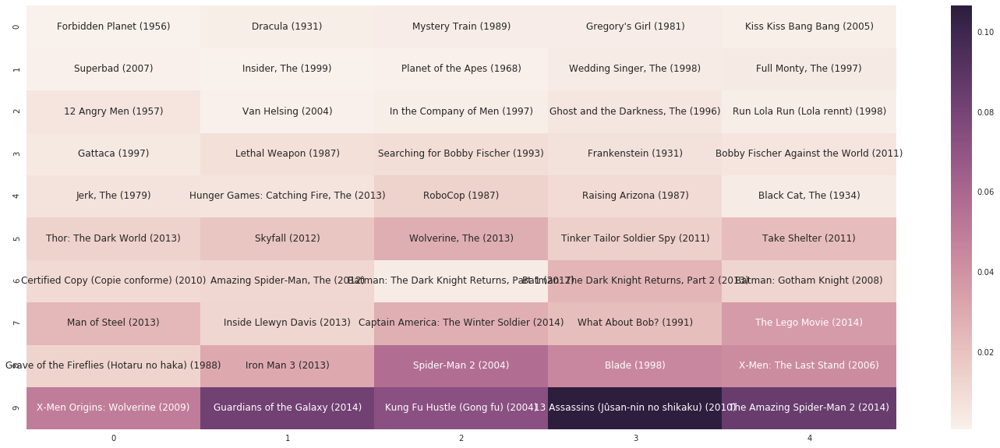

correct_predicted: ['Hobbit: The Desolation of Smaug, The (2013)']
true_movies: ['Uninvited, The (1944)', 'Godzilla (2014)', 'Cast Away (2000)', 'Hobbit: The Desolation of Smaug, The (2013)', 'Interstellar (2014)', 'Clue (1985)', 'The Hunger Games: Mockingjay - Part 1 (2014)', 'Moonrise Kingdom (2012)', 'Grand Budapest Hotel, The (2014)', 'Thief (1981)']


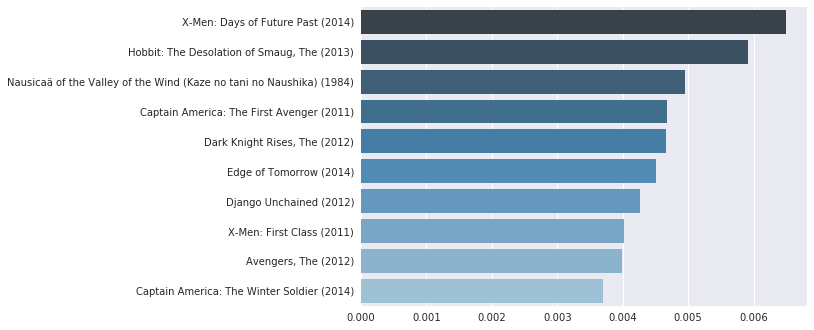

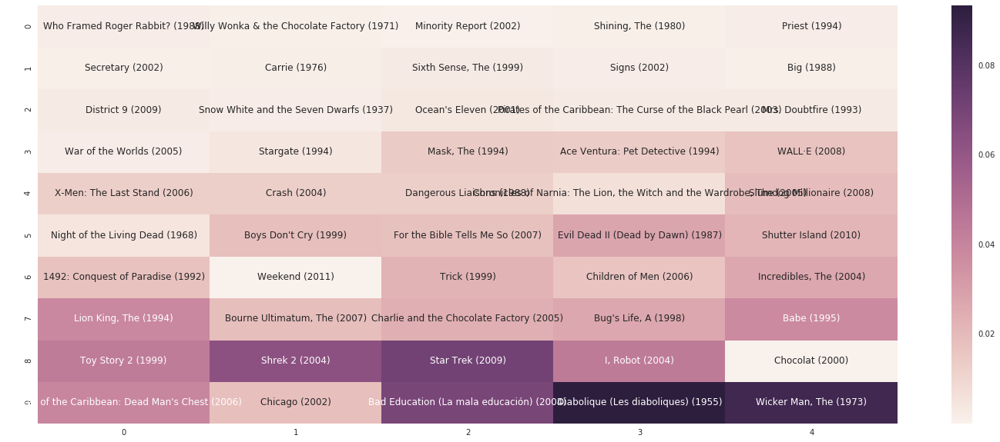

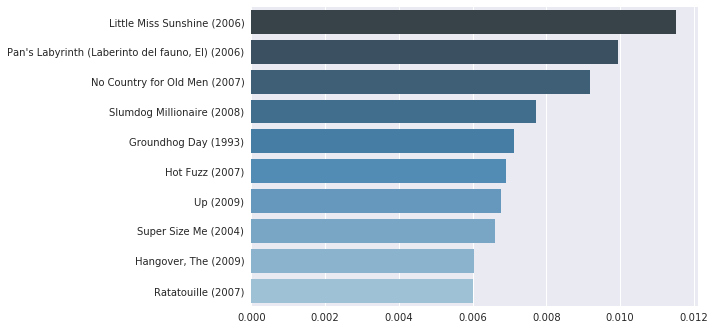

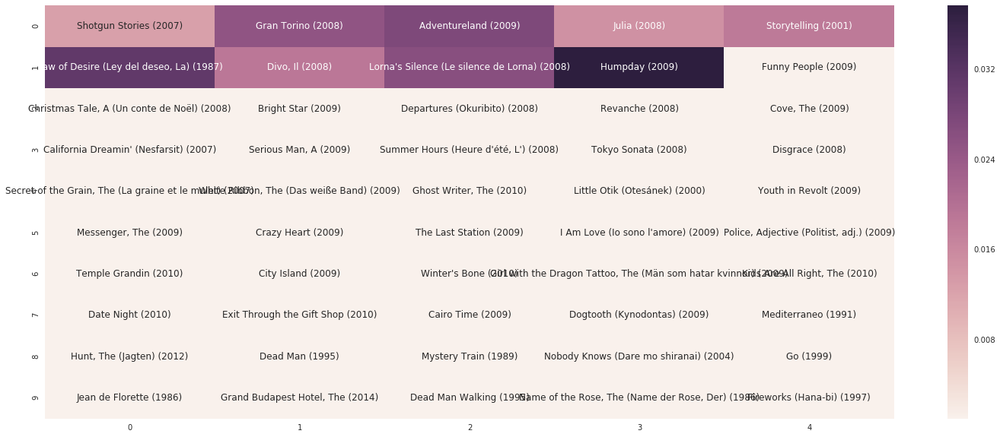

correct_predicted: ['Secret in Their Eyes, The (El secreto de sus ojos) (2009)']
true_movies: ['Bad Words (2013)', "Blue Is the Warmest Color (La vie d'Adèle) (2013)", 'Her (2013)', 'All About My Mother (Todo sobre mi madre) (1999)', "Boys Don't Cry (1999)", 'Venus in Fur (La Vénus à la fourrure) (2013)', 'Nymphomaniac: Volume I (2013)', 'Nymphomaniac: Volume II (2013)', 'Melancholia (2011)', 'Badlands (1973)', 'Constant Gardener, The (2005)', 'Love and Death (1975)', 'Secret in Their Eyes, The (El secreto de sus ojos) (2009)', 'Dersu Uzala (1975)', 'Moonrise Kingdom (2012)']


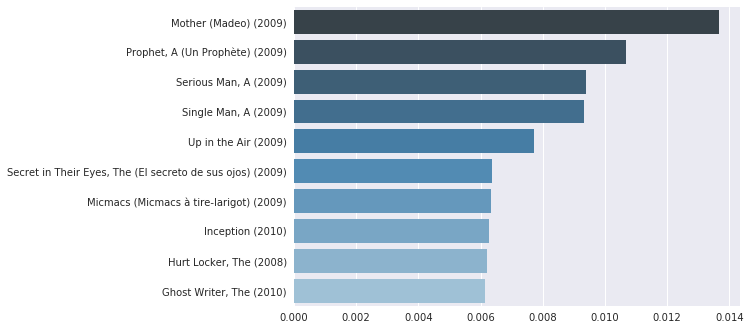

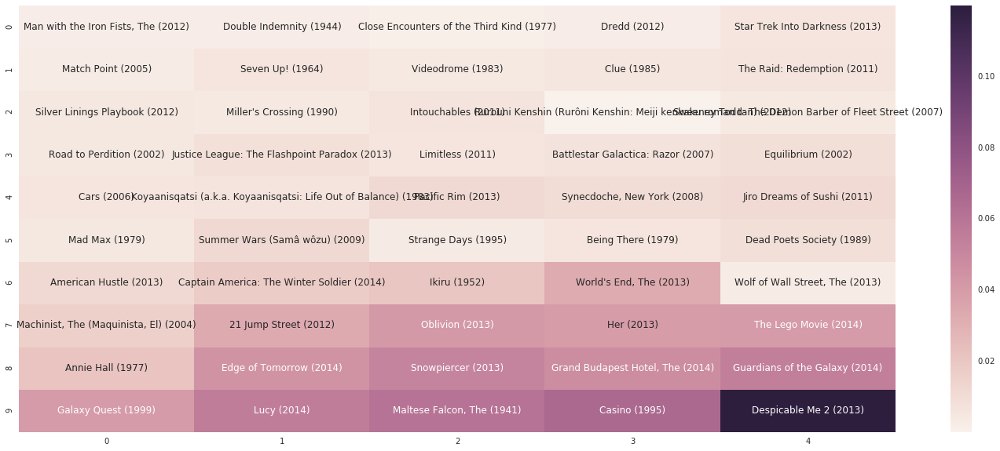

correct_predicted: ['X-Men: Days of Future Past (2014)']
true_movies: ['The Raid 2: Berandal (2014)', 'Day of the Doctor, The (2013)', 'Artist, The (2011)', 'Hot Rod (2007)', 'In Bruges (2008)', 'Cabin in the Woods, The (2012)', 'Best in Show (2000)', 'In a World... (2013)', 'Drinking Buddies (2013)', 'Upside Down (2012)', 'X-Men: Days of Future Past (2014)', 'Black Mirror (2011)', 'Don Jon (2013)', 'Birdman (2014)', 'Song of the Sea (2014)', 'In Time (2011)', 'Jupiter Ascending (2015)']


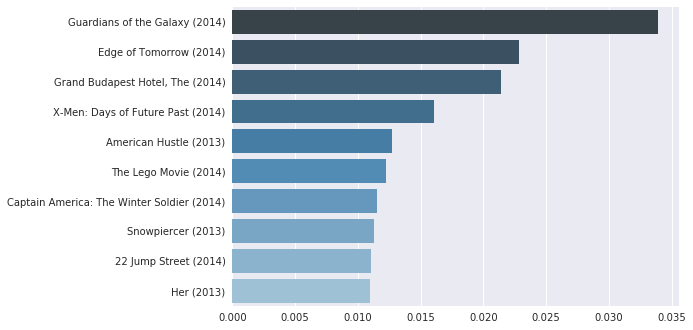

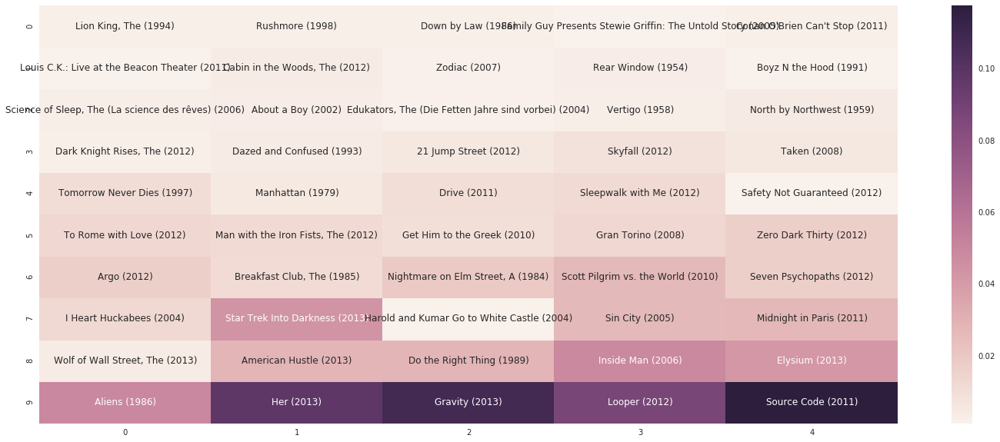

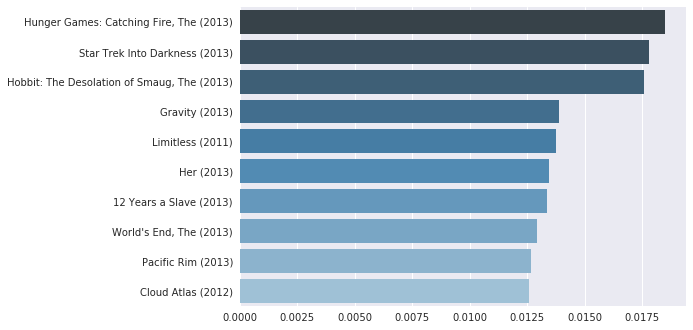

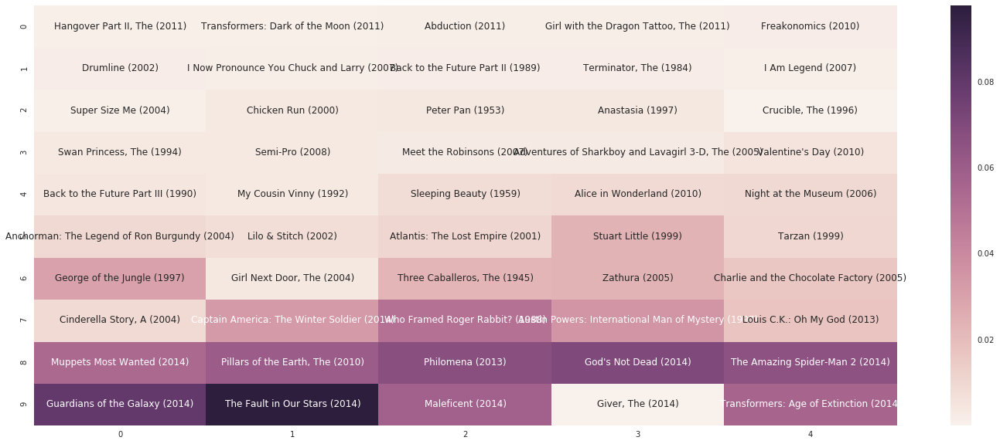

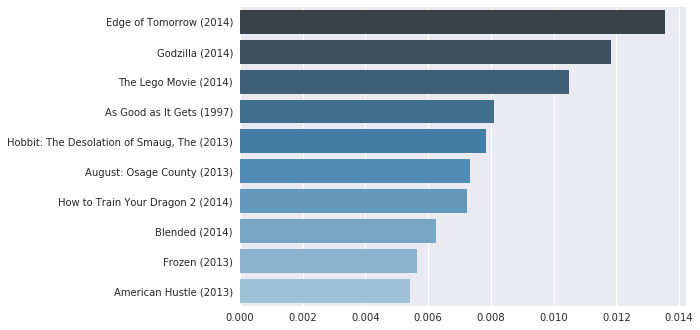

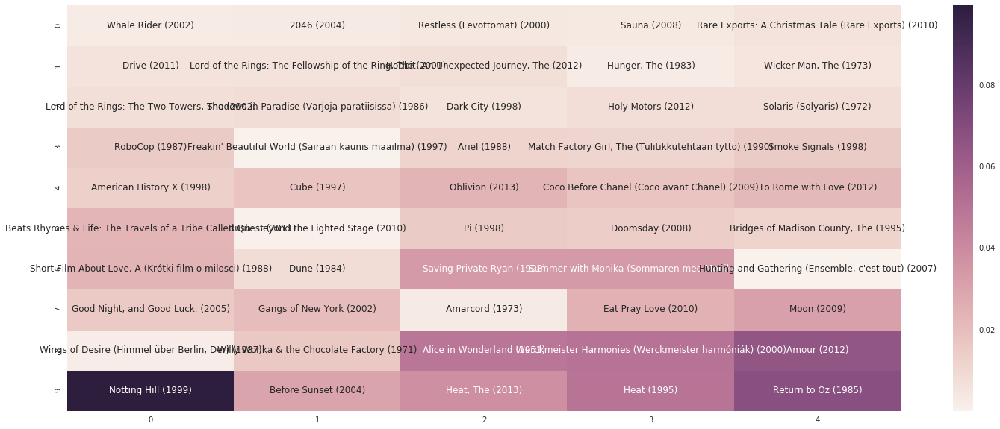

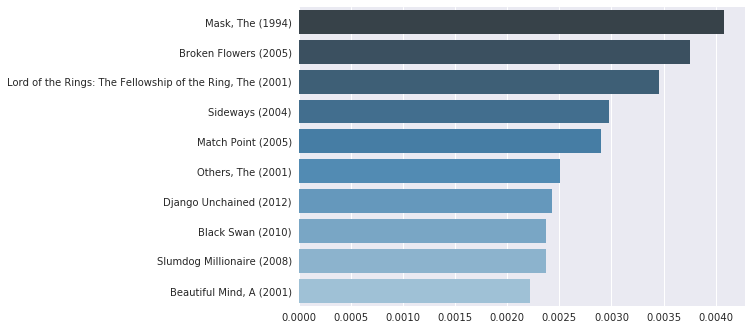

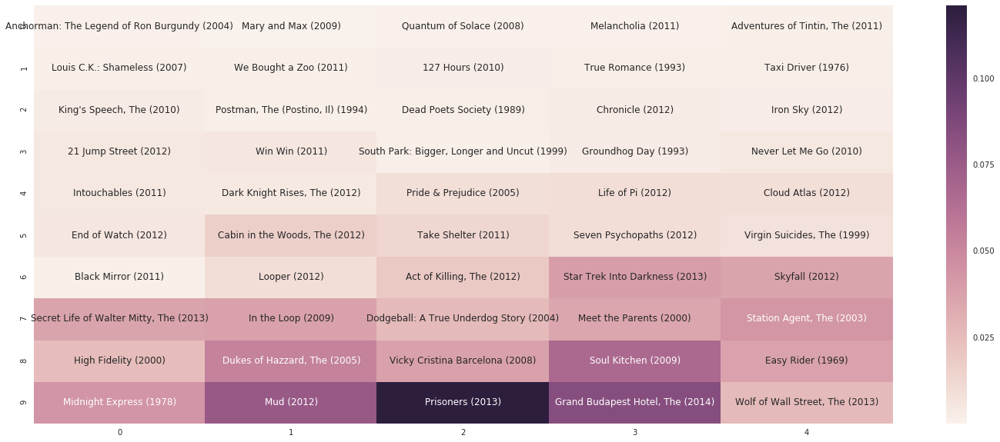

correct_predicted: ['12 Years a Slave (2013)', 'Django Unchained (2012)', 'Gravity (2013)', 'Dallas Buyers Club (2013)']
true_movies: ['Gravity (2013)', 'Memento (2000)', 'Crank (2006)', 'Interstate 60 (2002)', 'Black Swan (2010)', 'Apocalypse Now (1979)', 'V for Vendetta (2006)', 'London (2005)', 'Good Will Hunting (1997)', 'Edge of Tomorrow (2014)', 'Prestige, The (2006)', 'Moulin Rouge (2001)', 'Road, The (2009)', 'Secondhand Lions (2003)', 'Borat: Cultural Learnings of America for Make Benefit Glorious Nation of Kazakhstan (2006)', 'Vanilla Sky (2001)', 'Hesher (2010)', '3-Iron (Bin-jip) (2004)', 'Guardians of the Galaxy (2014)', 'Interstellar (2014)', 'K-PAX (2001)', 'Django Unchained (2012)', 'Cosmos (1980)', 'Midnight in Paris (2011)', 'Prometheus (2012)', 'Godfather: Part II, The (1974)', 'True Grit (2010)', 'Lost in Translation (2003)', 'Back to the Future (1985)', 'Mr. Nobody (2009)', 'Human Traffic (1999)', 'Happiness (1998)', 'Spider-Man (2002)', 'Cemetery Junction (2010)',

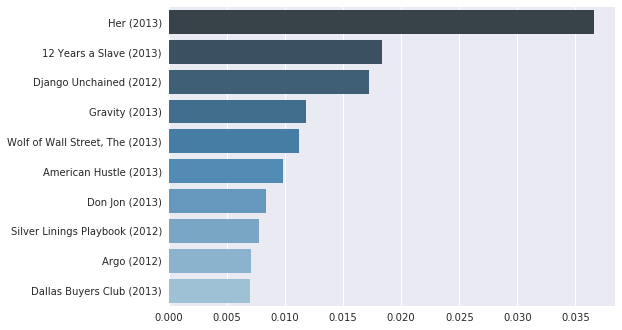

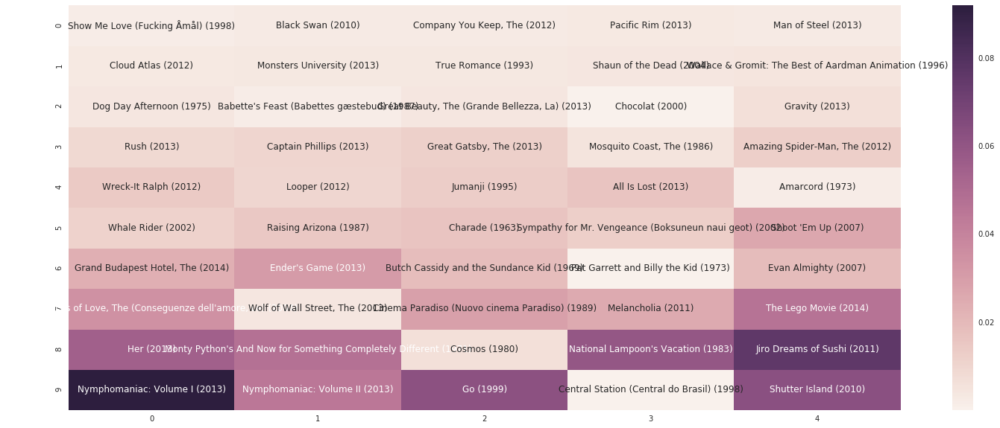

correct_predicted: ['Edge of Tomorrow (2014)']
true_movies: ['Tell No One (Ne le dis à personne) (2006)', 'Gone Girl (2014)', 'Locke (2013)', 'Fury (2014)', 'Sin City: A Dame to Kill For (2014)', 'Nightcrawler (2014)', 'Only Lovers Left Alive (2013)', 'Interstellar (2014)', 'Wild Tales (2014)', 'Theory of Everything, The (2014)', 'Flashdance (1983)', 'Exit Through the Gift Shop (2010)', 'Maps to the Stars (2014)', 'John Wick (2014)', 'Kingsman: The Secret Service (2015)', 'Edge of Tomorrow (2014)', 'Equalizer, The (2014)', 'Dallas Buyers Club (2013)', 'American Sniper (2014)']


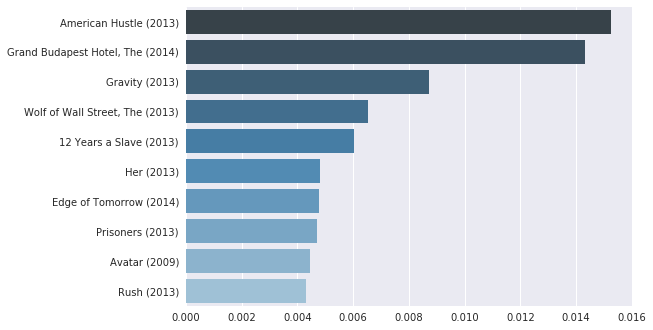

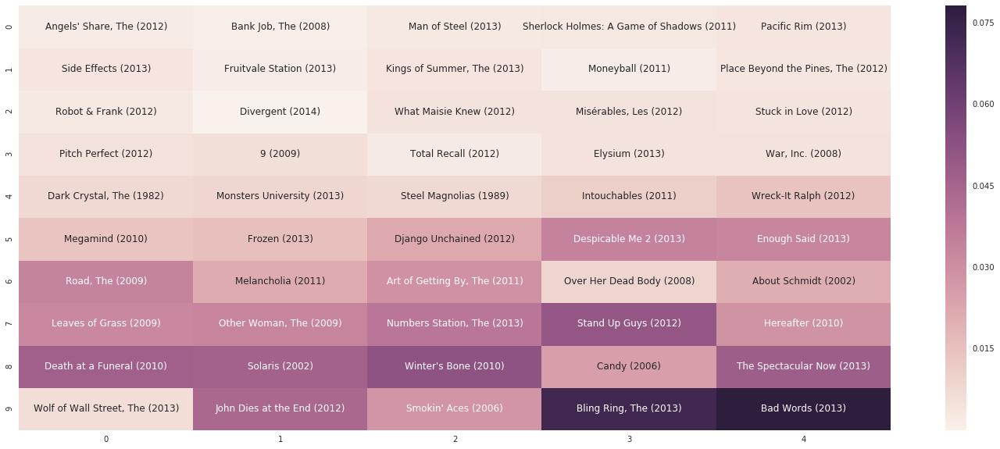

correct_predicted: ['World War Z (2013)', 'Oblivion (2013)', 'This Is the End (2013)']
true_movies: ['Guardians of the Galaxy (2014)', 'If I Stay (2014)', 'Dawn of the Planet of the Apes (2014)', 'Oblivion (2013)', 'Odd Life of Timothy Green, The (2012)', 'Bourne Legacy, The (2012)', '12 Years a Slave (2013)', 'Begin Again (2013)', 'World War Z (2013)', 'Only Lovers Left Alive (2013)', 'August: Osage County (2013)', 'Léon: The Professional (a.k.a. The Professional) (Léon) (1994)', 'Safe Haven (2013)', 'Day of the Doctor, The (2013)', 'Contagion (2011)', 'Wolverine, The (2013)', 'Upside Down (2012)', 'Host, The (2013)', 'Resident Evil: Retribution (2012)', 'After Earth (2013)', 'Watch, The (2012)', 'Purge, The (2013)', 'G.I. Joe: Retaliation (2013)', 'Dylan Dog: Dead of Night (2010)', 'Brüno (Bruno) (2009)', 'Salt (2010)', 'Brave (2012)', 'Seven Psychopaths (2012)', 'Informant!, The (2009)', 'Fast & Furious (Fast and the Furious 4, The) (2009)', 'Now You See Me (2013)', 'Year One (2009)

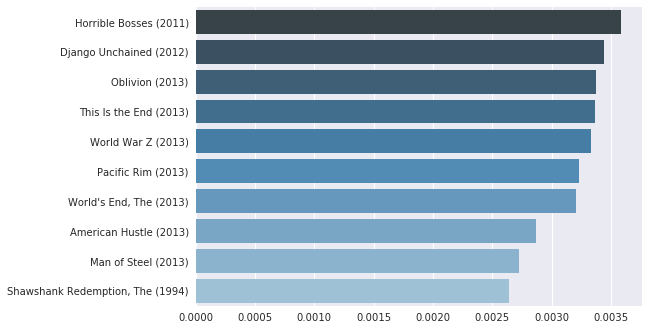

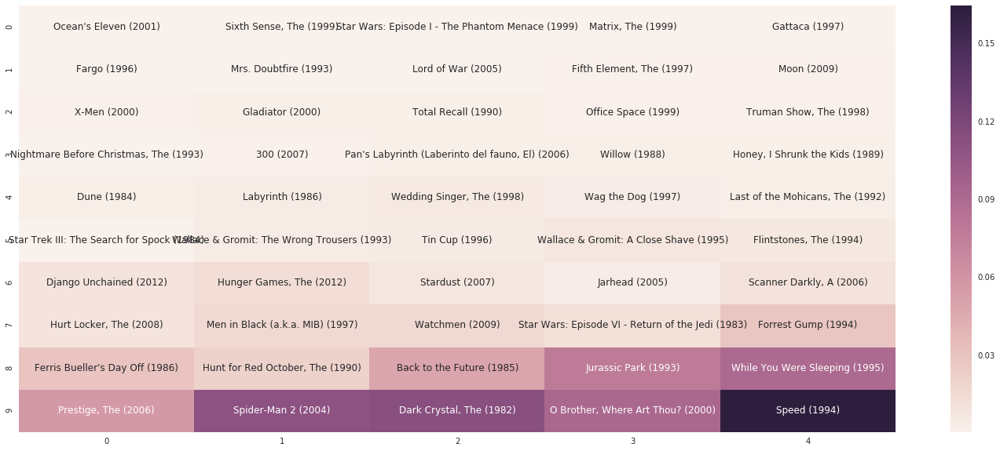

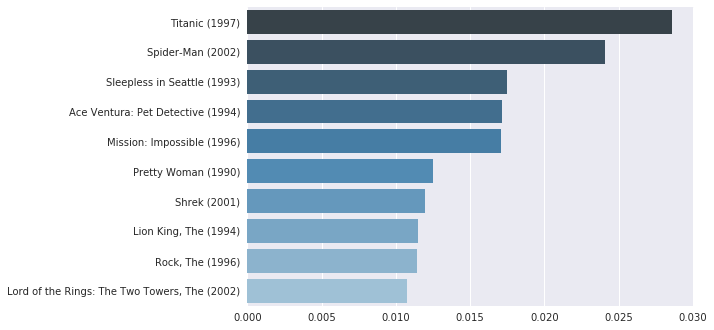

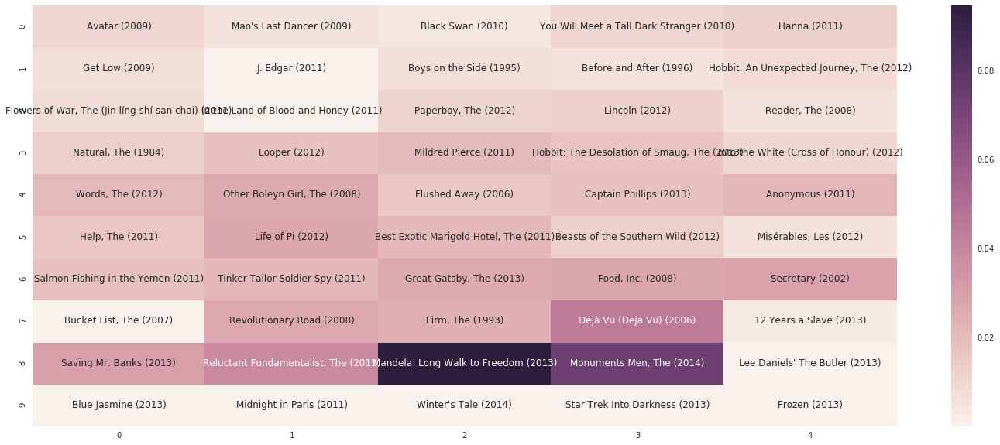

correct_predicted: ['Gravity (2013)']
true_movies: ['Hundred-Foot Journey, The (2014)', 'Labor Day (2013)', 'Grand Budapest Hotel, The (2014)', 'Fruitvale Station (2013)', 'Book Thief, The (2013)', 'Goodbye Solo (2008)', 'Holiday, The (2006)', 'Selma (2014)', 'Jakob the Liar (1999)', 'Gravity (2013)']


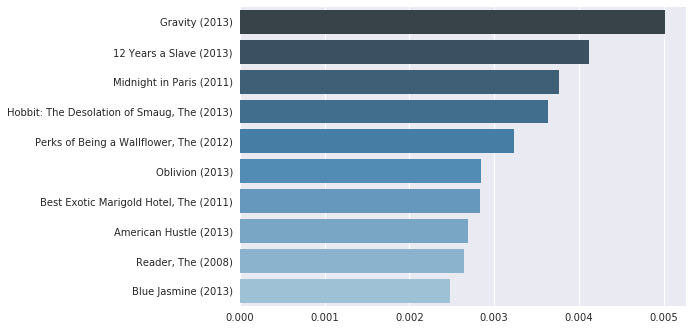

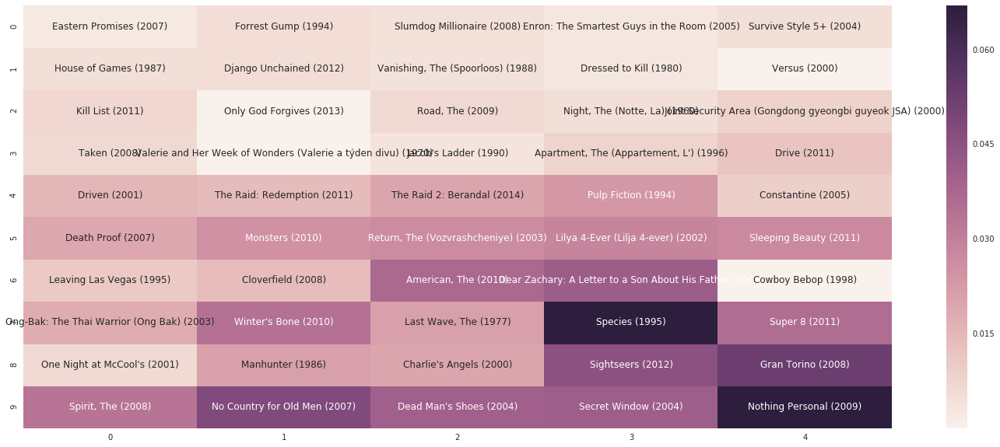

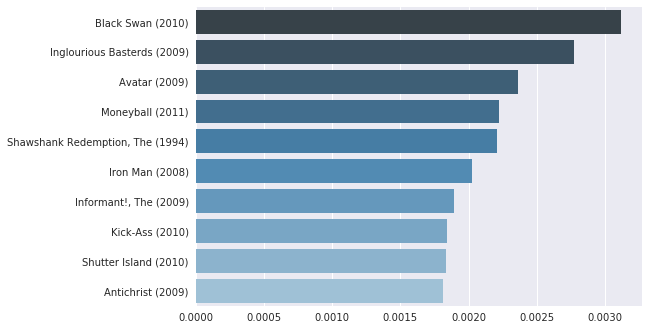

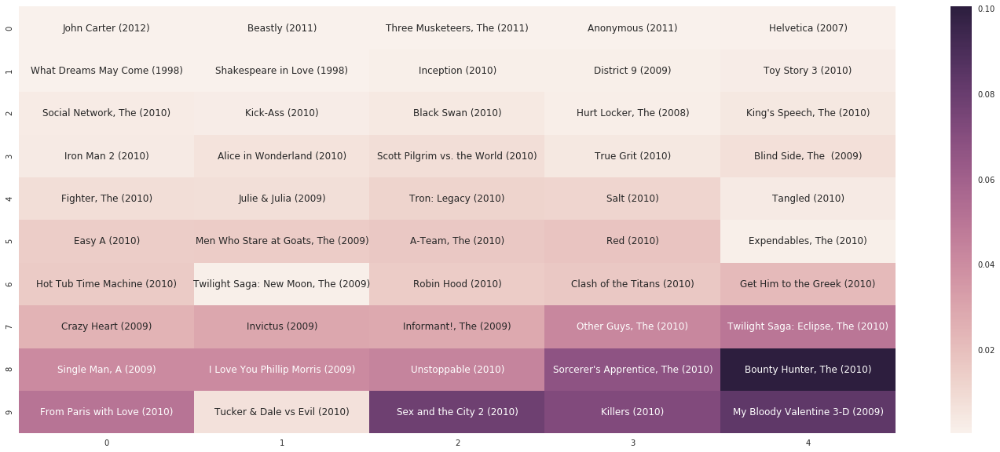

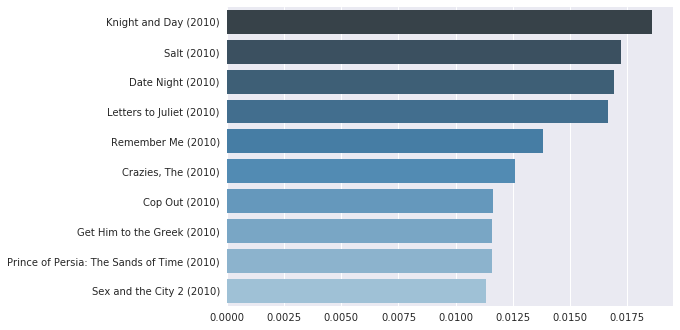

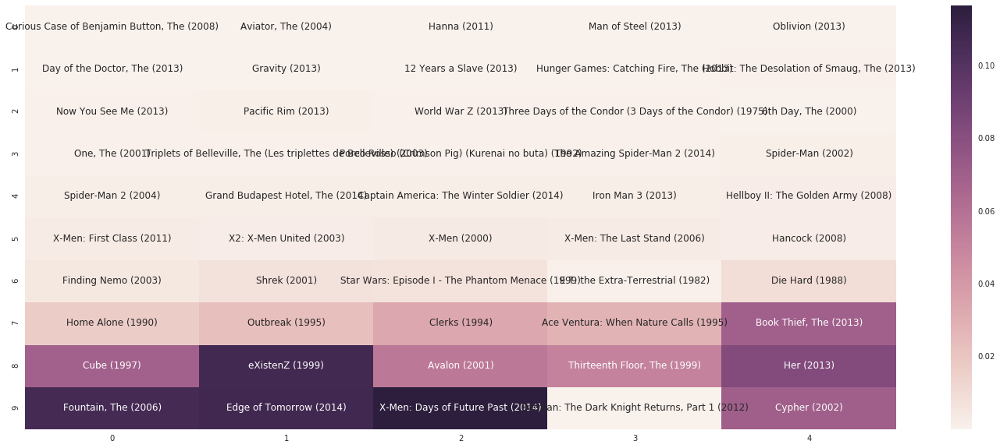

correct_predicted: ['Guardians of the Galaxy (2014)']
true_movies: ['Guardians of the Galaxy (2014)', 'Gone Girl (2014)', 'Equalizer, The (2014)', 'Coherence (2013)', 'Spirited Away (Sen to Chihiro no kamikakushi) (2001)', 'Lord of the Rings: The Two Towers, The (2002)', 'Crouching Tiger, Hidden Dragon (Wo hu cang long) (2000)', 'Sin City (2005)', 'Gladiator (2000)', "Girl Who Kicked the Hornet's Nest, The (Luftslottet som sprängdes) (2009)", 'Pirates of the Caribbean: The Curse of the Black Pearl (2003)', 'Body of Lies (2008)', 'Man on a Ledge (2012)', 'In Bruges (2008)', 'Scott Pilgrim vs. the World (2010)', 'Grey, The (2012)', 'Non-Stop (2014)', 'Traffic (2000)', 'Kung Fu Hustle (Gong fu) (2004)', 'Kill Bill: Vol. 1 (2003)', 'Kill Bill: Vol. 2 (2004)', 'Timecop (1994)', 'Stargate (1994)', 'Outlander (2008)', 'Philadelphia Experiment, The (1984)', 'Chronicles of Riddick, The (2004)', "Farewell (L'affaire Farewell) (2009)"]


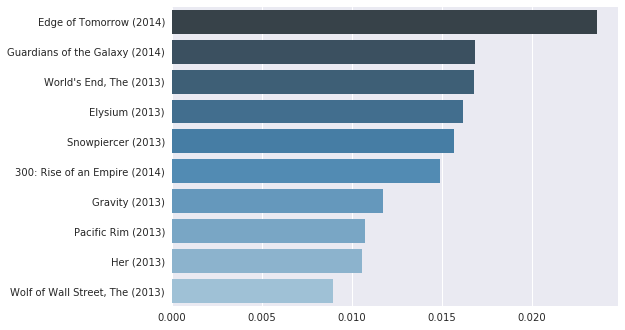

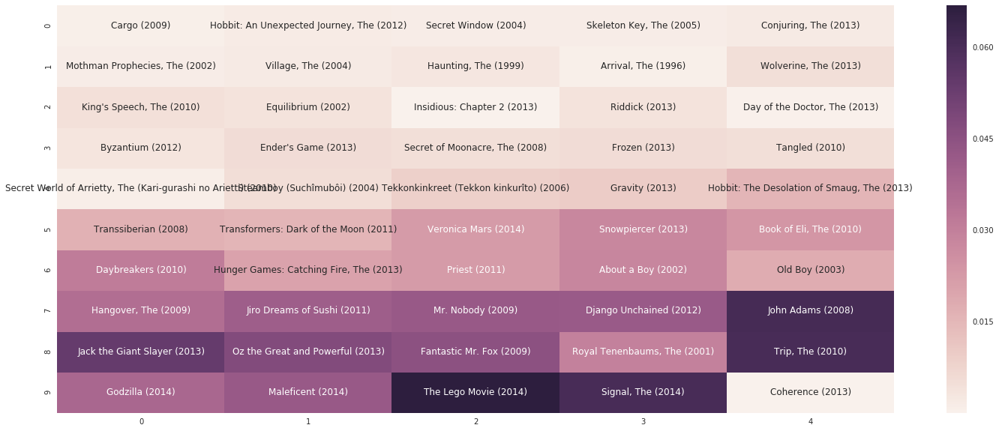

correct_predicted: ['Guardians of the Galaxy (2014)', 'Grand Budapest Hotel, The (2014)', 'Captain America: The Winter Soldier (2014)', 'Edge of Tomorrow (2014)']
true_movies: ['Grand Budapest Hotel, The (2014)', 'Truman Show, The (1998)', 'Waterworld (1995)', 'Life Is Beautiful (La Vita è bella) (1997)', 'Beautiful Mind, A (2001)', 'Cast Away (2000)', 'Snatch (2000)', 'Mission: Impossible II (2000)', 'Chicken Run (2000)', 'High Fidelity (2000)', 'Guardians of the Galaxy (2014)', 'X-Men: Days of Future Past (2014)', 'Edge of Tomorrow (2014)', 'Minority Report (2002)', 'Predestination (2014)', 'Robin Hood: Men in Tights (1993)', 'Captain America: The Winter Soldier (2014)', 'Shaun of the Dead (2004)', 'Star Wars: Episode III - Revenge of the Sith (2005)', 'Shrek 2 (2004)', "Ocean's Eleven (2001)", 'Requiem for a Dream (2000)', 'Bruce Almighty (2003)', 'School of Rock (2003)', 'Scary Movie (2000)', 'What Women Want (2000)', 'Me, Myself & Irene (2000)', 'Shanghai Noon (2000)', 'Road to Pe

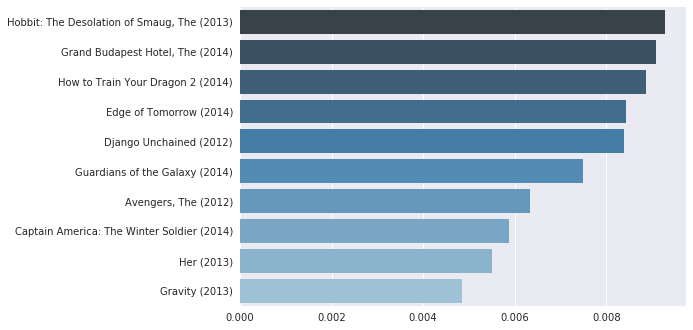

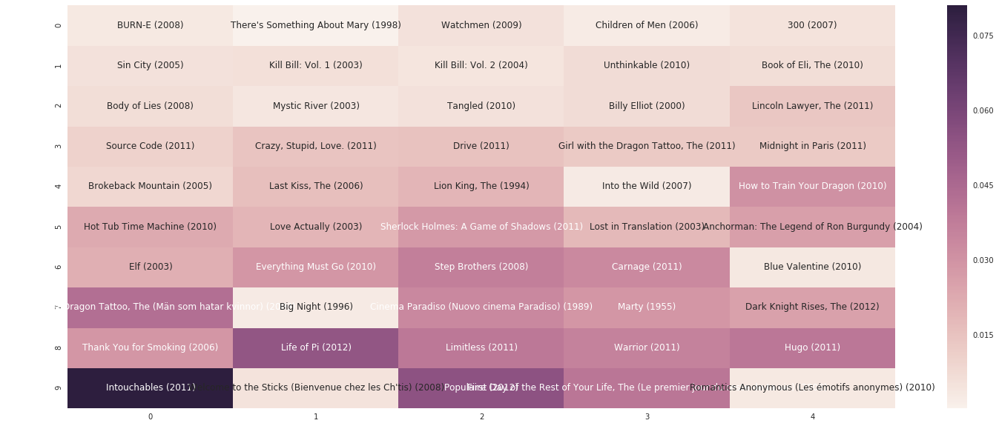

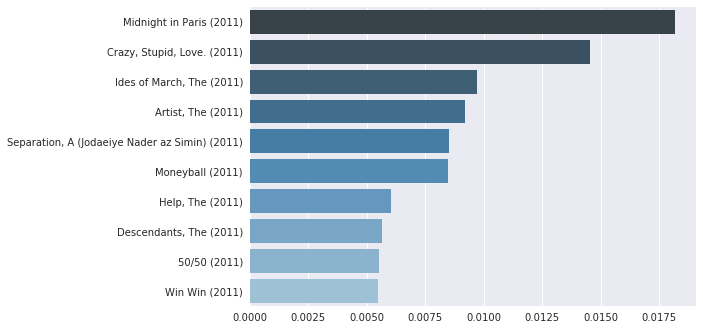

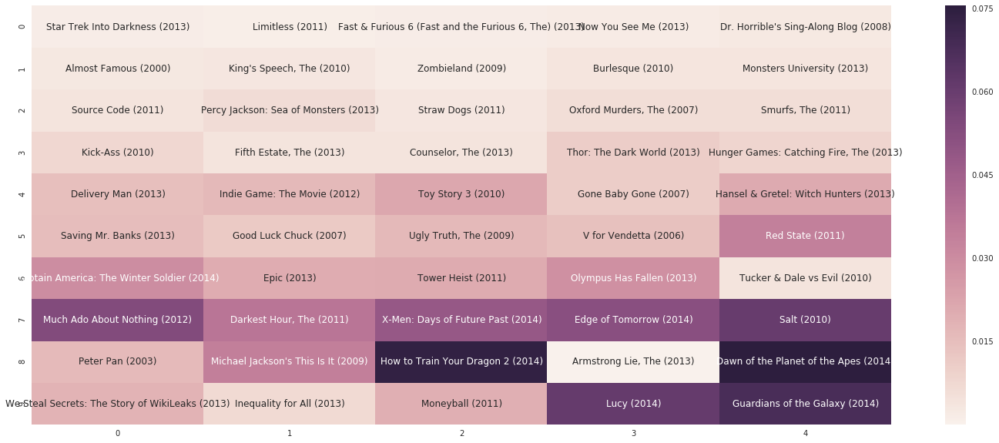

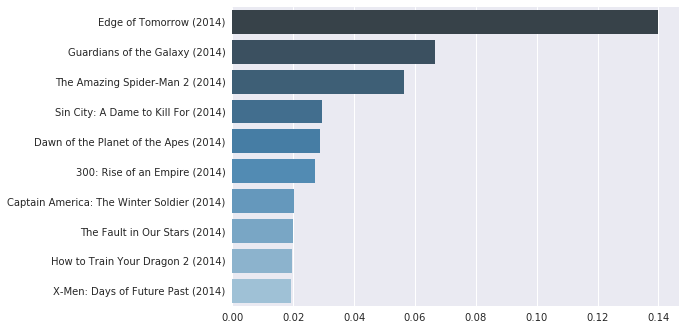

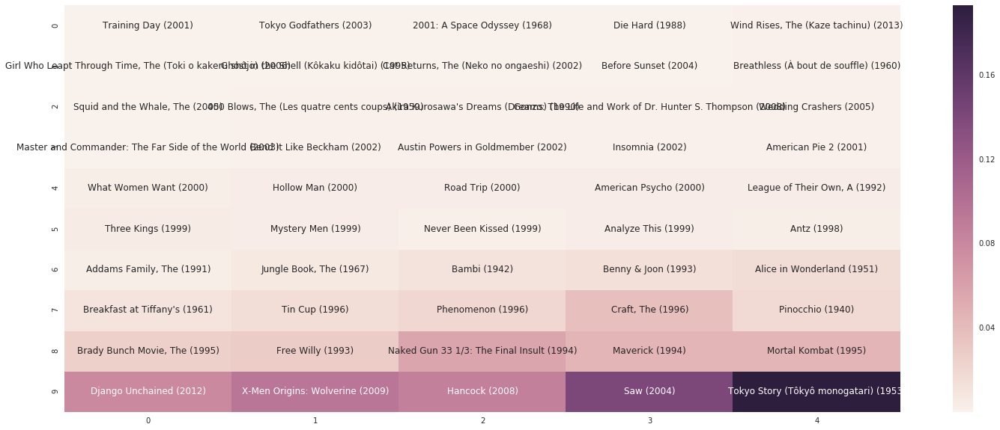

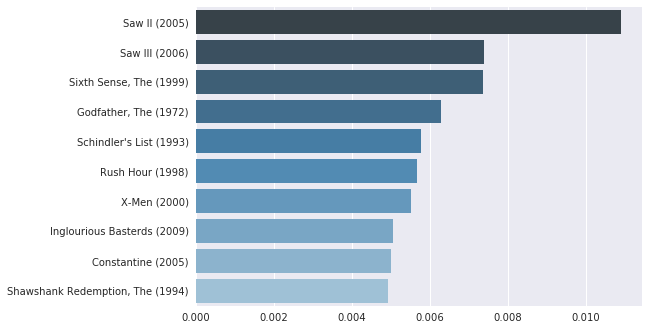

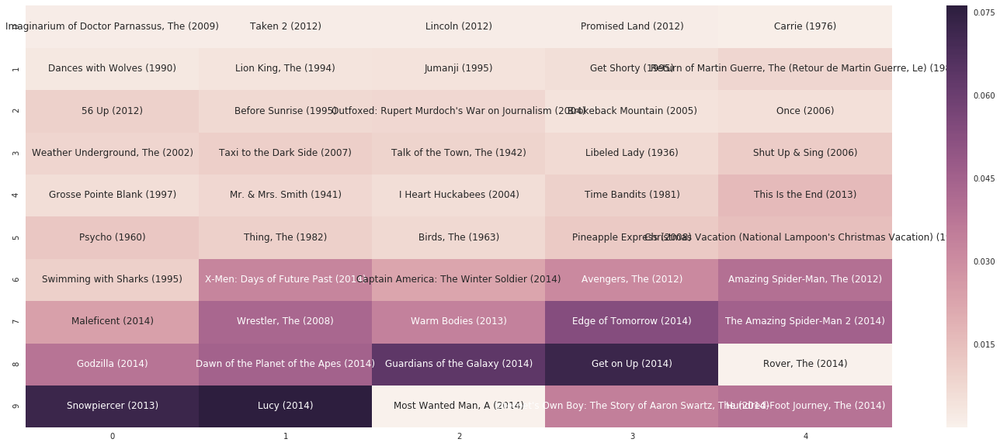

correct_predicted: ['How to Train Your Dragon 2 (2014)']
true_movies: ['Gone Girl (2014)', 'Nightcrawler (2014)', 'Interstellar (2014)', 'Boyhood (2014)', 'Silver Linings Playbook (2012)', 'Groundhog Day (1993)', 'Harold and Kumar Go to White Castle (2004)', 'How to Train Your Dragon 2 (2014)', 'Big Hero 6 (2014)', 'Mud (2012)', 'Babel (2006)']


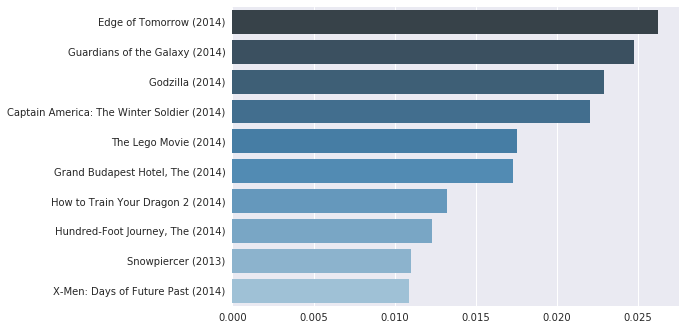

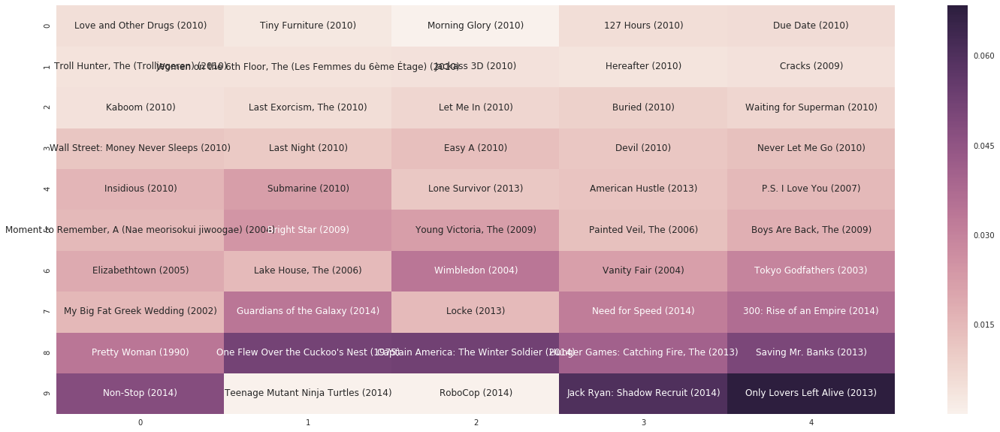

correct_predicted: ['Begin Again (2013)', 'The Fault in Our Stars (2014)', 'Divergent (2014)', 'X-Men: Days of Future Past (2014)']
true_movies: ['Chaser, The (Chugyeogja) (2008)', 'Strangers, The (2008)', 'Big Hero 6 (2014)', 'Interstellar (2014)', 'John Wick (2014)', 'Judge, The (2014)', 'Annabelle (2014)', 'Dracula Untold (2014)', 'Maze Runner, The (2014)', 'Gladiator (2000)', "Ocean's Eleven (2001)", 'Beautiful Mind, A (2001)', 'Minority Report (2002)', 'Bourne Identity, The (2002)', 'Cast Away (2000)', 'Almost Famous (2000)', 'Kill Bill: Vol. 2 (2004)', 'High Fidelity (2000)', '300 (2007)', 'No Country for Old Men (2007)', 'Black Hawk Down (2001)', 'Garden State (2004)', '40-Year-Old Virgin, The (2005)', 'Miss Congeniality (2000)', 'School of Rock (2003)', 'Fahrenheit 9/11 (2004)', 'Mystic River (2003)', 'Super Size Me (2004)', 'Borat: Cultural Learnings of America for Make Benefit Glorious Nation of Kazakhstan (2006)', 'Wedding Crashers (2005)', 'Panic Room (2002)', 'Napoleon Dyn

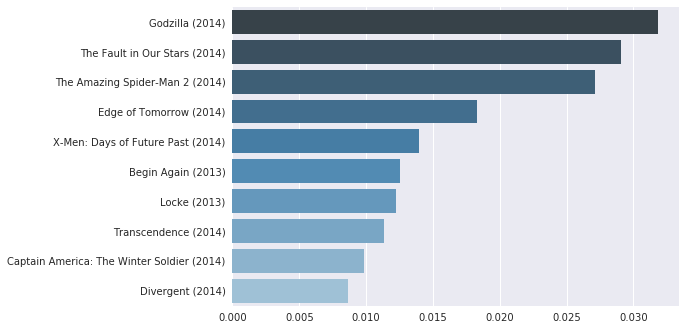

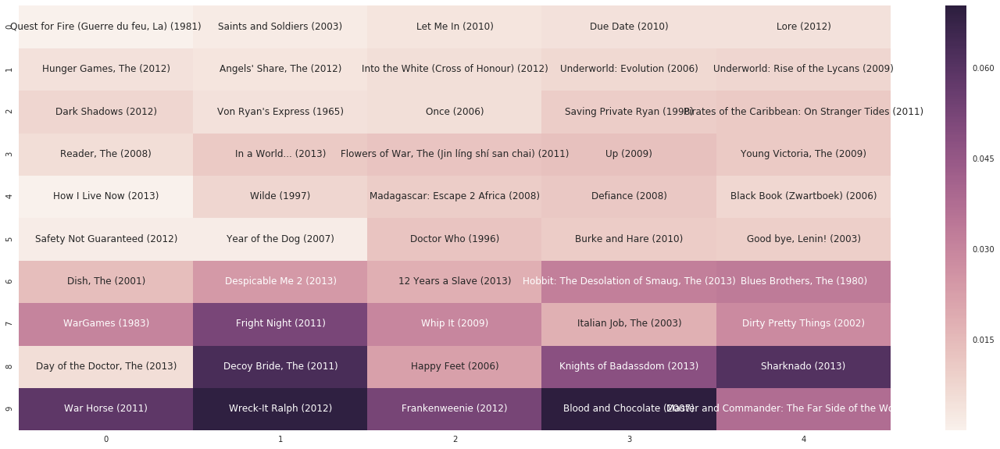

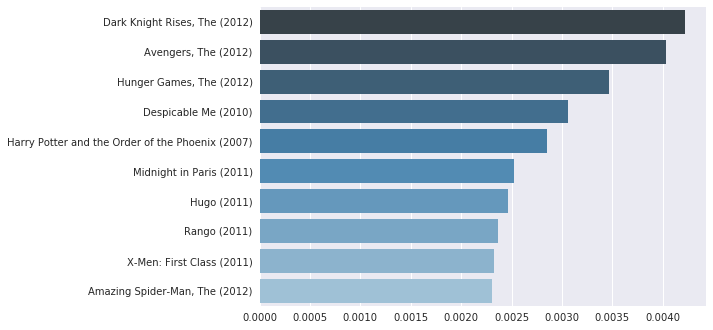

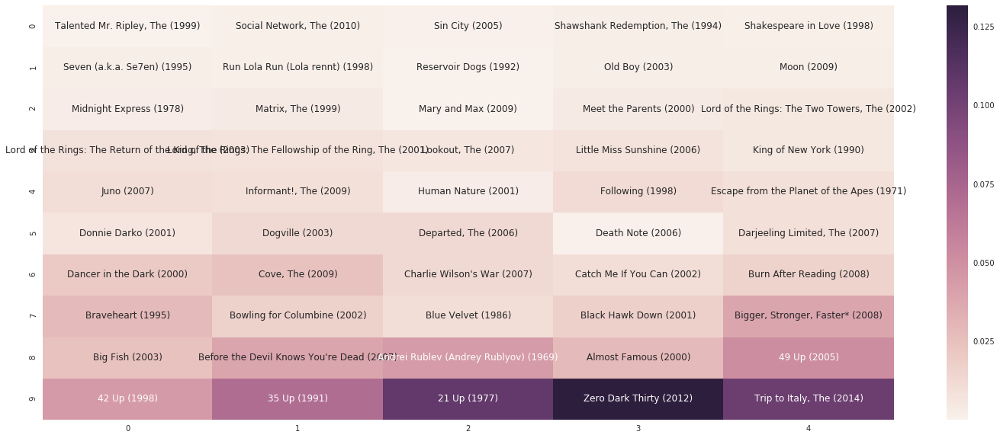

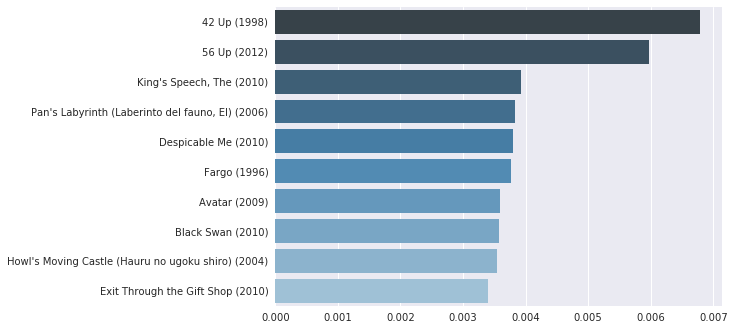

...

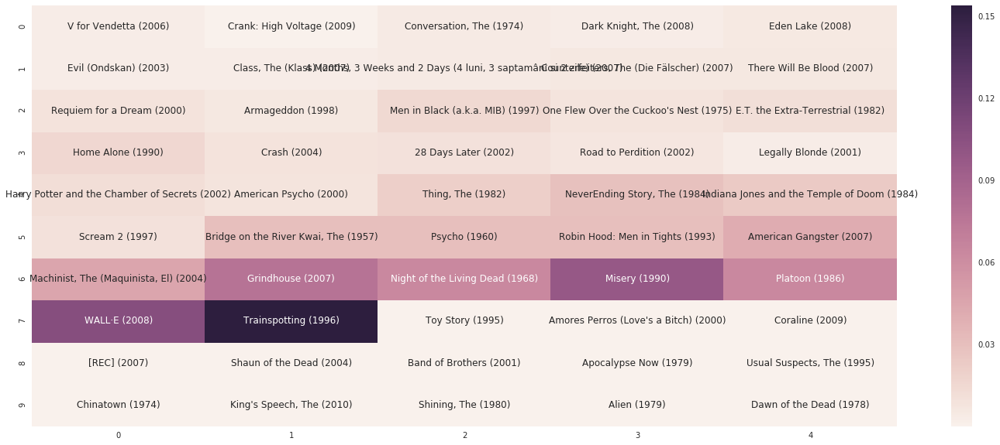

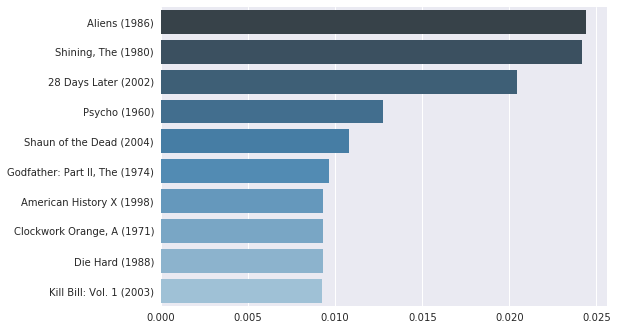

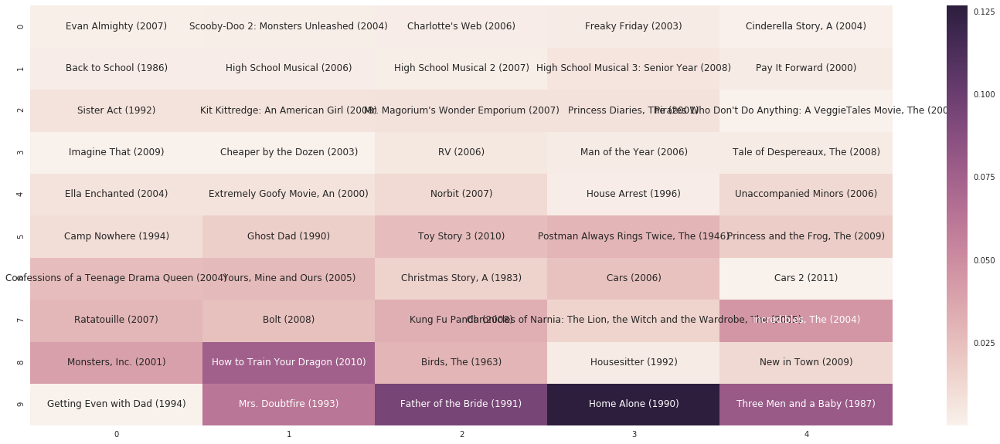

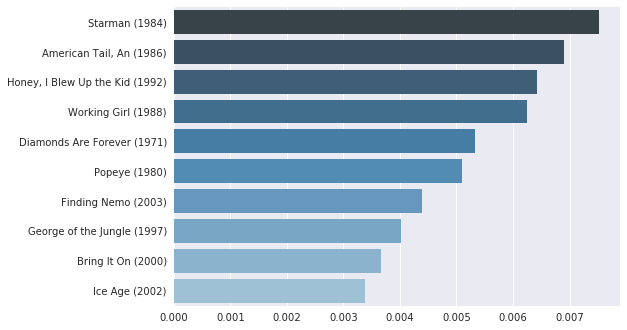

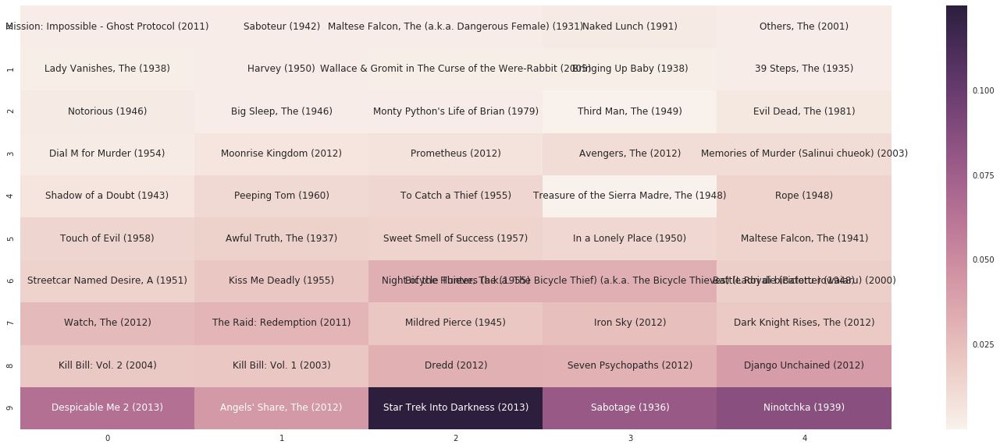

correct_predicted: ['Yojimbo (1961)']
true_movies: ['Grand Budapest Hotel, The (2014)', 'Guardians of the Galaxy (2014)', 'Edge of Tomorrow (2014)', 'X-Men: Days of Future Past (2014)', 'Calvary (2014)', 'The Raid 2: Berandal (2014)', 'Captain America: The Winter Soldier (2014)', 'Dawn of the Planet of the Apes (2014)', 'The Hobbit: The Battle of the Five Armies (2014)', 'Sin City: A Dame to Kill For (2014)', 'Transcendence (2014)', 'Need for Speed (2014)', 'Godzilla (2014)', 'The Interview (2014)', 'Transformers: Age of Extinction (2014)', 'About a Boy (2002)', 'Vanilla Sky (2001)', 'Day After Tomorrow, The (2004)', 'Die Another Day (2002)', 'Evolution (2001)', 'Mexican, The (2001)', 'Live Free or Die Hard (2007)', 'Grindhouse (2007)', 'Rat Race (2001)', 'Mission: Impossible III (2006)', 'Hobbit: An Unexpected Journey, The (2012)', 'Skyfall (2012)', 'Despicable Me (2010)', '2012 (2009)', 'Tangled (2010)', 'American Wedding (American Pie 3) (2003)', 'Gravity (2013)', 'Bridget Jones: Th

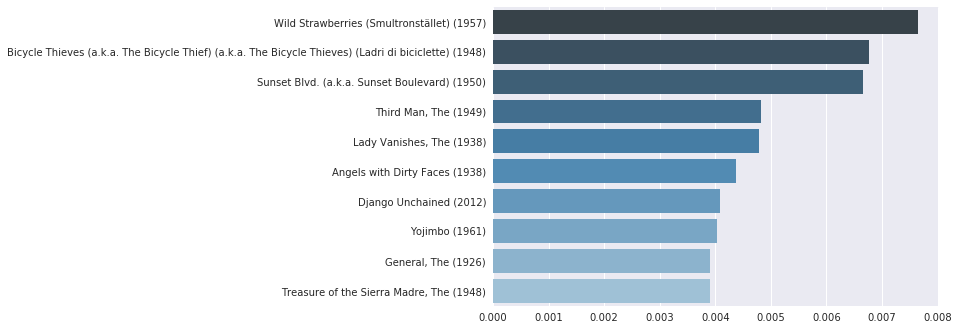

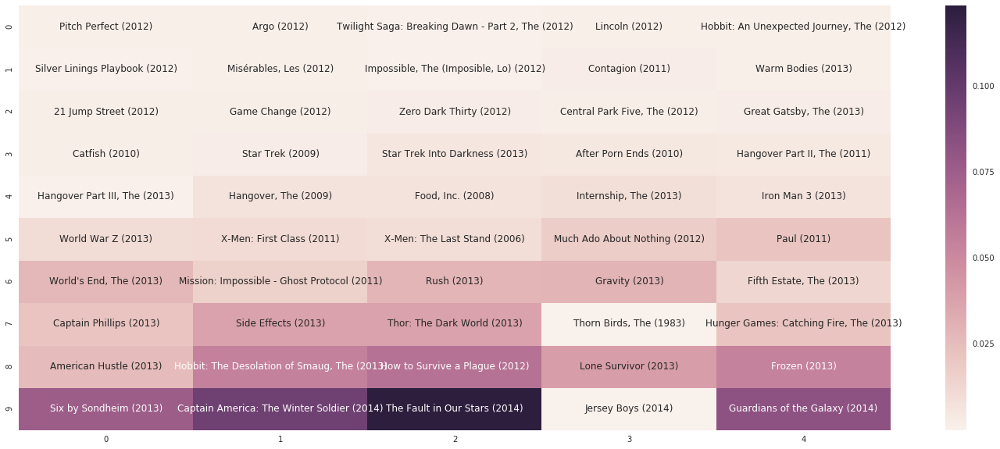

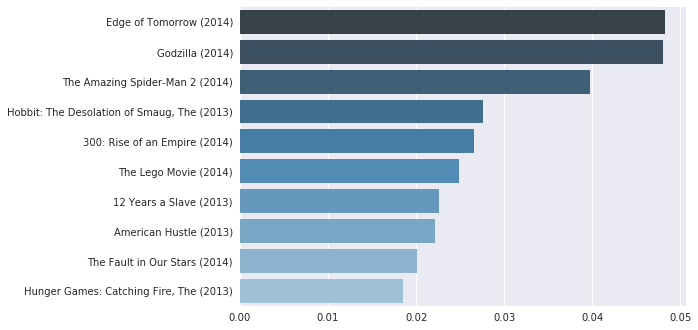

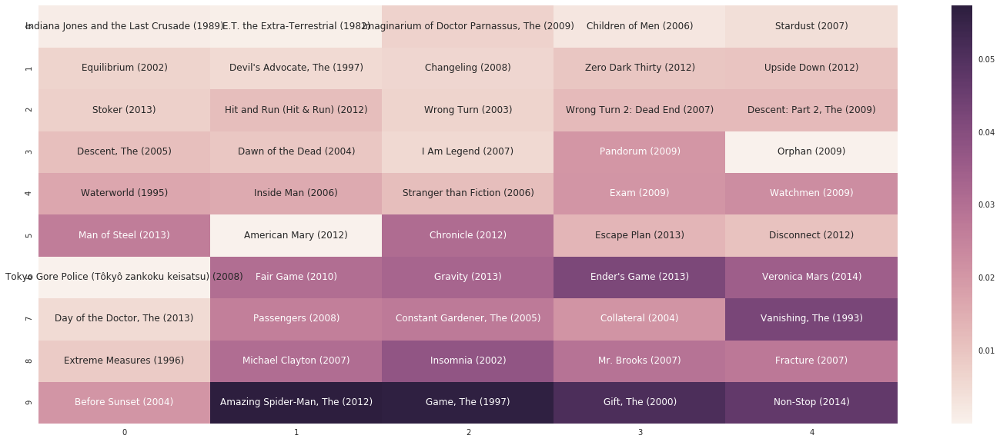

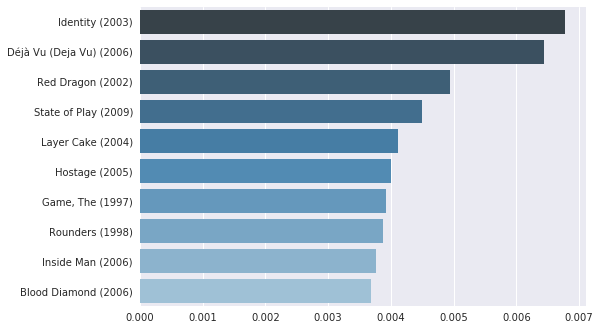

...

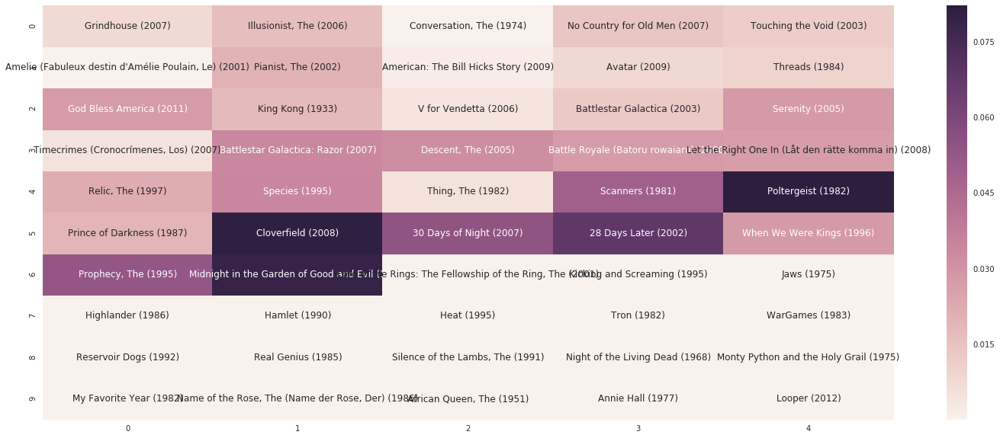

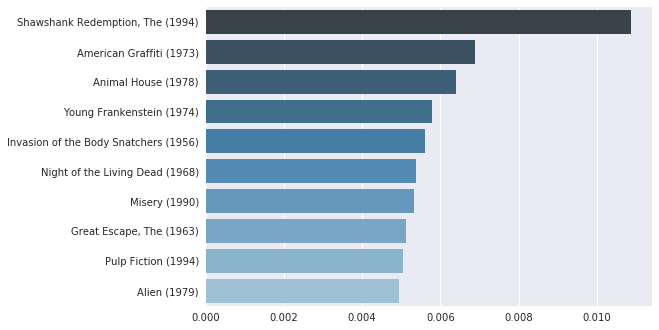

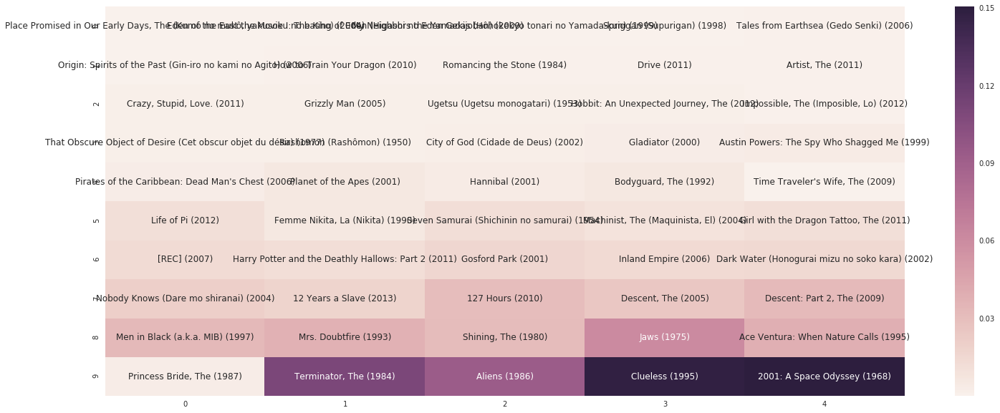

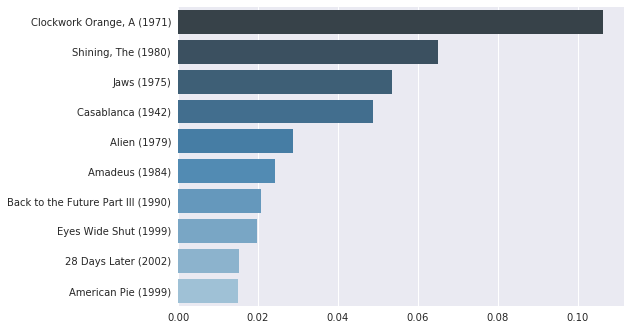

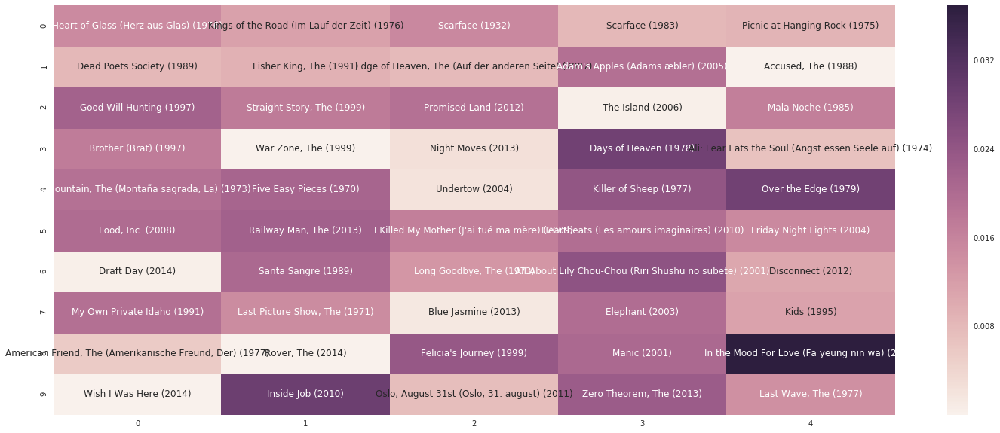

correct_predicted: ['Shadows (1959)', 'Alphaville (Alphaville, une étrange aventure de Lemmy Caution) (1965)']
true_movies: ['Gone Girl (2014)', 'Wake in Fright (1971)', 'The Lego Movie (2014)', 'Oh Boy (A Coffee in Berlin) (2012)', 'Mean Streets (1973)', 'Noi the Albino (Nói albinói) (2003)', "Army of Shadows (L'armée des ombres) (1969)", 'Rabbit Hole (2010)', 'X-Men: Days of Future Past (2014)', 'Devil, Probably, The (Diable probablement, Le) (1977)', 'Reprise (2006)', 'Celeste and Jesse Forever (Celeste & Jesse Forever) (2012)', 'Take Shelter (2011)', 'Laurence Anyways (2012)', 'Ida (2013)', 'THX 1138 (1971)', 'Last Life in the Universe (Ruang rak noi nid mahasan) (2003)', 'Stalker (1979)', 'Brazil (1985)', 'Beyond the Black Rainbow (2010)', 'Palindromes (2004)', 'Under the Sand (2000)', 'Eyes Wide Shut (1999)', 'Truman Show, The (1998)', 'Lost Highway (1997)', 'Spartan (2004)', 'Roman Polanski: Wanted and Desired (2008)', 'Cold Weather (2010)', 'Persona (1966)', 'Cook the Thief His

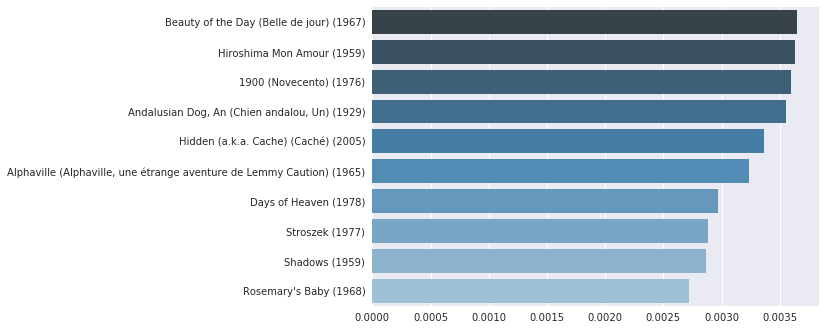

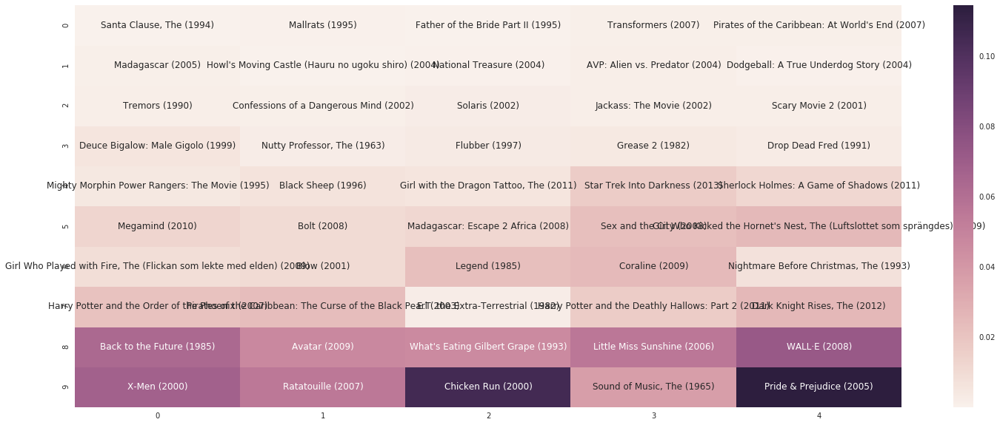

correct_predicted: ['Finding Nemo (2003)', 'Shrek (2001)', 'Spider-Man (2002)']
true_movies: ['Apocalypse Now (1979)', 'Fifth Element, The (1997)', 'Shrek (2001)', 'Gladiator (2000)', 'Finding Nemo (2003)', "Ocean's Eleven (2001)", 'Spider-Man (2002)', 'Kill Bill: Vol. 1 (2003)', 'Bourne Identity, The (2002)', 'Catch Me If You Can (2002)', 'Traffic (2000)', 'Matrix Reloaded, The (2003)', 'Mission: Impossible II (2000)', "Charlie's Angels (2000)", 'Star Wars: Episode II - Attack of the Clones (2002)', 'Meet the Parents (2000)', 'Lost in Translation (2003)', 'Delicatessen (1991)', 'Shining, The (1980)', 'Fantasia (1940)', 'Alice in Wonderland (1951)', 'Ghost in the Shell (Kôkaku kidôtai) (1995)', 'Black Swan (2010)', 'Dallas Buyers Club (2013)', 'Life of Pi (2012)', 'Beasts of the Southern Wild (2012)', 'Samsara (2011)', 'Animatrix, The (2003)', 'Cell, The (2000)', 'Watchmen (2009)', 'Curious Case of Benjamin Button, The (2008)', 'Batman: The Dark Knight Returns, Part 2 (2013)', 'Hero (Y

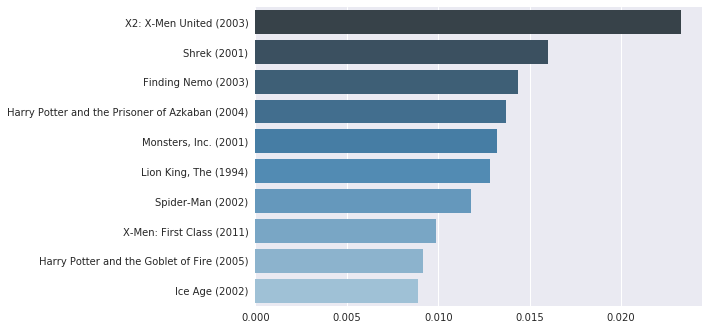

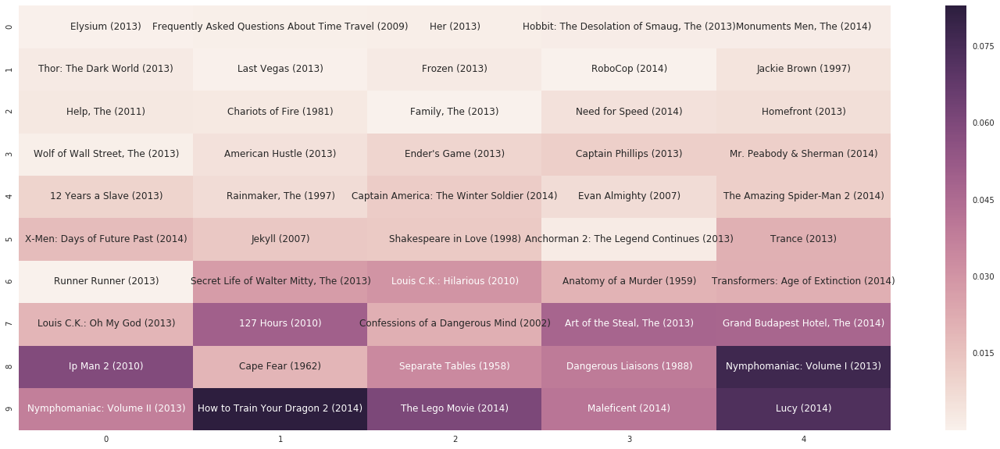

correct_predicted: ['300: Rise of an Empire (2014)', 'Edge of Tomorrow (2014)', 'Dawn of the Planet of the Apes (2014)', 'Guardians of the Galaxy (2014)', 'Snowpiercer (2013)']
true_movies: ['Dawn of the Planet of the Apes (2014)', 'Noah (2014)', 'Bourne Legacy, The (2012)', 'Edge of Tomorrow (2014)', 'Tampopo (1985)', '300: Rise of an Empire (2014)', 'Sleuth (1972)', 'Transcendence (2014)', 'All Watched Over by Machines of Loving Grace (2011)', 'X-Men (2000)', 'Creation (2009)', 'Hoop Dreams (1994)', 'Conversation, The (1974)', 'Manhattan (1979)', 'Annie Hall (1977)', 'Civil War, The (1990)', 'Man on Wire (2008)', 'Maze Runner, The (2014)', 'My Winnipeg (2007)', 'Cell, The (2000)', 'Me, Myself & Irene (2000)', 'Mary and Max (2009)', 'Amistad (1997)', 'Hunt, The (Jagten) (2012)', 'Snowpiercer (2013)', 'Mr. Nobody (2009)', 'Guardians of the Galaxy (2014)', 'Cider House Rules, The (1999)', 'Silver Linings Playbook (2012)', 'Fawlty Towers (1975-1979)', 'John Adams (2008)', 'Interstellar (

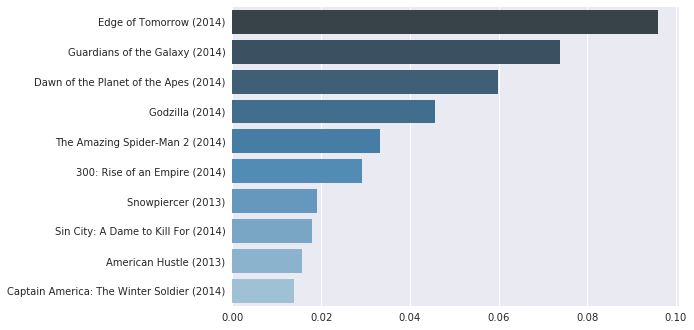

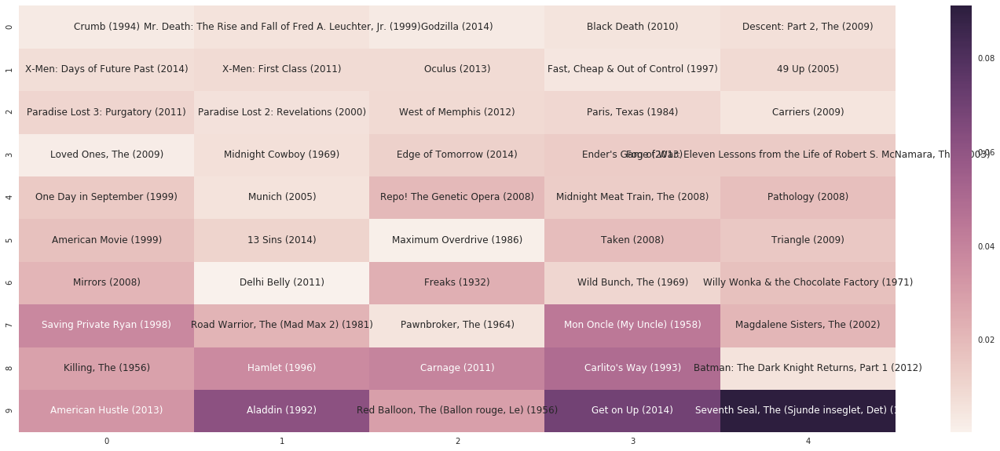

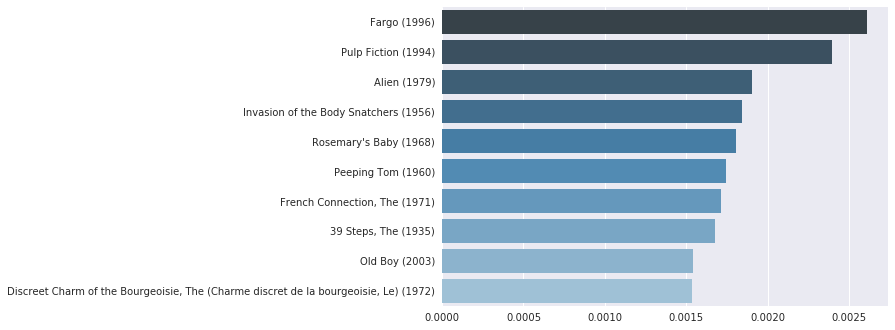

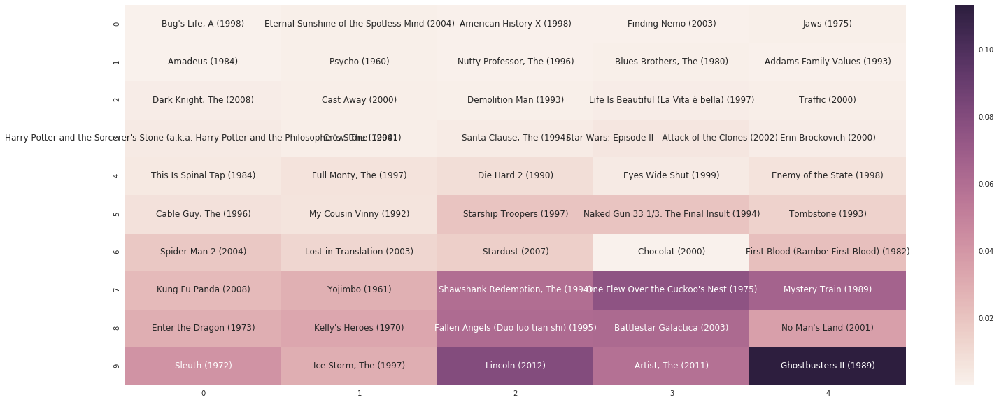

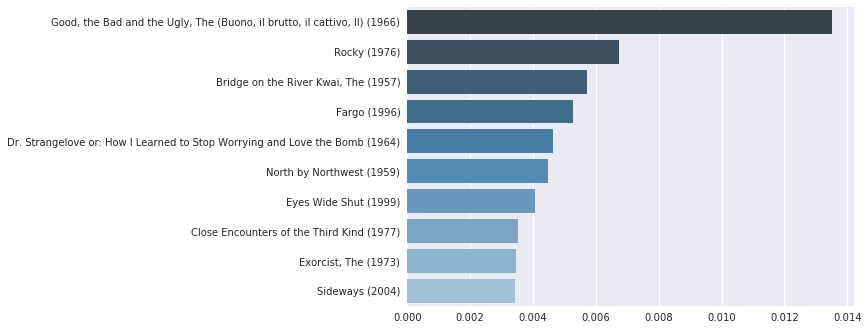

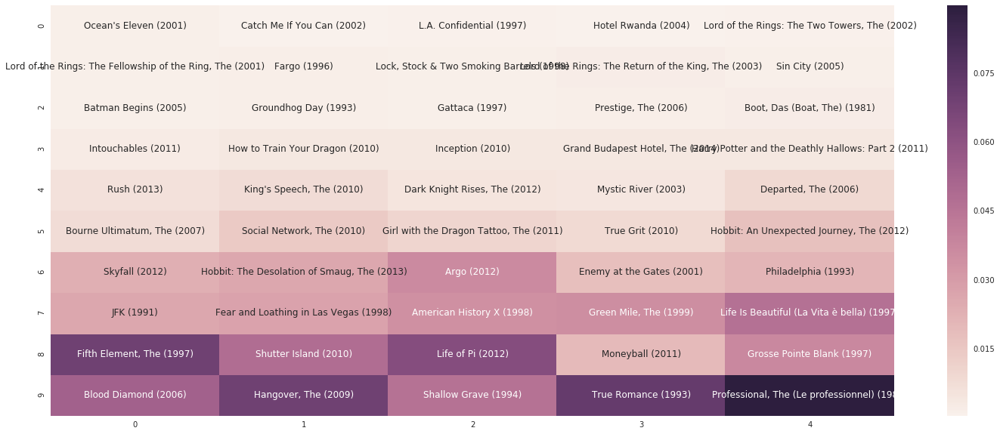

correct_predicted: ['Bourne Identity, The (2002)']
true_movies: ['Kick-Ass (2010)', 'Aviator, The (2004)', 'Boondock Saints, The (2000)', 'Scent of a Woman (1992)', 'Bourne Identity, The (2002)', 'Titanic (1997)', 'Bourne Supremacy, The (2004)']


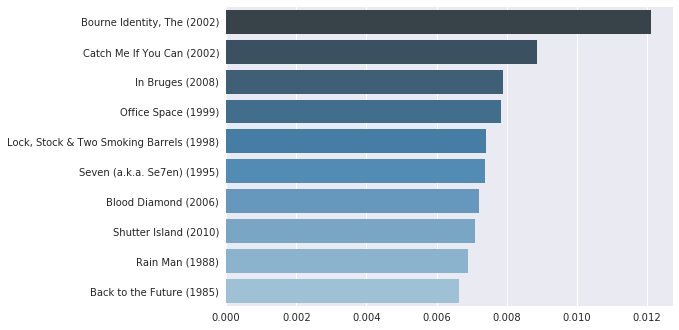

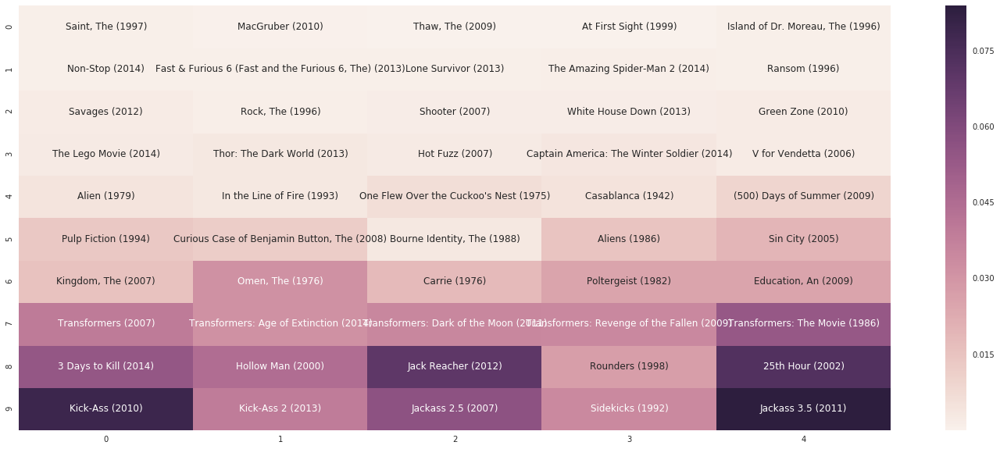

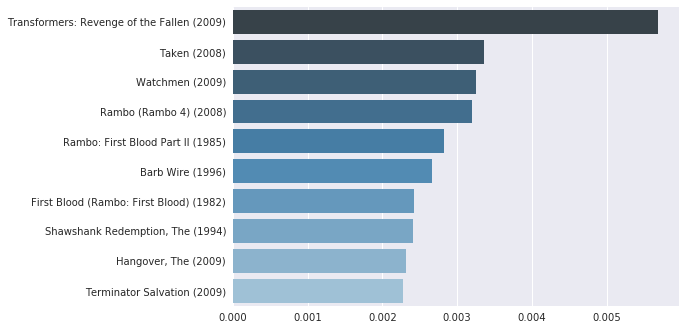

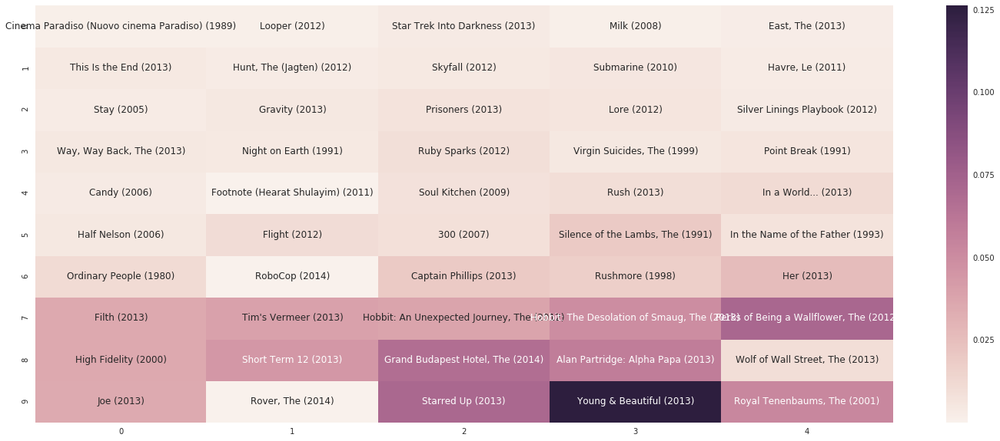

correct_predicted: ['12 Years a Slave (2013)']
true_movies: ['Bronx Tale, A (1993)', 'What Maisie Knew (2012)', 'Double, The (2013)', 'Homesman, The (2014)', "Blue Is the Warmest Color (La vie d'Adèle) (2013)", 'Ginger & Rosa (2012)', 'Kids Are All Right, The (2010)', 'Life Is Beautiful (La Vita è bella) (1997)', 'Usual Suspects, The (1995)', 'Bitter Moon (1992)', 'Dallas Buyers Club (2013)', 'Before Midnight (2013)', 'Good, the Bad and the Ugly, The (Buono, il brutto, il cattivo, Il) (1966)', '12 Years a Slave (2013)', 'Shutter Island (2010)', 'Boyhood (2014)', 'Crank (2006)', 'Bucket List, The (2007)', "Henry's Crime (2010)", 'Taking Chance (2009)', 'Late Quartet, A (2012)', 'Behind the Candelabra (2013)', 'Birdman (2014)', 'Ida (2013)', 'Junebug (2005)', 'Batman (1989)', 'Locke (2013)', 'Inherent Vice (2014)', 'The Imitation Game (2014)', 'Nebraska (2013)', 'Interstellar (2014)', 'A Most Violent Year (2014)']


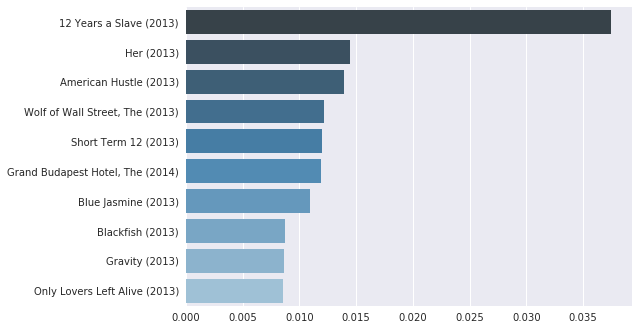

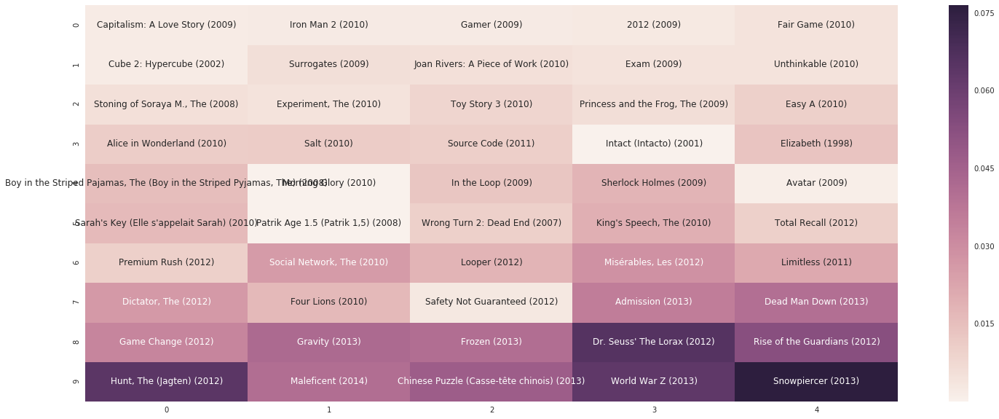

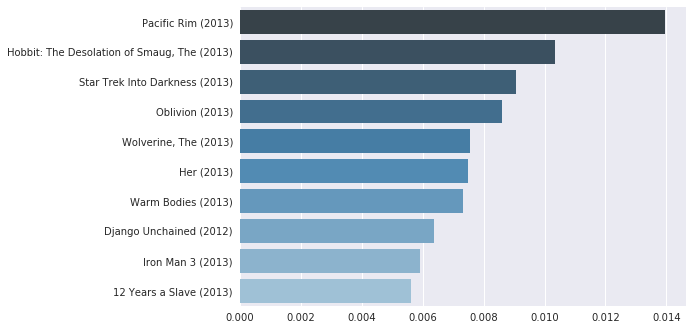

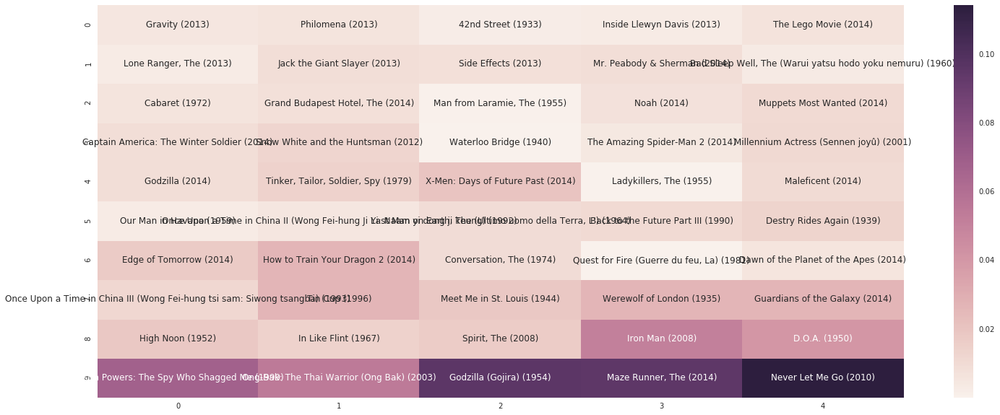

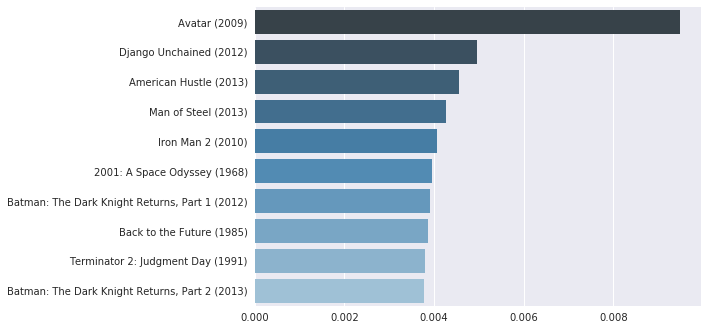

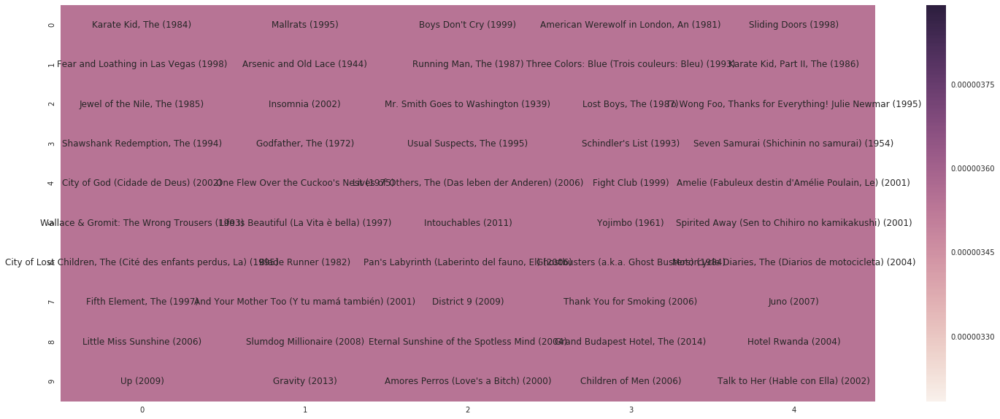

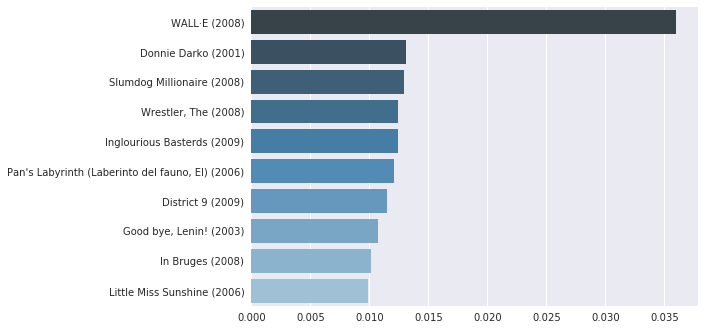

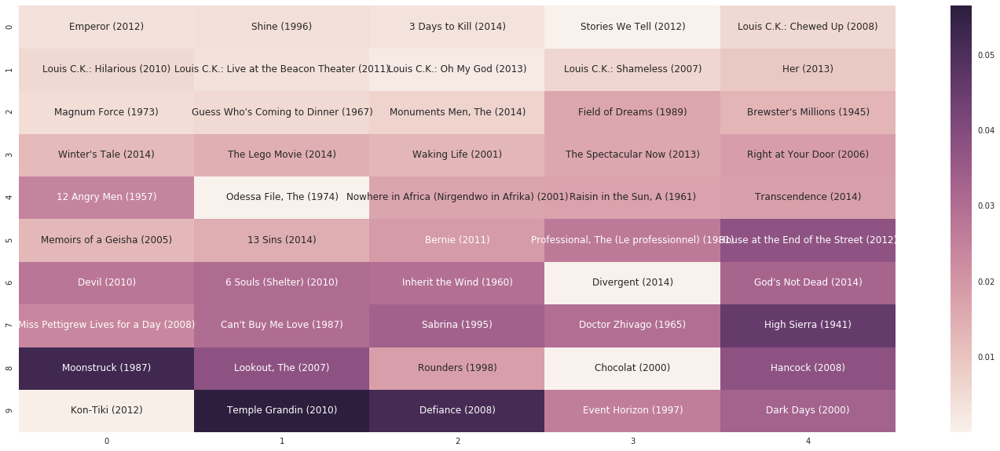

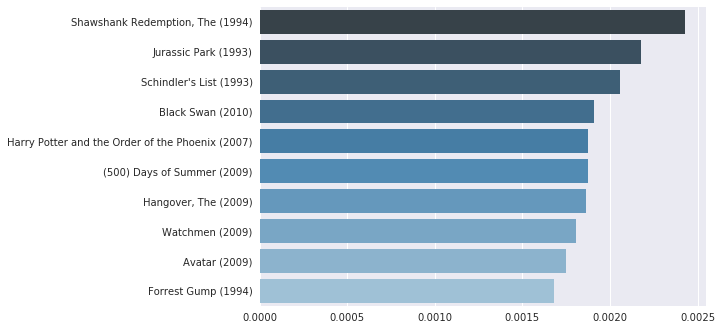

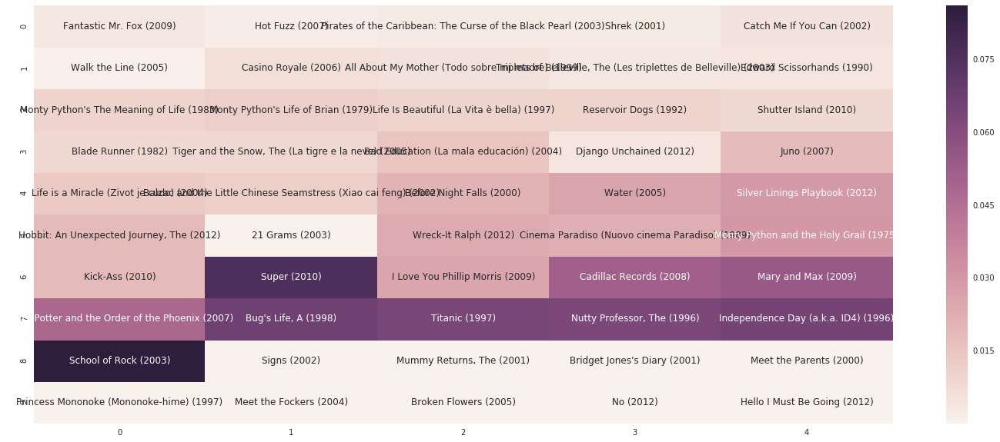

correct_predicted: ['Royal Tenenbaums, The (2001)', 'Spirited Away (Sen to Chihiro no kamikakushi) (2001)']
true_movies: ['Donnie Darko (2001)', 'Fargo (1996)', "Mood Indigo (L'écume des jours) (2013)", 'No Country for Old Men (2007)', 'Duck, You Sucker (a.k.a. Fistful of Dynamite, A) (Giù la testa) (1971)', 'Crooklyn (1994)', 'The Interview (2014)', '50/50 (2011)', 'My Neighbor Totoro (Tonari no Totoro) (1988)', 'Spirited Away (Sen to Chihiro no kamikakushi) (2001)', 'Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986)', 'Royal Tenenbaums, The (2001)', "Kiki's Delivery Service (Majo no takkyûbin) (1989)", 'Garden State (2004)', 'Volver (2006)', 'Louis C.K.: Shameless (2007)', 'Van Helsing (2004)', 'Wolverine, The (2013)', 'Perks of Being a Wallflower, The (2012)', 'Big Lebowski, The (1998)', 'Underground (1995)', 'Once Upon a Time in America (1984)', 'Goodfellas (1990)', 'Chinatown (1974)']


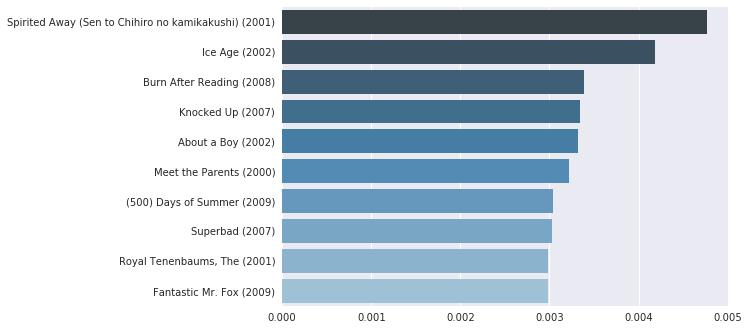

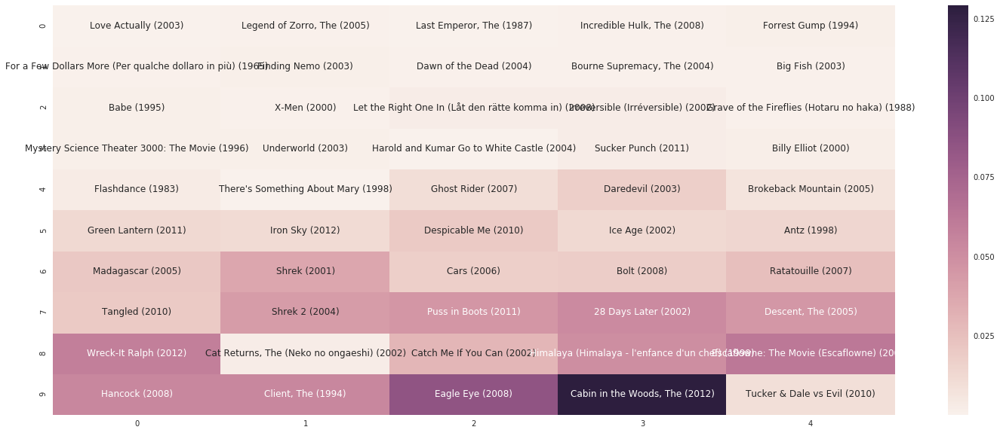

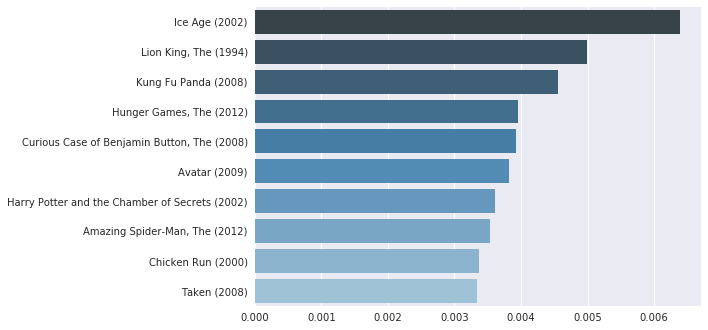

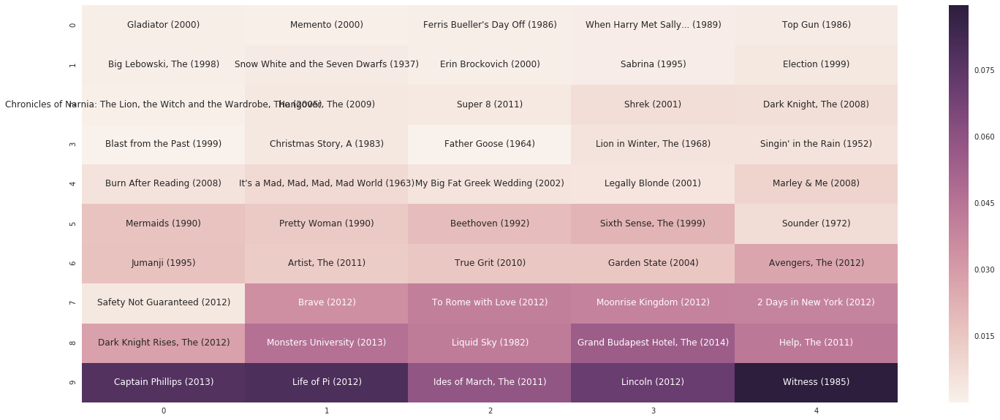

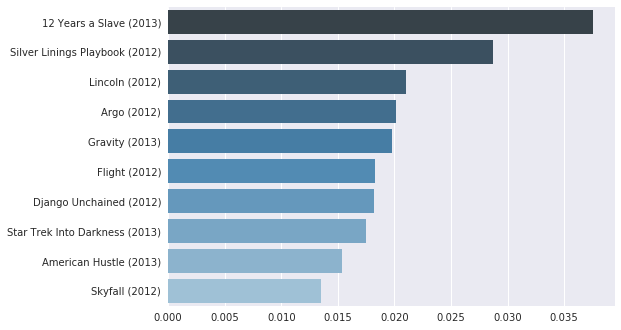

...

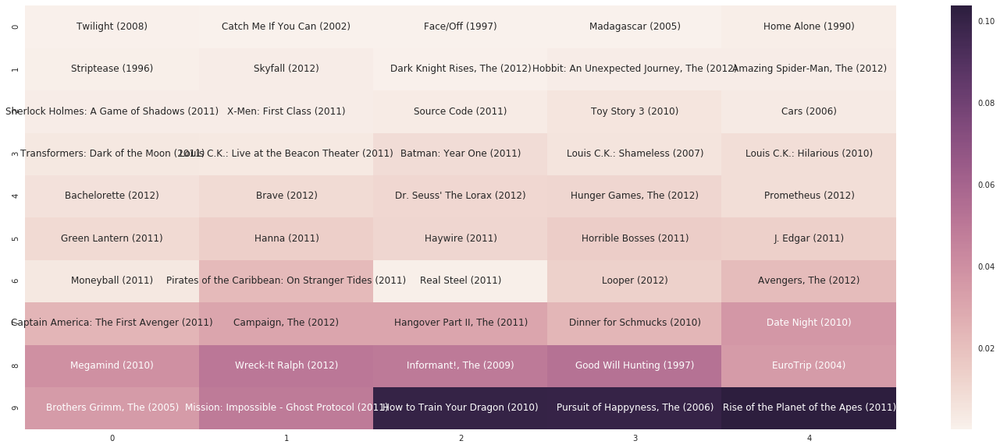

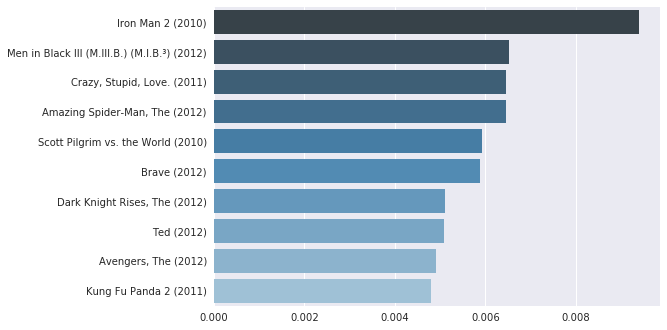

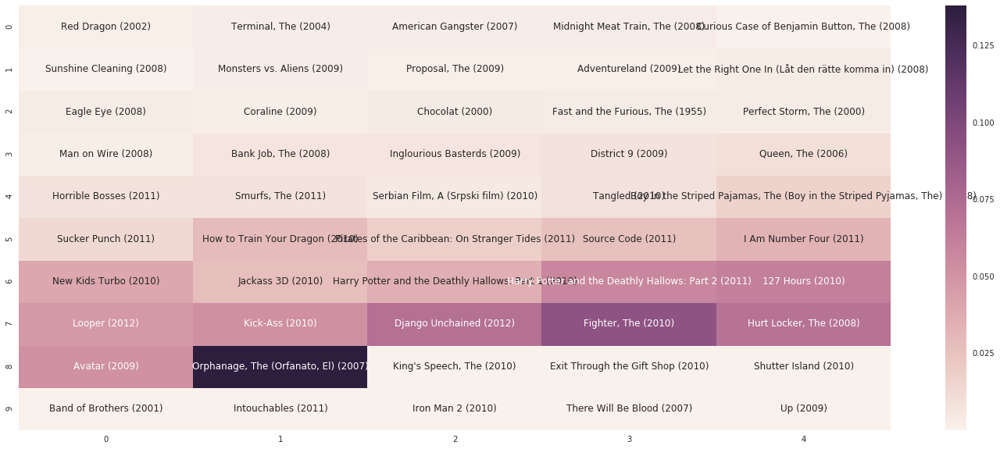

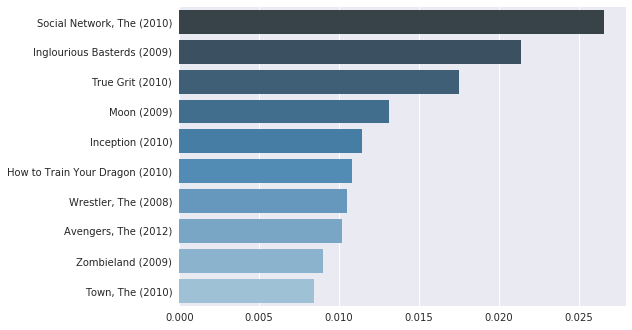

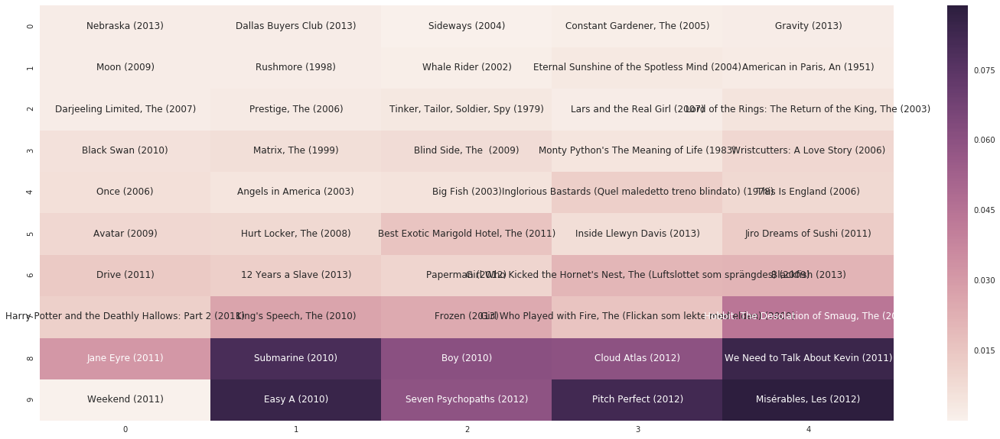

correct_predicted: ['Hunger Games: Catching Fire, The (2013)']
true_movies: ['Marie Antoinette (2006)', "Knight's Tale, A (2001)", 'Boyhood (2014)', 'Lord of the Rings: The Fellowship of the Ring, The (2001)', 'Lord of the Rings: The Two Towers, The (2002)', 'Pirates of the Caribbean: The Curse of the Black Pearl (2003)', 'Finding Nemo (2003)', 'Kill Bill: Vol. 2 (2004)', 'Donnie Darko (2001)', 'Beautiful Mind, A (2001)', 'Dark Knight, The (2008)', 'Kill Bill: Vol. 1 (2003)', "Ocean's Eleven (2001)", 'Spider-Man (2002)', 'Matrix Reloaded, The (2003)', 'Inception (2010)', 'Bowling for Columbine (2002)', 'Harry Potter and the Prisoner of Azkaban (2004)', 'Shaun of the Dead (2004)', 'Moulin Rouge (2001)', 'Last Samurai, The (2003)', 'Chocolat (2000)', 'My Big Fat Greek Wedding (2002)', '300 (2007)', 'Stranger than Fiction (2006)', 'Eagle vs Shark (2007)', 'Me and You and Everyone We Know (2005)', 'M (1931)', 'Louis C.K.: Live at the Beacon Theater (2011)', 'Big Lebowski, The (1998)', 'Pro

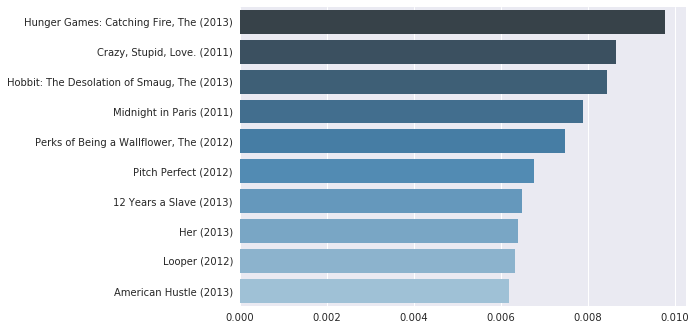

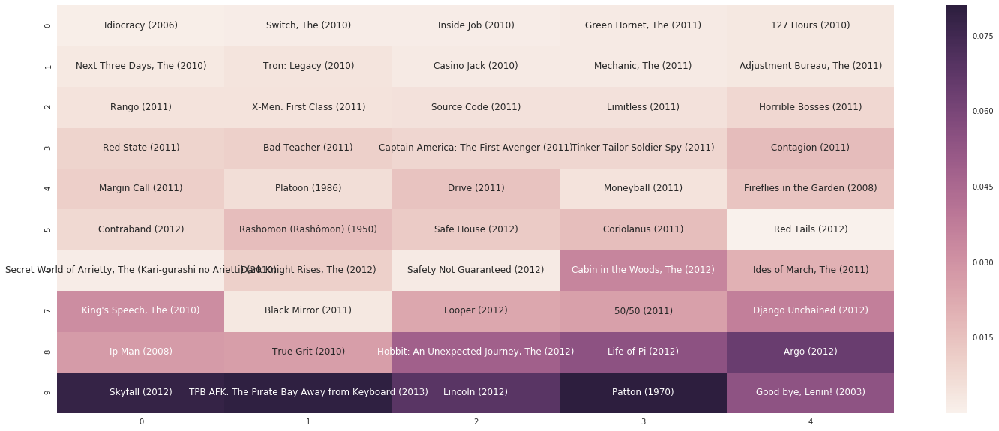

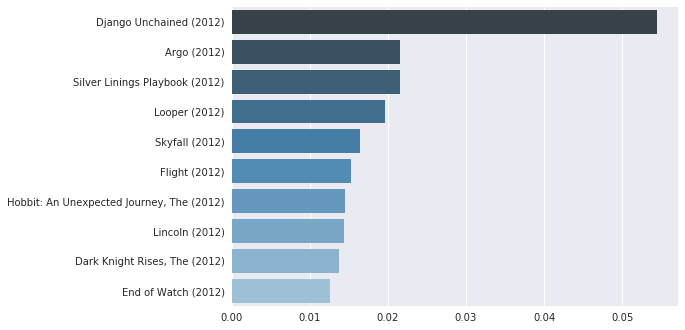

load model: checkpoints/attentional-linear-to-hidden-state/rep0-lstm2-256-1-128-adam-1000000000-hidden_state-64-20170523-125653/last_model/last_model.ckpt-9945600


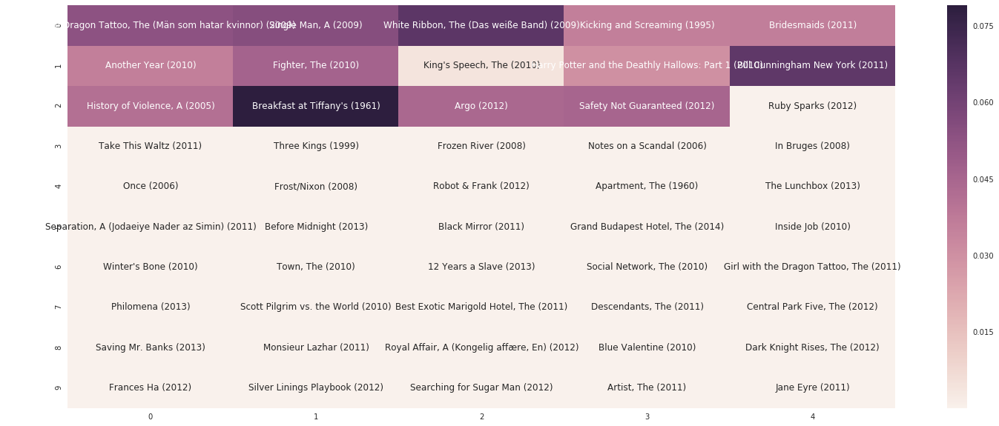

correct_predicted: ['Dallas Buyers Club (2013)', 'American Hustle (2013)']
true_movies: ['American Hustle (2013)', 'The Lego Movie (2014)', 'Captain Phillips (2013)', 'Dallas Buyers Club (2013)', 'Nebraska (2013)', 'Past, The (Le passé) (2013)']


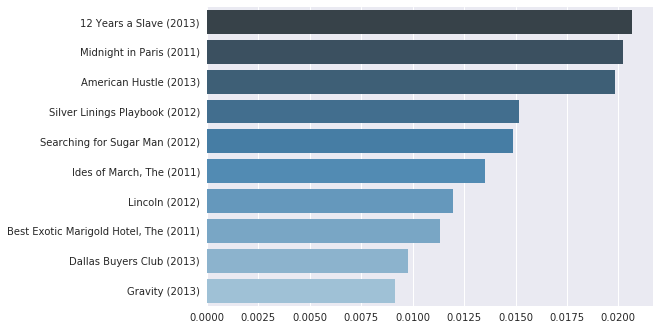

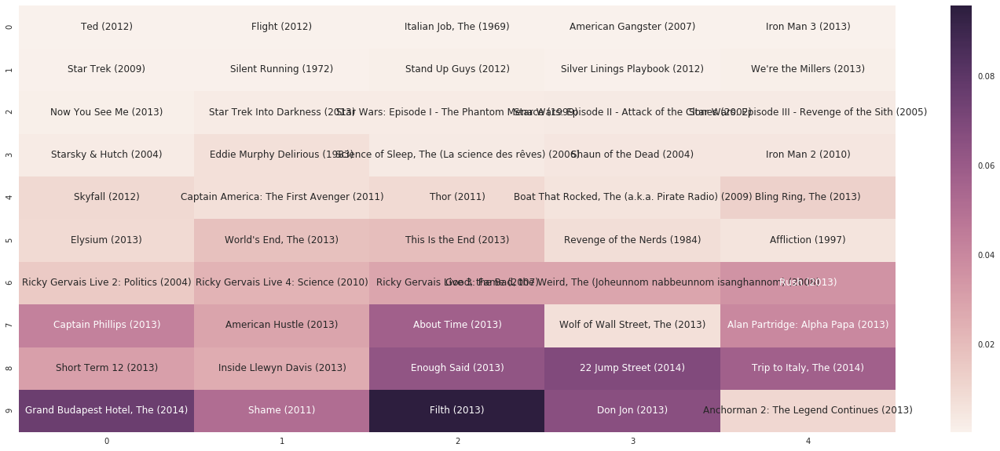

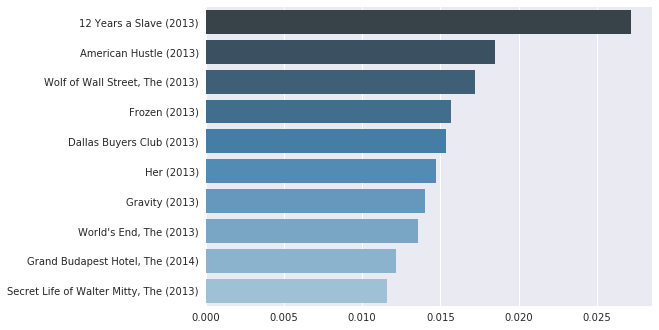

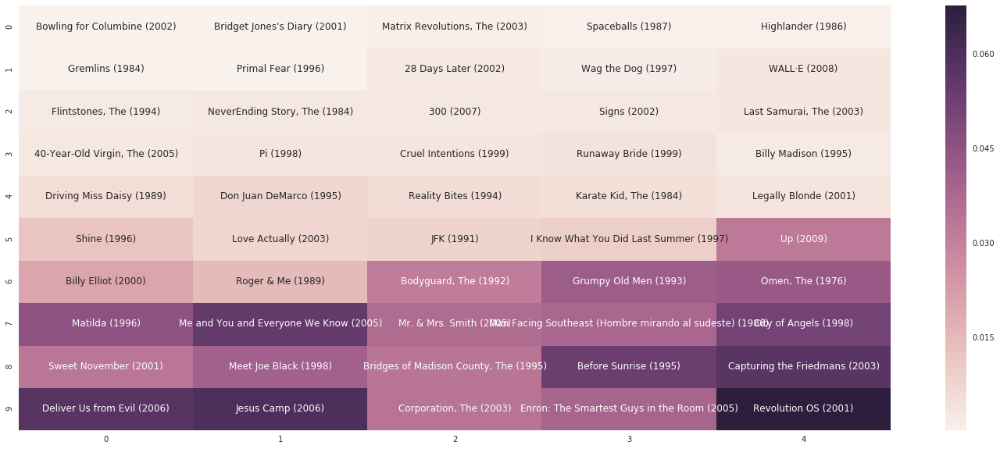

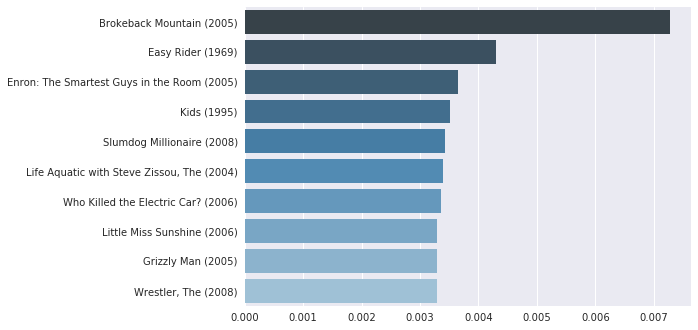

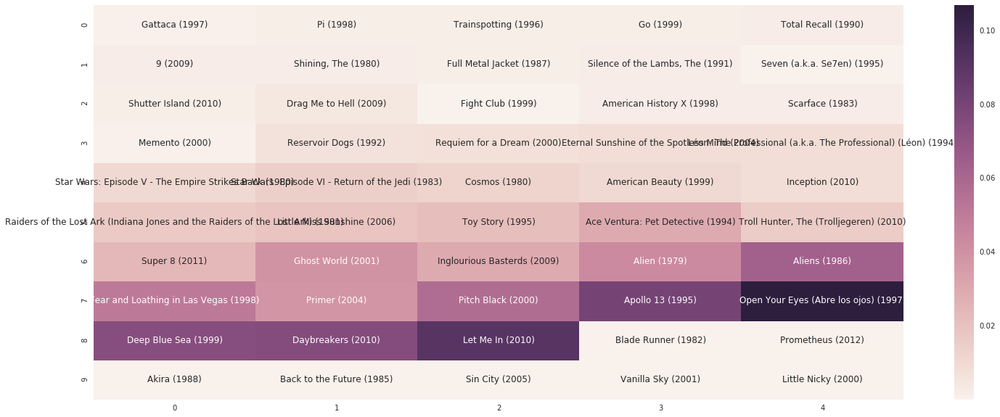

correct_predicted: ['Kill Bill: Vol. 1 (2003)', 'Ghost in the Shell (Kôkaku kidôtai) (1995)']
true_movies: ['Ghostbusters (a.k.a. Ghost Busters) (1984)', 'Stargate (1994)', 'Cube 2: Hypercube (2002)', 'Planet of the Apes (2001)', 'Lord of the Rings: The Fellowship of the Ring, The (2001)', 'Lord of the Rings: The Return of the King, The (2003)', 'Lord of the Rings: The Two Towers, The (2002)', 'Spirited Away (Sen to Chihiro no kamikakushi) (2001)', 'Men in Black III (M.III.B.) (M.I.B.³) (2012)', 'X-Men: Days of Future Past (2014)', 'Princess Mononoke (Mononoke-hime) (1997)', 'Clerks (1994)', 'Shrek (2001)', 'X-Men (2000)', 'Pirates of the Caribbean: The Curse of the Black Pearl (2003)', 'Minority Report (2002)', 'Monsters, Inc. (2001)', "Amelie (Fabuleux destin d'Amélie Poulain, Le) (2001)", 'Finding Nemo (2003)', 'Spider-Man (2002)', 'Kill Bill: Vol. 1 (2003)', "Harry Potter and the Sorcerer's Stone (a.k.a. Harry Potter and the Philosopher's Stone) (2001)", 'Kill Bill: Vol. 2 (2004)',

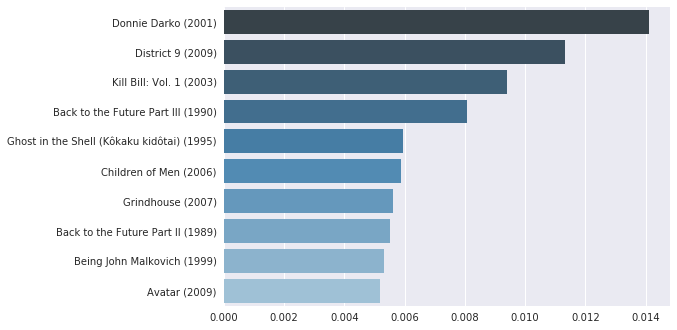

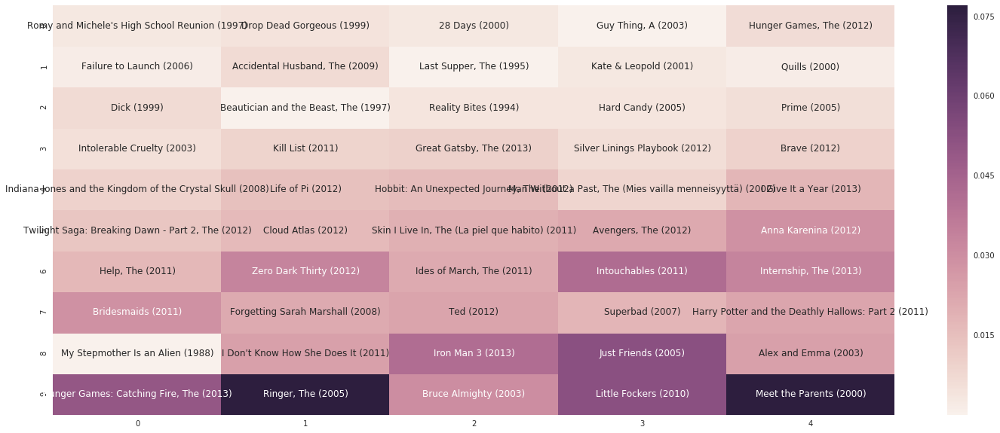

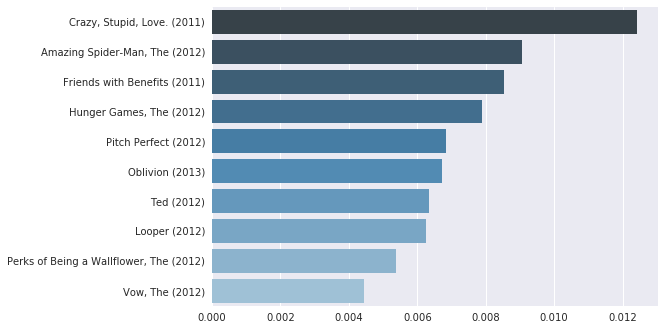

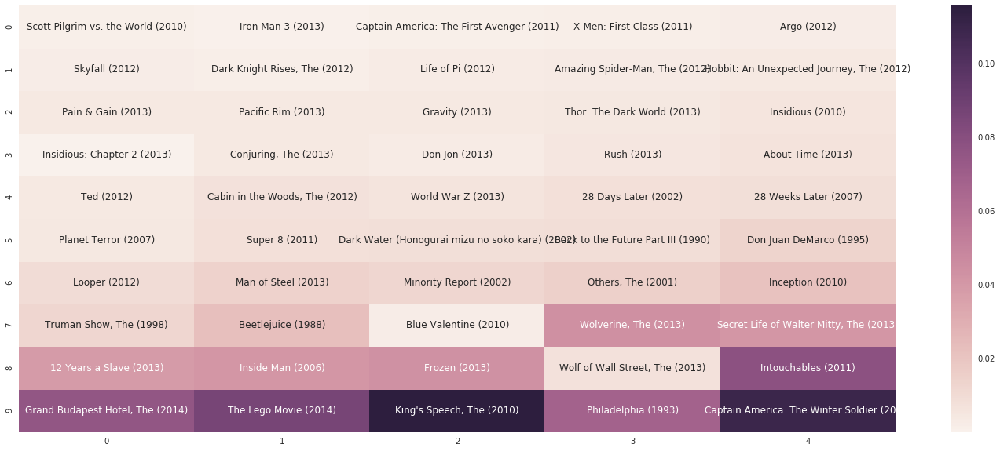

correct_predicted: ['X-Men: Days of Future Past (2014)']
true_movies: ['Interstellar (2014)', 'Guardians of the Galaxy (2014)', 'Boyhood (2014)', 'Her (2013)', 'X-Men: Days of Future Past (2014)', 'Shining, The (1980)', 'Life Is Beautiful (La Vita è bella) (1997)', 'Usual Suspects, The (1995)', 'Girl with the Dragon Tattoo, The (Män som hatar kvinnor) (2009)']


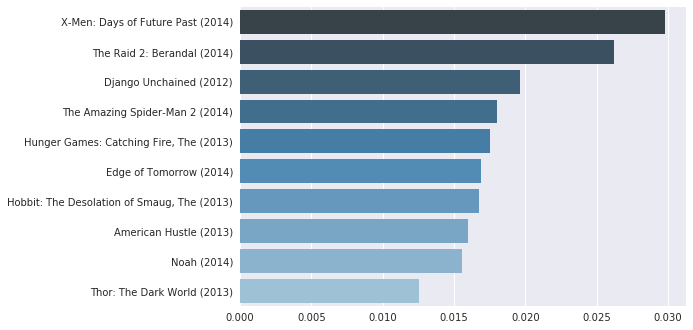

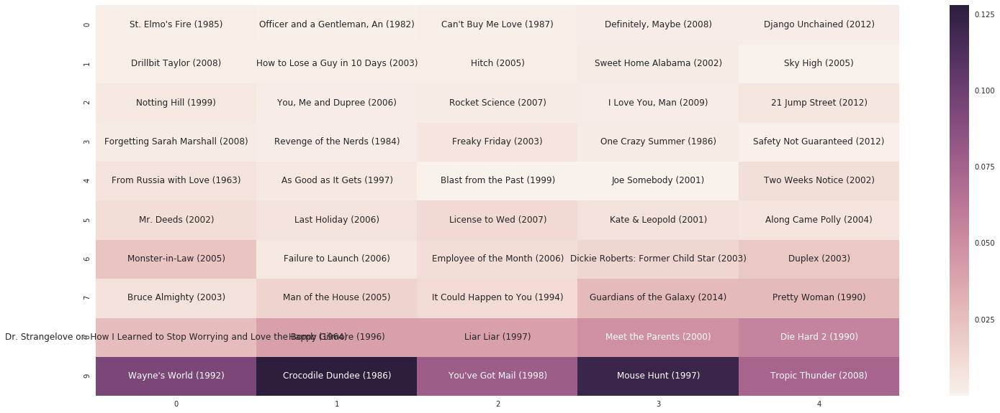

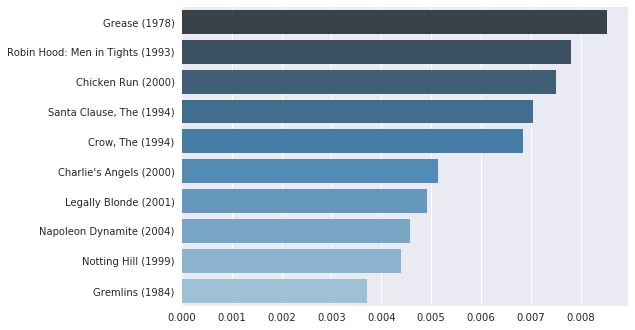

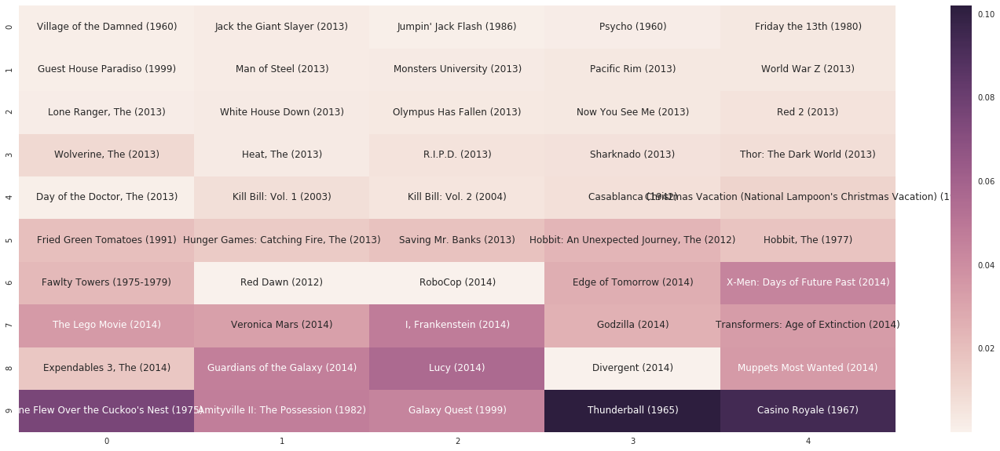

correct_predicted: ['Teenage Mutant Ninja Turtles (2014)', 'Captain America: The Winter Soldier (2014)', 'How to Train Your Dragon 2 (2014)']
true_movies: ['Cast Away (2000)', 'Blood Diamond (2006)', 'Elysium (2013)', 'Moon (2009)', 'Planes (2013)', 'Island, The (2005)', 'Terminal, The (2004)', 'Live Free or Die Hard (2007)', 'Skyfall (2012)', 'Silver Linings Playbook (2012)', 'Windtalkers (2002)', 'Tears of the Sun (2003)', 'Number 23, The (2007)', 'Proposal, The (2009)', 'Wreck-It Ralph (2012)', 'Red Eye (2005)', 'Brave (2012)', 'Blood Work (2002)', 'Basic (2003)', 'Paul (2011)', 'Frozen (2013)', 'Ted (2012)', 'Death Race (2008)', 'Rush Hour 3 (2007)', 'Captain America: The Winter Soldier (2014)', 'Sucker Punch (2011)', 'Hollywood Homicide (2003)', 'Pacifier, The (2005)', 'Out of Time (2003)', 'Whip It (2009)', 'Just Friends (2005)', 'Snow Dogs (2002)', 'Despicable Me 2 (2013)', 'Rush (2013)', 'Tourist, The (2010)', 'Resident Evil: Afterlife (2010)', 'Dredd (2012)', 'Lords of Dogtown

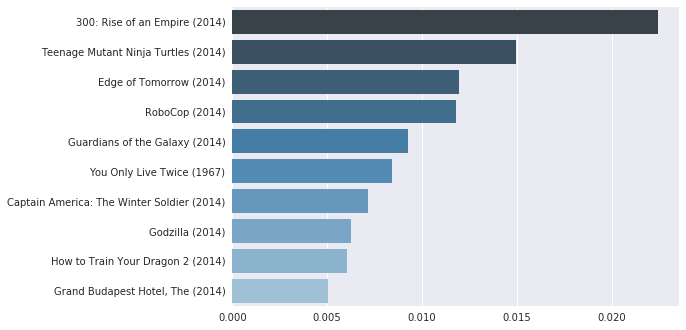

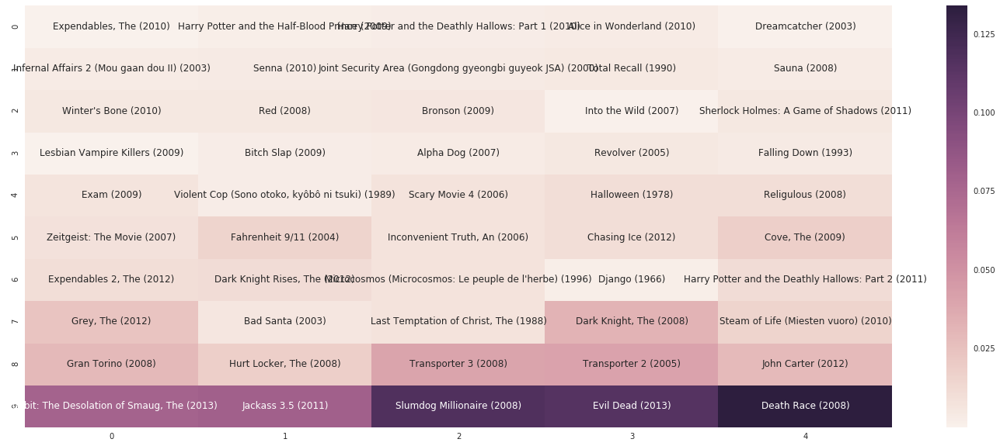

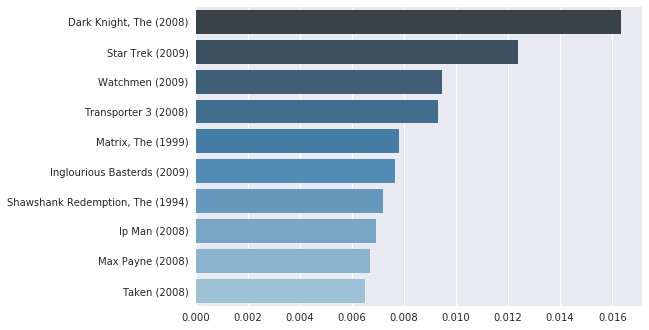

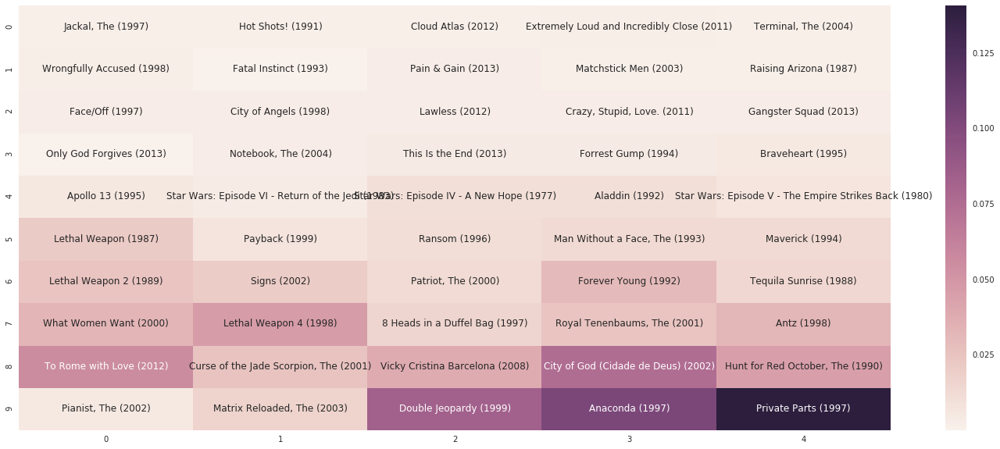

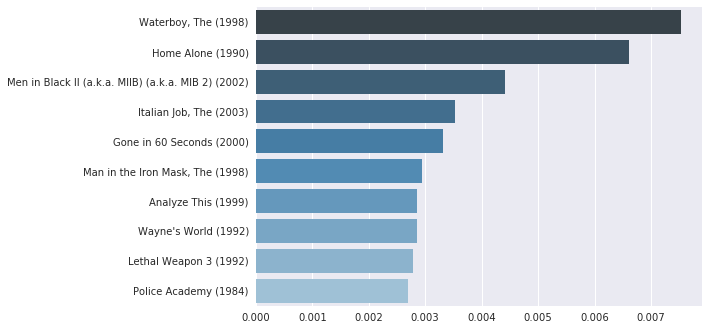

...

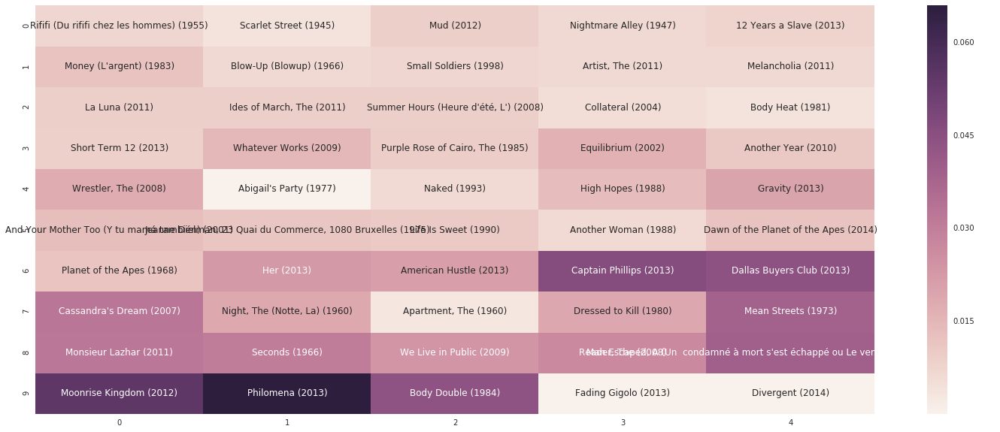

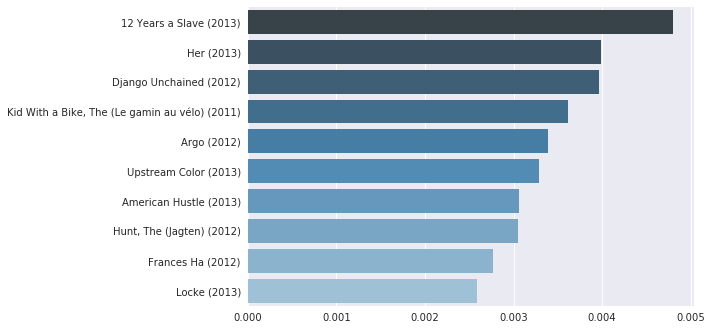

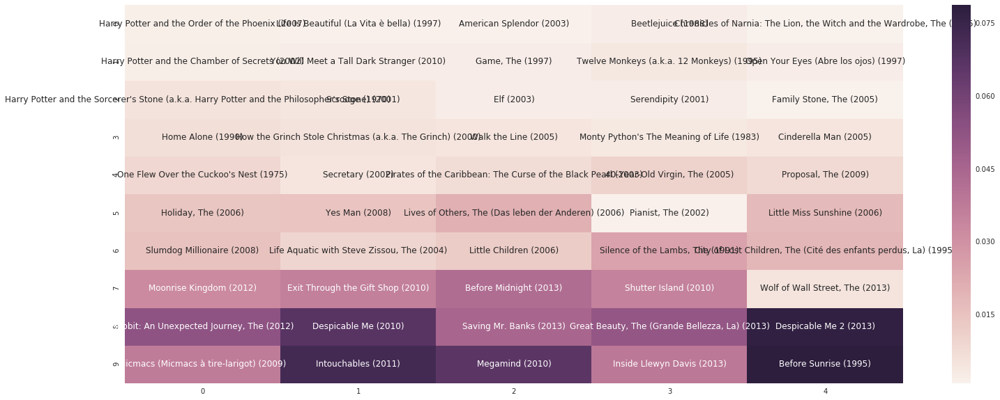

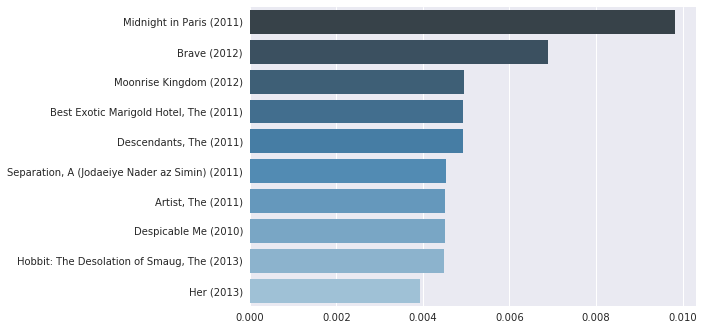

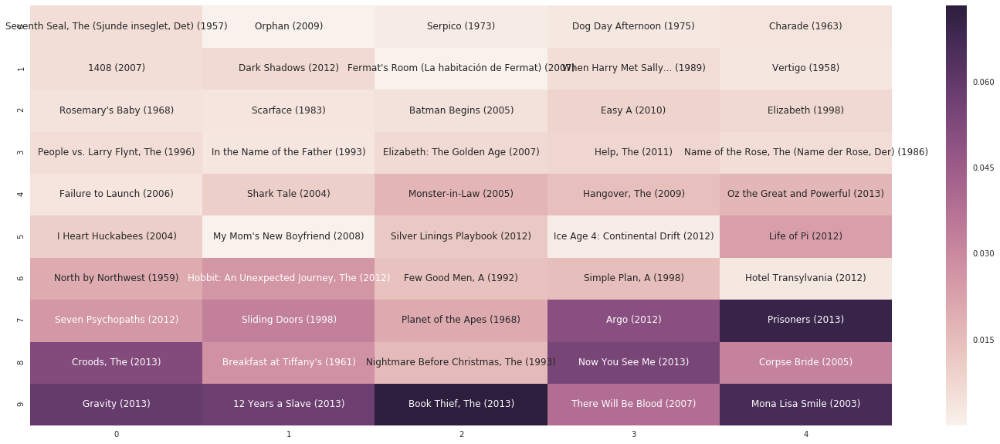

correct_predicted: ['Hobbit: The Desolation of Smaug, The (2013)']
true_movies: ['Taken (2008)', 'Forces of Nature (1999)', 'Hobbit: The Desolation of Smaug, The (2013)', 'Dogtooth (Kynodontas) (2009)']


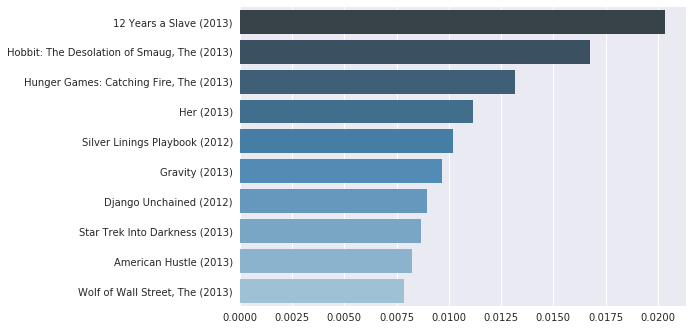

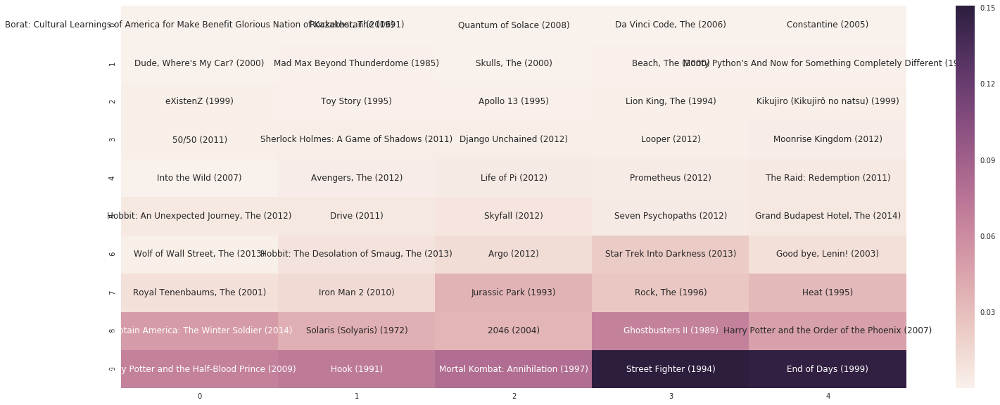

correct_predicted: ['Fifth Element, The (1997)', 'Cube (1997)', 'Dark Knight Rises, The (2012)']
true_movies: ['Her (2013)', 'Fountain, The (2006)', 'Tekkonkinkreet (Tekkon kinkurîto) (2006)', 'Adjustment Bureau, The (2011)', 'Ray (2004)', 'Bourne Identity, The (1988)', 'Cube 2: Hypercube (2002)', '28 Days Later (2002)', '28 Weeks Later (2007)', 'The Butterfly Effect (2004)', 'Fast and the Furious: Tokyo Drift, The (Fast and the Furious 3, The) (2006)', 'Spider-Man 3 (2007)', 'Final Fantasy VII: Advent Children (2004)', 'Eternal Sunshine of the Spotless Mind (2004)', 'Bowling for Columbine (2002)', 'Silence of the Lambs, The (1991)', 'Blade Runner (1982)', 'X-Men: First Class (2011)', 'Gattaca (1997)', 'Kick-Ass (2010)', 'Zeitgeist: Addendum (2008)', 'Twelve Monkeys (a.k.a. 12 Monkeys) (1995)', 'Daredevil (2003)', 'Powder (1995)', 'Hunger Games, The (2012)', 'Casshern (2004)', 'Iron Man 3 (2013)', 'Waking Life (2001)', 'Juno (2007)', "Dracula (Bram Stoker's Dracula) (1992)", 'Human Tra

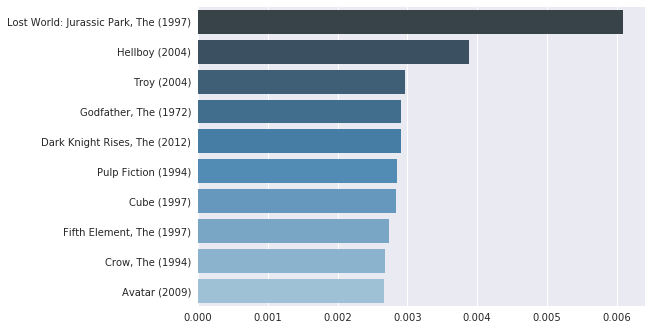

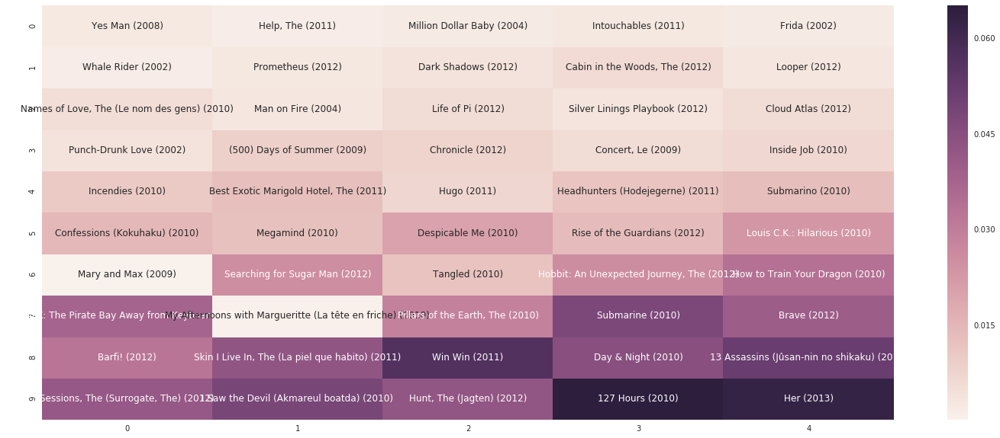

correct_predicted: ['Tucker & Dale vs Evil (2010)']
true_movies: ['Wolf of Wall Street, The (2013)', 'Scott Pilgrim vs. the World (2010)', 'Tucker & Dale vs Evil (2010)', 'Monsieur Lazhar (2011)', 'Micmacs (Micmacs à tire-larigot) (2009)', 'Boy (2010)', '22 Jump Street (2014)', 'Elysium (2013)', 'Robot & Frank (2012)', '2 Guns (2013)', 'Internship, The (2013)']


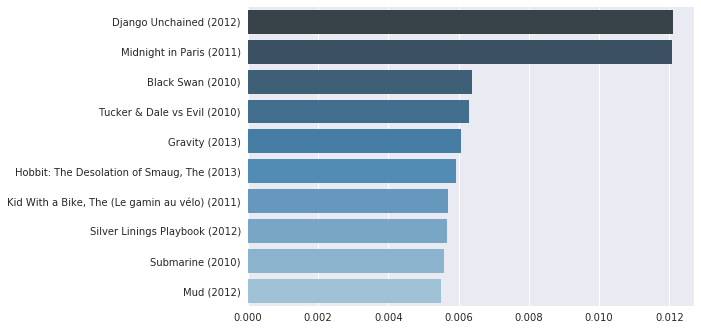

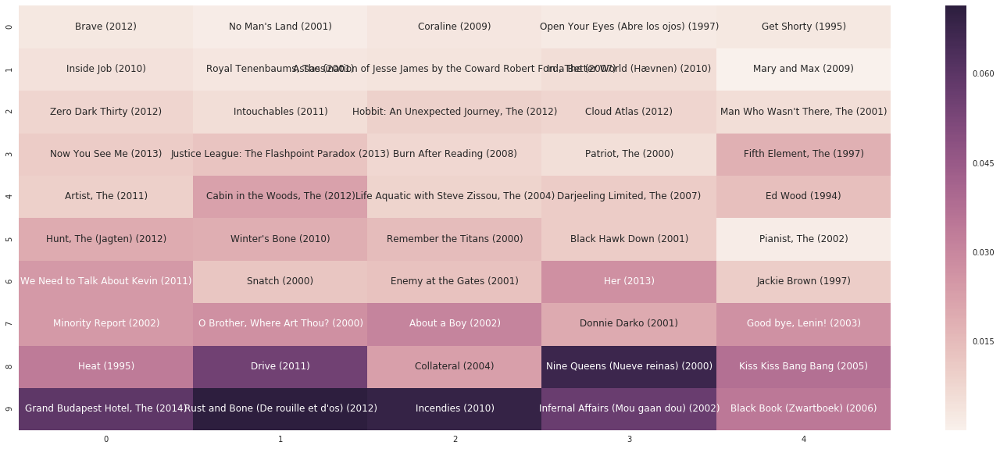

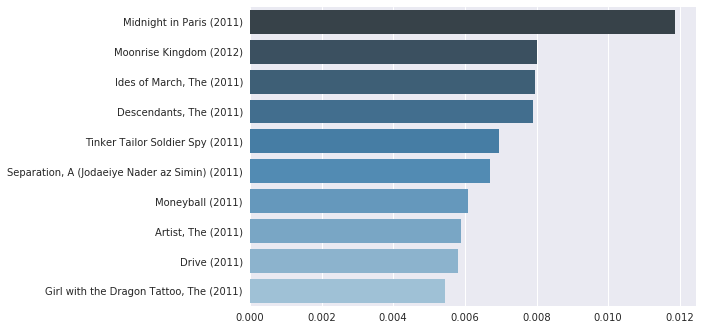

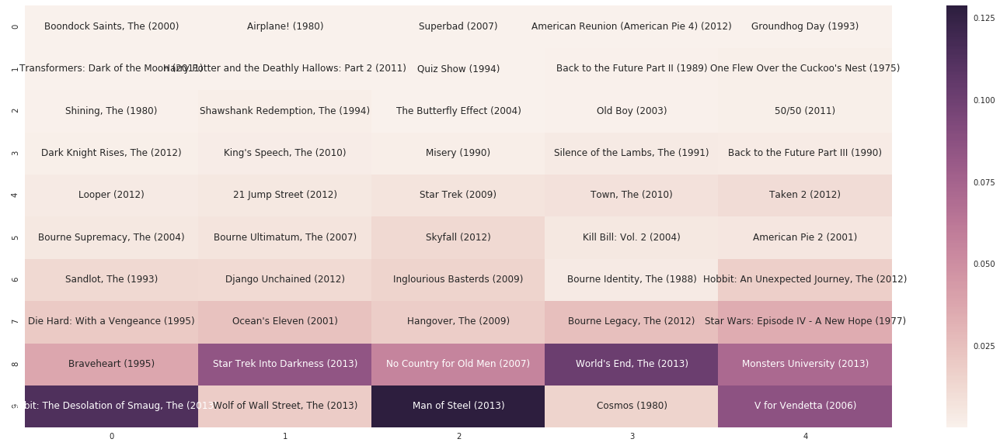

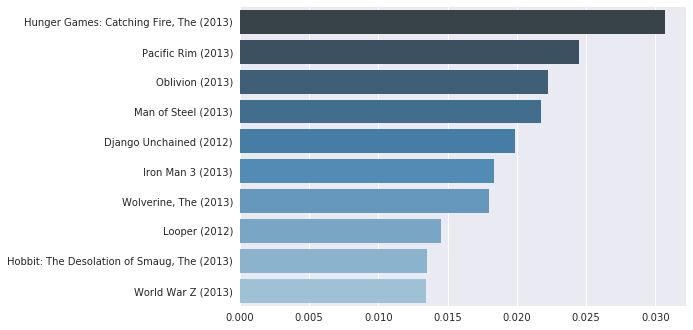

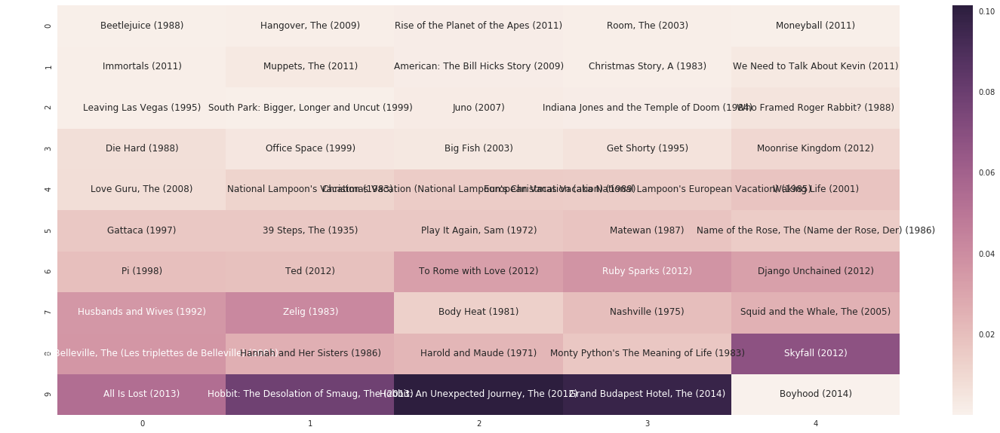

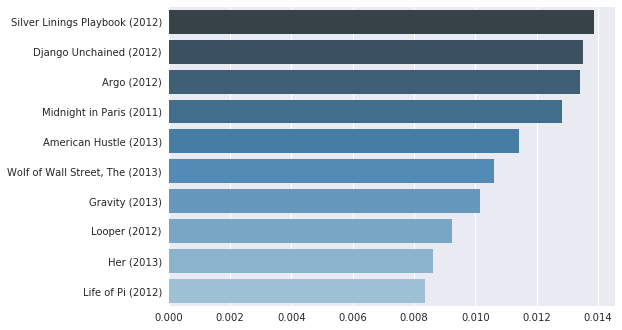

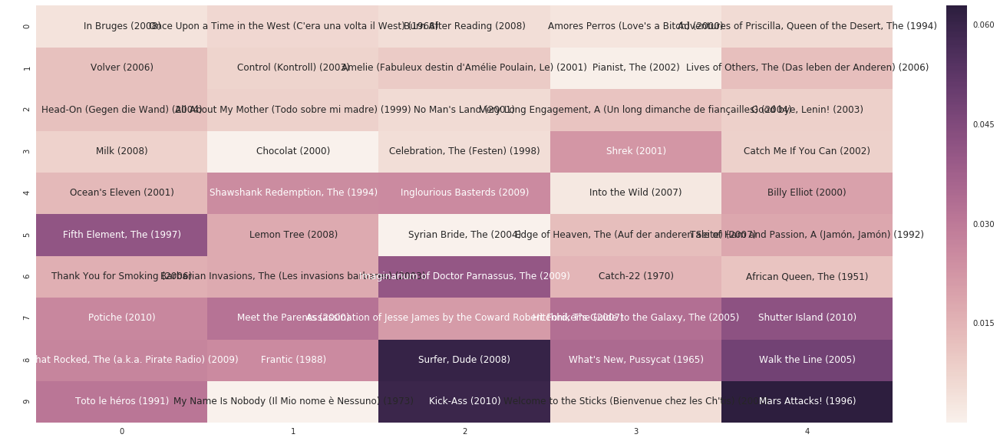

correct_predicted: ['Little Miss Sunshine (2006)']
true_movies: ['12 Angry Men (1957)', 'Intouchables (2011)', 'Good, the Bad and the Ugly, The (Buono, il brutto, il cattivo, Il) (1966)', 'Snatch (2000)', 'Magnificent Seven, The (1960)', 'Children of Men (2006)', 'Brassed Off (1996)', 'Despicable Me (2010)', 'Pirates! Band of Misfits, The (2012)', 'Wave, The (Welle, Die) (2008)', 'Adjustment Bureau, The (2011)', "King's Speech, The (2010)", 'Little Miss Sunshine (2006)', "It's Kind of a Funny Story (2010)", 'Easy Rider (1969)', 'Waltz with Bashir (Vals im Bashir) (2008)', 'Tron: Legacy (2010)', 'Film with Me in It, A (2008)', 'My Big Fat Greek Wedding (2002)', 'Talk to Me (2007)']


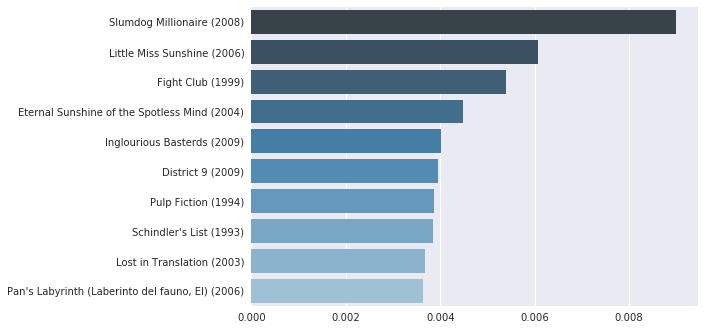

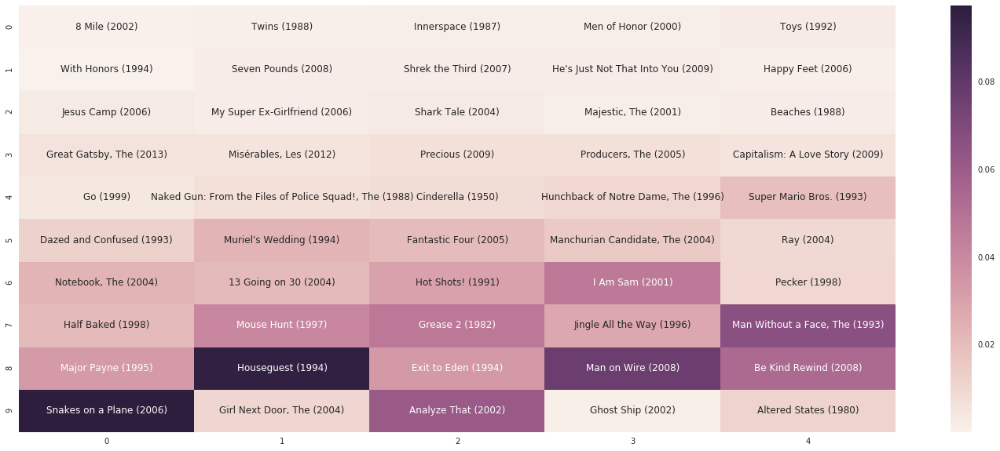

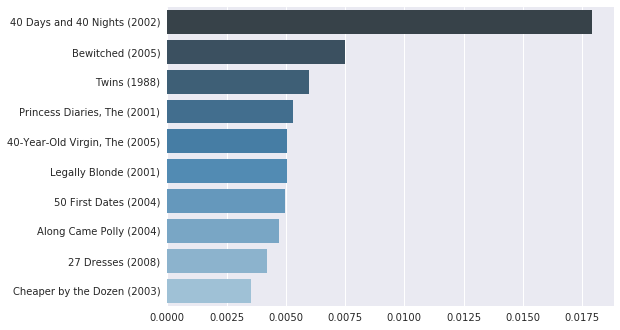

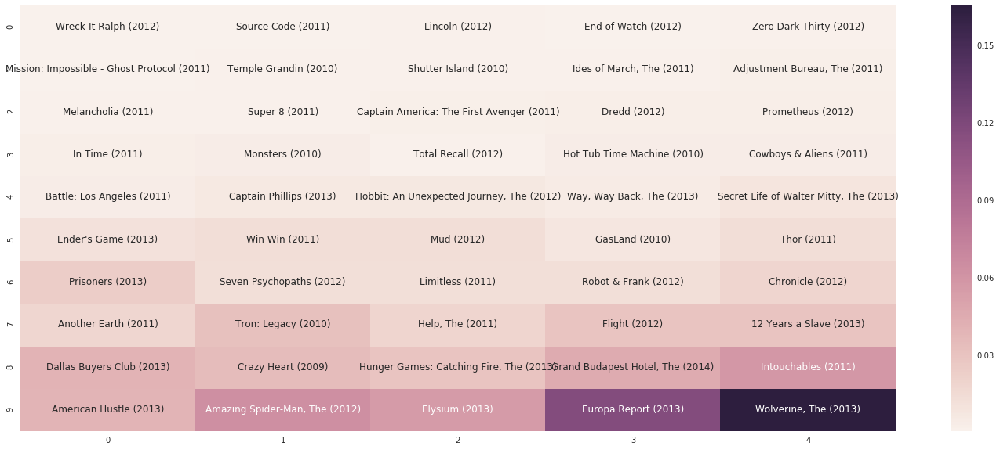

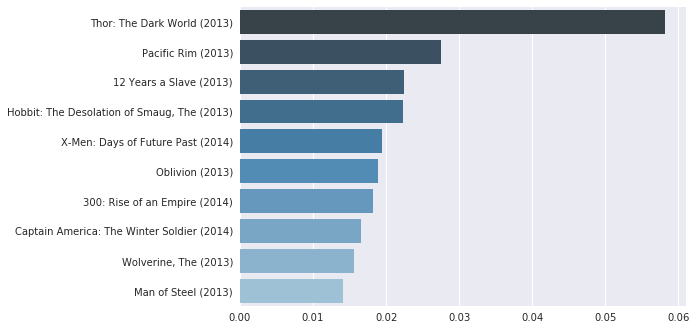

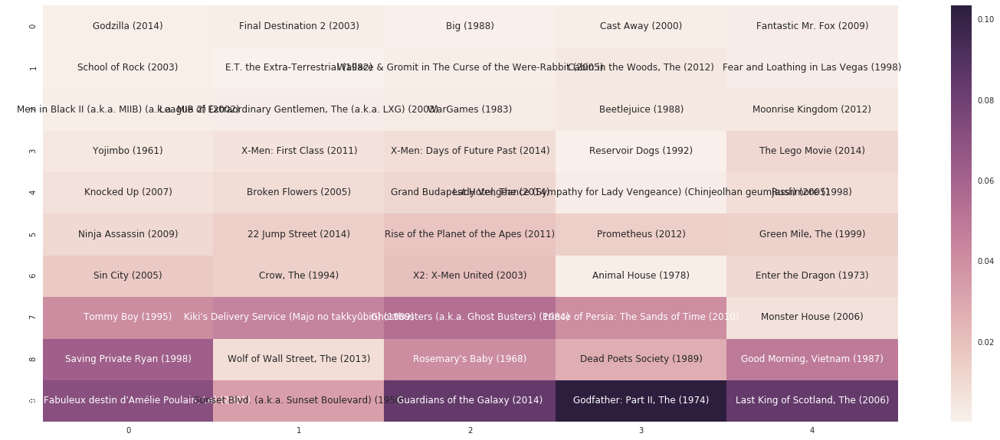

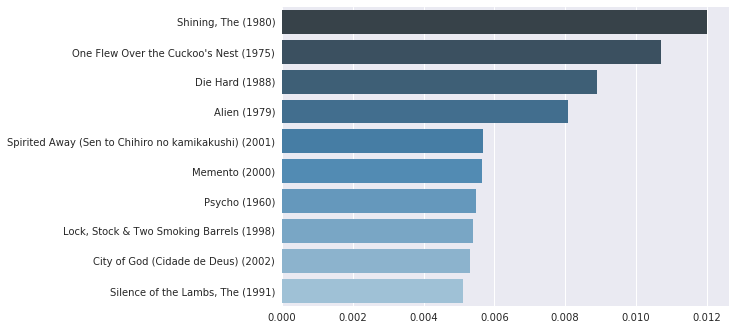

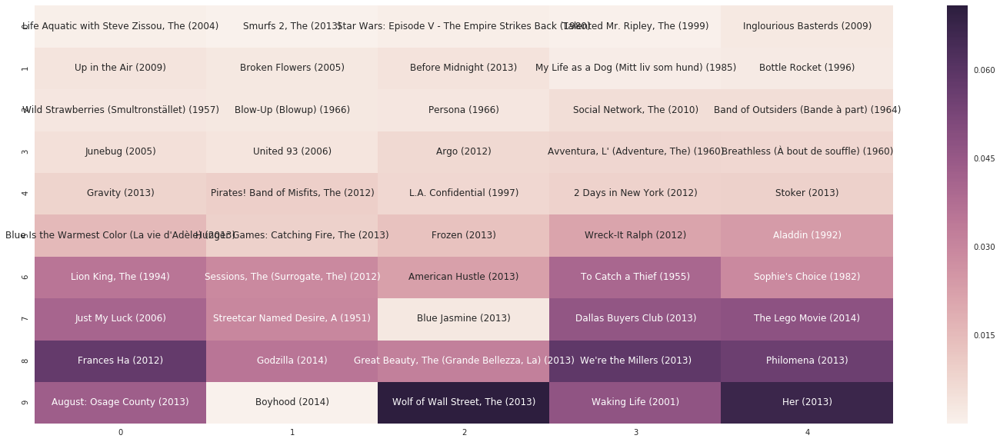

correct_predicted: ['Grand Budapest Hotel, The (2014)']
true_movies: ['Foxcatcher (2014)', 'The Imitation Game (2014)', 'The Interview (2014)', 'Mother (Madeo) (2009)', "It's a Wonderful Life (1946)", 'Hunt, The (Jagten) (2012)', 'Celebration, The (Festen) (1998)', 'Other Woman, The (2014)', 'Grand Budapest Hotel, The (2014)', "Stranger by the Lake (L'inconnu du lac) (2013)", 'Into the Woods (2014)', 'Under the Skin (2013)', 'Only Lovers Left Alive (2013)', 'Theory of Everything, The (2014)', 'In Her Shoes (2005)']


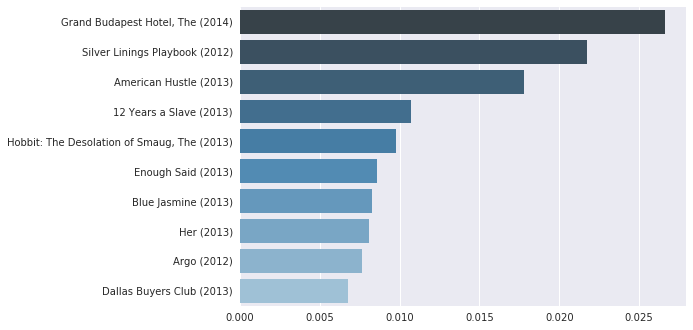

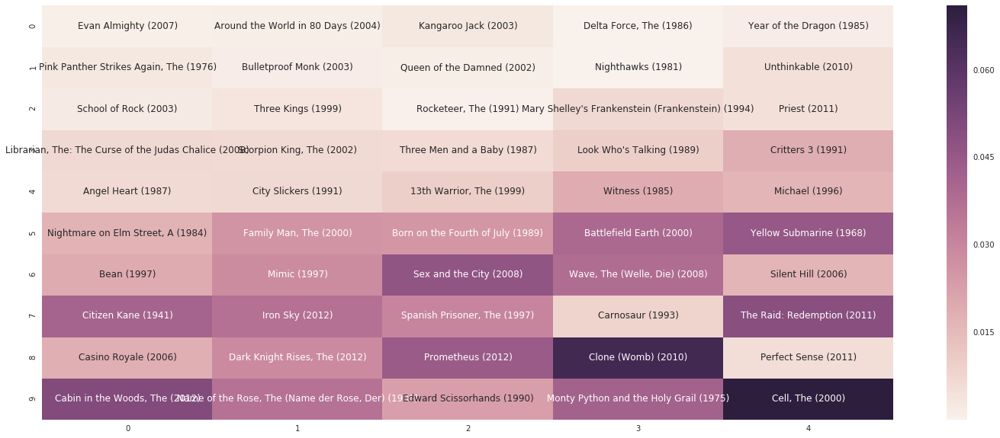

correct_predicted: ['Skyfall (2012)']
true_movies: ['Life Is Beautiful (La Vita è bella) (1997)', 'Chinatown (1974)', 'My Neighbor Totoro (Tonari no Totoro) (1988)', 'Django Unchained (2012)', 'Her (2013)', 'Hate (Haine, La) (1995)', 'Silver Linings Playbook (2012)', 'Once (2006)', 'Waltz with Bashir (Vals im Bashir) (2008)', 'Mr. Nobody (2009)', 'Selma (2014)', 'Cosmos (1980)', 'Gone Girl (2014)', 'Persepolis (2007)', 'Argo (2012)', 'Little Miss Sunshine (2006)', '12 Years a Slave (2013)', 'Departures (Okuribito) (2008)', 'Before Midnight (2013)', 'X-Men: Days of Future Past (2014)', 'Hobbit: An Unexpected Journey, The (2012)', 'Garden State (2004)', 'Farewell My Concubine (Ba wang bie ji) (1993)', 'Skyfall (2012)', 'Gravity (2013)', 'Sherlock Holmes: A Game of Shadows (2011)', 'Last Emperor, The (1987)', 'Secret World of Arrietty, The (Kari-gurashi no Arietti) (2010)', 'Ponyo (Gake no ue no Ponyo) (2008)', 'Sherlock Holmes (2009)', 'Calvary (2014)', 'Looper (2012)', 'Great Beauty, Th

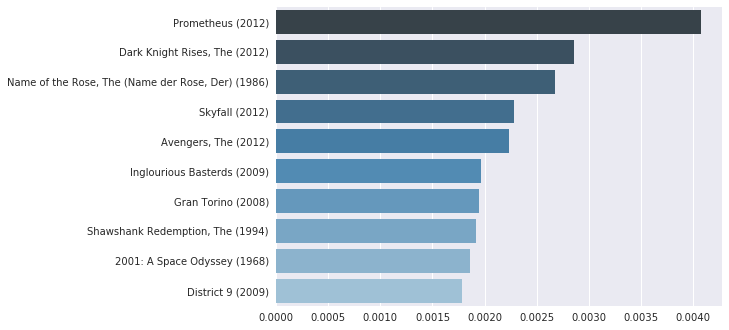

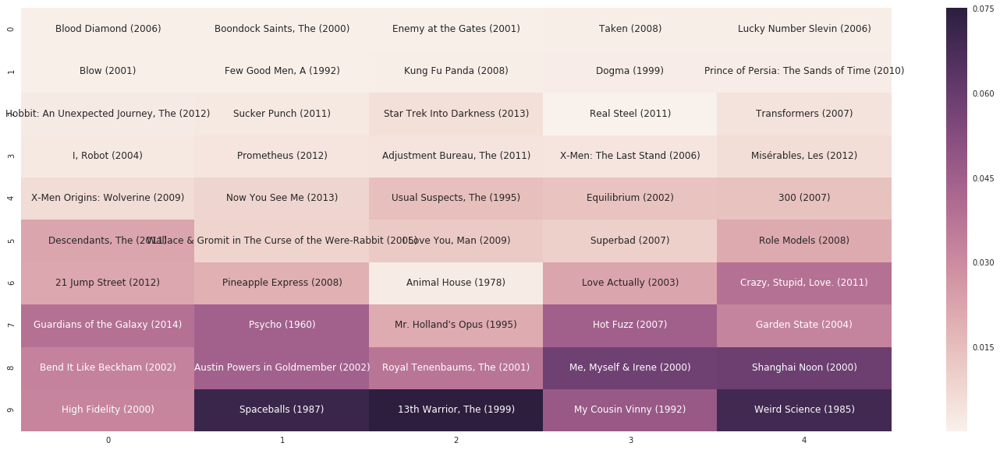

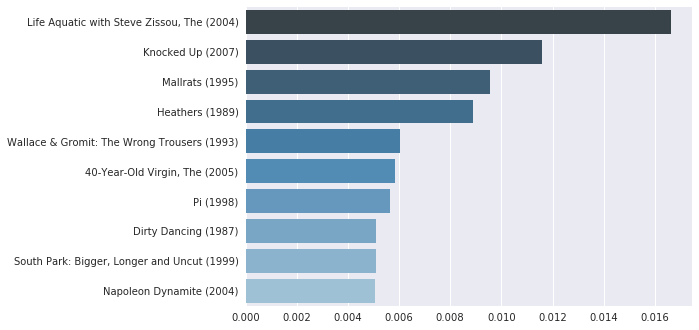

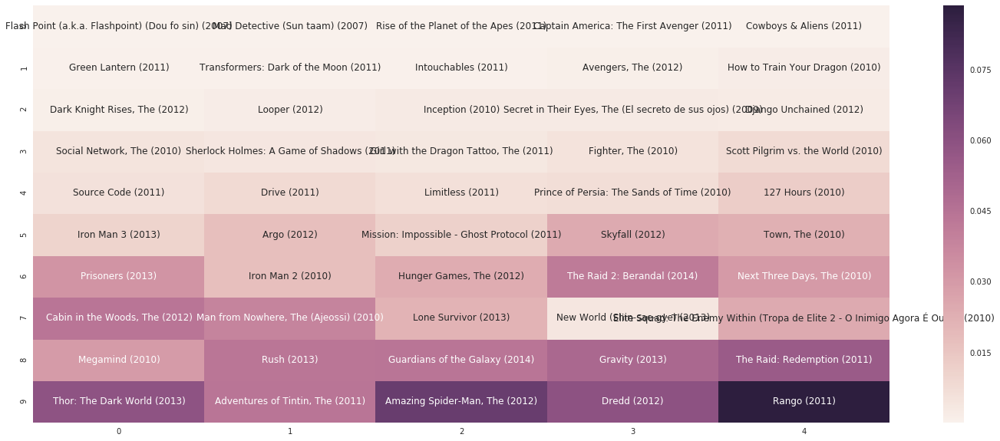

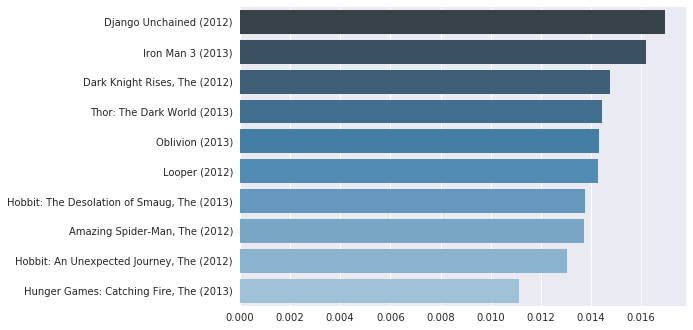

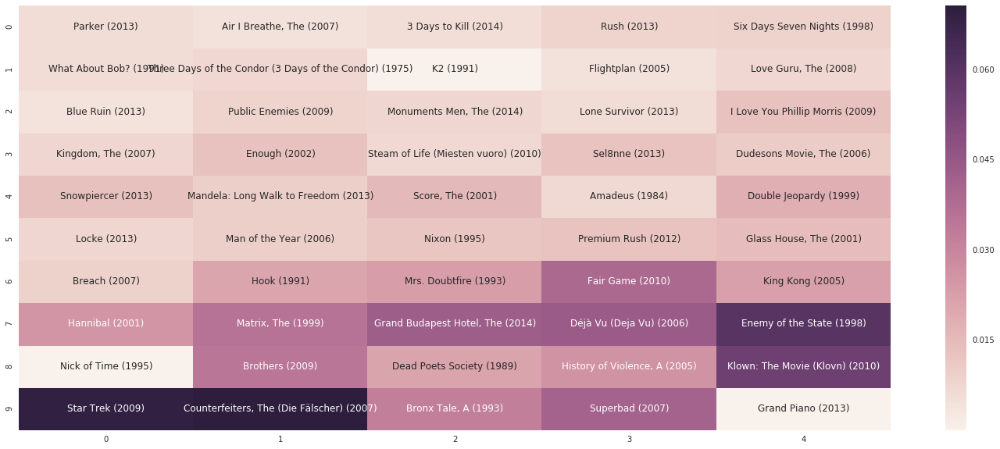

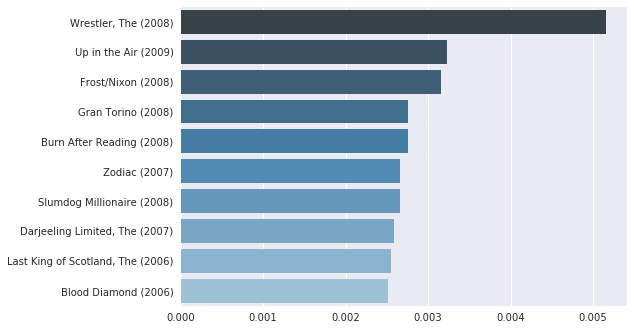

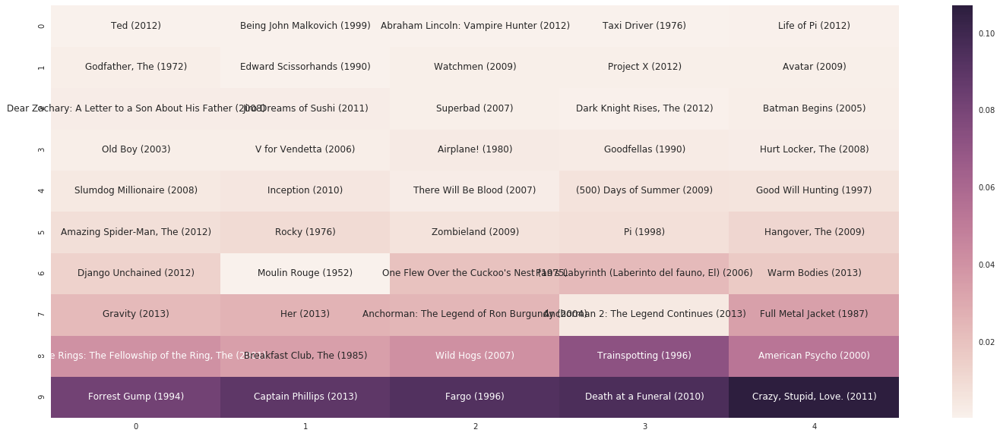

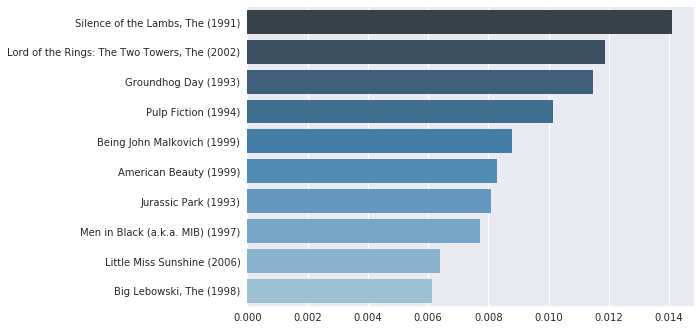

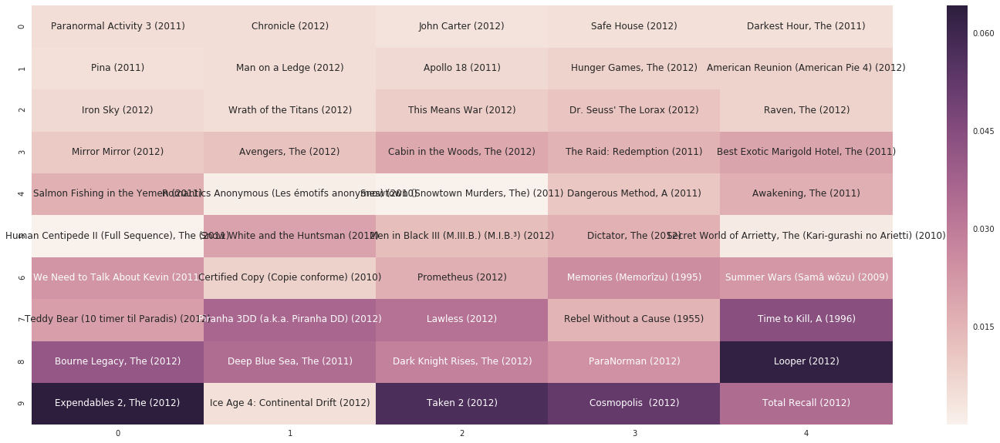

correct_predicted: ['Argo (2012)']
true_movies: ['Monsters, Inc. (2001)', 'Catch Me If You Can (2002)', 'Interstellar (2014)', 'Grand Budapest Hotel, The (2014)', 'Boyhood (2014)', 'Gone Girl (2014)', 'Guardians of the Galaxy (2014)', 'Edge of Tomorrow (2014)', 'X-Men: Days of Future Past (2014)', 'Wolf of Wall Street, The (2013)', 'How to Train Your Dragon 2 (2014)', 'The Raid 2: Berandal (2014)', 'Hobbit: The Desolation of Smaug, The (2013)', 'Captain America: The Winter Soldier (2014)', 'The Lego Movie (2014)', 'Saving Mr. Banks (2013)', 'American Hustle (2013)', 'Inside Llewyn Davis (2013)', 'Dawn of the Planet of the Apes (2014)', 'The Fault in Our Stars (2014)', '22 Jump Street (2014)', 'Nymphomaniac: Volume I (2013)', 'Divergent (2014)', 'Nymphomaniac: Volume II (2013)', 'Maleficent (2014)', 'The Hunger Games: Mockingjay - Part 1 (2014)', 'Non-Stop (2014)', 'Intouchables (2011)', 'Django Unchained (2012)', "Dr. Horrible's Sing-Along Blog (2008)", 'Moonrise Kingdom (2012)', 'Apar

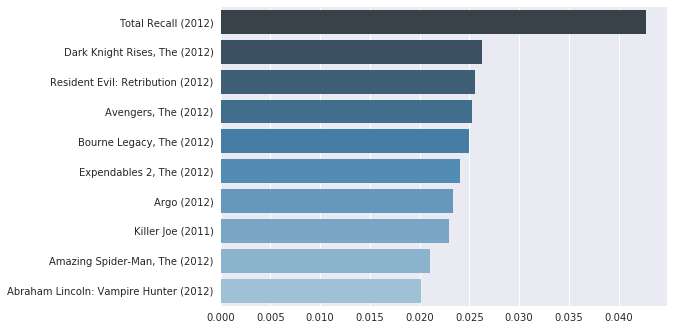

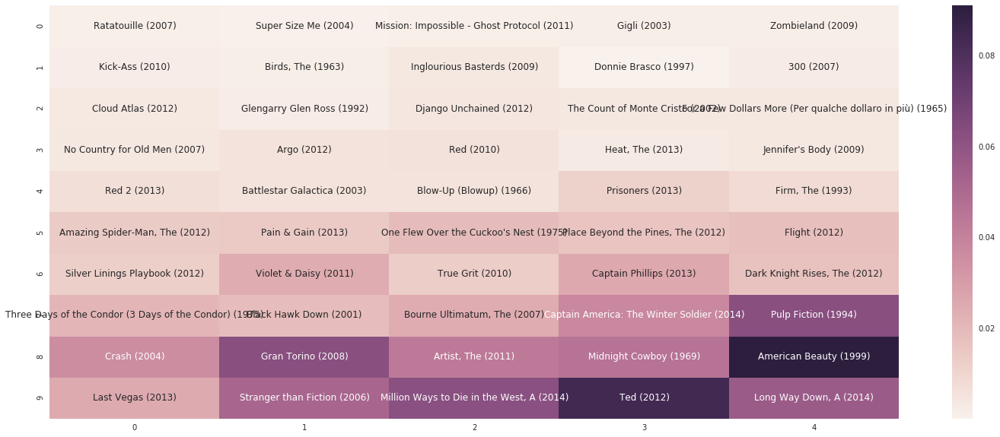

correct_predicted: ['12 Years a Slave (2013)']
true_movies: ['Cabin in the Woods, The (2012)', 'Grand Budapest Hotel, The (2014)', 'Gangster Squad (2013)', '12 Years a Slave (2013)', 'Wolf of Wall Street, The (2013)', "Breakfast at Tiffany's (1961)", 'Casino Royale (2006)', 'Skyfall (2012)', 'Pianist, The (2002)', 'Dallas Buyers Club (2013)', 'Once Upon a Time in America (1984)', 'Roman Holiday (1953)', 'Rush (2013)', 'English Patient, The (1996)', 'Atonement (2007)', 'Lawrence of Arabia (1962)', 'Notebook, The (2004)', 'In Bruges (2008)', 'North by Northwest (1959)', 'Drive (2011)', 'Death Proof (2007)', 'Sting, The (1973)', 'Rebel Without a Cause (1955)', 'Seven (a.k.a. Se7en) (1995)', 'Bourne Supremacy, The (2004)', 'Fistful of Dollars, A (Per un pugno di dollari) (1964)', 'Saving Grace (2000)', 'Bourne Legacy, The (2012)', 'Counselor, The (2013)', 'Sex Tape (2014)', 'Lovely Bones, The (2009)', 'Godfather: Part III, The (1990)', 'Donnie Darko (2001)', 'Irony of Fate, or Enjoy Your B

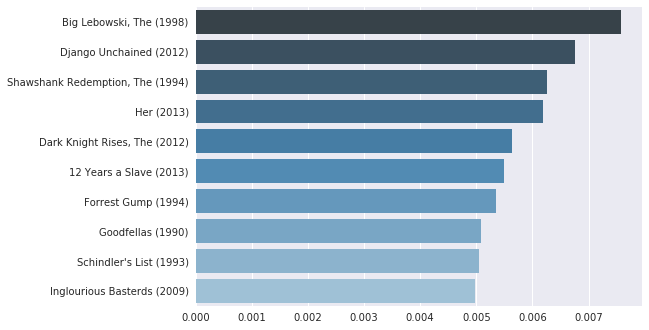

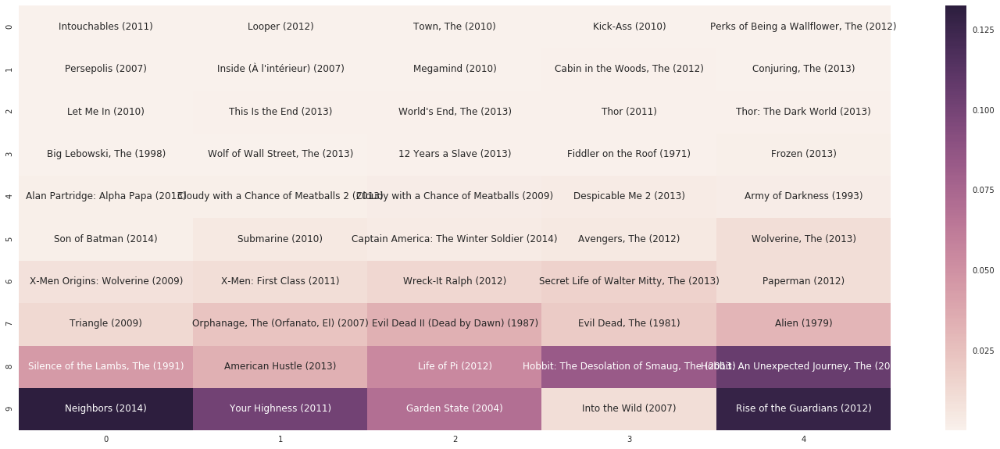

correct_predicted: ['Iron Man 3 (2013)', 'Amazing Spider-Man, The (2012)']
true_movies: ['Guardians of the Galaxy (2014)', 'Edge of Tomorrow (2014)', 'How to Train Your Dragon 2 (2014)', 'The Lego Movie (2014)', 'X-Men: Days of Future Past (2014)', 'Star Trek Into Darkness (2013)', 'Puss in Boots (2011)', 'Lucy (2014)', 'Iron Man 3 (2013)', 'Pirates of the Caribbean: On Stranger Tides (2011)', 'Amazing Spider-Man, The (2012)', 'Easy A (2010)', '22 Jump Street (2014)', 'Descent, The (2005)', 'Monty Python and the Holy Grail (1975)', "Monty Python's The Meaning of Life (1983)", 'Teenage Mutant Ninja Turtles (2014)', 'Corpse Bride (2005)', 'ParaNorman (2012)', 'Up (2009)', 'Let the Right One In (Låt den rätte komma in) (2008)', 'Cloverfield (2008)', "Rosemary's Baby (1968)", 'Shining, The (1980)', 'Mirrors (2008)', 'Deliver Us from Evil (2014)', "Dr. Horrible's Sing-Along Blog (2008)", 'Pandorum (2009)', 'Interstellar (2014)', "Futurama: Bender's Big Score (2007)", 'Watchmen (2009)', 'Fut

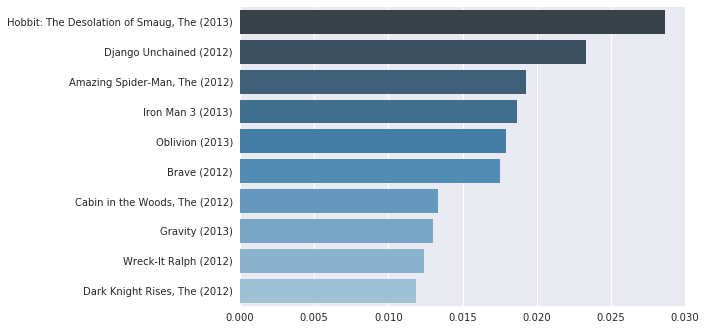

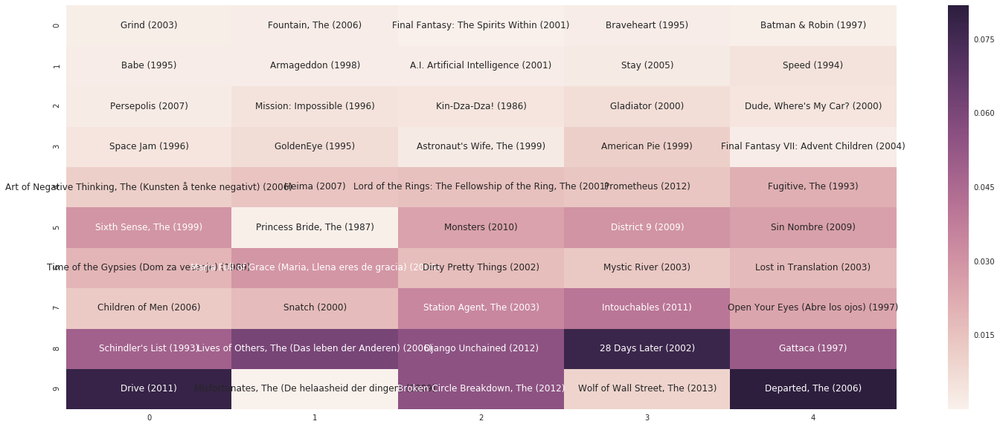

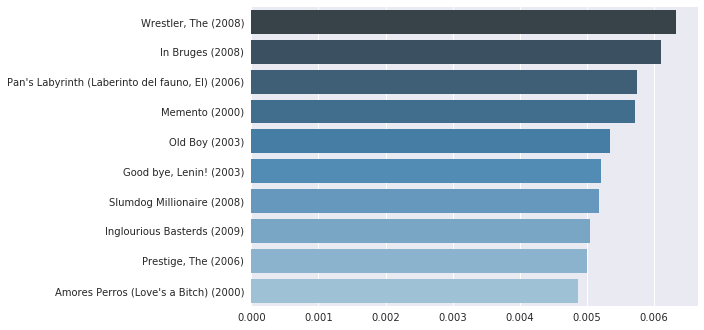

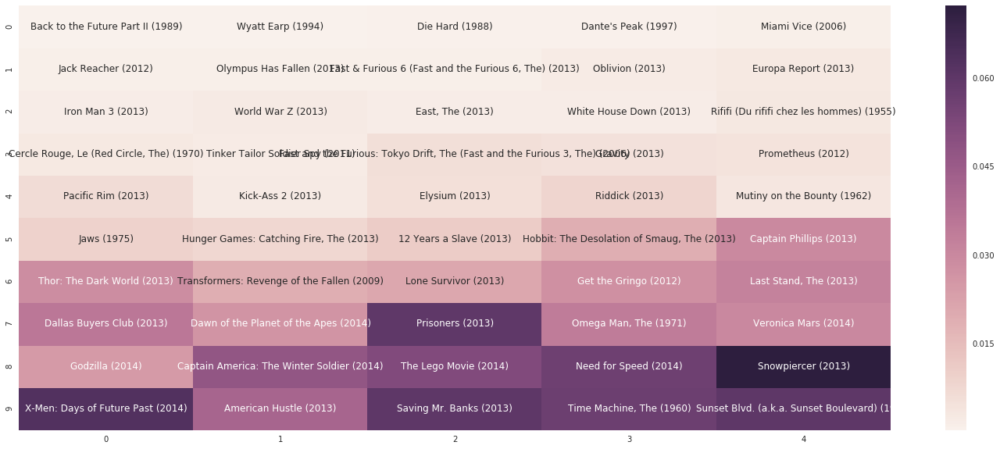

correct_predicted: ['Guardians of the Galaxy (2014)', 'Edge of Tomorrow (2014)']
true_movies: ['Thing, The (1982)', "Schindler's List (1993)", 'El Dorado (1966)', 'Lord of the Rings: The Return of the King, The (2003)', 'Hunt for Red October, The (1990)', 'Edge of Tomorrow (2014)', 'RoboCop (2014)', 'Most Wanted Man, A (2014)', 'Interstellar (2014)', 'The Hunger Games: Mockingjay - Part 1 (2014)', 'Guardians of the Galaxy (2014)', 'The Interview (2014)', 'Killer Elite (2011)', 'Brokeback Mountain (2005)', 'State of Play (2009)', 'Star Trek Into Darkness (2013)', 'The Imitation Game (2014)']


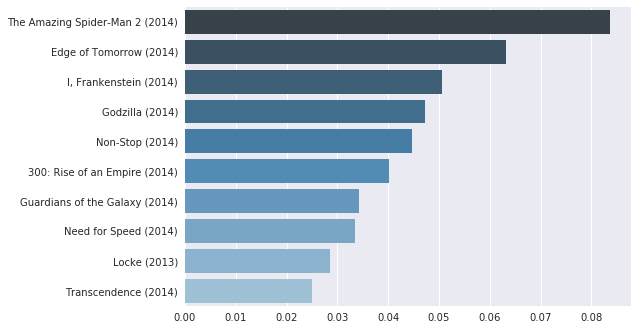

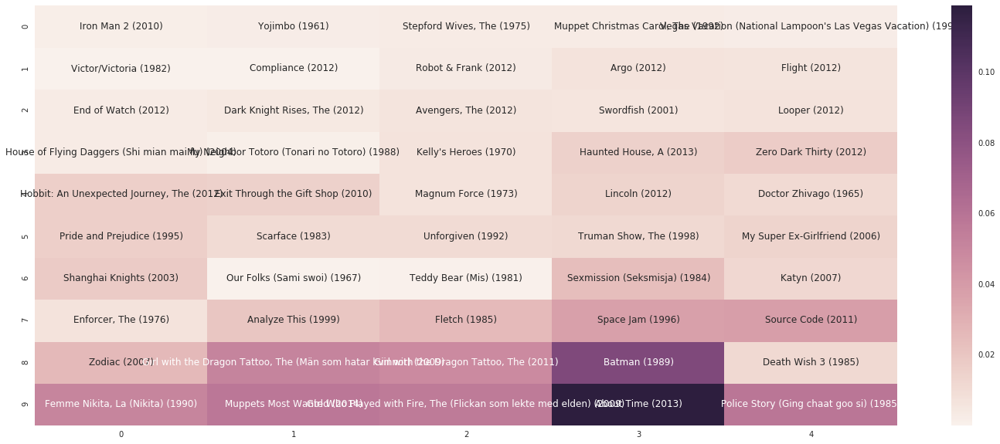

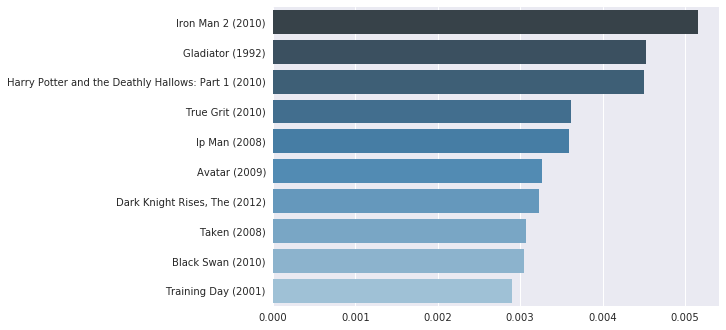

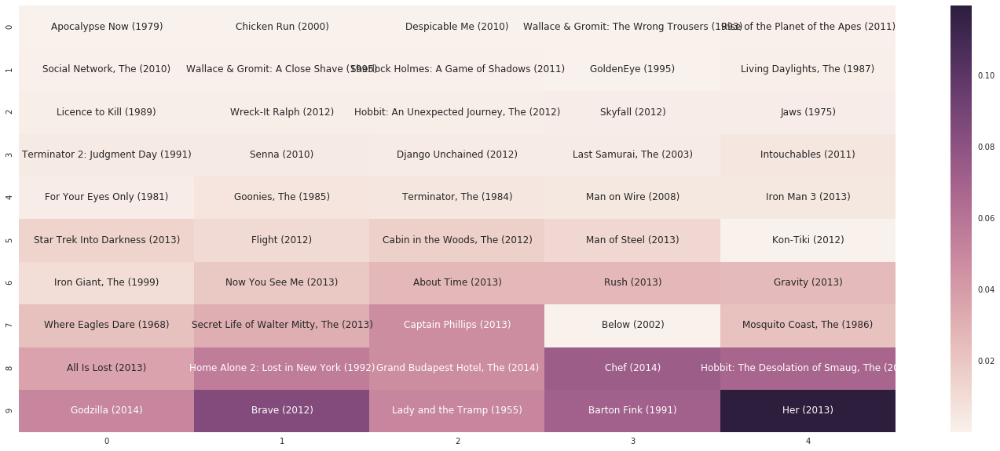

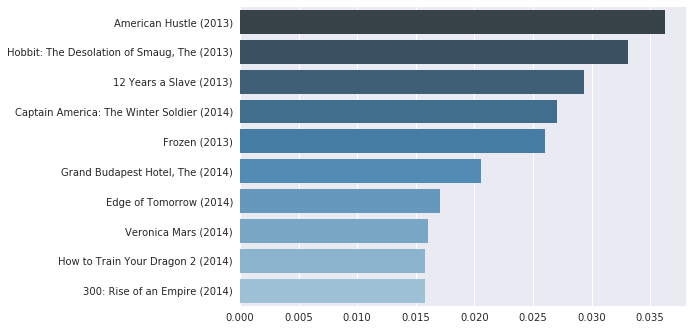

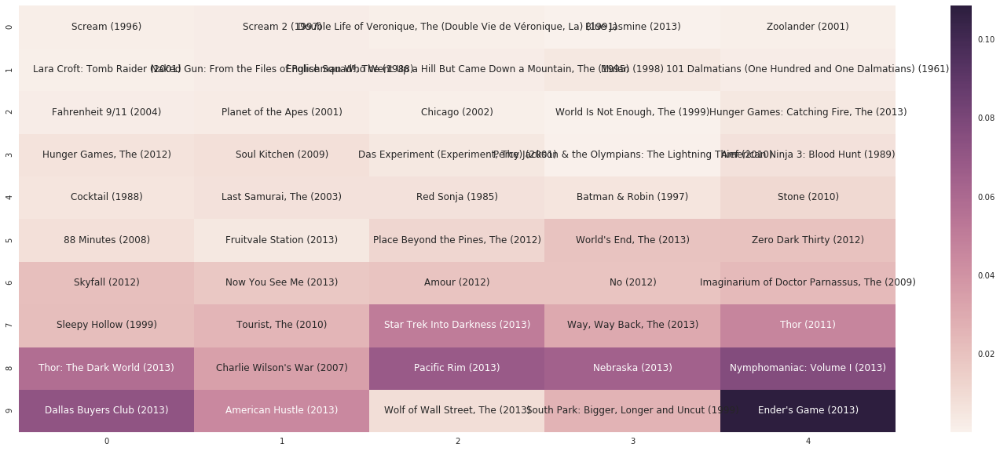

correct_predicted: ['12 Years a Slave (2013)', 'Her (2013)', '300: Rise of an Empire (2014)', 'Captain America: The Winter Soldier (2014)', 'Hobbit: The Desolation of Smaug, The (2013)', 'Gravity (2013)']
true_movies: ['Down by Law (1986)', 'Bridge on the River Kwai, The (1957)', 'Manchurian Candidate, The (1962)', 'Fish Called Wanda, A (1988)', "Monty Python's The Meaning of Life (1983)", 'Great Dictator, The (1940)', 'Spartacus (1960)', 'Maleficent (2014)', 'Frozen (2013)', 'Magic in the Moonlight (2014)', 'RoboCop (2014)', 'Divergent (2014)', 'Blue Velvet (1986)', 'Frida (2002)', 'Kill Bill: Vol. 2 (2004)', 'Black Book (Zwartboek) (2006)', 'Philomena (2013)', 'Past, The (Le passé) (2013)', 'Secret Life of Walter Mitty, The (2013)', 'Book Thief, The (2013)', 'Monsters University (2013)', 'King of Comedy, The (1983)', 'Hellboy (2004)', 'Hellboy II: The Golden Army (2008)', 'Her (2013)', 'Synecdoche, New York (2008)', 'Moneyball (2011)', 'Breakfast Club, The (1985)', 'Pitch Perfect (20

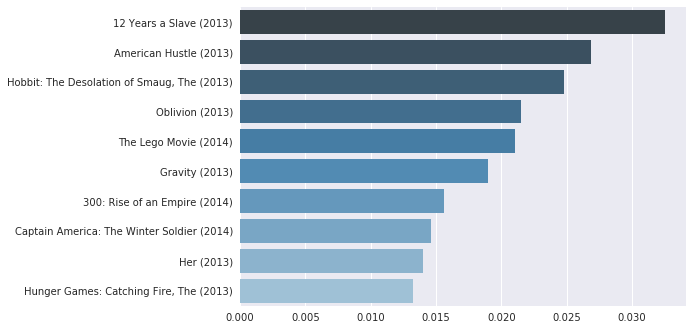

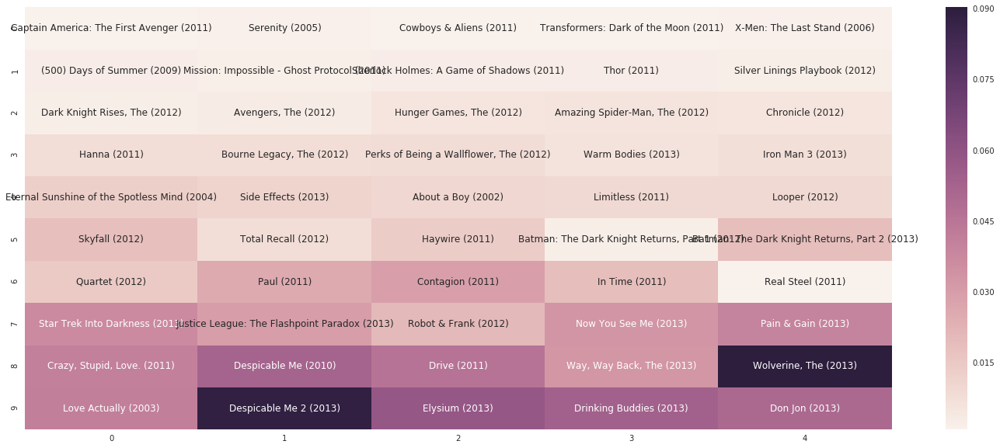

correct_predicted: ['Frozen (2013)']
true_movies: ['Dawn of the Planet of the Apes (2014)', 'About Time (2013)', 'Edge of Tomorrow (2014)', 'Django Unchained (2012)', 'Day of the Doctor, The (2013)', 'Begin Again (2013)', 'Rush (2013)', 'Frozen (2013)', 'Guardians of the Galaxy (2014)', 'X-Men: Days of Future Past (2014)', 'Gravity (2013)', 'The Lego Movie (2014)', 'Girl with the Dragon Tattoo, The (2011)', 'Die Hard (1988)', 'Gone Girl (2014)', 'Most Wanted Man, A (2014)', 'Interstellar (2014)', 'Big Hero 6 (2014)']


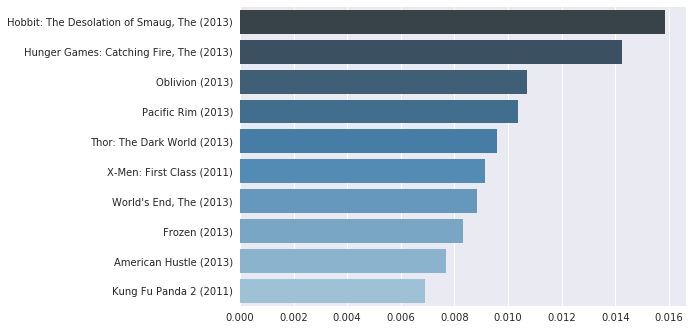

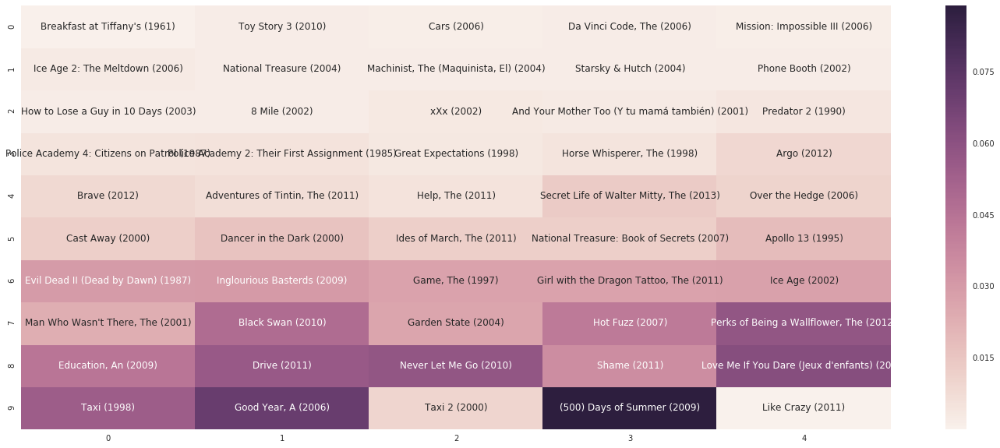

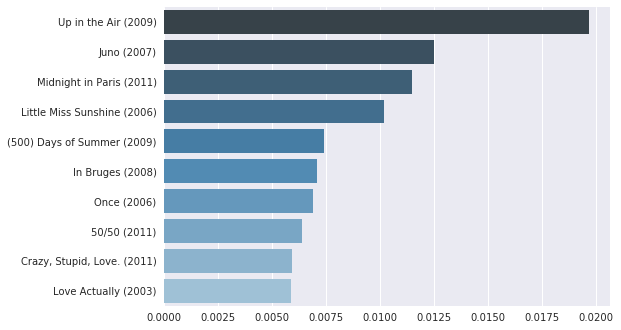

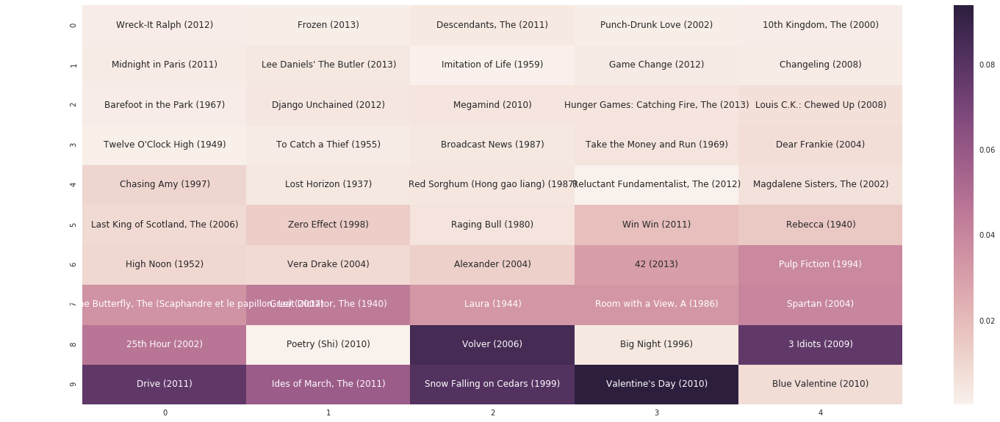

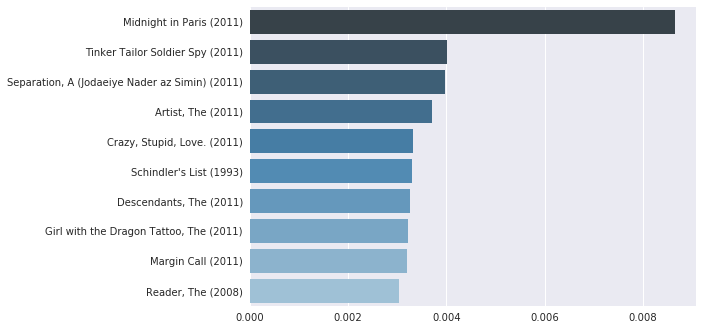

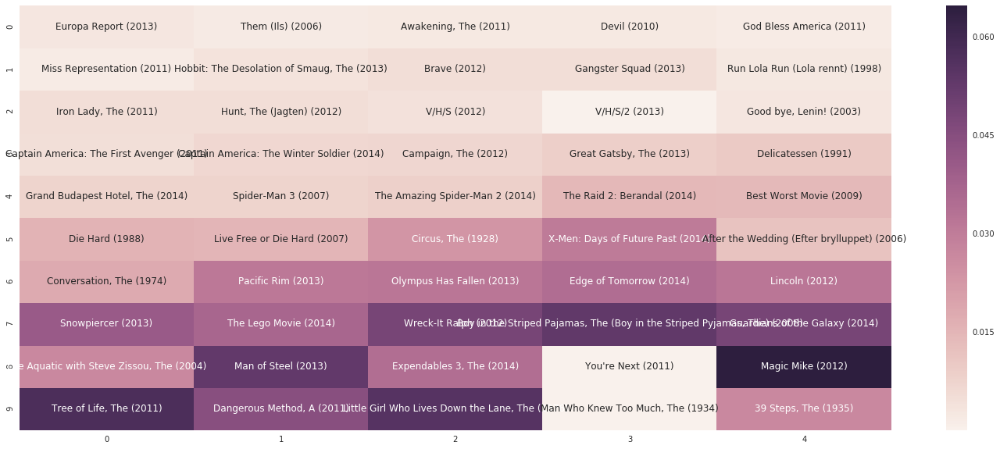

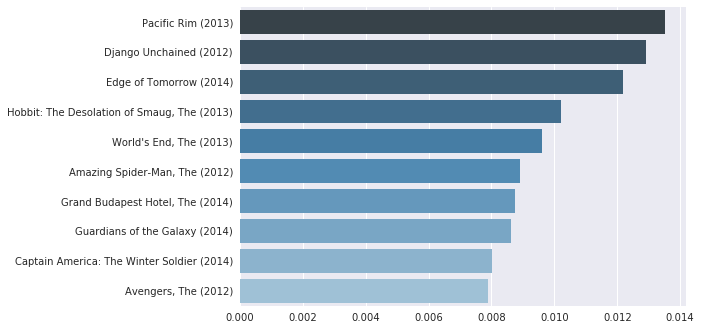

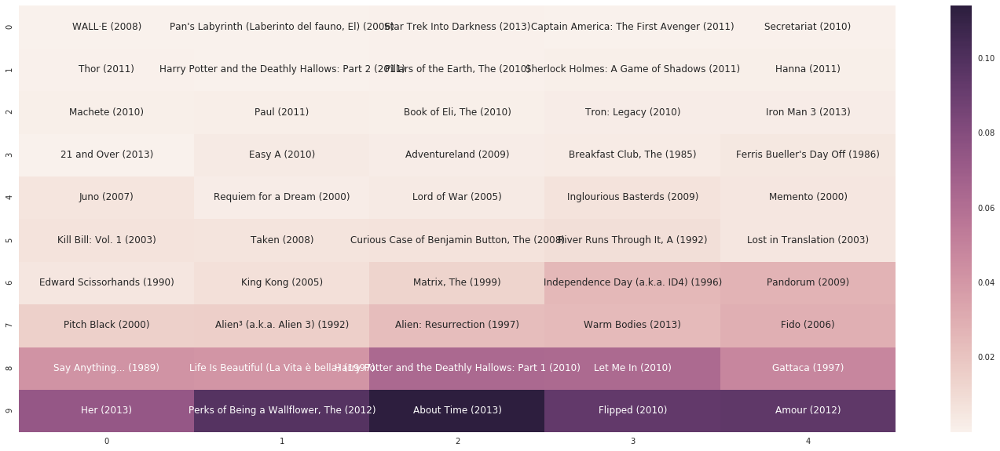

correct_predicted: ['Man of Steel (2013)', 'Oblivion (2013)', 'Hobbit: The Desolation of Smaug, The (2013)']
true_movies: ['Cabin in the Woods, The (2012)', 'Hobbit: The Desolation of Smaug, The (2013)', 'Searching for Sugar Man (2012)', 'Dallas Buyers Club (2013)', 'Jiro Dreams of Sushi (2011)', 'Fighter, The (2010)', 'X-Men: Days of Future Past (2014)', 'Captain America: The Winter Soldier (2014)', 'Guardians of the Galaxy (2014)', 'Limitless (2011)', 'Silver Linings Playbook (2012)', 'Man of Steel (2013)', 'Robot & Frank (2012)', 'Super 8 (2011)', 'Melancholia (2011)', 'BlinkyTM (2011)', 'Dredd (2012)', 'Oblivion (2013)', 'In Time (2011)', 'Clone (Womb) (2010)', 'Zero Dark Thirty (2012)', 'Pulp Fiction (1994)', 'No Country for Old Men (2007)', 'Fight Club (1999)', 'X-Men (2000)', 'Monsters, Inc. (2001)', "Amelie (Fabuleux destin d'Amélie Poulain, Le) (2001)", 'Too Many Cooks (2014)', 'Spirited Away (Sen to Chihiro no kamikakushi) (2001)', 'Princess Mononoke (Mononoke-hime) (1997)', 

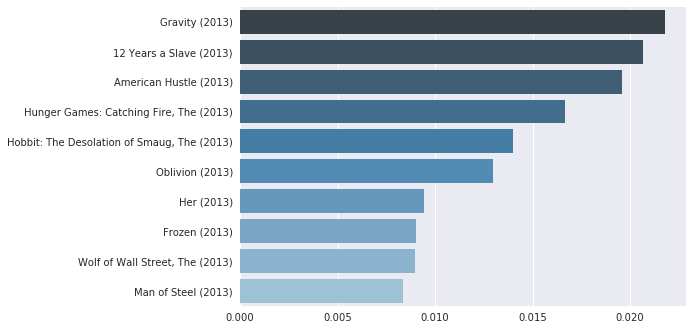

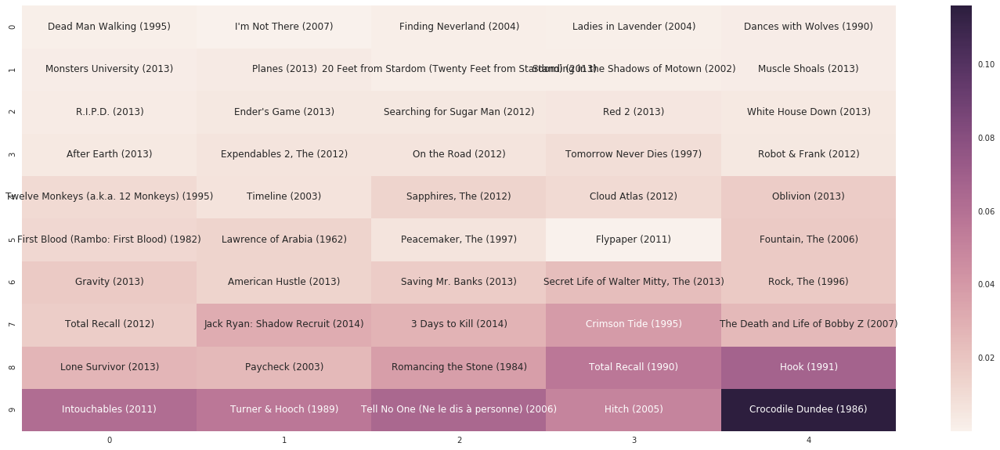

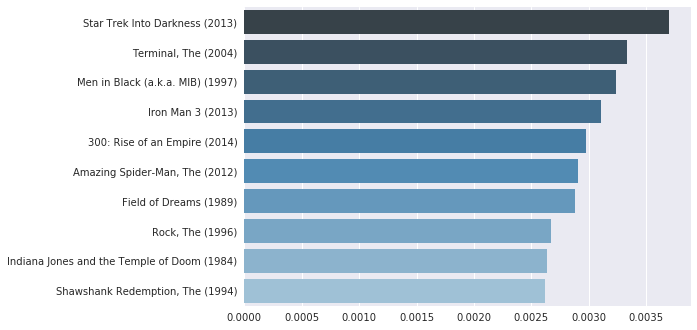

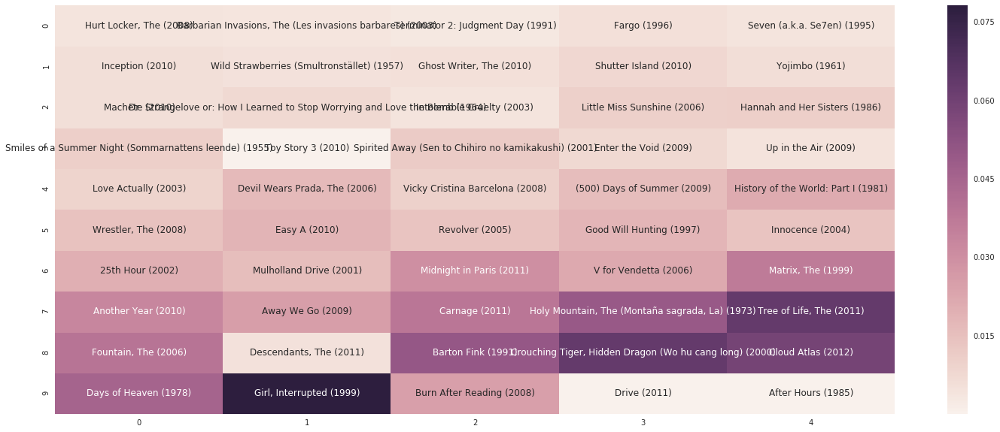

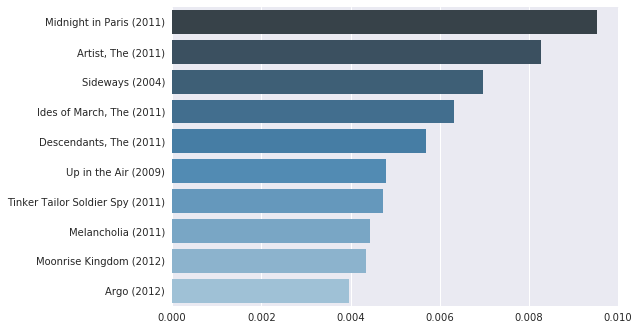

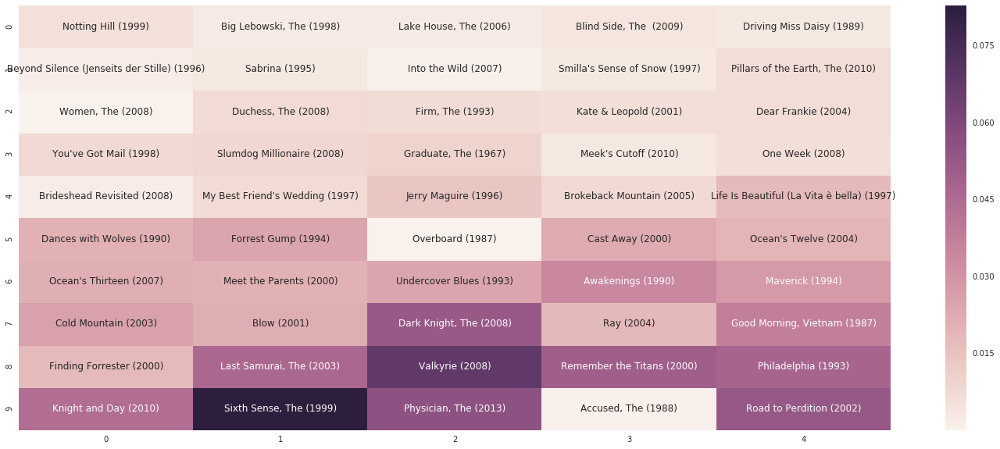

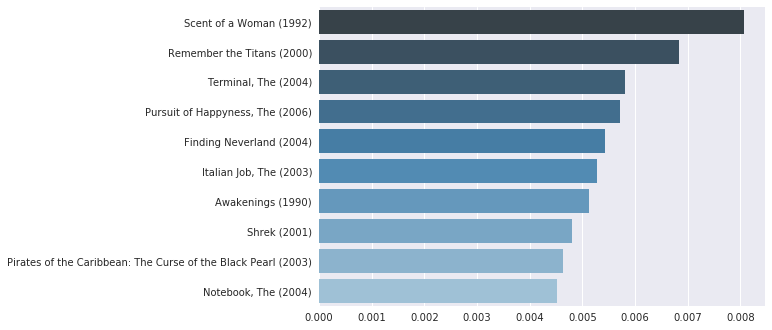

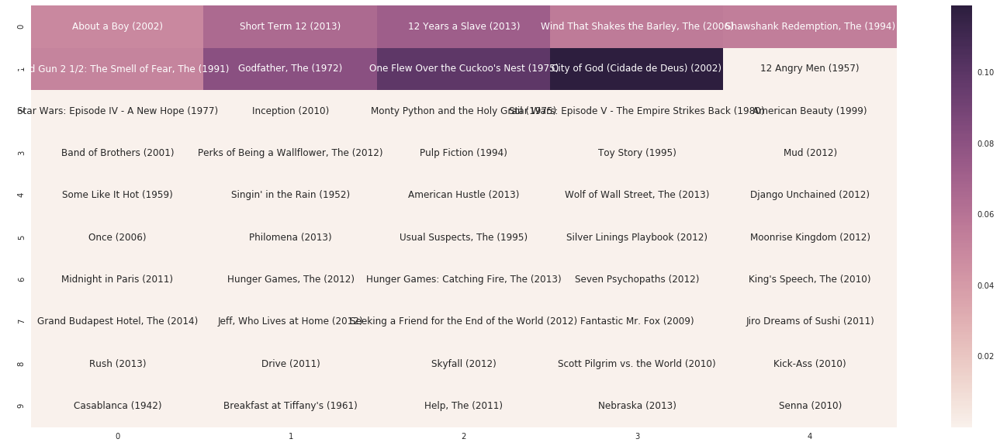

correct_predicted: ['Pitch Perfect (2012)']
true_movies: ['Princess Bride, The (1987)', 'The Interview (2014)', 'Saving Private Ryan (1998)', 'Babe (1995)', 'Austin Powers: International Man of Mystery (1997)', 'Gran Torino (2008)', "Monty Python's And Now for Something Completely Different (1971)", 'O Brother, Where Art Thou? (2000)', 'Before Sunrise (1995)', 'Fight Club (1999)', 'Big Lebowski, The (1998)', 'Guardians of the Galaxy (2014)', 'Animal House (1978)', 'Naked Gun 33 1/3: The Final Insult (1994)', 'House I Live In, The (2012)', 'Social Network, The (2010)', 'Inspector Gadget (1999)', 'Descendants, The (2011)', 'District 9 (2009)', 'Goodfellas (1990)', 'Pitch Perfect (2012)', 'Airplane! (1980)', "Ferris Bueller's Day Off (1986)"]


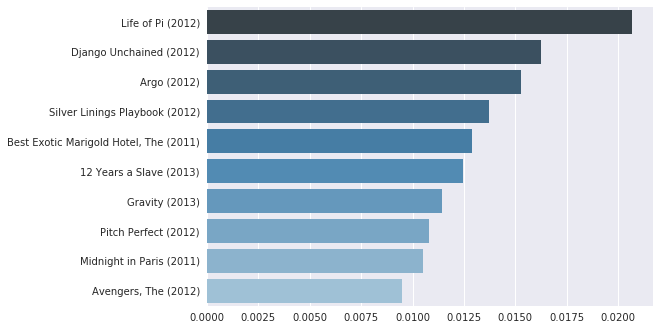

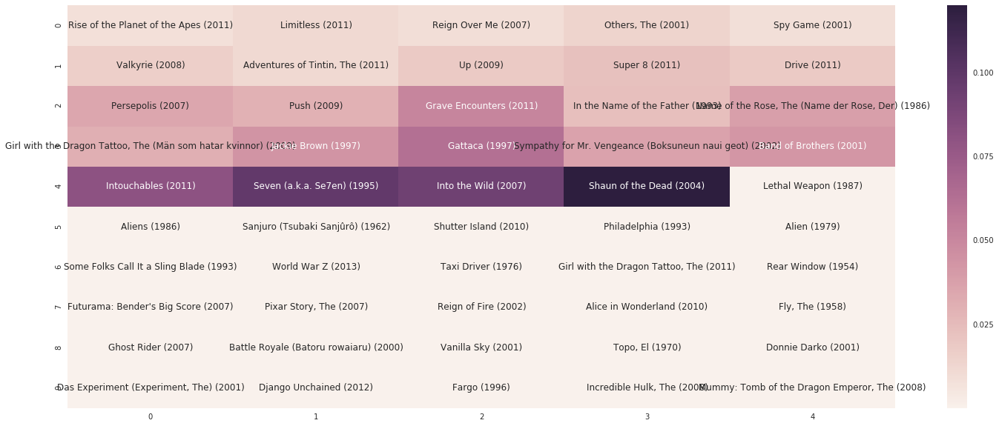

correct_predicted: ['Inglourious Basterds (2009)']
true_movies: ['Gravity (2013)', 'Wolf of Wall Street, The (2013)', '127 Hours (2010)', 'Grand Budapest Hotel, The (2014)', 'Life of Pi (2012)', 'Hero (Ying xiong) (2002)', 'Inception (2010)', 'Seven Samurai (Shichinin no samurai) (1954)', 'Red Beard (Akahige) (1965)', "Akira Kurosawa's Dreams (Dreams) (1990)", 'Yojimbo (1961)', 'Hidden Fortress, The (Kakushi-toride no san-akunin) (1958)', 'Throne of Blood (Kumonosu jô) (1957)', 'Rashomon (Rashômon) (1950)', 'Eat Pray Love (2010)', 'We Were Soldiers (2002)', 'Hurt Locker, The (2008)', 'Inglourious Basterds (2009)', 'Silent Hill: Revelation 3D (2012)', 'Silent Hill (2006)', 'Maleficent (2014)', 'Captain America: The First Avenger (2011)', 'Captain America: The Winter Soldier (2014)', 'Avengers, The (2012)', 'Fantastic Planet, The (Planète sauvage, La) (1973)', 'Leaving Las Vegas (1995)', 'Four Rooms (1995)']


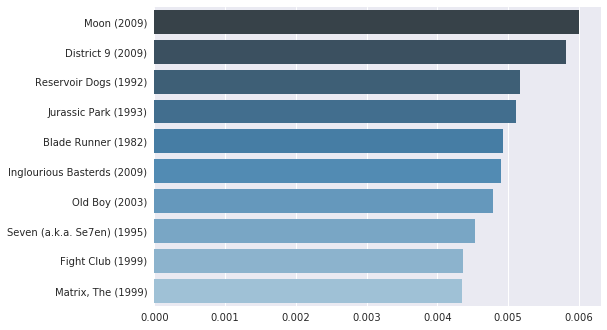

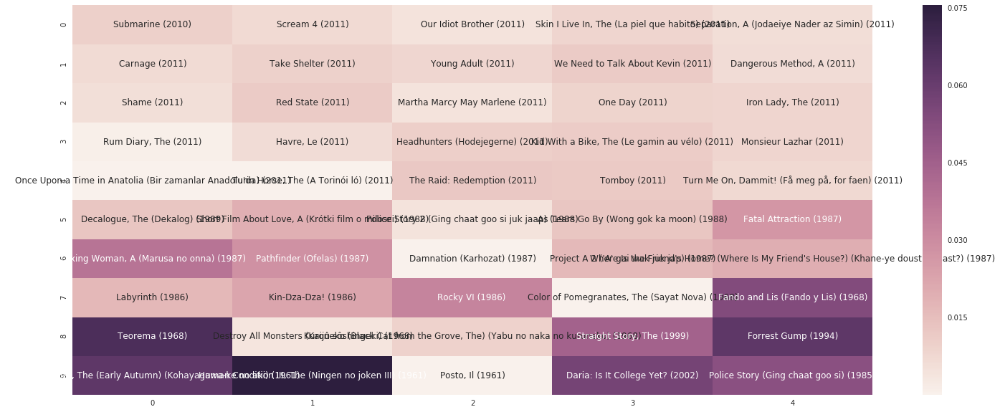

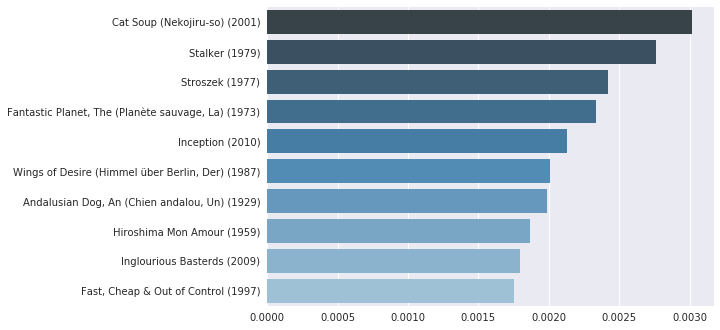

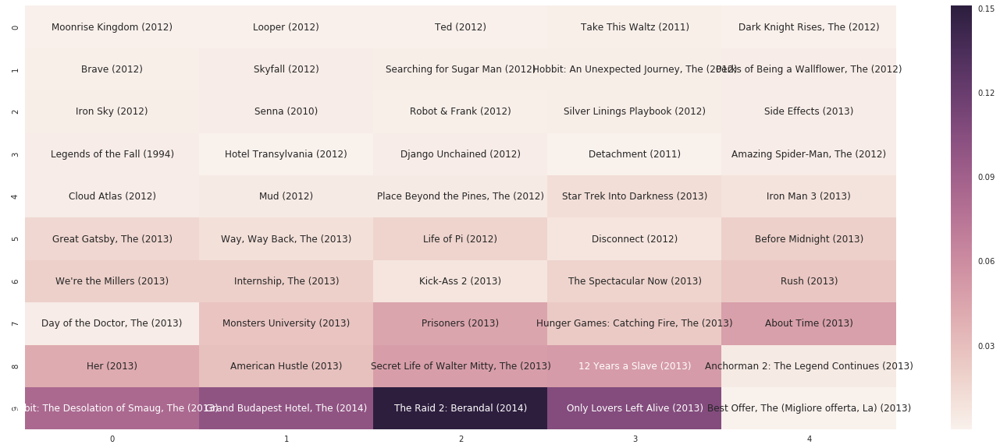

correct_predicted: ['Wolf of Wall Street, The (2013)', 'Transcendence (2014)', 'Edge of Tomorrow (2014)']
true_movies: ['Starred Up (2013)', 'Edge of Tomorrow (2014)', 'X-Men: Days of Future Past (2014)', 'Transcendence (2014)', 'Wreck-It Ralph (2012)', 'Dallas Buyers Club (2013)', 'Wolf of Wall Street, The (2013)', 'Boyhood (2014)', 'Guardians of the Galaxy (2014)', 'Walk the Line (2005)', 'The Fault in Our Stars (2014)', 'Berlin Calling (2008)', 'Love Actually (2003)', 'Gone Girl (2014)', '22 Jump Street (2014)', 'Gravity (2013)', '21 Jump Street (2012)', 'Pursuit of Happyness, The (2006)', 'I Origins (2014)', "Schindler's List (1993)", 'Judge, The (2014)']


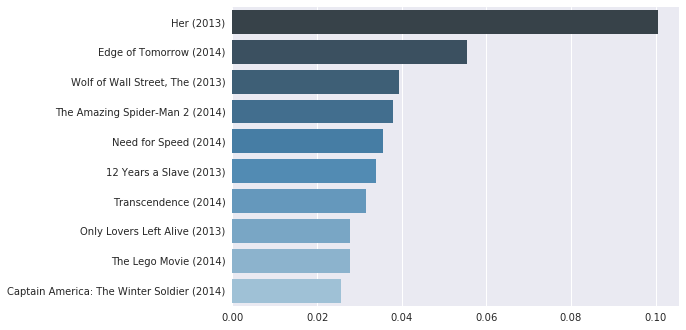

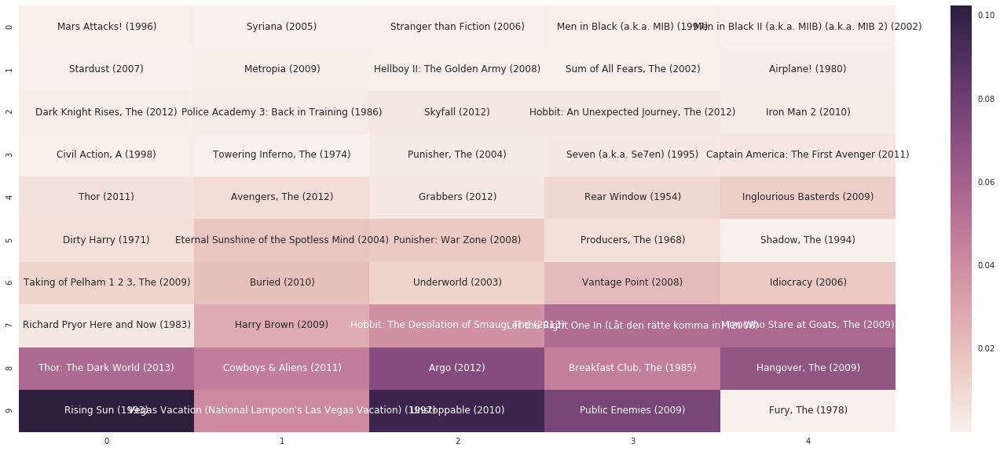

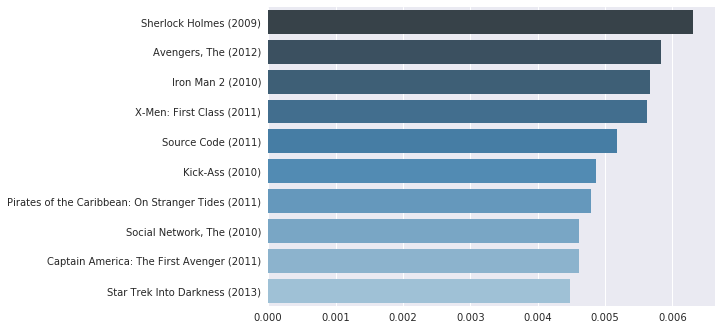

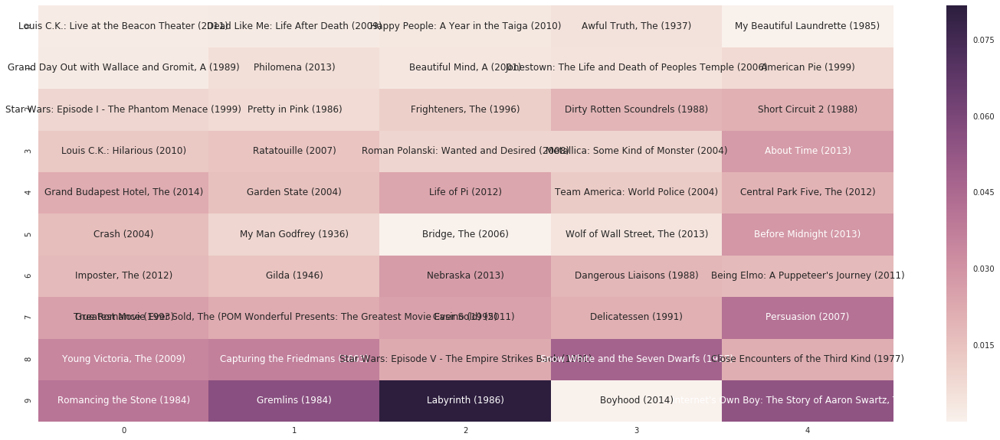

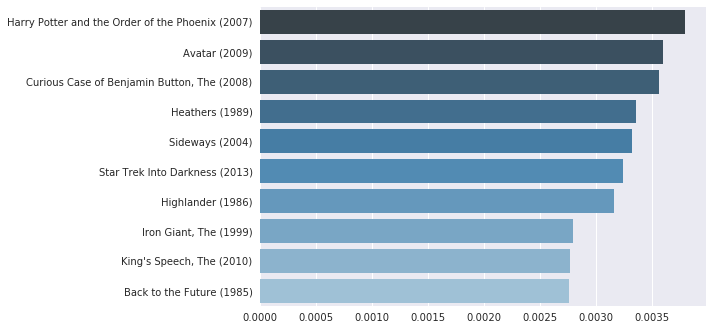

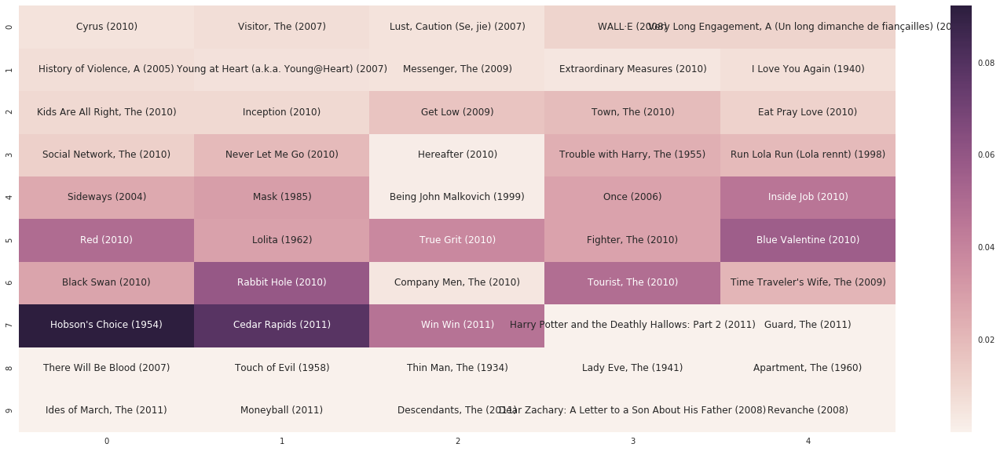

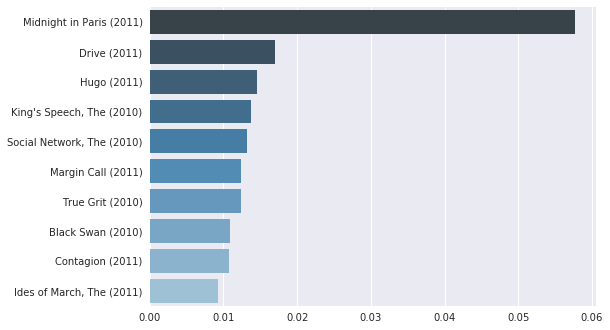

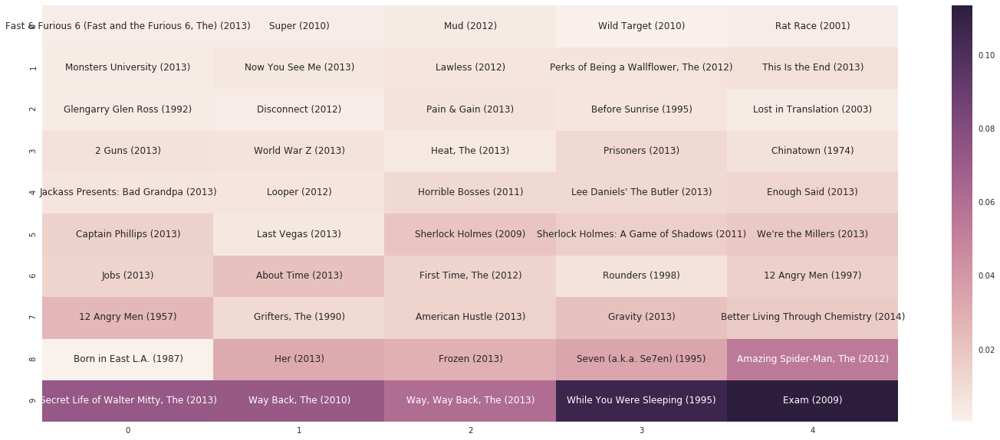

correct_predicted: ['12 Years a Slave (2013)', 'Rush (2013)']
true_movies: ['Edward Scissorhands (1990)', '22 Jump Street (2014)', 'Locke (2013)', 'Other Woman, The (2014)', 'Dawn of the Planet of the Apes (2014)', 'Chef (2014)', 'Gone Girl (2014)', 'Hundred-Foot Journey, The (2014)', 'Django Unchained (2012)', 'Rush (2013)', 'Begin Again (2013)', 'Eternal Sunshine of the Spotless Mind (2004)', 'Just Like Heaven (2005)', 'Matchstick Men (2003)', 'Blended (2014)', 'Wolf of Wall Street, The (2013)', 'Lars and the Real Girl (2007)', 'Sideways (2004)', 'This Is Where I Leave You (2014)', '12 Years a Slave (2013)', 'Love, Rosie (2014)', 'Sex Tape (2014)']


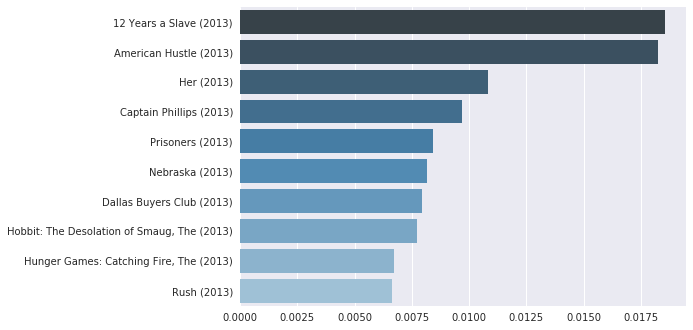

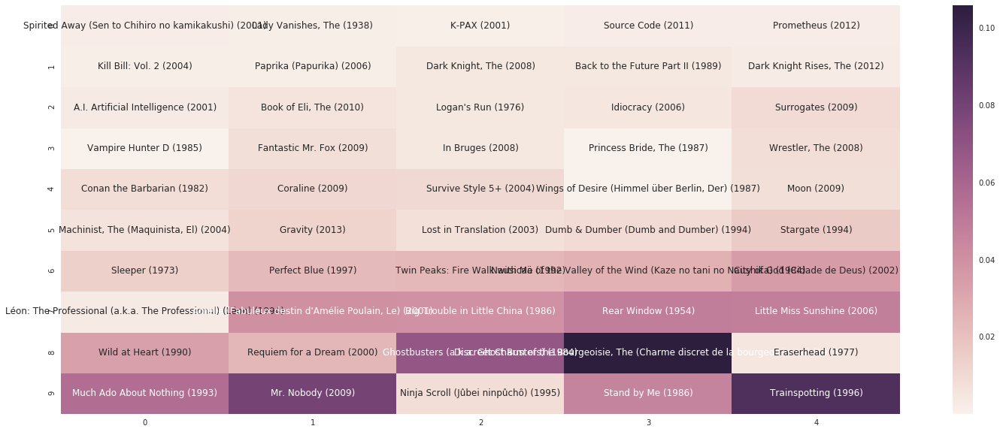

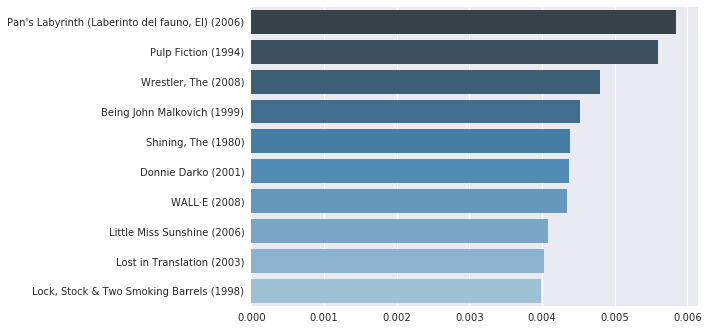

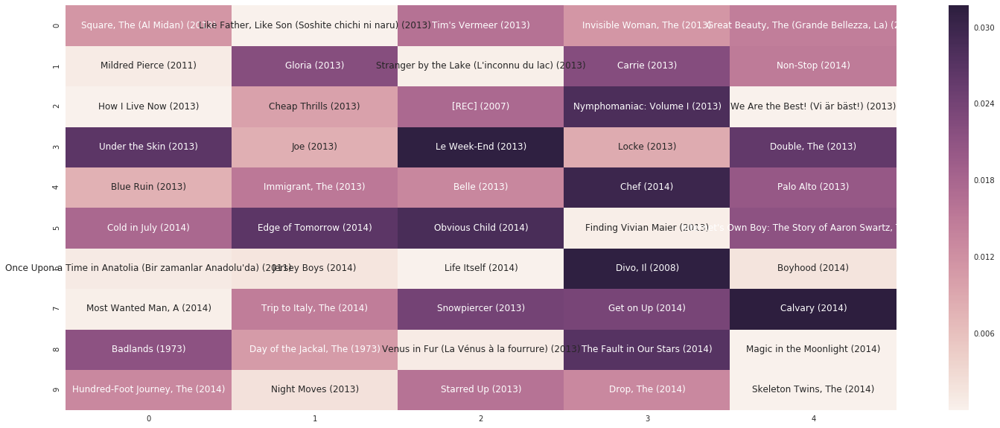

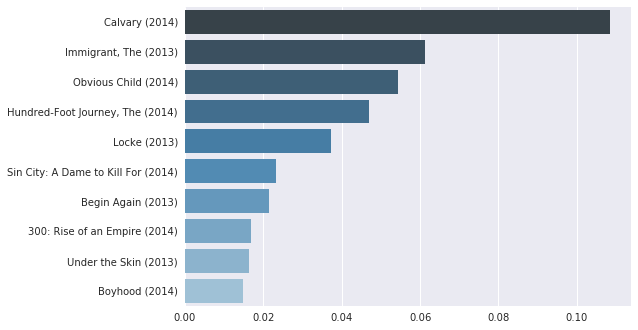

...

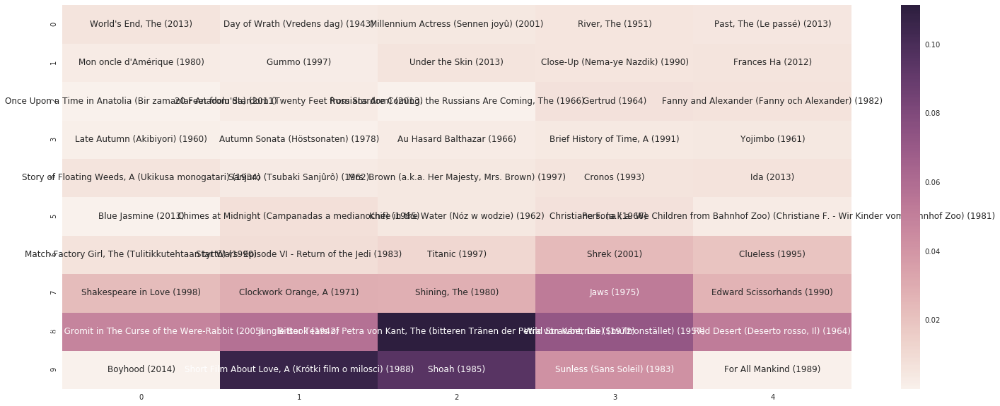

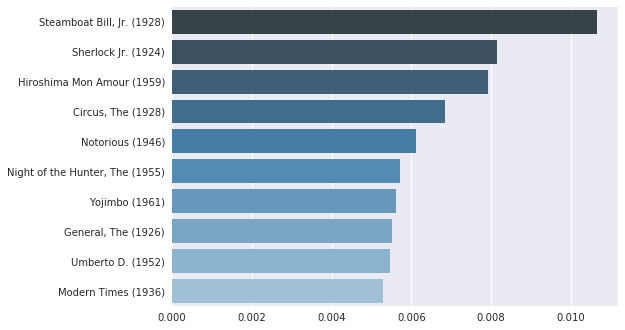

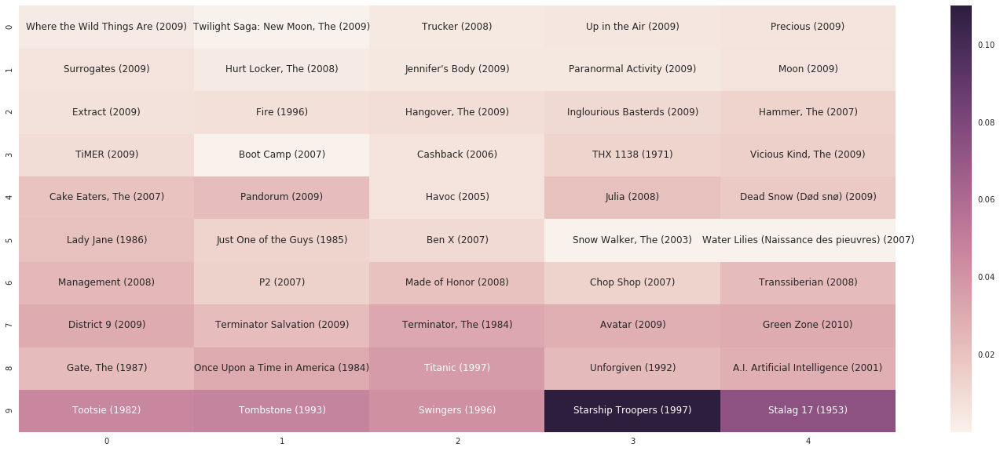

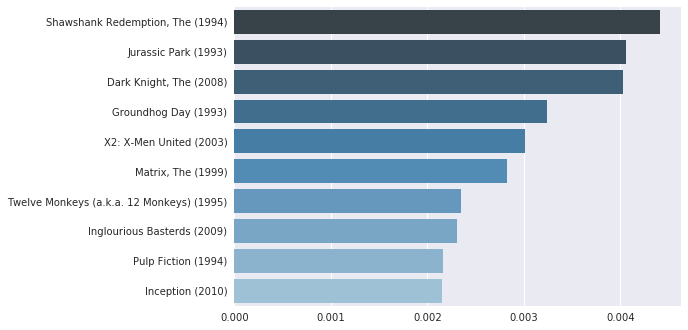

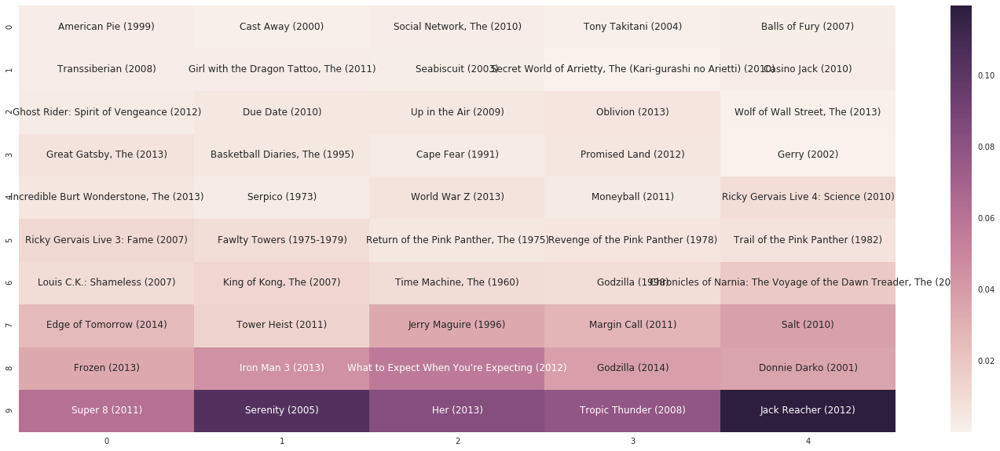

correct_predicted: ['X-Men: First Class (2011)', 'Looper (2012)']
true_movies: ['Blind Side, The  (2009)', 'Captain America: The First Avenger (2011)', 'Looper (2012)', 'Cloud Atlas (2012)', 'Lakeview Terrace (2008)', 'Cooler, The (2003)', 'Ghost Dog: The Way of the Samurai (1999)', 'X-Men: First Class (2011)', 'The Interview (2014)', 'Avatar (2009)', 'Signal, The (2014)', 'American Psycho (2000)', 'Hunger Games: Catching Fire, The (2013)', 'Stargate (1994)', 'Day of the Doctor, The (2013)', 'Close Encounters of the Third Kind (1977)', 'Gravity (2013)', 'Giver, The (2014)', 'RoboCop (2014)', 'Moon (2009)', 'Final Cut, The (2004)', 'Mission: Impossible - Ghost Protocol (2011)', 'Lucy (2014)', 'Another Earth (2011)', 'Total Recall (2012)', 'Last Starfighter, The (1984)', 'Real Steel (2011)', 'Unstoppable (2010)', "Dr. Seuss' The Lorax (2012)", 'In Time (2011)', 'Twelve Monkeys (a.k.a. 12 Monkeys) (1995)', 'Interstellar (2014)', 'Dylan Moran: Monster (2004)', 'Total Recall (1990)', 'Distr

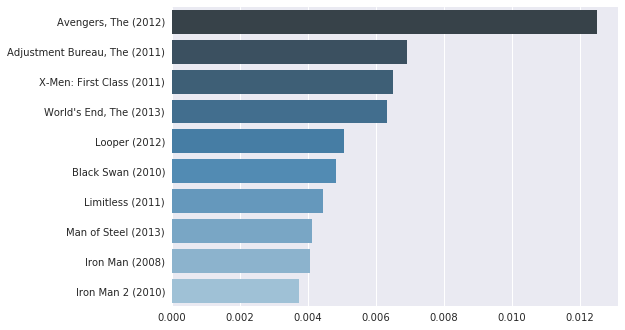

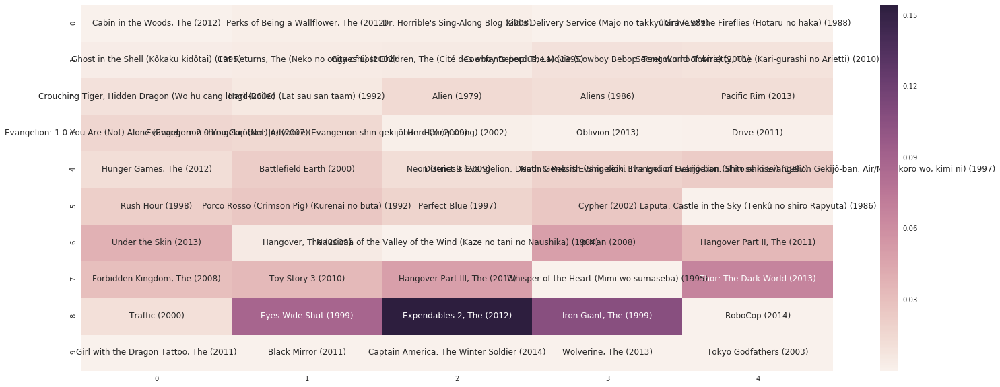

correct_predicted: ['X-Men: Days of Future Past (2014)']
true_movies: ['Ponyo (Gake no ue no Ponyo) (2008)', 'Edge of Tomorrow (2014)', 'Avatar (2009)', 'X-Men: Days of Future Past (2014)', 'Justice League: The Flashpoint Paradox (2013)', 'Limitless (2011)', 'Transcendence (2014)', 'A-Team, The (2010)', 'The Lego Movie (2014)', 'Shrek (2001)', 'Matrix, The (1999)', 'Star Wars: Episode IV - A New Hope (1977)', 'Star Wars: Episode V - The Empire Strikes Back (1980)', 'Batman Begins (2005)', 'Star Wars: Episode VI - Return of the Jedi (1983)', 'Raiders of the Lost Ark (Indiana Jones and the Raiders of the Lost Ark) (1981)', 'Day of the Doctor, The (2013)', 'Wolf of Wall Street, The (2013)', 'Guardians of the Galaxy (2014)', 'Wings of Desire (Himmel über Berlin, Der) (1987)', 'Batman: The Dark Knight Returns, Part 1 (2012)', 'Batman: The Dark Knight Returns, Part 2 (2013)', 'Gangs of Wasseypur (2012)', 'Lifted (2006)', 'Between the Folds (2008)', 'Going Postal (2010)', 'Die Hard (1988)', '

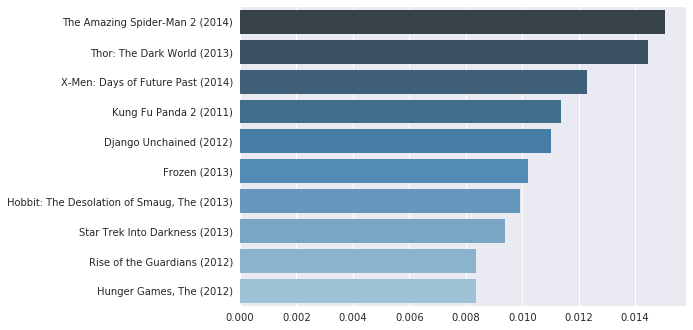

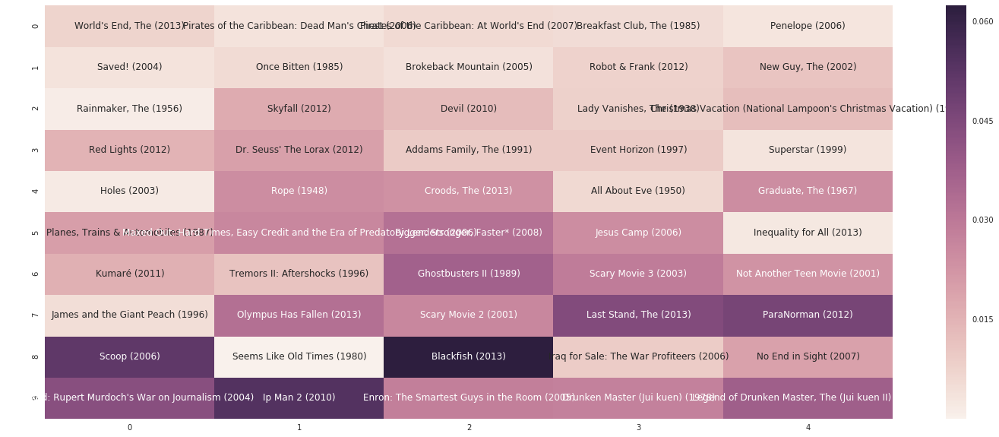

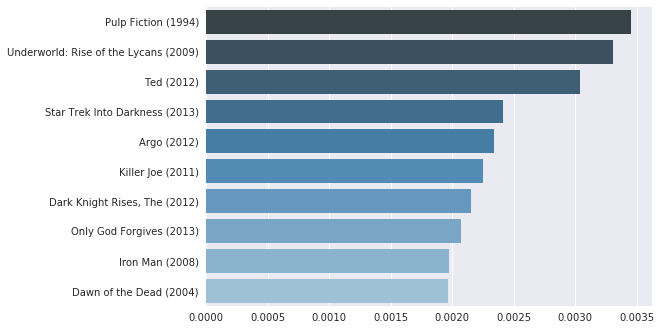

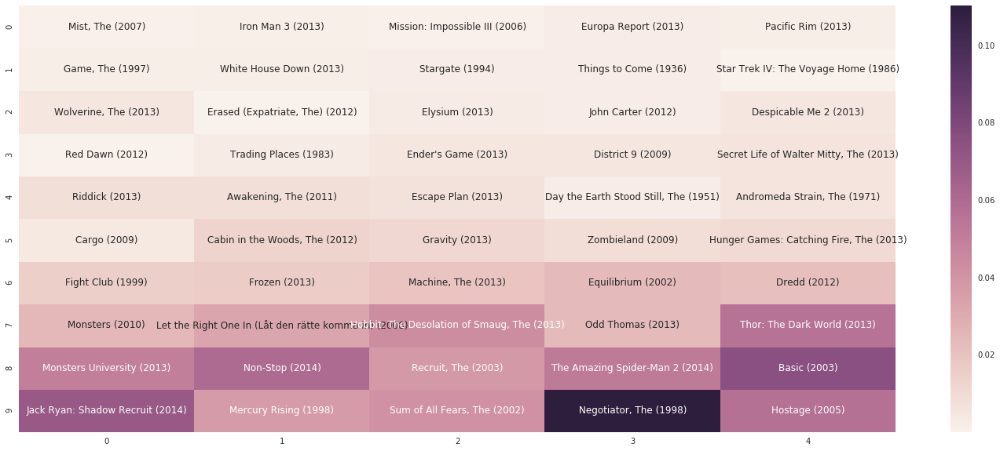

correct_predicted: ['Edge of Tomorrow (2014)']
true_movies: ['Jumper (2008)', 'Edge of Tomorrow (2014)', 'Taken 2 (2012)', 'X-Men: Days of Future Past (2014)', 'Heaven Is for Real (2014)', 'Transformers: Age of Extinction (2014)', 'Captain America: The Winter Soldier (2014)', 'Godzilla (2014)', "God's Not Dead (2014)", 'Déjà Vu (Deja Vu) (2006)']


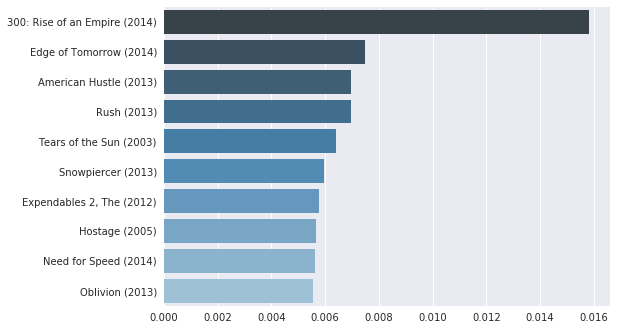

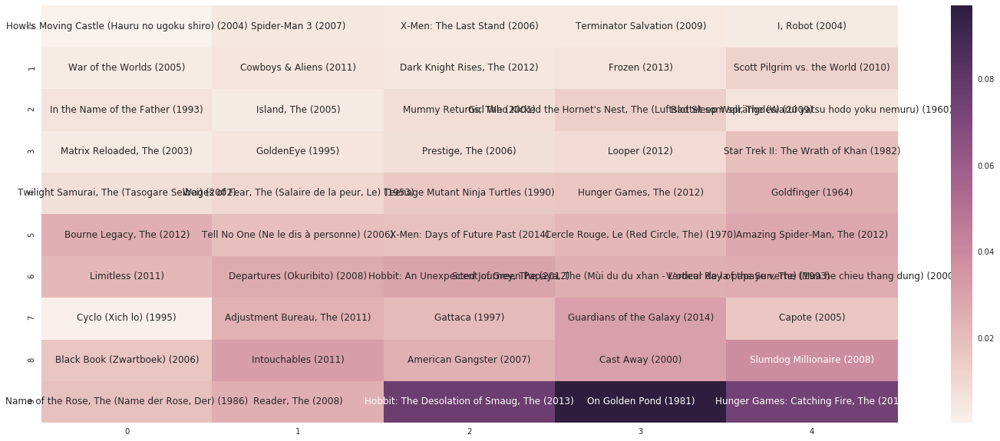

correct_predicted: ['Argo (2012)']
true_movies: ['Seven Samurai (Shichinin no samurai) (1954)', 'Longest Day, The (1962)', 'Iron Man 3 (2013)', 'Dumb & Dumber (Dumb and Dumber) (1994)', 'Titanic (1997)', 'Argo (2012)', 'Wedding Crashers (2005)', 'Chronicles of Narnia: The Lion, the Witch and the Wardrobe, The (2005)', 'Shrek 2 (2004)', "Once Upon a Time in the West (C'era una volta il West) (1968)", 'Once Upon a Time in America (1984)', '47 Ronin (2013)', '3-Iron (Bin-jip) (2004)', 'Zero Dark Thirty (2012)']


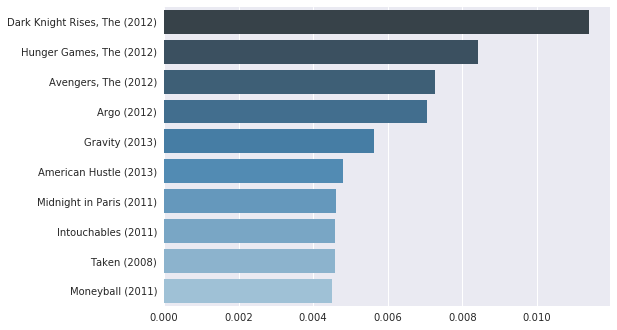

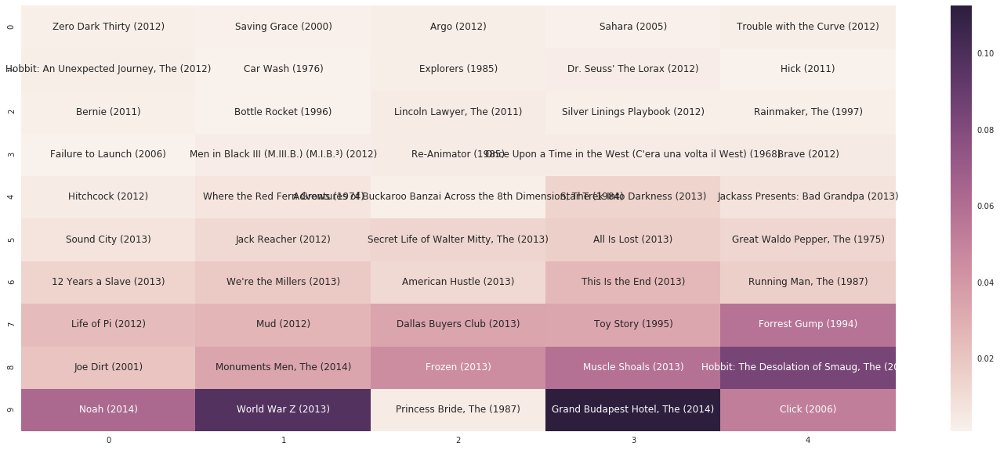

correct_predicted: ['Transcendence (2014)']
true_movies: ["Sorcerer's Apprentice, The (2010)", 'Guardians of the Galaxy (2014)', 'Man of Steel (2013)', 'Odd Thomas (2013)', 'Suspect Zero (2004)', 'Get Low (2009)', 'Pacific Rim (2013)', 'American Sniper (2014)', 'Birdman (2014)', 'Theory of Everything, The (2014)', 'Whiplash (2014)', "Bill Burr: I'm Sorry You Feel That Way (2014)", 'John Wick (2014)', 'Scary Movie 5 (Scary MoVie) (2013)', "River's Edge (1986)", 'Maleficent (2014)', 'St. Vincent (2014)', 'Transcendence (2014)', 'The Imitation Game (2014)', 'Arizona Dream (1993)']


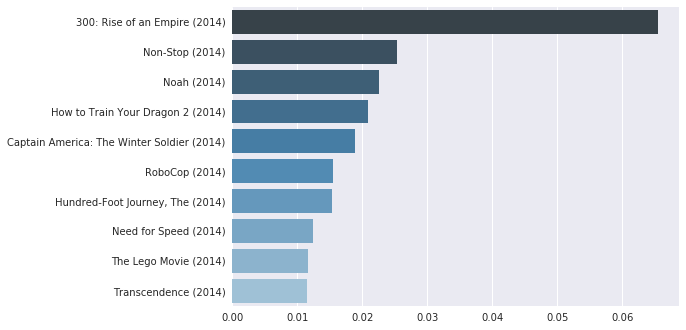

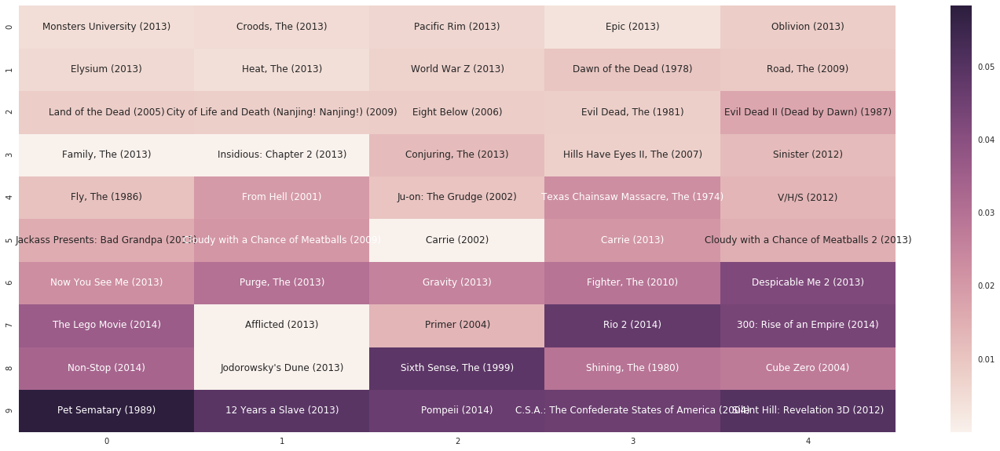

correct_predicted: ['Hunger Games: Catching Fire, The (2013)']
true_movies: ['Purge: Anarchy, The (2014)', 'Million Ways to Die in the West, A (2014)', 'Hunger Games: Catching Fire, The (2013)', 'Dawn of the Planet of the Apes (2014)', 'Grand Day Out with Wallace and Gromit, A (1989)', 'Johnny Mnemonic (1995)', "Christmas Vacation (National Lampoon's Christmas Vacation) (1989)", "National Lampoon's Vacation (1983)", "European Vacation (aka National Lampoon's European Vacation) (1985)", "Vegas Vacation (National Lampoon's Las Vegas Vacation) (1997)", 'Coming to America (1988)', 'Airplane! (1980)', 'Slap Shot (1977)', 'Grand Budapest Hotel, The (2014)', 'Caddyshack (1980)']


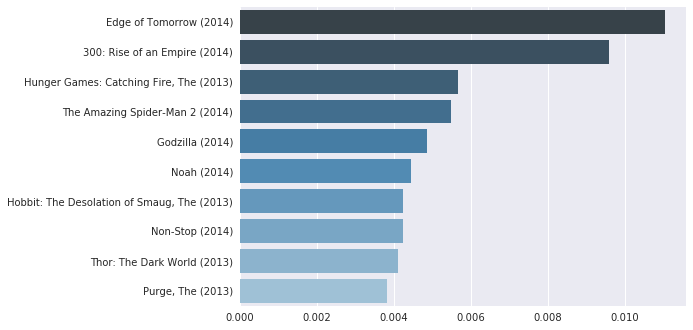

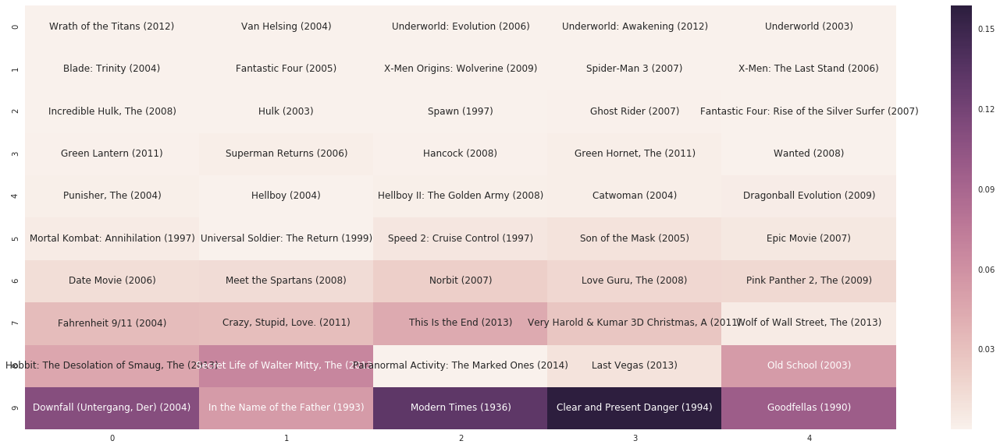

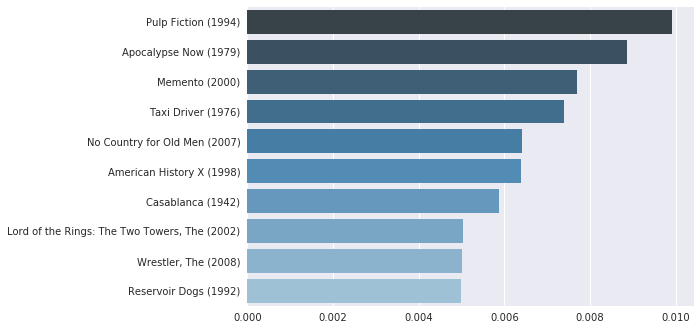

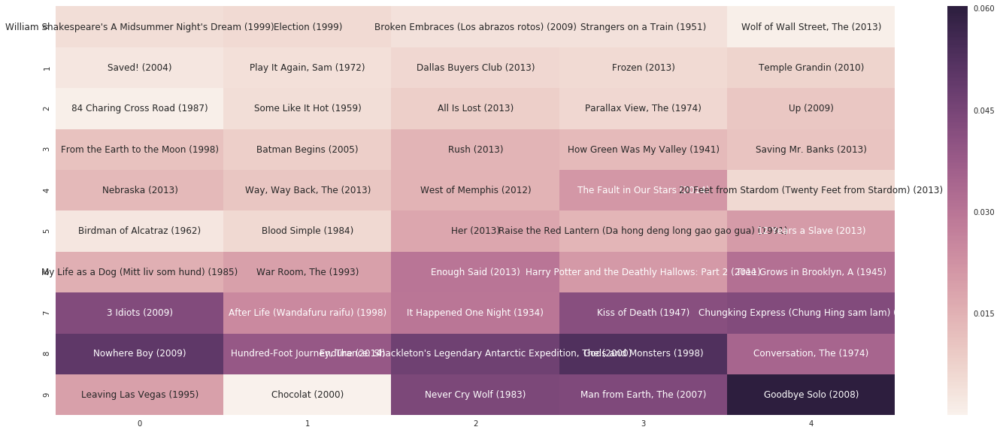

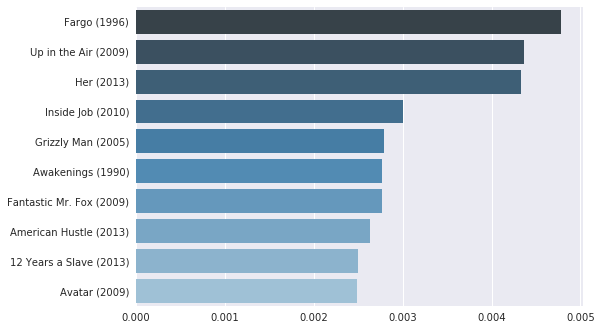

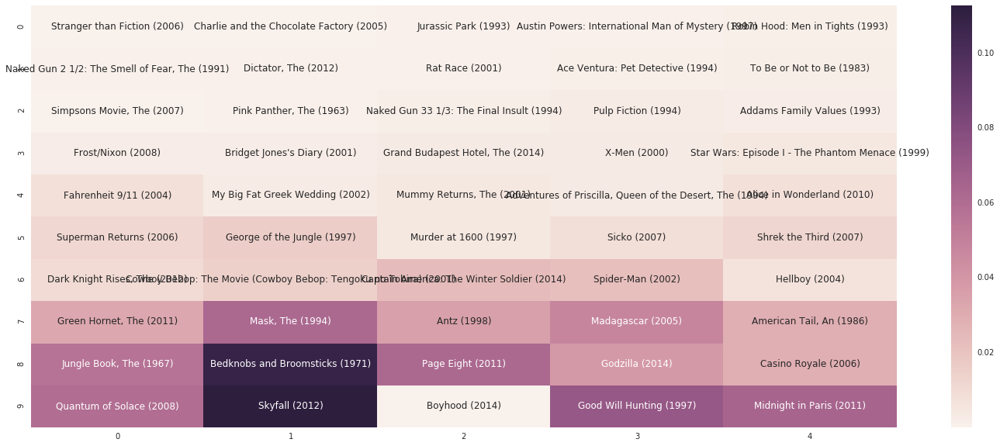

correct_predicted: ['Lion King, The (1994)']
true_movies: ['Rocky Horror Picture Show, The (1975)', 'Ponyo (Gake no ue no Ponyo) (2008)', 'Paprika (Papurika) (2006)', 'Annie Hall (1977)', 'Pirates of the Caribbean: The Curse of the Black Pearl (2003)', 'Kung Fu Hustle (Gong fu) (2004)', 'Who Framed Roger Rabbit? (1988)', 'Young Adult (2011)', 'Beauty and the Beast (1991)', 'Presto (2008)', 'South Park: Bigger, Longer and Uncut (1999)', 'Little Mermaid, The (1989)', 'Crimson Tide (1995)', 'Hobbit: An Unexpected Journey, The (2012)', 'The Hobbit: The Battle of the Five Armies (2014)', 'True Grit (2010)', 'Avatar (2009)', 'In the Loop (2009)', 'Adjustment Bureau, The (2011)', 'Matrix Reloaded, The (2003)', 'Harry Potter and the Chamber of Secrets (2002)', 'Star Wars: Episode II - Attack of the Clones (2002)', 'Nightmare Before Christmas, The (1993)', 'Waltz with Bashir (Vals im Bashir) (2008)', 'To Be or Not to Be (1942)', "Singin' in the Rain (1952)", 'Blues Brothers, The (1980)', 'Perse

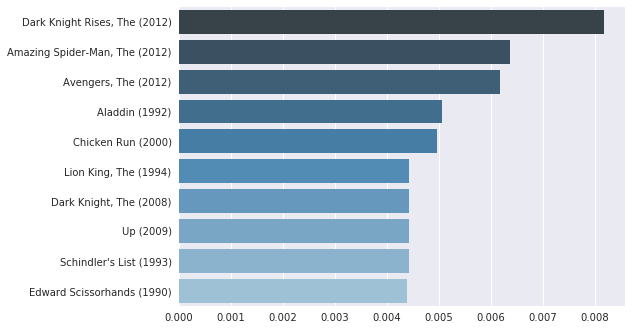

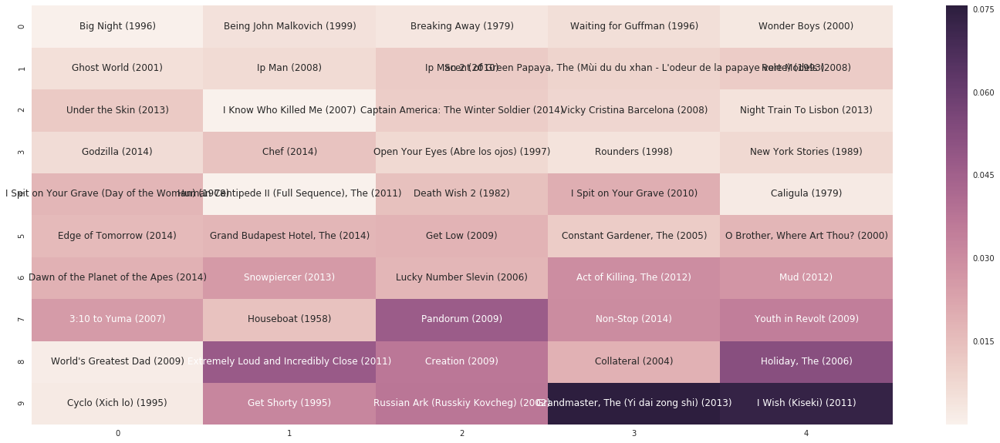

correct_predicted: ['Argo (2012)']
true_movies: ['Gone Girl (2014)', 'Argo (2012)', 'Red Cliff (Chi bi) (2008)', 'Boyhood (2014)', 'Hijacking, A (Kapringen) (2012)', 'Interstellar (2014)', 'Brazil (1985)', 'Bad Lieutenant (1992)', '22 Jump Street (2014)', "Miller's Crossing (1990)", 'Rango (2011)', 'Seven Samurai (Shichinin no samurai) (1954)', 'The Imitation Game (2014)', 'Inherent Vice (2014)', 'Drop, The (2014)', 'Nightcrawler (2014)', 'Birdman (2014)', 'Chappie (2015)']


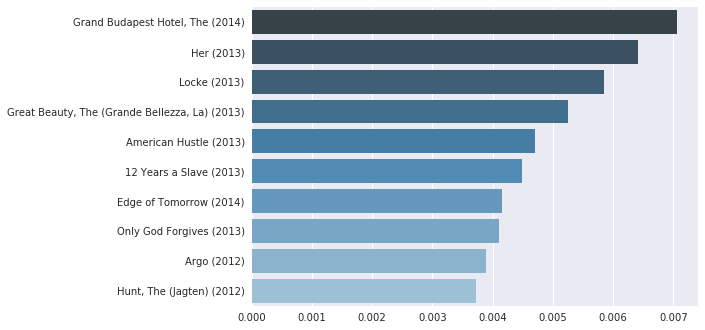

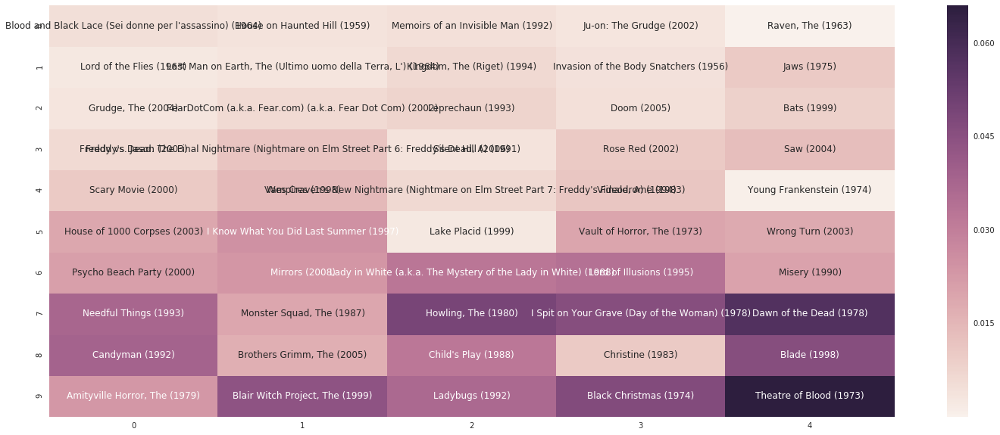

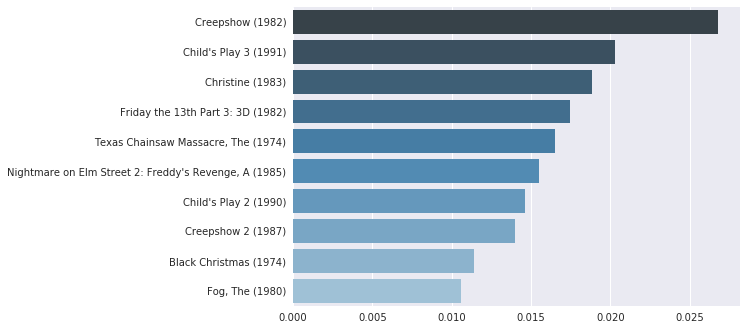

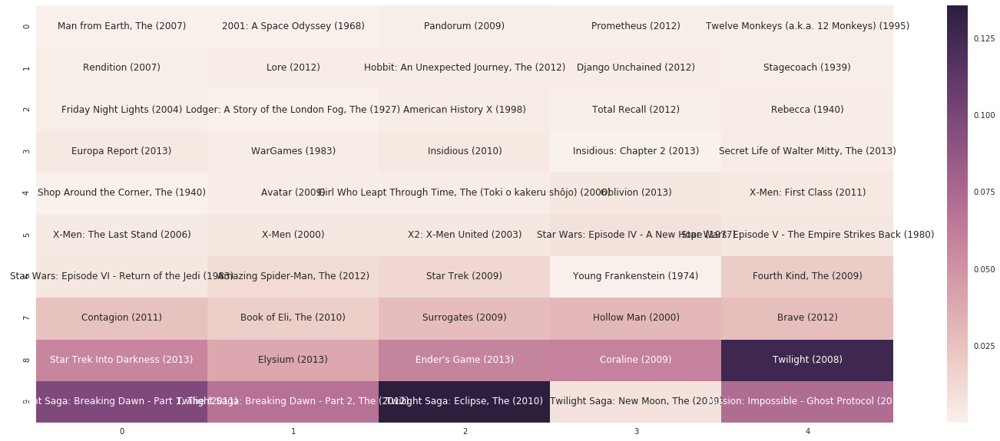

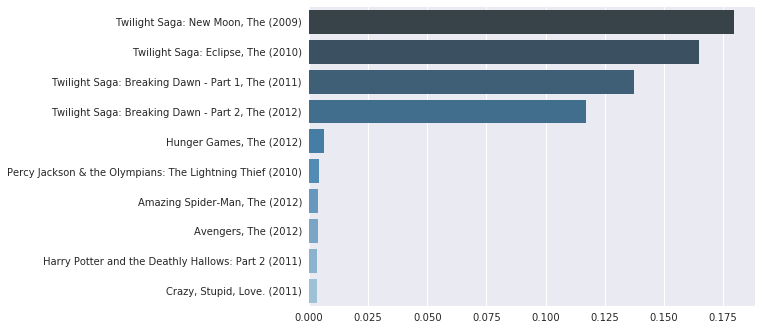

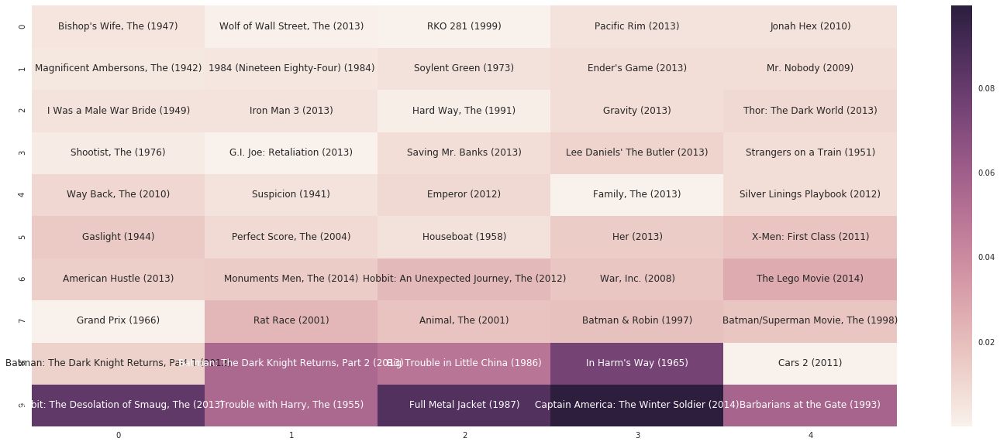

correct_predicted: ['Captain America: The First Avenger (2011)', 'X-Men: Days of Future Past (2014)']
true_movies: ['12 Years a Slave (2013)', "Donovan's Reef (1963)", 'Kill Bill: Vol. 1 (2003)', 'Snowpiercer (2013)', 'Fantastic Four (2005)', 'Captain America: The First Avenger (2011)', 'Fantastic Four: Rise of the Silver Surfer (2007)', 'Six Degrees of Separation (1993)', 'Gunga Din (1939)', 'Justice League: The Flashpoint Paradox (2013)', 'Mutiny on the Bounty (1935)', 'Sherlock Holmes: A Game of Shadows (2011)', 'Carlos (2010)', 'Rock of Ages (2012)', 'Bottle Shock (2008)', 'Stranger than Fiction (2006)', 'Postman Always Rings Twice, The (1946)', 'Labyrinth (1986)', 'Guardians of the Galaxy (2014)', 'Annie (2014)', 'Pursuit of Happyness, The (2006)', 'Fail Safe (2000)', 'Sharknado (2013)', 'Justice League: War (2014)', 'Postman Always Rings Twice, The (1981)', 'X-Men: Days of Future Past (2014)', 'Great Train Robbery, The (a.k.a. First Great Train Robbery, The) (1979)', 'Enemy Below

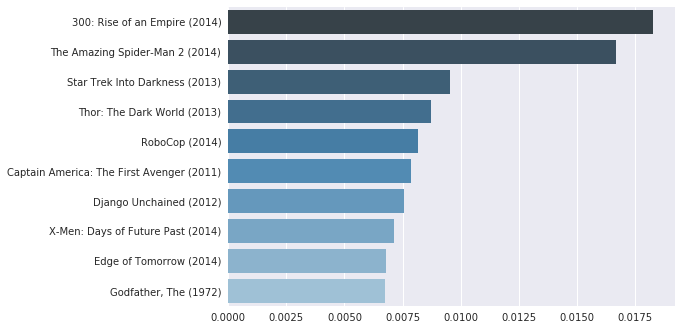

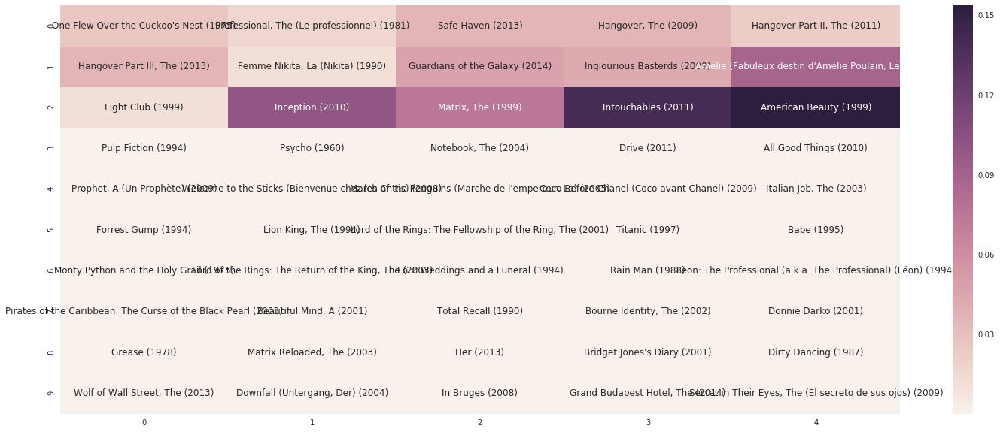

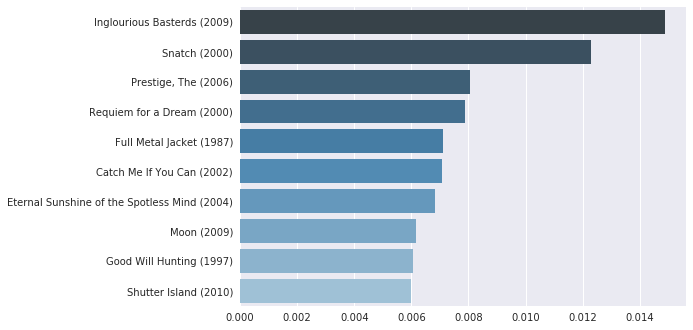

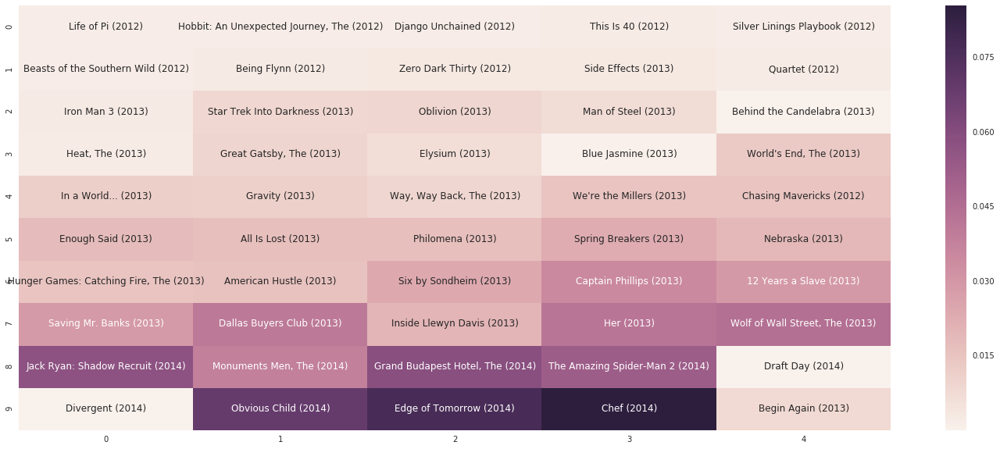

correct_predicted: ['Hundred-Foot Journey, The (2014)']
true_movies: ['Gone Girl (2014)', 'Hundred-Foot Journey, The (2014)', 'Guardians of the Galaxy (2014)', 'Skeleton Twins, The (2014)', 'St. Vincent (2014)', 'Birdman (2014)', 'Nightcrawler (2014)', 'Safety Not Guaranteed (2012)', 'Boyhood (2014)', 'Finding Vivian Maier (2013)', 'Lucy (2014)', 'Interstellar (2014)', 'The Hunger Games: Mockingjay - Part 1 (2014)', 'Theory of Everything, The (2014)', 'Perks of Being a Wallflower, The (2012)', "All the President's Men (1976)", 'Lives of Others, The (Das leben der Anderen) (2006)', 'Hannah and Her Sisters (1986)', 'Day of the Jackal, The (1973)', 'Senna (2010)', 'Wallace & Gromit: A Close Shave (1995)', 'Prisoners (2013)', 'Play It Again, Sam (1972)', "Microcosmos (Microcosmos: Le peuple de l'herbe) (1996)", 'Zelig (1983)', 'Anatomy of a Murder (1959)', 'Escape from Alcatraz (1979)', 'Civil War, The (1990)', 'Lenny (1974)', 'China Syndrome, The (1979)', 'Toy Story 2 (1999)', '50/50 (201

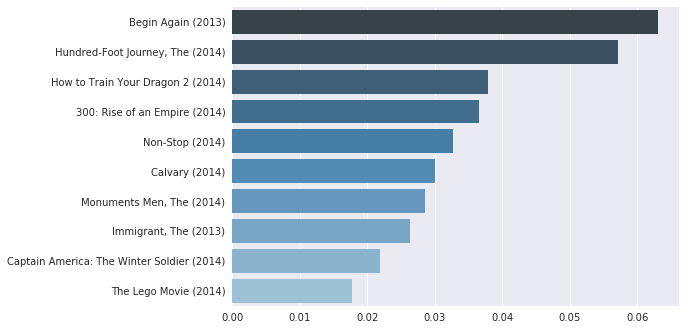

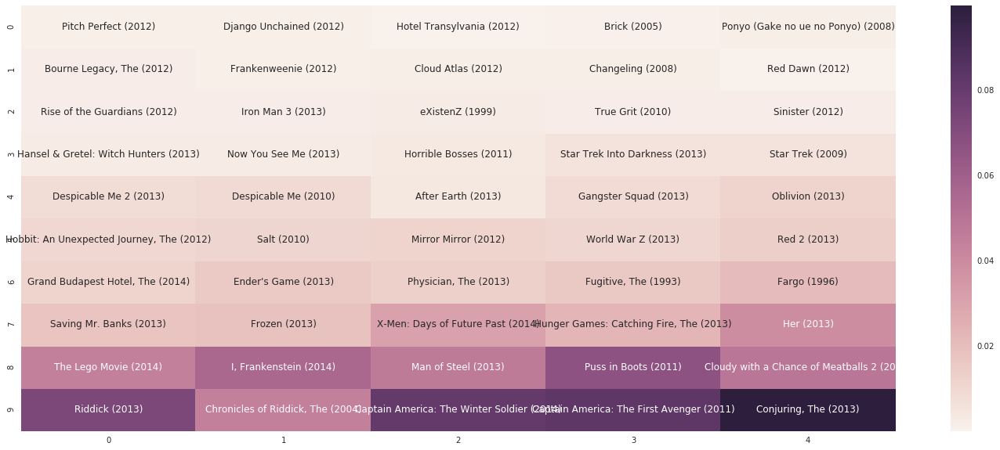

correct_predicted: ['Hobbit: The Desolation of Smaug, The (2013)']
true_movies: ['Shawshank Redemption, The (1994)', 'Lucy (2014)', "Jennifer's Body (2009)", "Howl's Moving Castle (Hauru no ugoku shiro) (2004)", 'Intouchables (2011)', 'For the Birds (2000)', 'Lifted (2006)', "Knockin' on Heaven's Door (1997)", 'American Hustle (2013)', 'In Bruges (2008)', 'Gone Baby Gone (2007)', 'Zodiac (2007)', 'Drive (2011)', 'Collateral (2004)', 'Training Day (2001)', 'Traffic (2000)', 'Out of Sight (1998)', 'The Hobbit: The Battle of the Five Armies (2014)', 'Hobbit: The Desolation of Smaug, The (2013)', 'Snowpiercer (2013)']


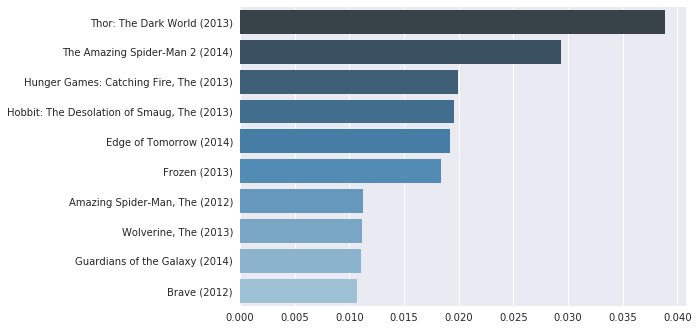

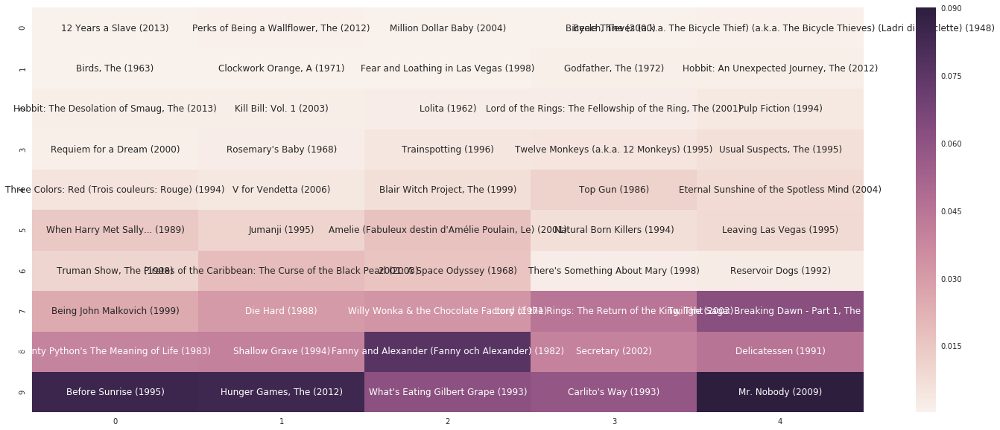

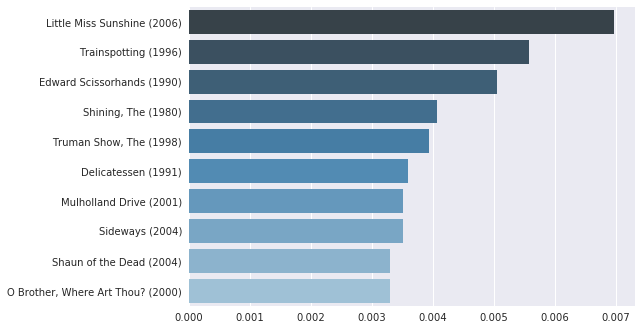

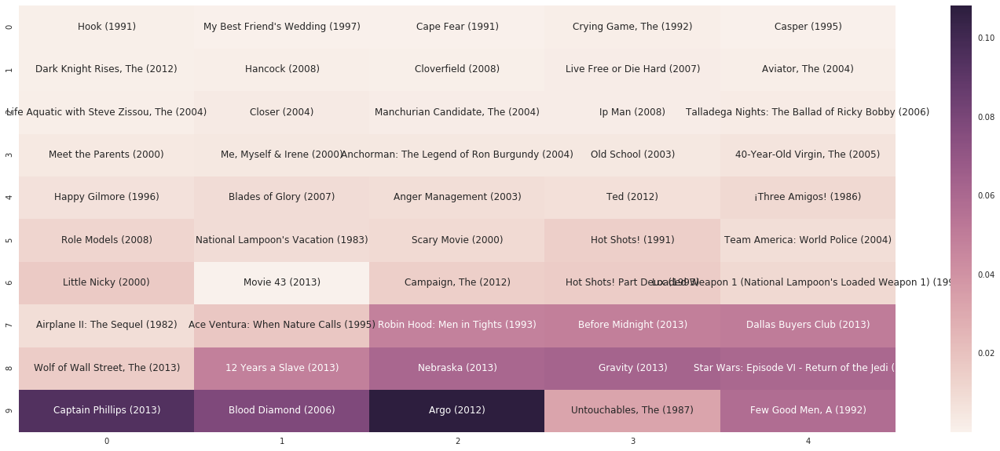

correct_predicted: ['Her (2013)', 'American Hustle (2013)']
true_movies: ['Pianist, The (2002)', 'To Rome with Love (2012)', 'Her (2013)', 'About Time (2013)', 'Silver Linings Playbook (2012)', 'Django Unchained (2012)', 'Short Circuit (1986)', 'Looper (2012)', 'Peaceful Warrior (2006)', 'The Fault in Our Stars (2014)', 'Star Wars: Episode V - The Empire Strikes Back (1980)', 'Star Wars: Episode IV - A New Hope (1977)', "Harry Potter and the Sorcerer's Stone (a.k.a. Harry Potter and the Philosopher's Stone) (2001)", 'Star Wars: Episode II - Attack of the Clones (2002)', 'Harry Potter and the Chamber of Secrets (2002)', 'Harry Potter and the Prisoner of Azkaban (2004)', 'Royal Tenenbaums, The (2001)', 'Star Wars: Episode III - Revenge of the Sith (2005)', 'Iron Man (2008)', 'My Big Fat Greek Wedding (2002)', 'Black Hawk Down (2001)', 'Gone in 60 Seconds (2000)', 'Before Sunrise (1995)', 'Miss Congeniality (2000)', 'About a Boy (2002)', 'Planet of the Apes (2001)', 'Saving Mr. Banks (201

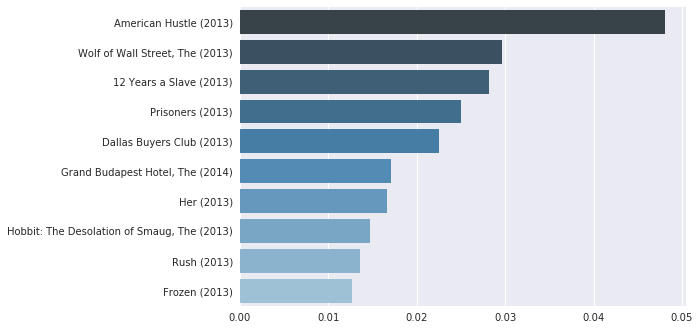

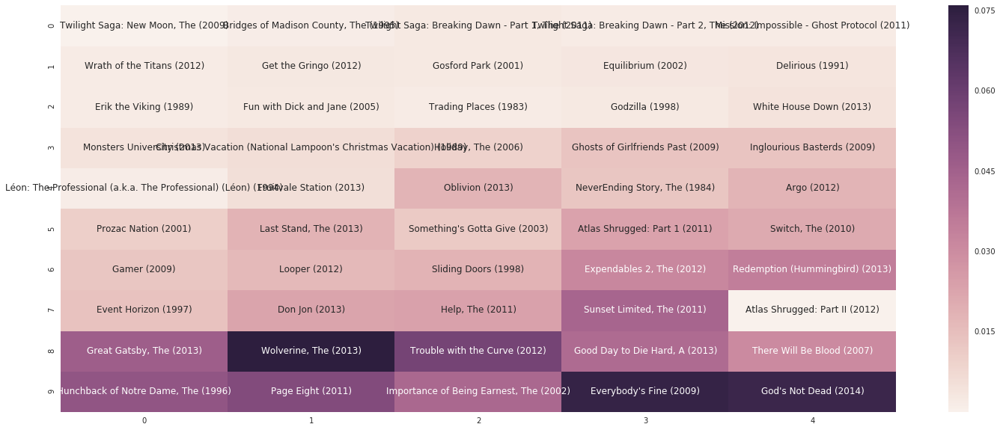

correct_predicted: ['Man of Steel (2013)', 'Hunger Games, The (2012)', 'Hunger Games: Catching Fire, The (2013)', 'Hobbit: The Desolation of Smaug, The (2013)', 'Pacific Rim (2013)']
true_movies: ['Hobbit: The Desolation of Smaug, The (2013)', 'Pacific Rim (2013)', 'Purge, The (2013)', 'Man of Steel (2013)', 'Without Limits (1998)', 'Supernova (2000)', 'Bottle Shock (2008)', 'Langoliers, The (1995)', 'R.I.P.D. (2013)', 'Hunger Games, The (2012)', 'Jack Frost (1998)', 'Hansel & Gretel: Witch Hunters (2013)', 'Eclipse, The (2009)', 'It (1990)', 'Bag of Bones (2011)', 'Hunger Games: Catching Fire, The (2013)', 'Monkey Business (1952)', 'Nebraska (2013)', 'Cider House Rules, The (1999)', 'Kid, The (1921)', "Mr. Morgan's Last Love (2013)", 'Tarzan (1999)', 'Lincoln Lawyer, The (2011)', 'Anchorman 2: The Legend Continues (2013)', 'Frozen (2013)', "I'll Be Home For Christmas (1998)", 'Ernest Saves Christmas (1988)', 'Out-of-Towners, The (1999)', 'Other Woman, The (2009)', 'Flashdance (1983)',

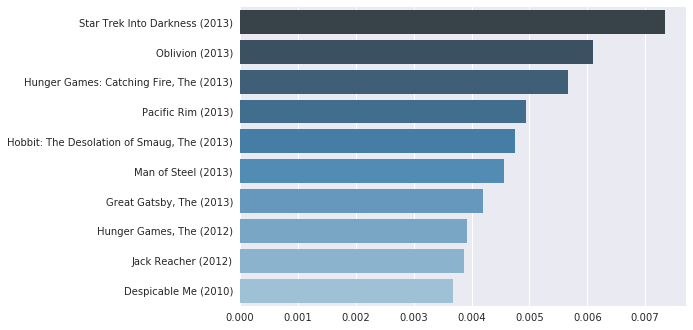

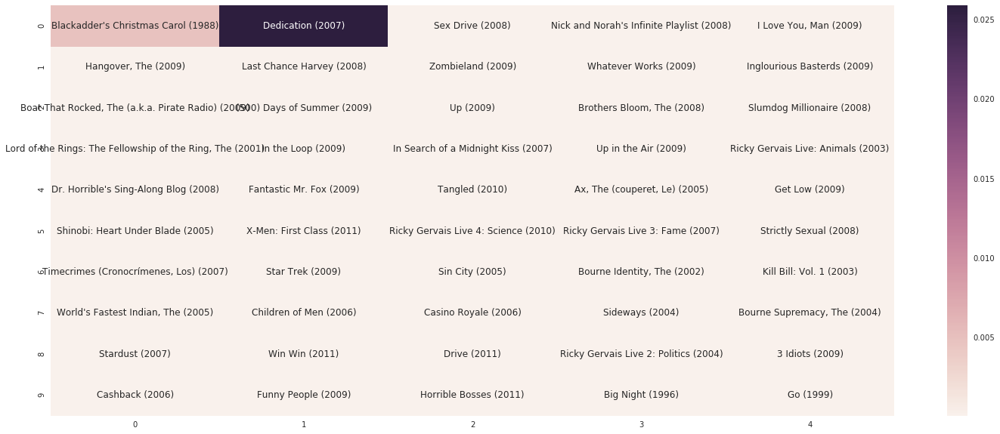

correct_predicted: ['Scott Pilgrim vs. the World (2010)', 'Inception (2010)']
true_movies: ['Before Midnight (2013)', 'Moonrise Kingdom (2012)', 'Rushmore (1998)', 'Silver Linings Playbook (2012)', '50/50 (2011)', 'Safety Not Guaranteed (2012)', 'Guard, The (2011)', 'Happy Gilmore (1996)', 'Zoolander (2001)', 'Grand Budapest Hotel, The (2014)', 'Breaking Away (1979)', 'Sixteen Candles (1984)', 'Inglorious Bastards (Quel maledetto treno blindato) (1978)', 'Scott Pilgrim vs. the World (2010)', 'Fast Times at Ridgemont High (1982)', 'Eddie Murphy Delirious (1983)', 'Real Genius (1985)', "Wayne's World (1992)", 'Looper (2012)', 'Inception (2010)', 'Primer (2004)', 'Serenity (2005)', 'Her (2013)', 'Guardians of the Galaxy (2014)', 'Eternal Sunshine of the Spotless Mind (2004)', 'Moon (2009)', 'Avengers, The (2012)', 'Ghostbusters (a.k.a. Ghost Busters) (1984)', "Ferris Bueller's Day Off (1986)", 'Fletch (1985)', 'Before Sunrise (1995)', 'Before Sunset (2004)', 'True Romance (1993)', 'Once (

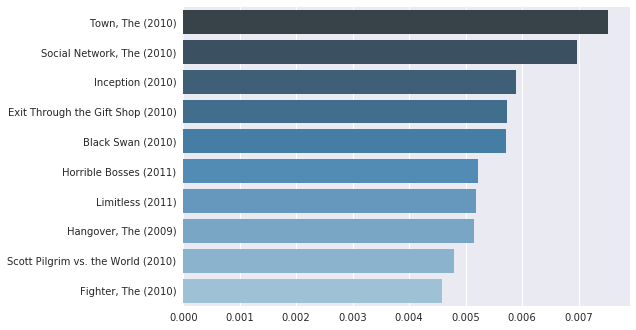

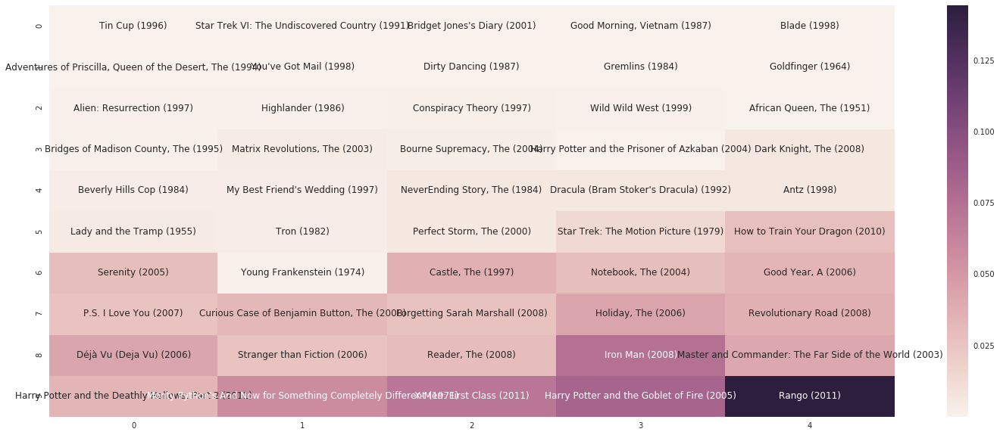

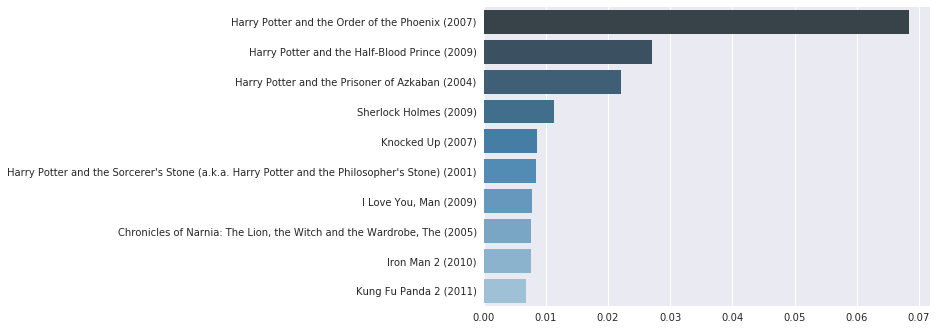

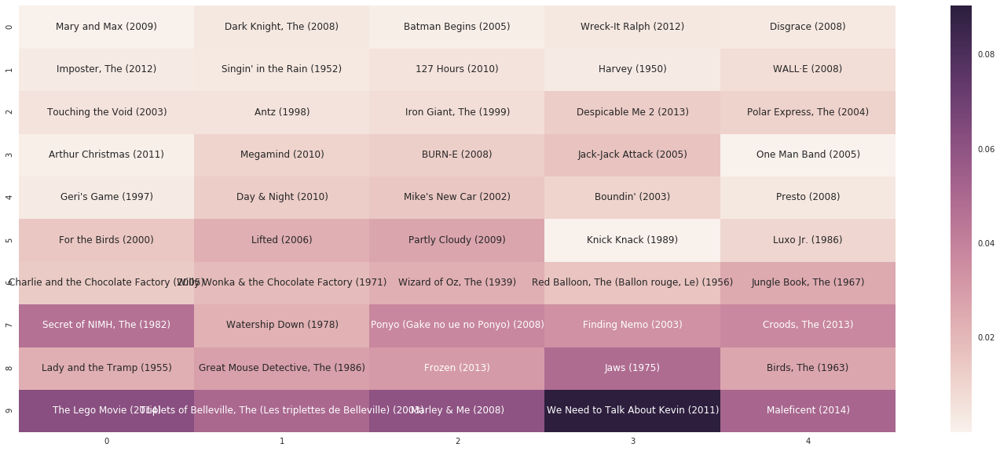

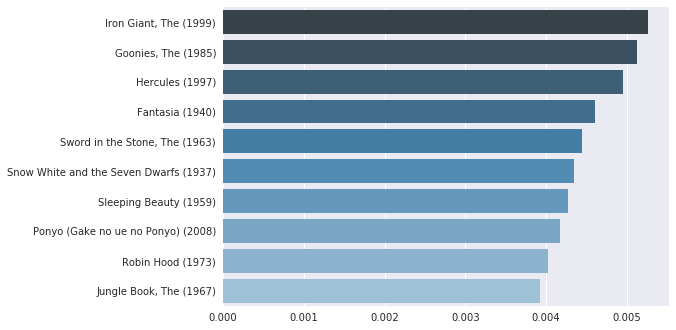

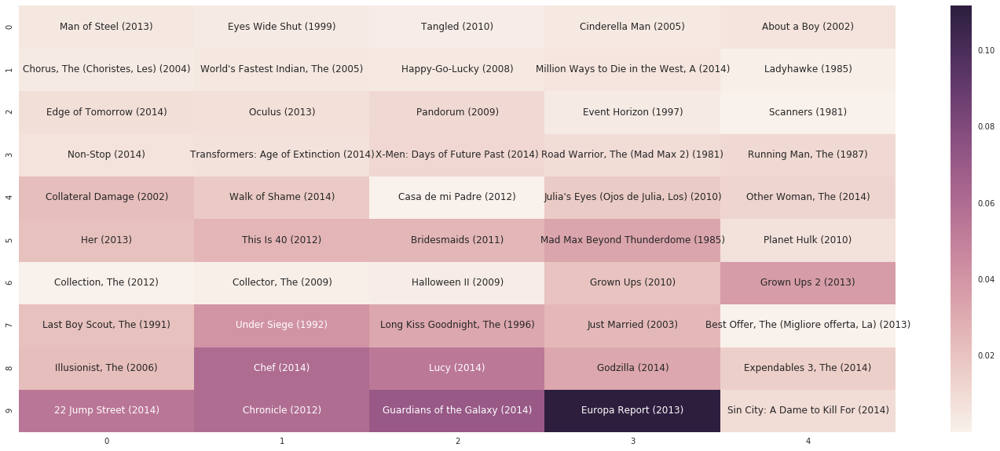

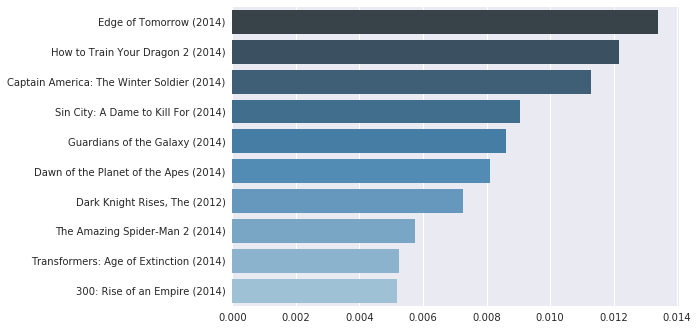

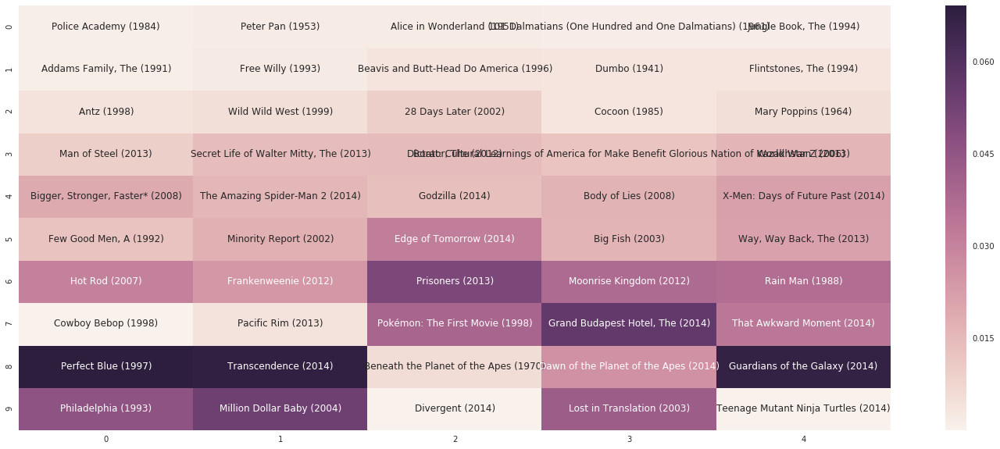

correct_predicted: ['Her (2013)']
true_movies: ['Double, The (2013)', 'Enemy (2013)', 'Under the Skin (2013)', 'Her (2013)', 'Man from Earth, The (2007)', '22 Jump Street (2014)', 'Million Ways to Die in the West, A (2014)', 'Usual Suspects, The (1995)', 'Catch Me If You Can (2002)', 'Watchmen (2009)', 'My Girl (1991)', 'Afflicted (2013)', 'Gran Torino (2008)', 'Team America: World Police (2004)', 'Wish I Was Here (2014)', 'Interstellar (2014)', "Monty Python's The Meaning of Life (1983)", 'The Lego Movie (2014)', 'Nightmare Before Christmas, The (1993)', 'Predestination (2014)', 'Maze Runner, The (2014)', 'What If (2013)', 'Tron (1982)', 'Following (1998)', 'Prince Avalanche (2013)', 'Bernie (2011)', 'The Interview (2014)', 'Sin City: A Dame to Kill For (2014)', 'This Is Where I Leave You (2014)', 'How to Train Your Dragon 2 (2014)', 'Safety Not Guaranteed (2012)', 'Wolverine, The (2013)', 'John Wick (2014)', 'Autómata (Automata) (2014)', 'Hoop Dreams (1994)', 'Justice League: The Fla

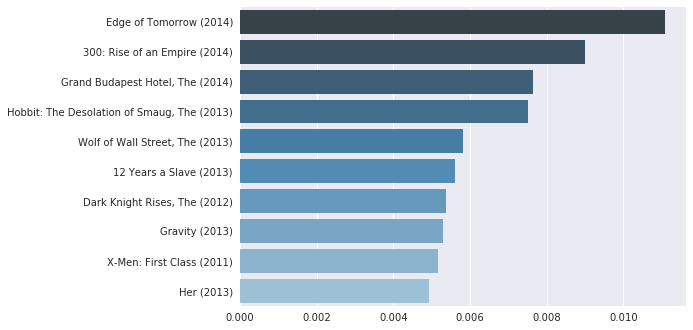

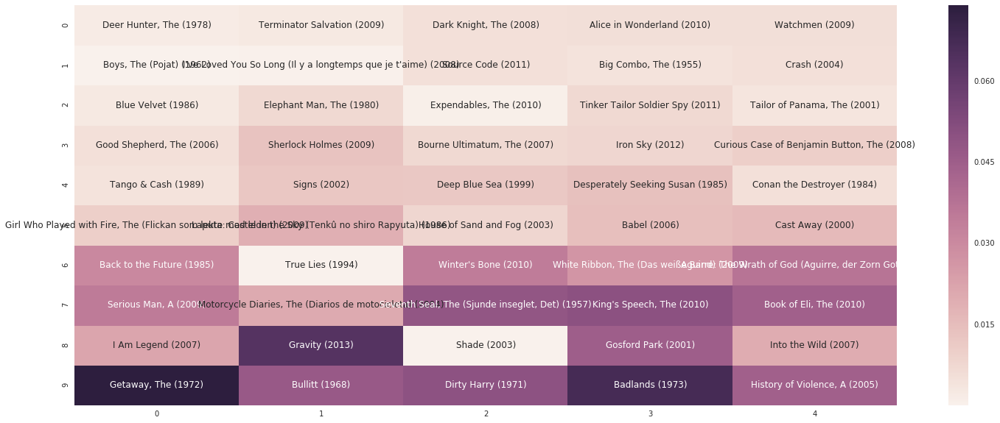

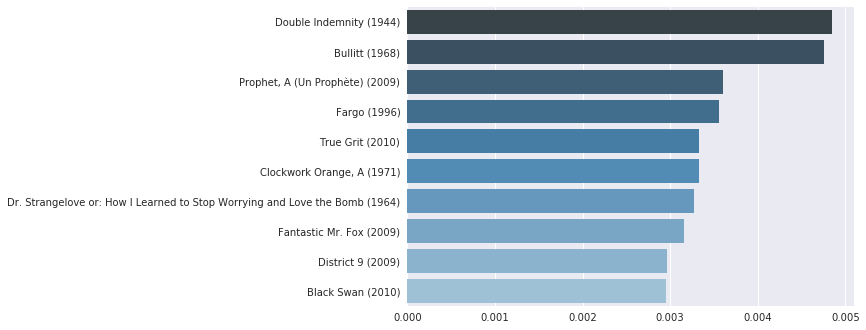

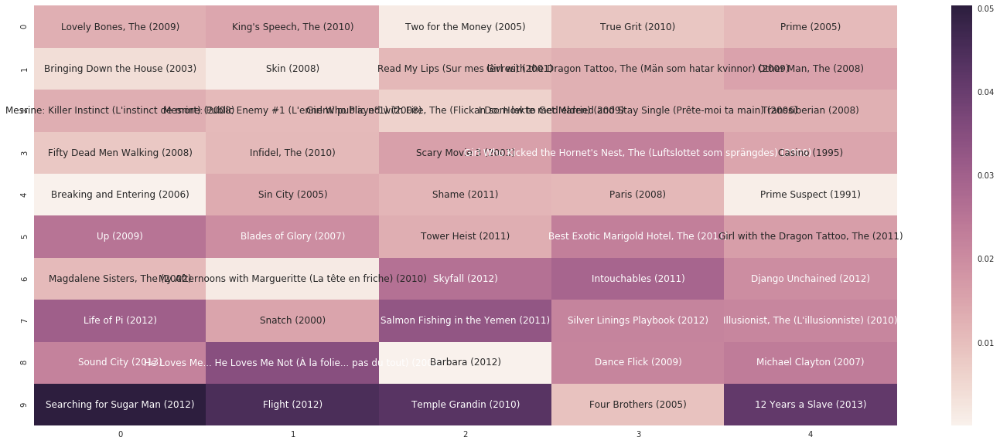

correct_predicted: ['Midnight in Paris (2011)']
true_movies: ['The Imitation Game (2014)', 'Jersey Boys (2014)', 'Midnight in Paris (2011)', 'Kingsman: The Secret Service (2015)', "Brooklyn's Finest (2010)", 'The Second Best Exotic Marigold Hotel (2015)']


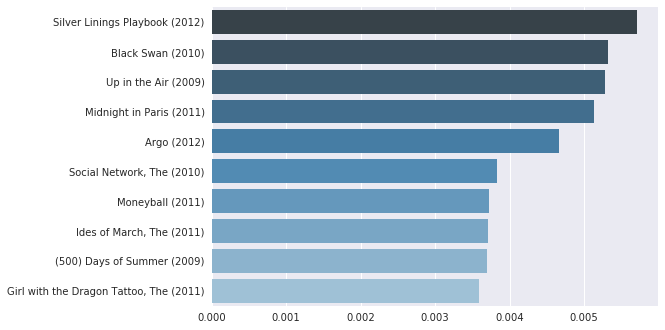

load model: checkpoints/attentional-linear-to-hidden-state/rep0-lstm2-256-1-128-adam-1000000000-hidden_state-64-20170523-125653/last_model/last_model.ckpt-9945600


In [ ]:
skipped_pred = []

batch_size = 100
idx_pred = 0
for i in range(0, len(X_test), batch_size):
    if type_input == 'one-hot':
        x_test = [x.toarray() for x in X_test[i:i+batch_size]]
        y_test = [y.toarray() for y in Y_test[i:i+batch_size]]
    elif type_input == 'embeddings':
        x_test = [x for x in X_test[i:i + batch_size]]
        y_test = [y.toarray() for y in Y_test[i:i + batch_size]]
    logits, pred_test, alphas = model.predict_and_get_weights(x_test, checkpoint_path)
    for j in range(len(pred_test)):
        idx, onehots = np.where(x_test[j] ==1)
        if len(idx) >= 50:
            k = 10
            plot_heatmap(idx_pred, x_test[j], alphas[j])
            plot_predictions(idx_pred, pred_test[j], y_test[j], k)
            idx_pred += 1
        else:
            skipped_pred.append(idx_pred)
print('Num skipped predictions: ' + str(len(skipped_pred)))

# Debug

In [126]:
alphas[0]

array([  1.54475106e-06,   2.65379072e-06,   4.92525623e-06,
         3.18235061e-06,   5.77578521e-06,   4.45759997e-06,
         4.05326045e-06,   6.57998226e-06,   1.10068759e-05,
         8.15019405e-07,   8.58301155e-06,   1.09964267e-05,
         1.11351137e-05,   2.12548293e-05,   2.28941426e-05,
         1.53813380e-05,   3.19547835e-05,   2.21988230e-05,
         1.41676837e-05,   3.09110874e-05,   5.26437434e-05,
         5.41657610e-05,   5.26411350e-05,   4.25849066e-05,
         5.63368012e-05,   3.50417540e-05,   7.64062206e-05,
         1.06993321e-04,   9.85392398e-05,   9.76832962e-05,
         1.10315559e-04,   1.69887484e-04,   1.89939703e-04,
         2.08384474e-04,   2.79833301e-04,   2.91341014e-04,
         1.96025867e-04,   1.86412013e-04,   1.69706123e-04,
         1.92351014e-04,   6.36747980e-04,   4.49260027e-04,
         2.88729410e-04,   5.18635032e-04,   7.21457065e-04,
         8.00991897e-04,   4.86930105e-04,   5.62726113e-04,
         8.67705734e-04,

In [129]:
# Functions to visualize the data
def plot_heatmap(num_prediction, x_test, alpha_weights):
    idx, onehots = np.where(x_test ==1)
    past_movies = []
    for o in onehots:
        #ids.append(dict_onehot2id[o])
        movie_id = dict_onehot2id[o]
        past_movies.append(df_movies[df_movies.movieId == movie_id].title.values[0])
    num_past_items = len(onehots)
    past_movies = np.array(past_movies[-min(50, num_past_items):])
    #past_movies = df_movies[df_movies.movieId.isin(ids)].title.values[min(50, num_past_items):]
    if num_past_items >= 50:
        labels = past_movies.reshape((10, 5))
        weights = alpha_weights[50:].reshape((10, 5))
        #plt.figure(figsize=(55,40))
        plt.figure(figsize=(25,10))
        ax = sns.heatmap(weights, annot=labels, fmt="")
        plt.show()
        plt.savefig('attention_plots/' + str(model_name) + '/attentions_' + str(num_prediction))
    else:
        print('Skip for now')
        
def plot_predictions(num_prediction, predictions, y_true, k):

    idx_predictions = np.arange(len(predictions))
    sorted_pred, sorted_idx = zip(*sorted(zip(predictions, idx_predictions), reverse=True))
    _, y_true_idx = np.where(y_true==1)

    top_k_movies = []
    i = 0
    while i < k:
        movie_id = dict_onehot2id[sorted_idx[i]]
        top_k_movies.append(df_movies[df_movies.movieId == movie_id].title.values[0])
        i += 1
    top_k_prob = sorted_pred[:k]

    true_movies = []
    for idx in y_true_idx:
        movie_id = dict_onehot2id[idx]
        true_movies.append(df_movies[df_movies.movieId == movie_id].title.values[0])

    correct_predicted_movies = []
    correct_idx = set(sorted_idx[:k]).intersection(set(y_true_idx))
    for idx in correct_idx:
        movie_id = dict_onehot2id[idx]
        correct_predicted_movies.append(df_movies[df_movies.movieId == movie_id].title.values[0])

    if len(correct_predicted_movies) > 0:
        print('correct_predicted: ' + str(correct_predicted_movies))
        print('true_movies: ' + str(true_movies))
        
    ax = sns.barplot(x=top_k_prob, y=top_k_movies, palette="Blues_d")
    plt.show()
    plt.savefig('attention_plots/' + str(model_name) + '/predictions_' + str(num_prediction))


/home/ubuntu/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1297: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


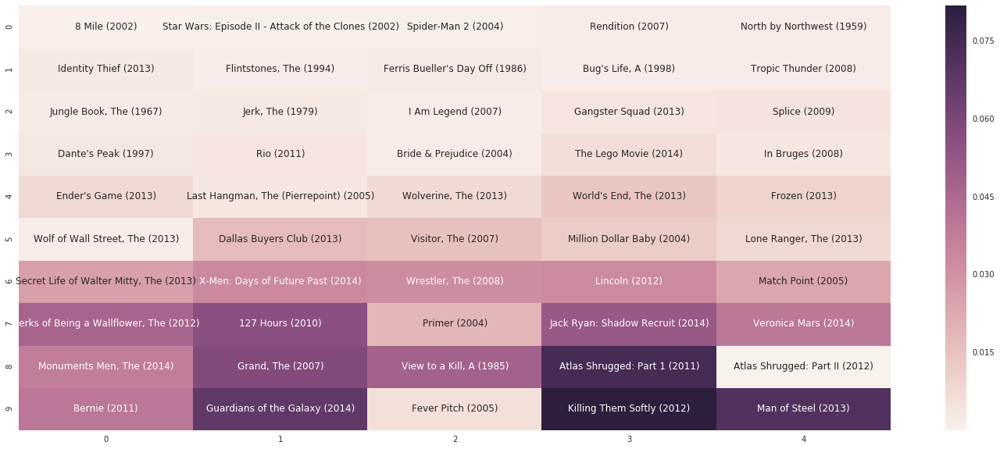

correct_predicted: ['Edge of Tomorrow (2014)']
true_movies: ['Sabrina (1954)', 'Captain America: The Winter Soldier (2014)', 'Big Hero 6 (2014)', 'Edge of Tomorrow (2014)', 'Sunshine Cleaning (2008)', 'Five-Year Engagement, The (2012)', "Schindler's List (1993)", 'Fargo (1996)', 'Back to the Future (1985)', 'Mask, The (1994)', 'Back to the Future Part II (1989)', 'Iron Man 3 (2013)', 'X-Men Origins: Wolverine (2009)', 'Léon: The Professional (a.k.a. The Professional) (Léon) (1994)', 'Indiana Jones and the Last Crusade (1989)', 'Goonies, The (1985)', 'My Neighbor Totoro (Tonari no Totoro) (1988)', 'Iron Giant, The (1999)', 'Meet the Parents (2000)', 'Patriot, The (2000)', 'Matrix Revolutions, The (2003)', 'Gone in 60 Seconds (2000)', 'Men in Black II (a.k.a. MIIB) (a.k.a. MIB 2) (2002)', "Pirates of the Caribbean: Dead Man's Chest (2006)", '40-Year-Old Virgin, The (2005)', 'Borat: Cultural Learnings of America for Make Benefit Glorious Nation of Kazakhstan (2006)', 'Troy (2004)', '50 Fi

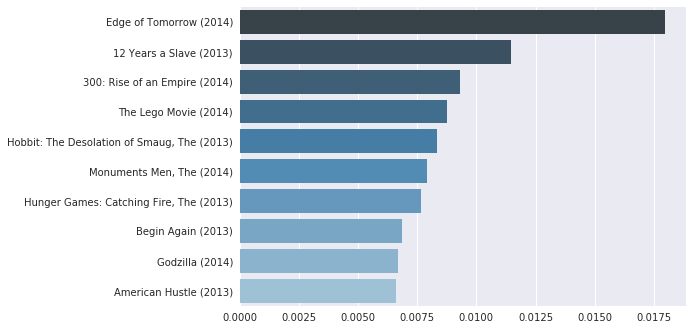

In [130]:
idx_pred = 0
k = 10
plot_heatmap(idx_pred, x_test[idx_pred], alphas[idx_pred])
plot_predictions(idx_pred, pred_test[idx_pred], y_test[idx_pred], k)

/home/ubuntu/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1297: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


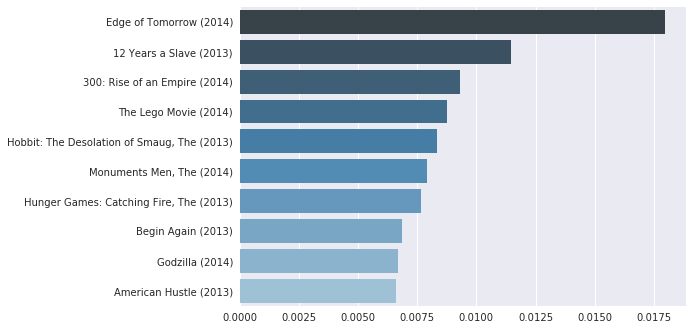

NameError: name 'num_prediction' is not defined

In [100]:
k = 10
idx_predictions = np.arange(len(pred_test[0]))
sorted_pred, sorted_idx = zip(*sorted(zip(pred_test[0], idx_predictions), reverse=True))
_, y_true_idx = np.where(y_test[0]==1)

top_k_movies = []
i = 0
while i < k:
    movie_id = dict_onehot2id[sorted_idx[i]]
    top_k_movies.append(df_movies[df_movies.movieId == movie_id].title.values[0])
    i += 1
top_k_prob = sorted_pred[:k]

true_movies = []
for idx in y_true_idx:
    movie_id = dict_onehot2id[idx]
    true_movies.append(df_movies[df_movies.movieId == movie_id].title.values[0])
    
correct_predicted_movies = []
correct_idx = set(sorted_idx[:k]).intersection(set(y_true_idx))
for idx in correct_idx:
    movie_id = dict_onehot2id[idx]
    correct_predicted_movies.append(df_movies[df_movies.movieId == movie_id].title.values[0])
    
ax = sns.barplot(x=top_k_prob, y=top_k_movies, palette="Blues_d")
plt.show()
plt.savefig('attention_plots/' + str(model_name) + '/predictions_' + str(num_prediction))

    

/home/ubuntu/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1297: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


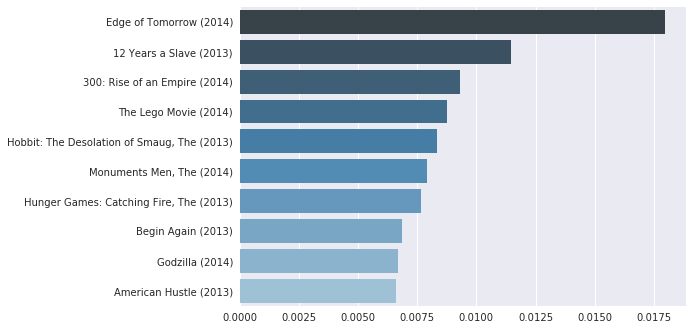

In [99]:
ax = sns.barplot(x=top_k_prob, y=top_k_movies, palette="Blues_d")
plt.show()

In [25]:
top_k_prob

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy
5,6,Heat (1995),Action|Crime|Thriller
6,7,Sabrina (1995),Comedy|Romance
7,8,Tom and Huck (1995),Adventure|Children
8,9,Sudden Death (1995),Action
9,10,GoldenEye (1995),Action|Adventure|Thriller
